<a href="https://colab.research.google.com/github/vi-ampally/Projects/blob/main/Vignitha_Ampally_Netflix_Analytics.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## **Author: Vignitha Ampally**

## **Netflix Dataset**

The Netflix Dataset contains information about various entertainment content such as movies and tv shows, including their title, category, director, release year, runtime in minutes, combined genre, Just Watch rating in percentage, IMDb rating, and IMDB user ratings value in thousands (K).

**How I extracted the data?**

In the process I undertook, I collected Netflix data by scraping movies and TV shows listed on the JustWatch platform. To extract the data from the HTML, I utilized the Beautiful Soup library and wrote code accordingly. By gathering all the necessary information, I consolidated it into a single dataset, ensuring that each column corresponds to the relevant data from the JustWatch website. While scraping, I successfully obtained IMDb links for each title. However, I encountered an error when attempting to scrape IMDb data. Despite the challenges I faced, I thoroughly enjoyed the data gathering process and found it to be rewarding. I am delighted to have the opportunity to present my findings to Netflix.

In addition to the process, I would like to mention that all the scraping code files will be conveniently available in a Google Drive folder. This folder will contain the code files used for the scraping, ensuring easy access and reference to the code utilized during the data gathering process.


**Usage:**
The Netflix Dataset provides valuable information about the entertainment content, allowing users to analyze and explore various aspects. Some potential use cases of this dataset include:

**- Entertainment Content Analysis**: The dataset can be used to analyze the content characteristics such as runtime, ratings, and genres to gain insights into popular genres or correlations between ratings and user engagement.

**- Genre-specific Recommendations**: By filtering the dataset based on specific genres, one can obtain a list of content within each genre and use it for generating personalized recommendations.

**- Release Year Analysis**: Users can analyze content based on release year, exploring trends, or identifying popular movies from specific time periods.

**- Comparative Analysis**: The dataset enables comparisons between Just Watch ratings, IMDb ratings, and user ratings, providing insights into the alignment or divergence of these ratings.

**Other Information:**

**IMDb (Internet Movie Database)**: IMDb is a popular online database for movies, TV shows, and celebrities. It provides ratings based on user reviews and critics' reviews. The ratings are on a scale of 1 to 10, with higher ratings generally indicating better reception.

**JustWatch**: JustWatch is an app that helps users find online platforms to watch specific movies or TV shows. By searching for a title, it presents options and shows associated costs. It integrates with popular streaming services like Netflix and Amazon Prime Video to access and analyze their content libraries. JustWatch ratings reflect the popularity and user satisfaction based on reviews from the JustWatch community. Higher ratings indicate greater user enjoyment.

In [ ]:
#importing dependencies
from pathlib import Path
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy
import sklearn

## **Unxploded_df Dataset**

The dataframe called "**unexploded_df**" contains a collection of unique TV shows and movies with column information.


**Columns:**

**Title**: The title of the entertainment content.

**Category**: The category or type of the entertainment content.

**Director**: The director of the entertainment content.

**Release_Year**: The year in which the entertainment content was released.

**Runtime_In_Minutes**: The duration of the entertainment content in minutes.

**Combined_Genre**: The combined genre(s) of the entertainment content.

**Just_Watch_Rating_In_Percentage**: The rating of the entertainment content on Just Watch platform, expressed in percentage.

**IMDB_Rating**: The IMDb rating of the entertainment content. (unweighted mean of the user ratings)

**User_Ratings_Value_K**: The number of user ratings received for the entertainment content, in thousands. (representing user engagement; Source: IMDB)

In [ ]:
unexploded_df = pd.read_excel('/content/finalized unexploded data.xlsx')
unexploded_df.head()

,Title,Category,Director,Release_Year,Runtime_In_Minutes,Combined_Genre,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
0,#blackAF,TV-Show,Kenya Barris,2020,37,Comedy,38.0,NaN,NaN
1,(Un)Well,TV-Show,NaN,2020,52,"Reality TV, Documentary",69.0,6.4,1.0
2,13 Reasons Why,TV-Show,Dylan Minnette,2017,58,"Drama, Mystery & Thriller",84.0,7.5,302.0
3,1899,TV-Show,Emily Beecham,2022,53,"Drama, Horror, Science-Fiction, History",83.0,7.3,97.0
4,28 Days Haunted,TV-Show,NaN,2022,34,"Reality TV, Horror",63.0,3.5,2.0


# **Adding Ranges for each Numerical Column for further Analysis:**

In [ ]:
ubins = [1975, 1980, 1985, 1990, 1995, 2000, 2005, 2010, 2015, 2020, 2025]

# Define the labels for the ranges
ulabels = ['1975-1980', '1981-1985', '1986-1990', '1991-1995', '1996-2000',
          '2001-2005', '2006-2010', '2011-2015', '2016-2020', '2021-2025']

# Create the new column based on the ranges
unexploded_df['Release_Year_Range'] = pd.cut(unexploded_df['Release_Year'], bins=ubins, labels=ulabels, right=False)

uimdb_bins = [2.0, 2.5, 3.0, 3.5, 4.0, 4.5, 5.0, 5.5, 6.0, 6.5, 7.0, 7.5, 8.0, 8.5, 9.0, 9.5, 10.0]

# Define the labels for the ranges
uimdb_labels = ['2.0-2.5', '2.6-3.0', '3.1-3.5', '3.6-4.0', '4.1-4.5', '4.6-5.0', '5.1-5.5',
          '5.6-6.0', '6.1-6.5', '6.6-7.0', '7.1-7.5', '7.6-8.0', '8.1-8.5', '8.6-9.0', '9.1-9.5', '9.6-10.0']

# Create the new column based on the ranges
unexploded_df['IMDB_Range'] = pd.cut(unexploded_df['IMDB_Rating'], bins=uimdb_bins, labels=uimdb_labels, right=False)

# Define the range bins
ujust_watch_bins = [0, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100]

# Define the labels for the ranges
ujust_watch_labels = ['0-10', '10-20', '20-30', '30-40', '40-50', '50-60', '60-70', '70-80', '80-90', '90-100']

# Create the new column based on the ranges
unexploded_df['JustWatch_Range'] = pd.cut(unexploded_df['Just_Watch_Rating_In_Percentage'], bins=ujust_watch_bins, labels=ujust_watch_labels, right=False)

# Define the range bins
uuser_bins = [1, 50, 100, 150, 200, 250, 300, 350, 400, 450, 500, 550, 600, 650, 700, 750, 800, 850, 900, 950, 1000]

# Define the labels for the ranges
uuser_labels = ['1-50', '51-100', '101-150', '151-200', '201-250', '251-300', '301-350', '351-400',
          '401-450', '451-500', '501-550', '551-600', '601-650', '651-700', '701-750', '751-800',
          '801-850', '851-900', '901-950', '951-1000']

# Create the new column based on the ranges
unexploded_df['UserRatings_Range'] = pd.cut(unexploded_df['User_Ratings_Value_K'], bins=uuser_bins, labels=uuser_labels, right=False)


In [ ]:
# Define the range bins
rbins = range(0, 255, 5)  # Bins from 0 to 250 with an interval of 5

# Define the labels for the ranges
rlabels = [f"{start}-{start+5}" for start in rbins[:-1]]  # Labels for each range

# Create the new column based on the ranges
unexploded_df['Runtime_Range'] = pd.cut(unexploded_df['Runtime_In_Minutes'], bins=rbins, labels=rlabels, right=False)


In [ ]:
#Moving the locations of certain columns to the correct locations

# Get the column names of the DataFrame
columnsss = unexploded_df.columns.tolist()

# Remove the last column from the list of columns
last_columnnn = columnsss.pop()

# Insert the last column at the desired position (6th column)
columnsss.insert(5, last_columnnn)

# Reorder the DataFrame columns based on the updated column order
unexploded_df = unexploded_df[columnsss]

# Print the DataFrame with the column moved
#unexploded_df.head()

In [ ]:
# Get the column names of the DataFrame
columnsss = unexploded_df.columns.tolist()

# Remove the last column from the list of columns
last_columnnn = columnsss.pop()

# Insert the last column at the desired position (11th column)
columnsss.insert(10, last_columnnn)

# Reorder the DataFrame columns based on the updated column order
unexploded_df = unexploded_df[columnsss]

# Print the DataFrame with the column moved
#unexploded_df.head()

In [ ]:
# Get the column names of the DataFrame
columnsss = unexploded_df.columns.tolist()

# Remove the last column from the list of columns
last_columnnn = columnsss.pop()

# Insert the last column at the desired position (9th column)
columnsss.insert(8, last_columnnn)

# Reorder the DataFrame columns based on the updated column order
unexploded_df = unexploded_df[columnsss]

# Print the DataFrame with the column moved
#unexploded_df.head()

In [ ]:
# Get the column names of the DataFrame
columnsss = unexploded_df.columns.tolist()

# Remove the last column from the list of columns
last_columnnn = columnsss.pop()

# Insert the last column at the desired position (11th column)
columnsss.insert(10, last_columnnn)

# Reorder the DataFrame columns based on the updated column order
unexploded_df = unexploded_df[columnsss]

# Print the DataFrame with the column moved
#unexploded_df.head()

In [ ]:
# Get the column names of the DataFrame
columnssss = unexploded_df.columns.tolist()

# Remove the last column from the list of columns
last_columnnnn = columnssss.pop()

# Insert the last column at the desired position (5th column)
columnssss.insert(4, last_columnnnn)

# Reorder the DataFrame columns based on the updated column order
unexploded_df = unexploded_df[columnssss]

# Print the DataFrame with the column moved
#unexploded_df.head()

# **Unexploded_df dataset**

The Unexploded_df dataset has a collection of unique tv shows and movies streaming on Netflix according to the Just Watch Website.

Note: The column Combined_Genre has mutliple genres in one cell. This will be exploded to a larger dataset in the upcoming python cells to analyze genre specific data.

In [ ]:
unexploded_df

,Title,Category,Director,Release_Year,Release_Year_Range,Runtime_In_Minutes,Runtime_Range,Combined_Genre,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
0,#blackAF,TV-Show,Kenya Barris,2020,2021-2025,37,35-40,Comedy,38.0,30-40,NaN,NaN,NaN,NaN
1,(Un)Well,TV-Show,NaN,2020,2021-2025,52,50-55,"Reality TV, Documentary",69.0,60-70,6.4,6.1-6.5,1.0,1-50
2,13 Reasons Why,TV-Show,Dylan Minnette,2017,2016-2020,58,55-60,"Drama, Mystery & Thriller",84.0,80-90,7.5,7.6-8.0,302.0,301-350
3,1899,TV-Show,Emily Beecham,2022,2021-2025,53,50-55,"Drama, Horror, Science-Fiction, History",83.0,80-90,7.3,7.1-7.5,97.0,51-100
4,28 Days Haunted,TV-Show,NaN,2022,2021-2025,34,30-35,"Reality TV, Horror",63.0,60-70,3.5,3.6-4.0,2.0,1-50
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1964,You People,Movie,Kenya Barris,2023,2021-2025,117,115-120,"Comedy, Romance",64.0,60-70,5.5,5.6-6.0,56.0,51-100
1965,Your Place or Mine,Movie,Aline Brosh McKenna,2023,2021-2025,109,105-110,"Comedy, Romance",68.0,60-70,5.6,5.6-6.0,32.0,1-50
1966,Zion,Movie,Floyd Russ,2018,2016-2020,10,10-15,"Documentary, Drama",39.0,30-40,NaN,NaN,0.0,NaN
1967,Zombieland,Movie,Ruben Fleischer,2009,2006-2010,88,85-90,"Comedy, Horror, Action & Adventure, Science-Fi...",82.0,80-90,7.6,7.6-8.0,595.0,551-600


**The unexploded_df dataset contains 1969 unique rows and 14 columns**

In [ ]:
unexploded_df.shape

(1969, 14)

**The dataset contains 1039 TV shows and 930 movies.**

In [ ]:
unexploded_df.Category.value_counts()

TV-Show    1039
Movie       930
Name: Category, dtype: int64

# **Checking Null Values and Updating the values**

In [ ]:
unexploded_df.isnull().sum()


Title                                0
Category                             0
Director                            79
Release_Year                         0
Release_Year_Range                   9
Runtime_In_Minutes                   0
Runtime_Range                        0
Combined_Genre                       2
Just_Watch_Rating_In_Percentage      0
JustWatch_Range                      1
IMDB_Rating                         80
IMDB_Range                          81
User_Ratings_Value_K               239
UserRatings_Range                  358
dtype: int64

In [ ]:
unexploded_df['Release_Year_Range'] = unexploded_df['Release_Year_Range'].astype(str).fillna('Unknown')
unexploded_df['Release_Year_Range'].isnull().sum()

0

In [ ]:
unexploded_df['Director'] = unexploded_df['Director'].astype(str).fillna('Unknown')
unexploded_df['Director'].isnull().sum()


0

In [ ]:
unexploded_df['Director'] = unexploded_df['Director'].astype(str).fillna('Unknown')
unexploded_df['Combined_Genre'] = unexploded_df['Combined_Genre'].astype(str).fillna('Unknown')
unexploded_df['JustWatch_Range'] = unexploded_df['JustWatch_Range'].astype(str).fillna('Unknown')
unexploded_df['IMDB_Rating'] = unexploded_df['IMDB_Rating'].astype(str).fillna('Unknown')
unexploded_df['User_Ratings_Value_K'] = unexploded_df['User_Ratings_Value_K'].astype(str).fillna('Unknown')
unexploded_df['UserRatings_Range'] = unexploded_df['UserRatings_Range'].astype(str).fillna('Unknown')
unexploded_df['IMDB_Range'] = unexploded_df['IMDB_Range'].astype(str).fillna('Unknown')

In [ ]:
unexploded_df.isnull().sum()


Title                              0
Category                           0
Director                           0
Release_Year                       0
Release_Year_Range                 0
Runtime_In_Minutes                 0
Runtime_Range                      0
Combined_Genre                     0
Just_Watch_Rating_In_Percentage    0
JustWatch_Range                    0
IMDB_Rating                        0
IMDB_Range                         0
User_Ratings_Value_K               0
UserRatings_Range                  0
dtype: int64

In [ ]:
unexploded_df.dtypes

Title                                object
Category                             object
Director                             object
Release_Year                          int64
Release_Year_Range                   object
Runtime_In_Minutes                    int64
Runtime_Range                      category
Combined_Genre                       object
Just_Watch_Rating_In_Percentage     float64
JustWatch_Range                      object
IMDB_Rating                          object
IMDB_Range                           object
User_Ratings_Value_K                 object
UserRatings_Range                    object
dtype: object

In [ ]:
unexploded_df['IMDB_Rating'] = unexploded_df['IMDB_Rating'].astype(float)
unexploded_df['User_Ratings_Value_K'] = unexploded_df['User_Ratings_Value_K'].astype(float)
unexploded_df.dtypes

Title                                object
Category                             object
Director                             object
Release_Year                          int64
Release_Year_Range                   object
Runtime_In_Minutes                    int64
Runtime_Range                      category
Combined_Genre                       object
Just_Watch_Rating_In_Percentage     float64
JustWatch_Range                      object
IMDB_Rating                         float64
IMDB_Range                           object
User_Ratings_Value_K                float64
UserRatings_Range                    object
dtype: object

##**Netflix Content Distribution by Release Year Range: Movies and TV Shows**

## **Definitions**

**Category**: This column indicates whether the entry belongs to the "Movie" or "TV-Show" category.

**Release_Year_Range**: This column represents the range of release years for the movies and TV shows.

**Movie**: This column shows the number of movies hosted by Netflix within the corresponding release year range.

**TV-Show**: This column shows the number of TV shows hosted by Netflix within the corresponding release year range.


## **Insights**


**Shift towards Streaming Content**: The increasing number of movies and TV shows available on Netflix reflects the shift in consumer preferences towards streaming platforms for entertainment.

**Emphasis on Recent Content**: The higher counts in the 2021-2025 and 2016-2020 release year ranges indicate Netflix's focus on acquiring and hosting more recent content. This suggests that Netflix aims to cater to the audience's demand for up-to-date movies and TV shows.

**Expansion of Original Content**: The increasing number of movies and TV shows in recent release year ranges suggests Netflix's investment in producing and distributing original content. This strategy allows Netflix to differentiate itself from other platforms and offer exclusive content to its subscribers.

**Growing TV Show Catalog**: The higher count of TV shows compared to movies in several release year ranges highlights the increasing importance of TV series in Netflix's catalog. This trend aligns with the popularity of binge-watching and the rise of long-form storytelling in episodic formats.

**Netflix as an Archive**: The presence of movies from earlier release year ranges indicates that Netflix aims to provide a diverse range of content, including classic and cult films. By hosting movies from various eras, Netflix serves as an archival platform, allowing viewers to access and discover films from different time periods.

**Continuous Content Acquisition**: The progressive increase in the number of movies and TV shows from the 2001-2005 release year range onwards suggests that Netflix continues to acquire and license content from a wide range of years. This strategy ensures a diverse content library that appeals to different audience preferences.

**Demand for Variety**: The varying counts across different release year ranges signify Netflix's effort to offer a variety of content choices. By hosting movies and TV shows from different eras, Netflix caters to the diverse tastes and interests of its global subscriber base.

In [ ]:
crosstab_data = pd.crosstab(unexploded_df['Release_Year_Range'], unexploded_df['Category'])
crosstab_data = crosstab_data.iloc[:-1, :]
crosstab_data

Category,Movie,TV-Show
Release_Year_Range,,
1975-1980,8,0
1981-1985,3,1
1986-1990,9,1
1991-1995,12,5
1996-2000,18,6
2001-2005,32,24
2006-2010,27,17
2011-2015,70,53
2016-2020,260,306


# **Graphical Representation of the distribution of Categories by Release Year Range**

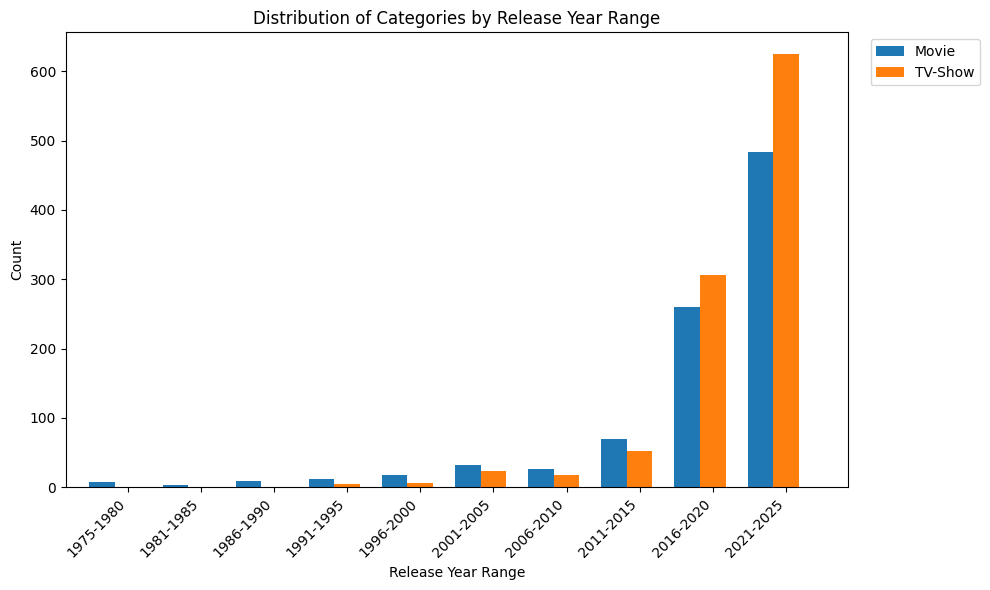

In [ ]:
# Get the unique categories and release year ranges
categories = crosstab_data.columns
release_year_ranges = crosstab_data.index

# Set up the figure and axes
fig, ax = plt.subplots(figsize=(10, 6))  # Increase the figure size

# Set the width of each bar
bar_width = 0.35

# Calculate the position of each bar on the x-axis
x_positions = np.arange(len(release_year_ranges))

# Plot the bars for each category
for i, category in enumerate(categories):
    y_values = crosstab_data[category]
    ax.bar(x_positions + (i * bar_width), y_values, width=bar_width, label=category)

# Add labels, title, and legend
ax.set_xlabel('Release Year Range')
ax.set_ylabel('Count')
ax.set_title('Distribution of Categories by Release Year Range')
ax.set_xticks(x_positions + (bar_width * len(categories) / 2))
ax.set_xticklabels(release_year_ranges, rotation=45, ha='right')  # Rotate and align the x-axis labels

# Adjust the x-axis limits
ax.set_xlim([-0.5, len(release_year_ranges) - 0.5 + bar_width * len(categories)])

# Add legend outside the plot
ax.legend(bbox_to_anchor=(1.02, 1), loc='upper left')

# Show the plot
plt.tight_layout()  # Adjust the layout to prevent label overlap
plt.show()


## **Distribution of Content Availability on JustWatch by Release Year Range**

# **Interpretations**:

The rows represent the release year ranges of the movies and TV shows hosted by Netflix, ranging from 1975-1980 to 2021-2025.

The columns represent the JustWatch rating ranges, which indicate the rating scores given by users on the JustWatch platform.

The values in the table represent the count of movies and TV shows falling within the corresponding release year and JustWatch rating range.

# **Insights**

**Content Distribution**: The majority of movies and TV shows hosted by Netflix have ratings in the 70-80 and 80-90 JustWatch rating ranges, as indicated by the higher counts in those columns.

**Recent Content**: The release year ranges 2016-2020 and 2021-2025 have the highest counts across most of the JustWatch rating ranges, suggesting that Netflix focuses on hosting more recent content.

**High-Rated Content**: The 60-70 and 70-80 JustWatch rating ranges have higher counts across multiple release year ranges, indicating that Netflix has a significant number of movies and TV shows with relatively high user ratings.

**Overall Total**: The "Total" row and column provide the sum of movies and TV shows in each JustWatch rating range and release year range, respectively. The total count of content hosted by Netflix is 1959.

In [ ]:
#pd.crosstab(unexploded_df['Release_Year_Range'], unexploded_df['JustWatch_Range']).iloc[:-1, :-1]
crosstab_df = pd.crosstab(unexploded_df['Release_Year_Range'], unexploded_df['JustWatch_Range']).iloc[:-1, :-1]
crosstab_df['Total'] = crosstab_df.sum(axis=1)
crosstab_df.loc['Total'] = crosstab_df.sum()

crosstab_df


JustWatch_Range,0-10,10-20,20-30,30-40,40-50,50-60,60-70,70-80,80-90,90-100,Total
Release_Year_Range,,,,,,,,,,,
1975-1980,0,0,0,0,0,0,1,3,4,0,8
1981-1985,0,0,0,0,0,0,1,3,0,0,4
1986-1990,0,0,0,0,0,0,1,6,2,1,10
1991-1995,0,0,0,0,0,0,2,8,4,3,17
1996-2000,0,0,0,1,1,0,5,9,5,3,24
2001-2005,0,0,0,0,0,1,8,22,16,9,56
2006-2010,0,0,0,0,2,0,6,14,13,8,43
2011-2015,0,0,0,1,0,2,20,40,46,14,123
2016-2020,0,0,2,11,9,25,104,204,165,46,566


Most Netflix content with the release year in the year range 1975-1980 fell in the JustWatch rating range 80-90.

Most Netflix content with the release year in the year range 1981-1985 fell in the JustWatch rating range 70-80.

Most Netflix content with the release year in the year range 1986-1990 fell in the JustWatch rating range 80-90.

Most Netflix content with the release year in the year range 1991-1995 fell in the JustWatch rating range 80-90.

Most Netflix content with the release year in the year range 1996-2000 fell in the JustWatch rating range 80-90.

Most Netflix content with the release year in the year range 2001-2005 fell in the JustWatch rating range 80-90.

Most Netflix content with the release year in the year range 2006-2010 fell in the JustWatch rating range 80-90.

Most Netflix content with the release year in the year range 2011-2015 fell in the JustWatch rating range 90-100.

Most Netflix content with the release year in the year range 2016-2020 fell in the JustWatch rating range 80-90.

Most Netflix content with the release year in the year range 2021-2025 fell in the JustWatch rating range 90-100.

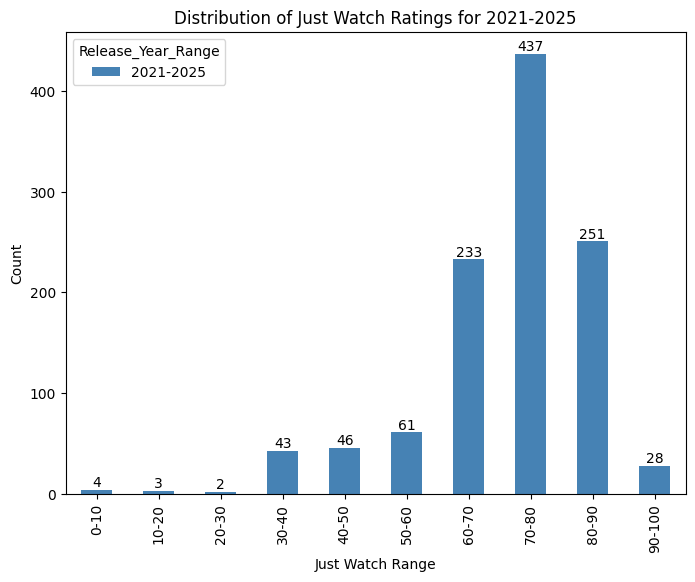

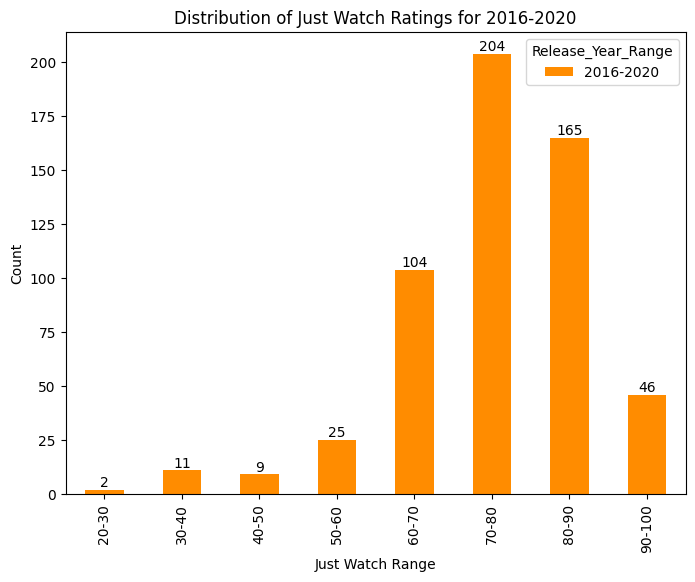

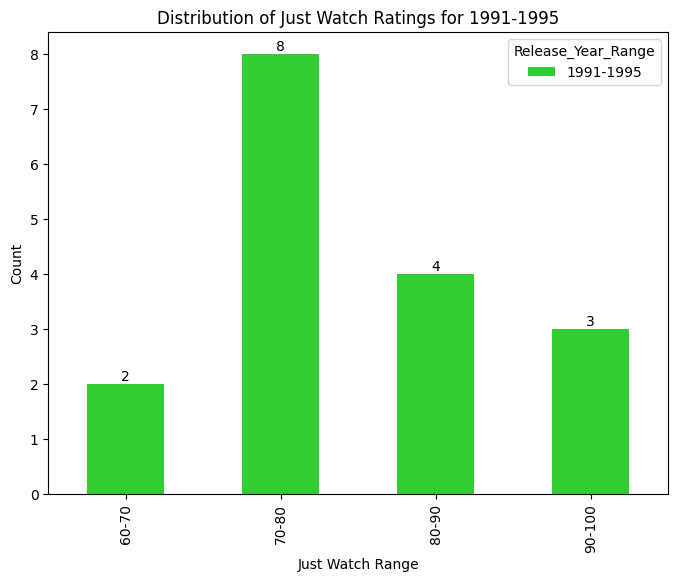

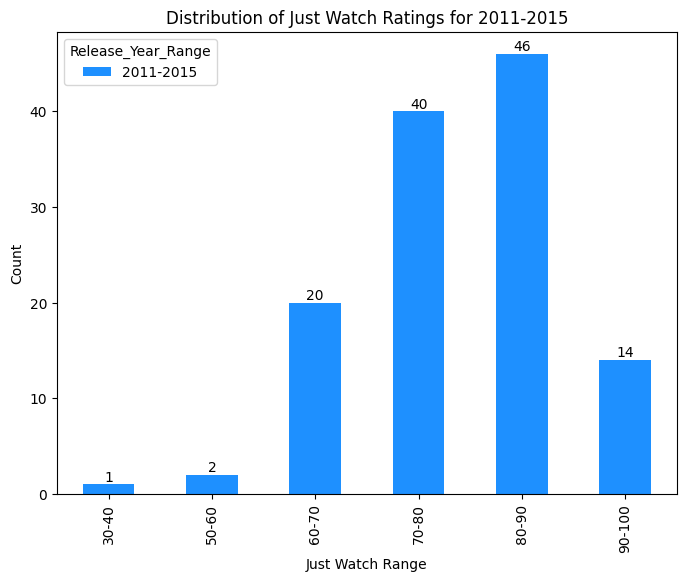

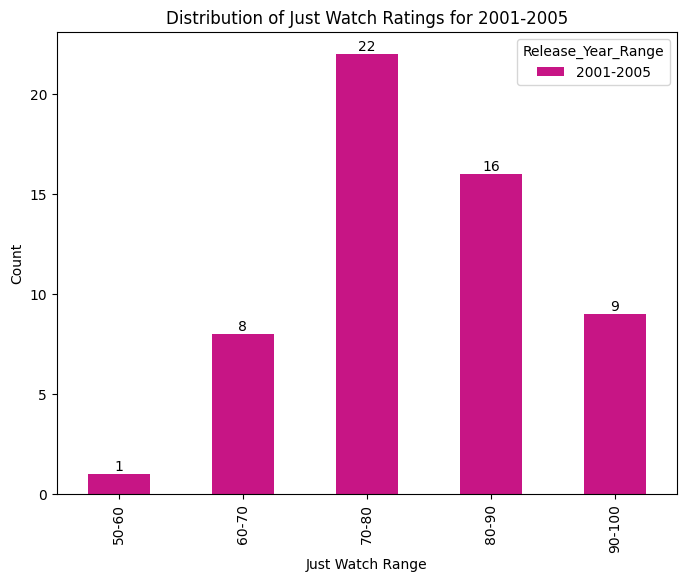

...

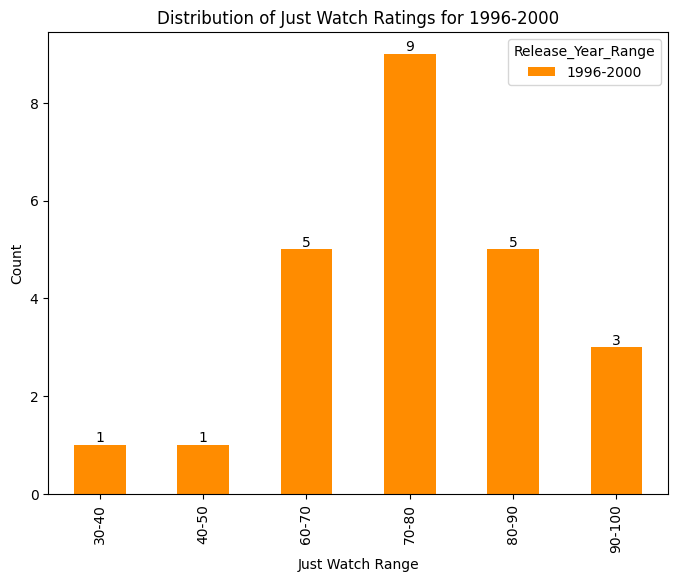

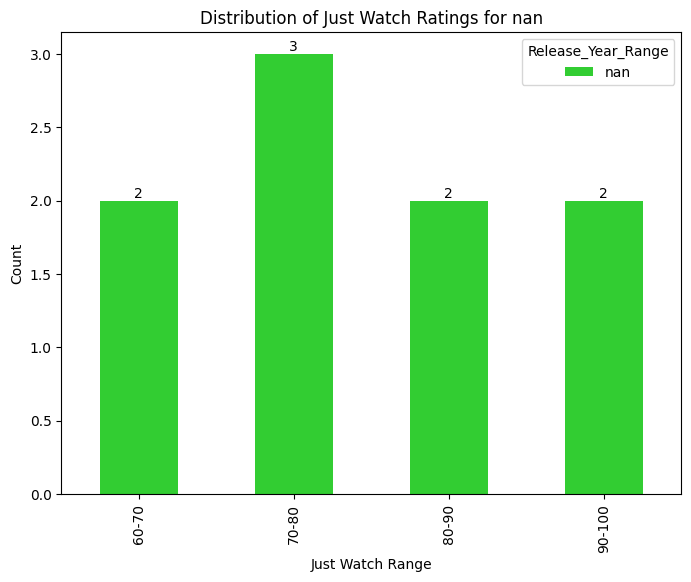

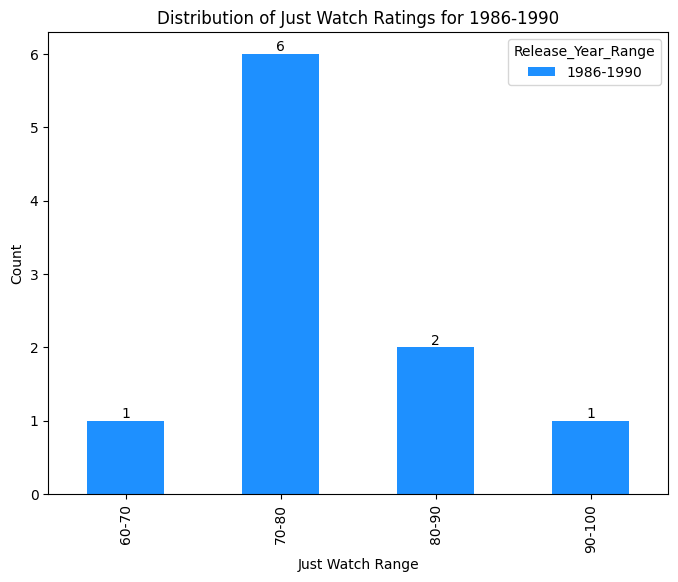

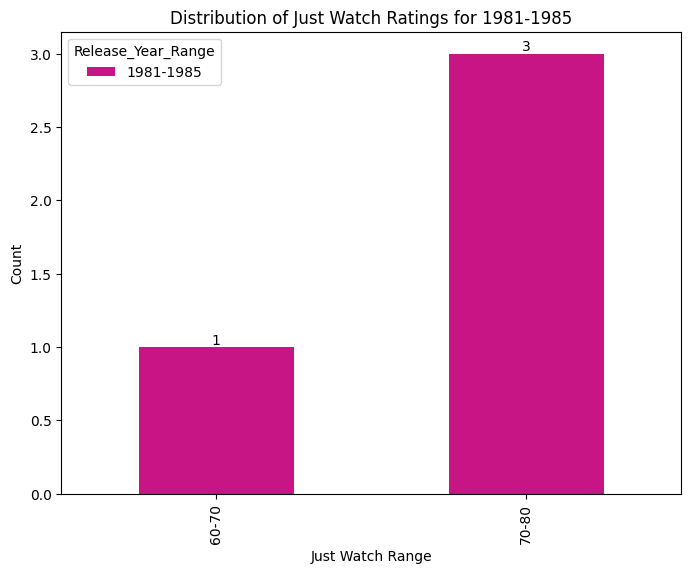

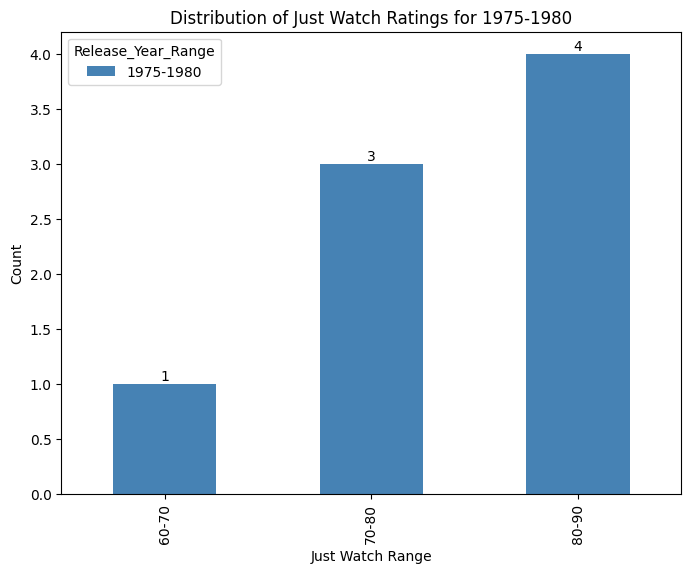

In [ ]:
import matplotlib.pyplot as plt

# Get the unique release year ranges
year_ranges = unexploded_df['Release_Year_Range'].unique()

# Define colors for the bars
colors = ['steelblue', 'darkorange', 'limegreen', 'dodgerblue', 'mediumvioletred']

# Iterate over each year range and create separate plots
for i, year_range in enumerate(year_ranges):
    # Create the crosstab dataframe for the current year range
    crosstab_data_01 = pd.crosstab(unexploded_df[unexploded_df['Release_Year_Range'] == year_range]['JustWatch_Range'],
                                unexploded_df[unexploded_df['Release_Year_Range'] == year_range]['Release_Year_Range'])

    # Convert the crosstab data to numeric
    crosstab_data_01 = crosstab_data_01.apply(pd.to_numeric)


    # Plotting the data
    fig, ax = plt.subplots(figsize=(8, 6))  # Set the figure size
    crosstab_data_01.plot(kind='bar', ax=ax, color=colors[i % len(colors)])

    # Set labels and title
    ax.set_xlabel('Just Watch Range')
    ax.set_ylabel('Count')
    ax.set_title(f'Distribution of Just Watch Ratings for {year_range}')

    # Add bar labels
    for container in ax.containers:
        ax.bar_label(container)

    # Show the plot
    plt.show()


## **IMDb Rating Distribution by Release Year Range**

IMDB Ratings Distribution: The table shows the count of movies and TV shows hosted by Netflix in different release year ranges categorized by their IMDB ratings. Each row represents a specific release year range, and each column represents a range of IMDB ratings.

Varying IMDB Ratings: The counts in each IMDB rating range vary across the different release year ranges. This suggests that the quality and reception of the content available on Netflix can vary depending on the release year.

Increasing High-Rated Content: There is a general trend of an increasing number of movies and TV shows with higher IMDB ratings in more recent release year ranges. The counts in the higher IMDB rating ranges (7.1-7.5, 7.6-8.0, 8.1-8.5, 8.6-9.0, 9.1-9.5, 9.6-10.0) tend to be higher in the 2016-2020 and 2021-2025 release year ranges, indicating a focus on acquiring and hosting well-received content in recent years.

Mixed Quality Content: There is a mix of movies and TV shows across different IMDB rating ranges in each release year range. This indicates that Netflix offers a range of content options with varying levels of critical and audience acclaim.

Increasing Counts in Mid-Rated Ranges: The counts in the mid-range IMDB rating categories (6.1-6.5, 6.6-7.0) are relatively high across multiple release year ranges. This suggests that Netflix aims to provide a substantial amount of content with average to above-average ratings to cater to a wide audience.

Importance of Recent Releases: The higher counts in the 2021-2025 release year range across various IMDB rating ranges indicate Netflix's emphasis on acquiring and hosting more recent content, regardless of its rating. This reflects the platform's strategy to cater to the demand for up-to-date movies and TV shows.

In [ ]:
pd.crosstab(unexploded_df['Release_Year_Range'], unexploded_df['IMDB_Range']).iloc[:-1, :-1]

IMDB_Range,2.0-2.5,2.6-3.0,3.1-3.5,3.6-4.0,4.1-4.5,4.6-5.0,5.1-5.5,5.6-6.0,6.1-6.5,6.6-7.0,7.1-7.5,7.6-8.0,8.1-8.5,8.6-9.0,9.1-9.5,9.6-10.0
Release_Year_Range,,,,,,,,,,,,,,,,
1975-1980,0,0,0,0,0,0,0,1,0,0,4,0,3,0,0,0
1981-1985,0,0,0,0,0,0,0,1,1,2,0,0,0,0,0,0
1986-1990,0,0,0,0,0,0,0,0,1,3,4,1,0,1,0,0
1991-1995,0,0,0,0,0,0,1,0,4,4,2,2,2,2,0,0
1996-2000,0,0,0,0,0,0,0,2,3,3,10,0,2,3,0,0
2001-2005,0,0,0,0,1,1,1,4,6,9,16,9,2,7,0,0
2006-2010,0,0,0,1,0,0,0,4,6,4,11,6,4,5,1,1
2011-2015,0,0,0,0,0,2,4,3,24,13,22,19,23,11,1,0
2016-2020,0,3,1,3,3,17,22,53,58,101,111,87,62,32,1,0


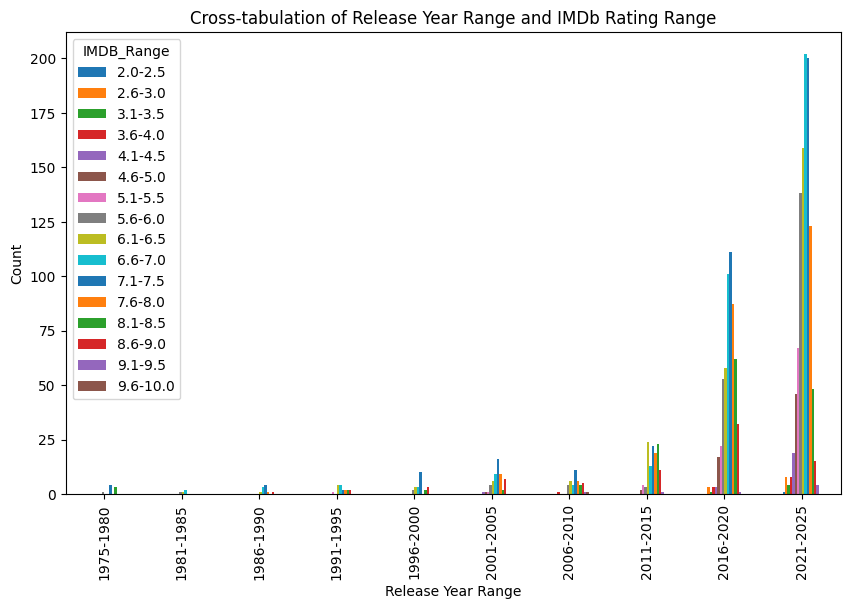

In [ ]:
import matplotlib.pyplot as plt

# Create the cross-tabulation dataframe
crosstab_data = pd.crosstab(unexploded_df['Release_Year_Range'], unexploded_df['IMDB_Range']).iloc[:-1, :-1]

# Plotting the data
fig, ax = plt.subplots(figsize=(10, 6))
crosstab_data.plot(kind='bar', ax=ax)

# Set labels and title
ax.set_xlabel('Release Year Range')
ax.set_ylabel('Count')
ax.set_title('Cross-tabulation of Release Year Range and IMDb Rating Range')

# Show the plot
plt.show()


Most Netflix content with the release year in the year range 1975-1980 had IMDb ratings between 7.1-7.5.

Most Netflix content with the release year in the year range 1981-1985 had IMDb ratings between 6.6-7.0.

Most Netflix content with the release year in the year range 1986-1990 had IMDb ratings between 6.6-7.0.

Most Netflix content with the release year in the year range 1991-1995 had IMDb ratings between 6.6-7.0.

Most Netflix content with the release year in the year range 1996-2000 had IMDb ratings between 6.6-7.0.

Most Netflix content with the release year in the year range 2001-2005 had IMDb ratings between 6.6-7.0.

Most Netflix content with the release year in the year range 2006-2010 had IMDb ratings between 6.6-7.0.

Most Netflix content with the release year in the year range 2011-2015 had IMDb ratings between 6.1-6.5.

Most Netflix content with the release year in the year range 2016-2020 had IMDb ratings between 7.6-8.0.

Most Netflix content with the release year in the year range 2021-2025 had IMDb ratings between 6.6-7.0.

<ipython-input-1201-b6dc5257e64f>:8: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('Set3')


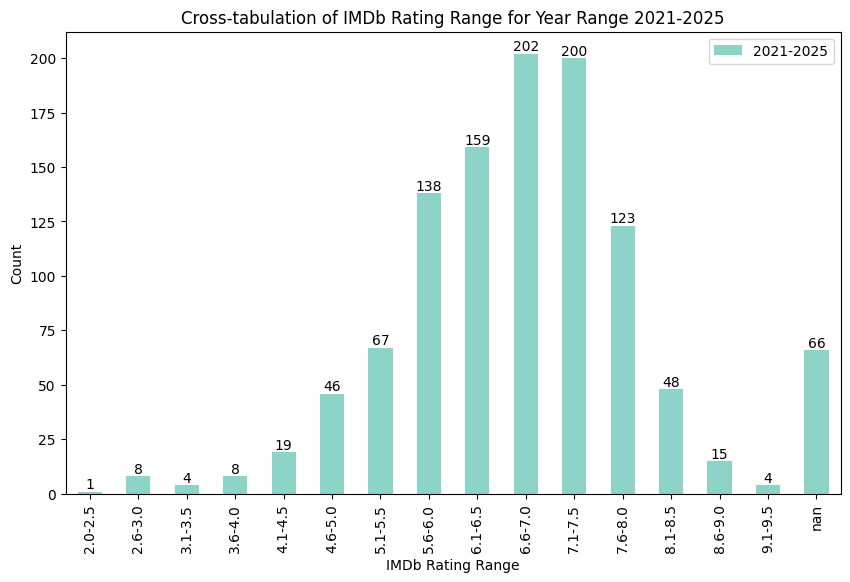

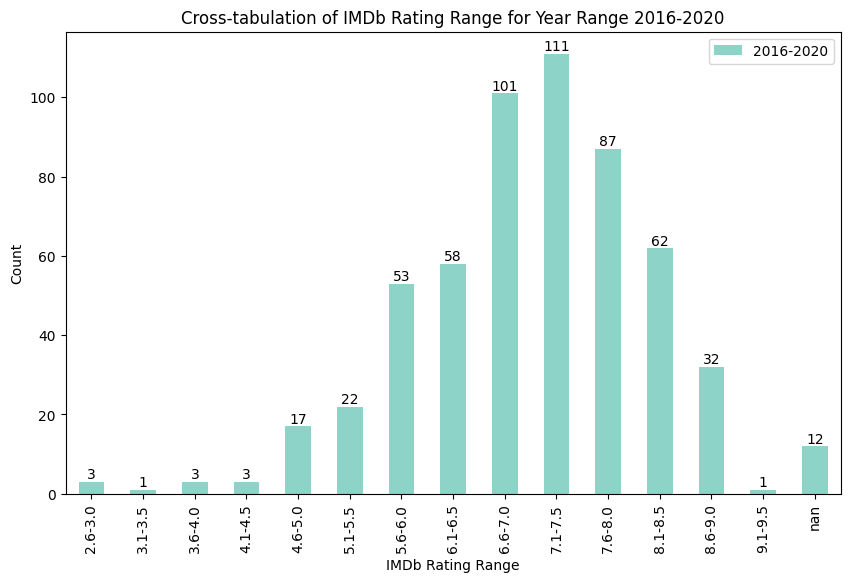

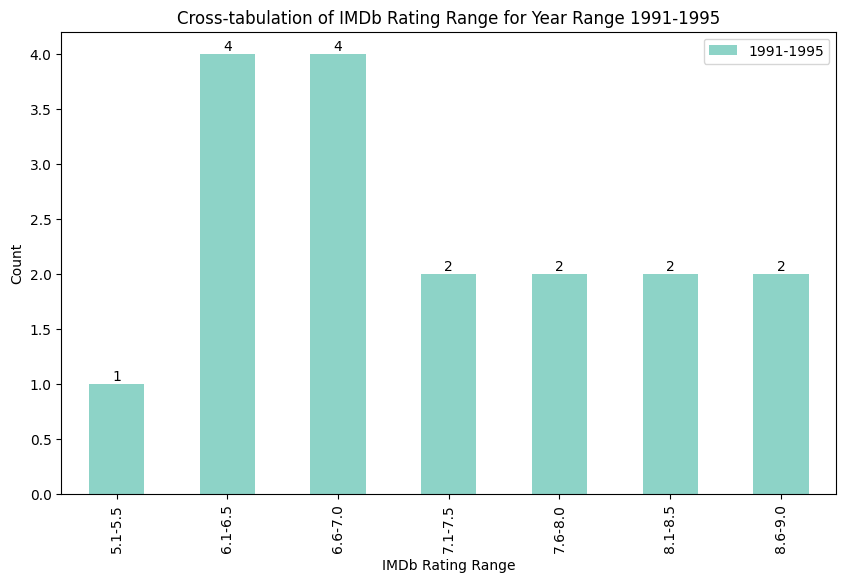

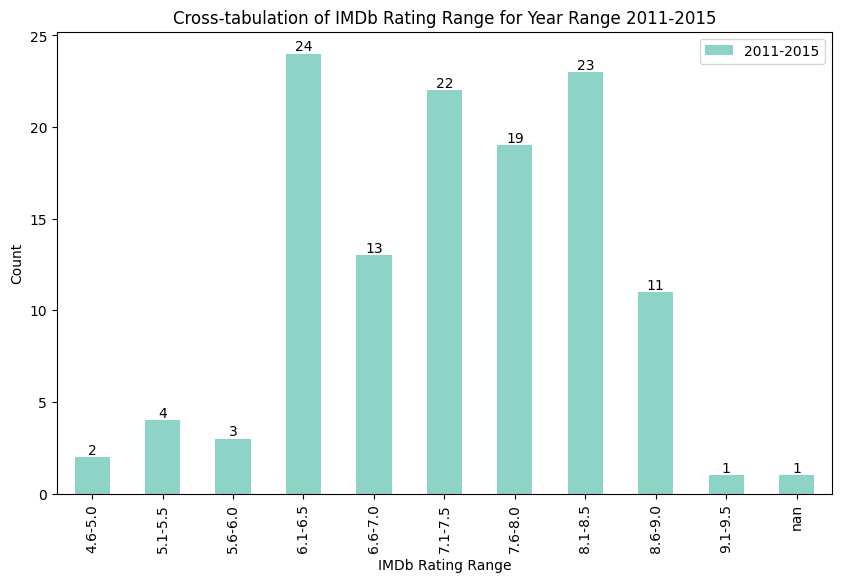

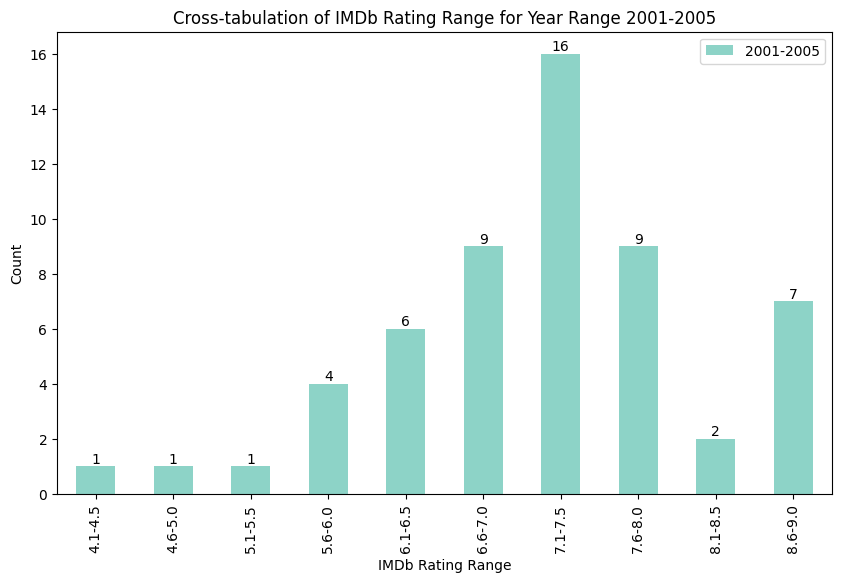

...

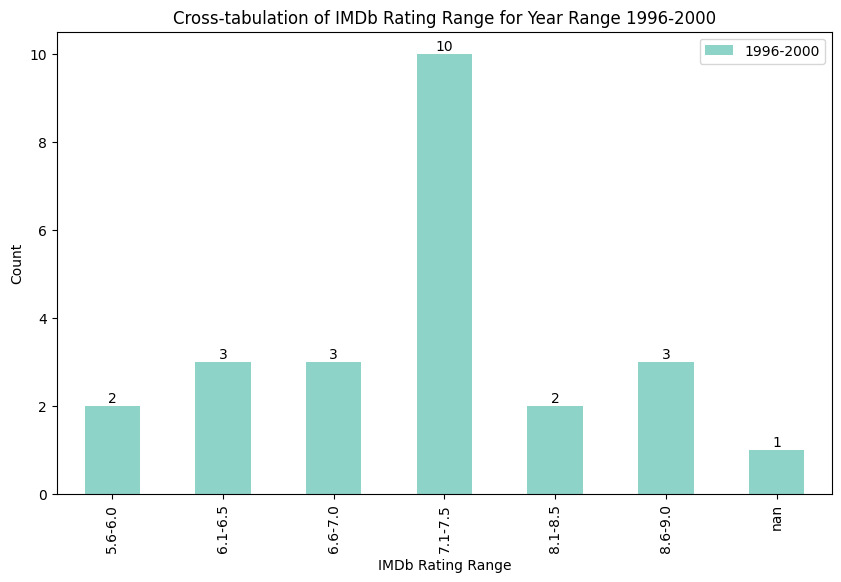

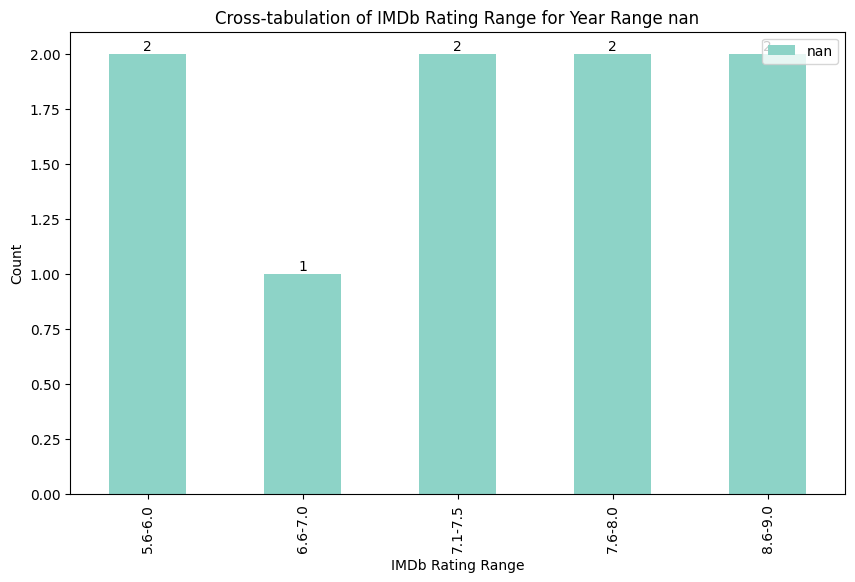

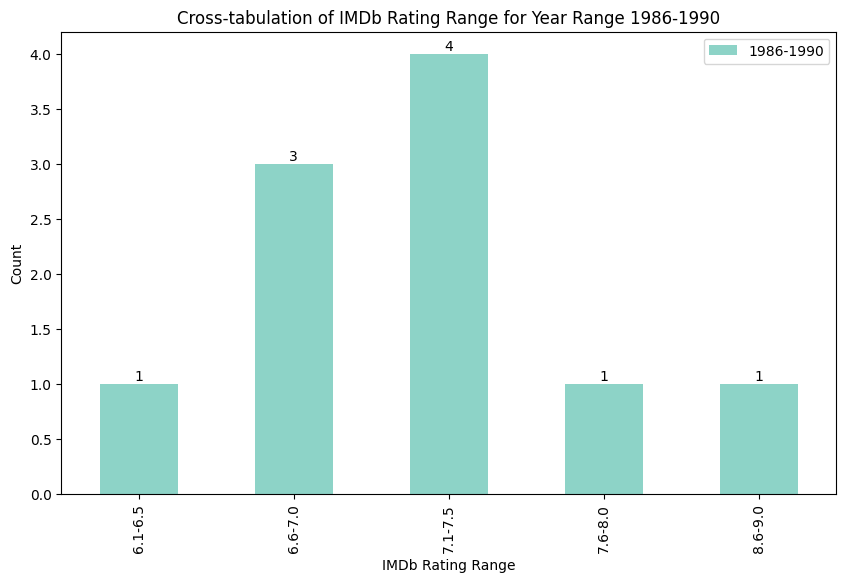

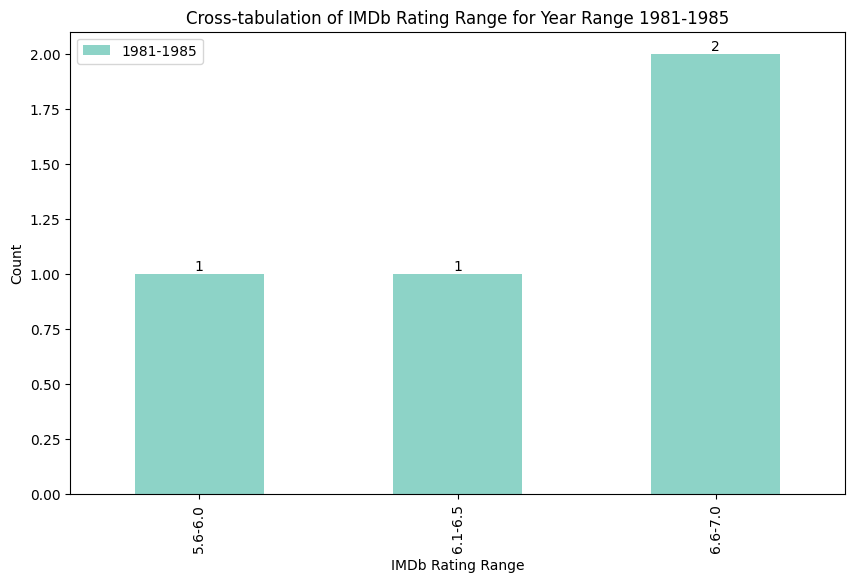

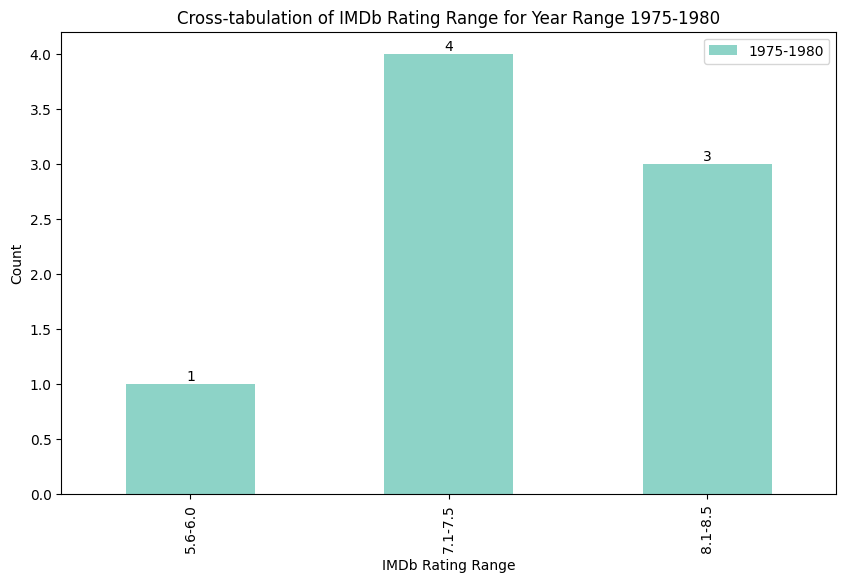

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Get the unique release year ranges
year_ranges = unexploded_df['Release_Year_Range'].unique()

# Define a color map for the bars
color_map = plt.cm.get_cmap('Set3')

# Iterate over each year range and create separate plots
for year_range in year_ranges:
    # Create the cross-tabulation dataframe for the current year range
    crosstab_data = pd.crosstab(unexploded_df[unexploded_df['Release_Year_Range'] == year_range]['IMDB_Range'],
                                unexploded_df[unexploded_df['Release_Year_Range'] == year_range]['Release_Year_Range'])

    # Plotting the data
    fig, ax = plt.subplots(figsize=(10, 6))

    # Get the number of IMDb rating categories
    num_categories = len(crosstab_data.columns)

    # Generate a list of colors based on the color map
    colors = [color_map(i) for i in np.linspace(0, 1, num_categories)]

    # Plot each bar with a different color and add labels
    for i, (colname, color) in enumerate(zip(crosstab_data.columns, colors)):
        crosstab_data[colname].plot(kind='bar', ax=ax, stacked=True, color=color, label=colname)
        for j, value in enumerate(crosstab_data[colname]):
            if value > 0:
                ax.text(j, value, str(value), ha='center', va='bottom')

    # Set labels and title
    ax.set_xlabel('IMDb Rating Range')
    ax.set_ylabel('Count')
    ax.set_title(f'Cross-tabulation of IMDb Rating Range for Year Range {year_range}')

    # Add legend
    ax.legend()

    # Show the plot
    plt.show()


# **User Ratings Distribution by Release Year Range**

User Ratings Distribution: The table presents the count of movies and TV shows hosted by Netflix in different release year ranges, categorized by user ratings. Each row represents a specific release year range, and each column represents a range of user ratings.

Varying User Ratings: The counts in each user rating range vary across the different release year ranges. This suggests that the reception and feedback from Netflix users for the content can differ based on the release year.

Increasing Counts in High User Ratings: There is a noticeable increase in the counts of movies and TV shows with higher user ratings (801-850, 751-800, 701-750, 651-700, 601-650, 551-600) in the more recent release year ranges (2016-2020, 2021-2025). This indicates that Netflix has been able to acquire and host content that is well-received by its users in recent years.

Mixed User Ratings: There is a mix of movies and TV shows across different user rating ranges in each release year range. This suggests that Netflix offers a diverse range of content options that cater to varying user preferences and opinions.

Importance of Recent Releases: The higher counts in the 2021-2025 release year range across various user rating ranges indicate Netflix's focus on acquiring and hosting more recent content. This demonstrates their strategy to provide up-to-date and highly rated movies and TV shows to attract and satisfy their user base.

Higher User Ratings in Recent Years: The 2016-2020 and 2021-2025 release year ranges show higher counts in the higher user rating ranges compared to earlier years. This suggests that Netflix has been successful in acquiring and producing content that resonates well with its users in recent times.

In [ ]:
pd.crosstab(unexploded_df['Release_Year_Range'], unexploded_df['UserRatings_Range']).iloc[:-1, :-1]

UserRatings_Range,1-50,101-150,151-200,201-250,251-300,301-350,351-400,401-450,451-500,501-550,51-100,551-600,601-650,651-700,701-750,751-800,801-850
Release_Year_Range,,,,,,,,,,,,,,,,,
1975-1980,2,1,0,1,0,0,0,1,0,0,1,2,0,0,0,0,0
1981-1985,1,0,1,1,0,0,0,0,0,0,1,0,0,0,0,0,0
1986-1990,1,2,0,1,0,1,0,1,0,0,4,0,0,0,0,0,0
1991-1995,4,3,4,0,1,0,0,0,0,0,0,0,0,1,0,0,0
1996-2000,3,6,3,2,2,1,0,0,0,0,4,0,0,1,0,0,0
2001-2005,17,5,4,7,5,1,3,2,0,0,7,0,0,1,0,0,1
2006-2010,12,7,3,2,1,4,1,1,1,1,3,1,1,1,0,0,1
2011-2015,40,15,10,6,7,5,2,3,4,1,15,2,1,1,2,1,0
2016-2020,356,27,16,5,7,6,1,3,1,2,55,3,2,0,0,0,0


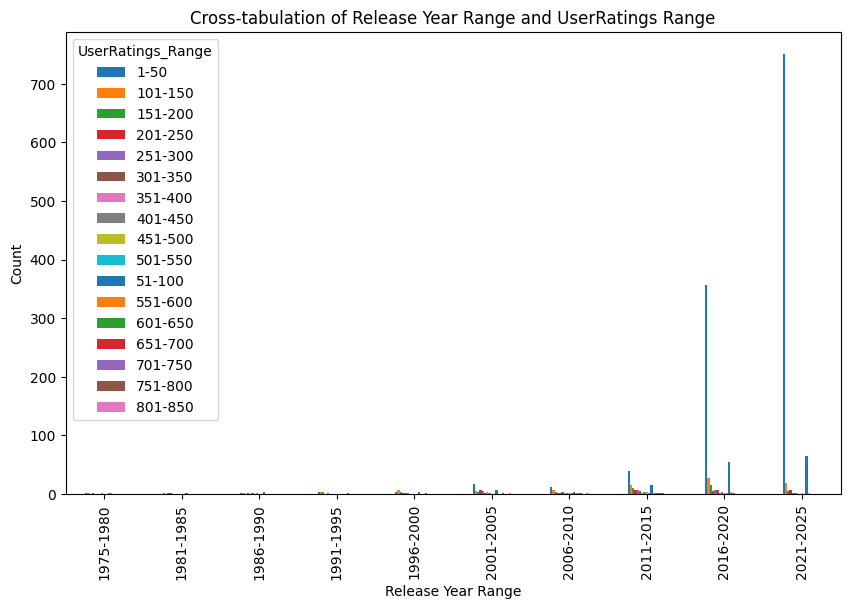

In [ ]:
import matplotlib.pyplot as plt

# Create the cross-tabulation dataframe
crosstab_data = pd.crosstab(unexploded_df['Release_Year_Range'], unexploded_df['UserRatings_Range']).iloc[:-1, :-1]

# Plotting the data
fig, ax = plt.subplots(figsize=(10, 6))
crosstab_data.plot(kind='bar', ax=ax)

# Set labels and title
ax.set_xlabel('Release Year Range')
ax.set_ylabel('Count')
ax.set_title('Cross-tabulation of Release Year Range and UserRatings Range')

# Show the plot
plt.show()


Most Netflix content with the release year in the year range 1975-1980 had User Ratings between 51-100.

Most Netflix content with the release year in the year range 1981-1985 had User Ratings between 1-50.

Most Netflix content with the release year in the year range 1986-1990 had User Ratings between 51-100.

Most Netflix content with the release year in the year range 1991-1995 had User Ratings between 1-50.

Most Netflix content with the release year in the year range 1996-2000 had User Ratings between 51-100.

Most Netflix content with the release year in the year range 2001-2005 had User Ratings between 1-50.

Most Netflix content with the release year in the year range 2006-2010 had User Ratings between 1-50.

Most Netflix content with the release year in the year range 2011-2015 had User Ratings between 1-50.

Most Netflix content with the release year in the year range 2016-2020 had User Ratings between 501-550.

Most Netflix content with the release year in the year range 2021-2025 had User Ratings between 751-800.

<ipython-input-1204-60f760d78ec5>:8: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('Set3')


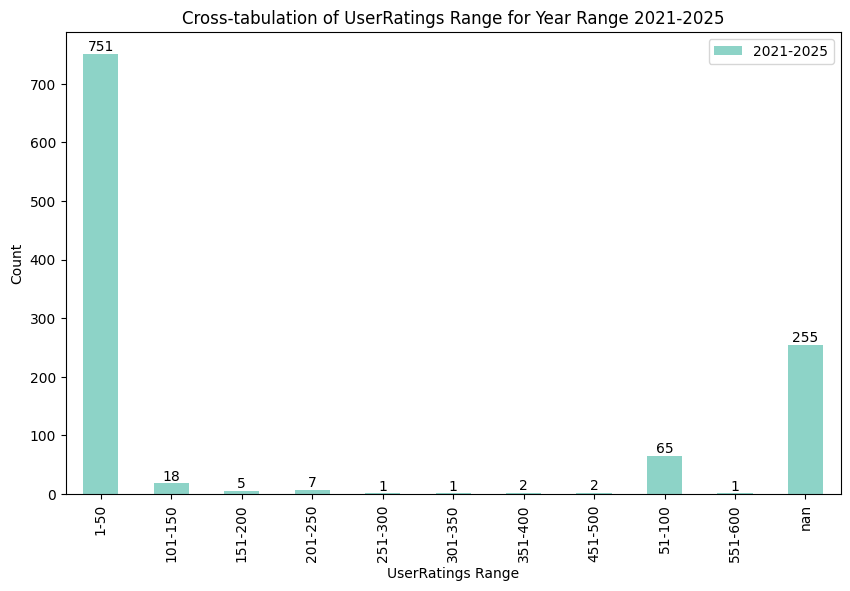

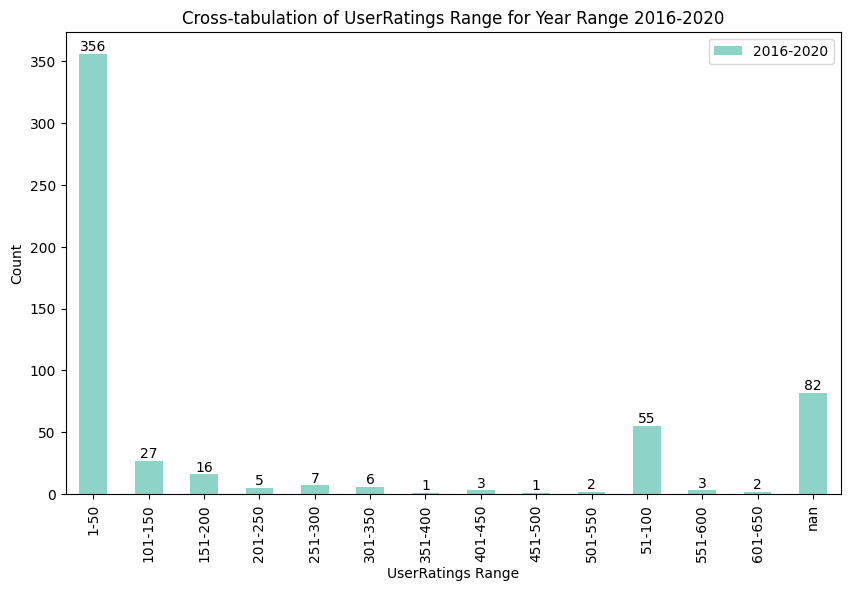

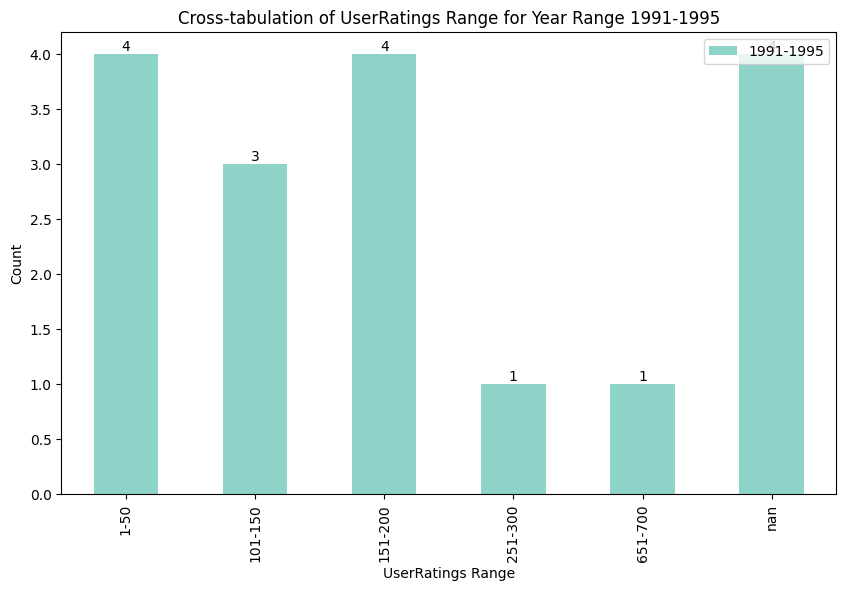

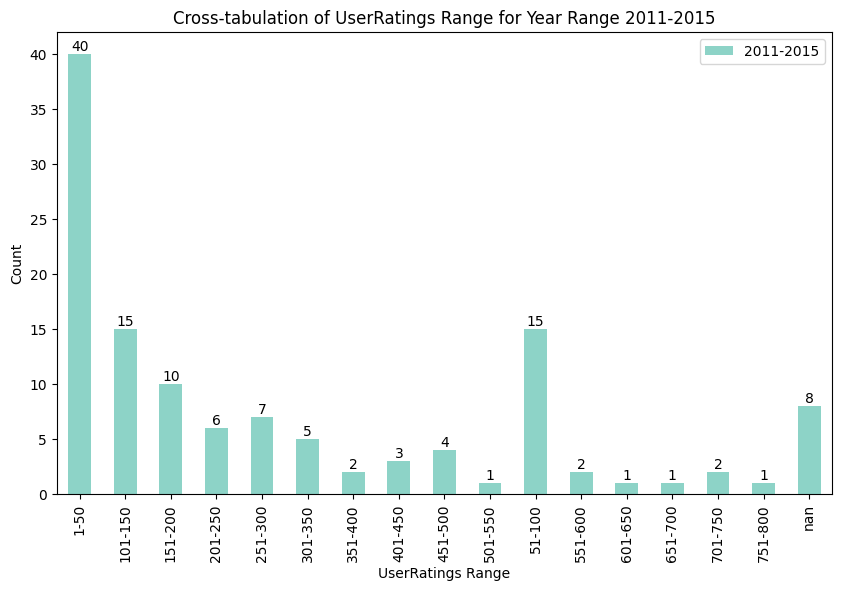

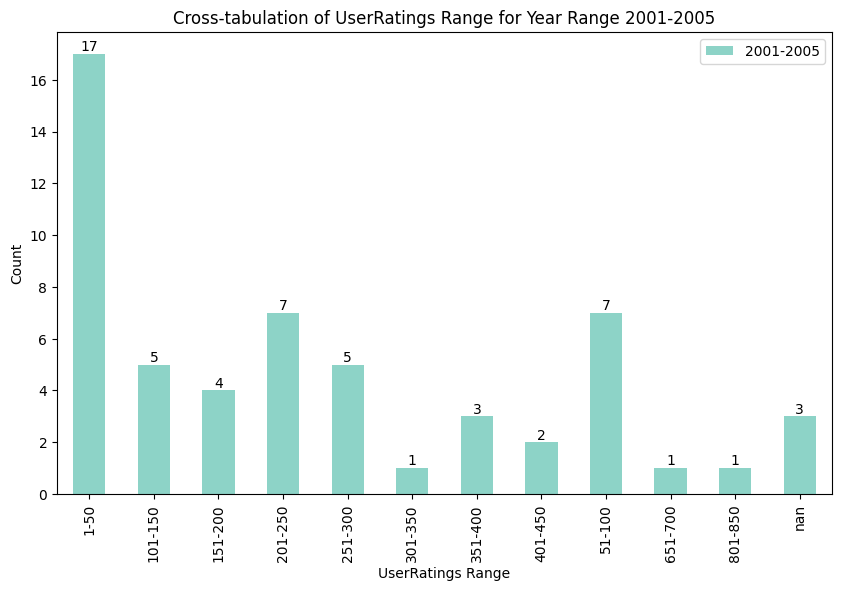

...

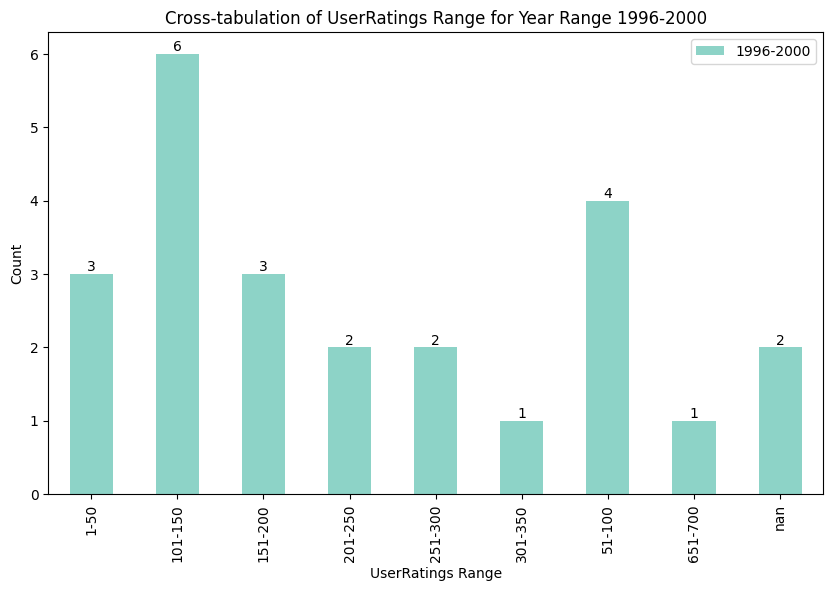

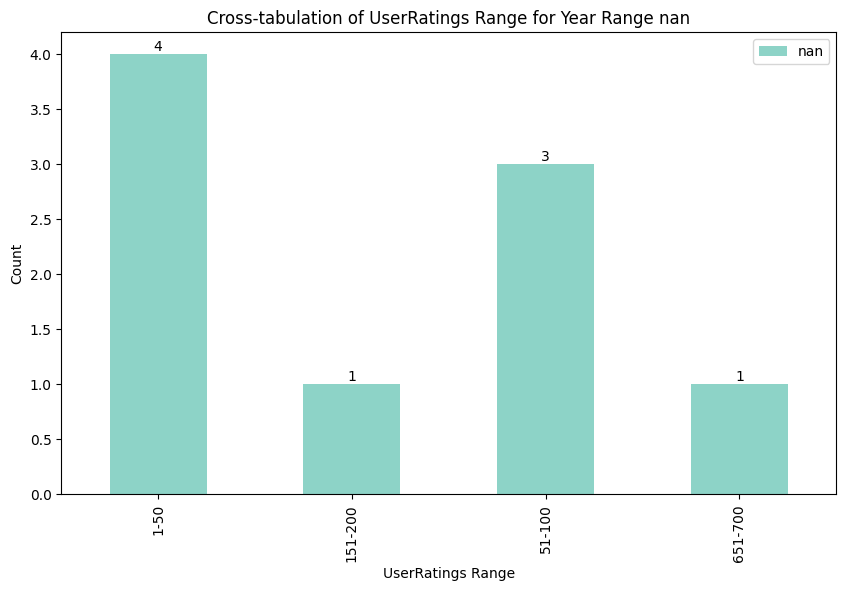

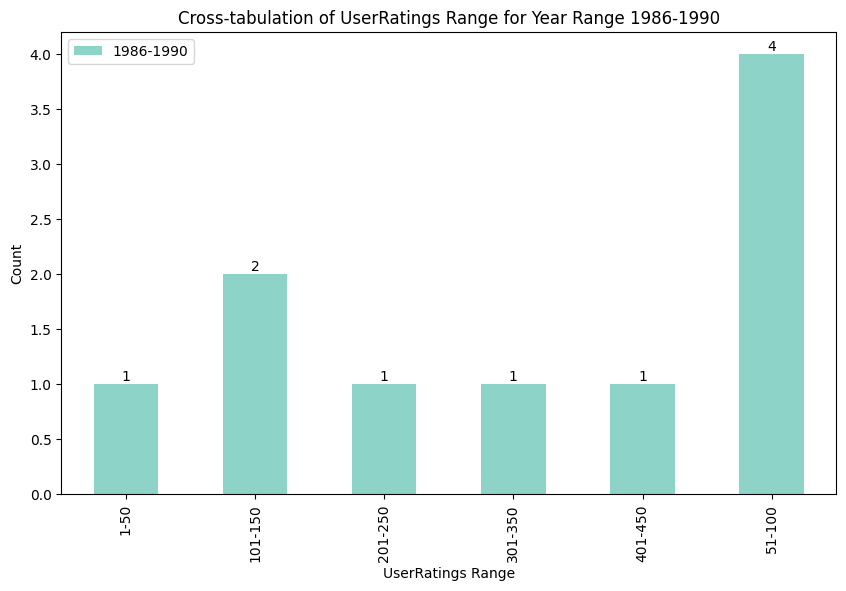

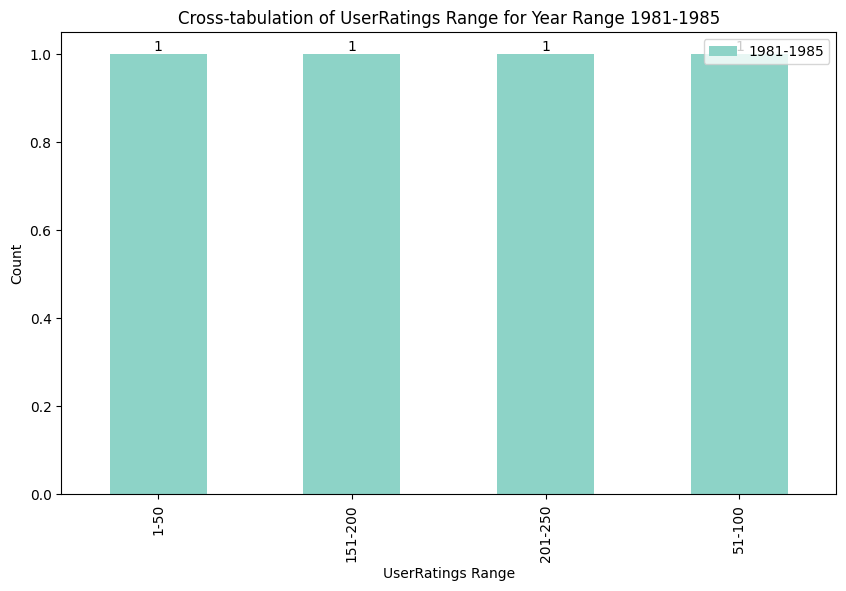

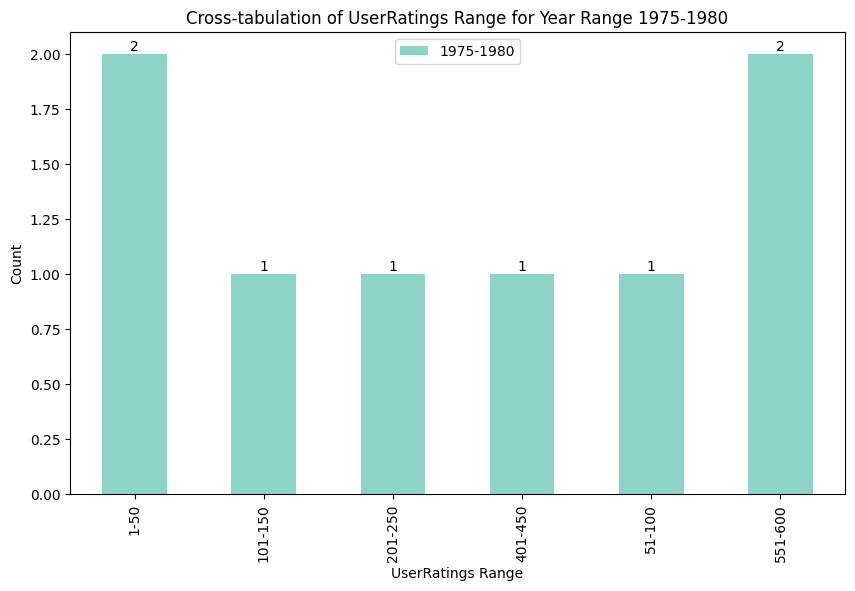

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Get the unique release year ranges
year_ranges = unexploded_df['Release_Year_Range'].unique()

# Define a color map for the bars
color_map = plt.cm.get_cmap('Set3')

# Iterate over each year range and create separate plots
for year_range in year_ranges:
    # Create the cross-tabulation dataframe for the current year range
    crosstab_data = pd.crosstab(unexploded_df[unexploded_df['Release_Year_Range'] == year_range]['UserRatings_Range'],
                                unexploded_df[unexploded_df['Release_Year_Range'] == year_range]['Release_Year_Range'])

    # Plotting the data
    fig, ax = plt.subplots(figsize=(10, 6))

    # Get the number of User rating categories
    num_categories = len(crosstab_data.columns)

    # Generate a list of colors based on the color map
    colors = [color_map(i) for i in np.linspace(0, 1, num_categories)]

    # Plot each bar with a different color and add labels
    for i, (colname, color) in enumerate(zip(crosstab_data.columns, colors)):
        crosstab_data[colname].plot(kind='bar', ax=ax, stacked=True, color=color, label=colname)
        for j, value in enumerate(crosstab_data[colname]):
            if value > 0:
                ax.text(j, value, str(value), ha='center', va='bottom')

    # Set labels and title
    ax.set_xlabel('UserRatings Range')
    ax.set_ylabel('Count')
    ax.set_title(f'Cross-tabulation of UserRatings Range for Year Range {year_range}')

    # Add legend
    ax.legend()

    # Show the plot
    plt.show()


#**Distribution of Runtime for Movies**

Normally Distributed indicating that the data is evenly spread out.

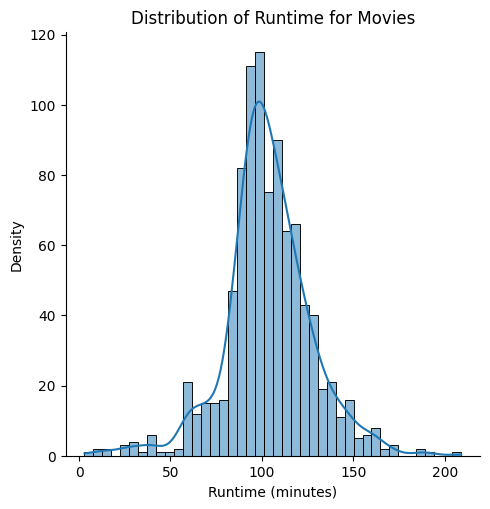

In [ ]:
# Filter the dataframe for the "movies" category
movies_unexploded_df = unexploded_df[unexploded_df['Category'] == 'Movie']

# Extract the runtime data for movies
runtime_data = movies_unexploded_df['Runtime_In_Minutes']

# Plot the displot
sns.displot(runtime_data,kde = True)

# Add labels and title
plt.xlabel('Runtime (minutes)')
plt.ylabel('Density')
plt.title('Distribution of Runtime for Movies')

# Show the plot
plt.show()

# **Distribution of Just Watch Rating in Percentage for Movies**

Left skewed indicating that the majority of the data points are concentrated towards the right side of the distribution, and there are a few extreme values on the left side.

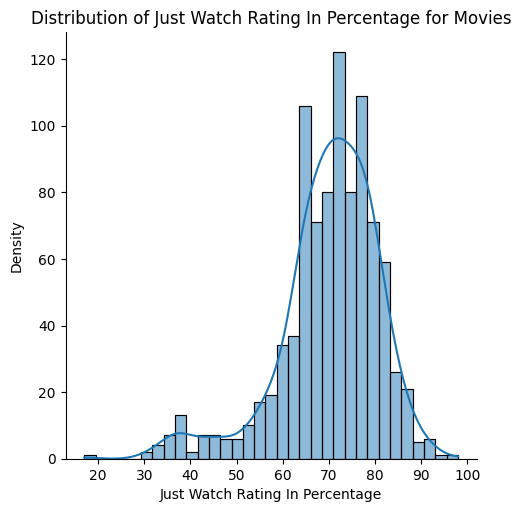

In [ ]:
# Extract the Just Watch Rating In Percentage data for movies
just_watch_per_data = movies_unexploded_df['Just_Watch_Rating_In_Percentage']

# Plot the displot
sns.displot(just_watch_per_data, kde = True)

# Add labels and title
plt.xlabel('Just Watch Rating In Percentage')
plt.ylabel('Density')
plt.title('Distribution of Just Watch Rating In Percentage for Movies')

# Show the plot
plt.show()

# **Distribution of IMDB Rating for Movies**

Slightly skewed left indicating that the most of the data points are concentrated towards the rights side of the distribution, and there are a few extreme values on the left side.

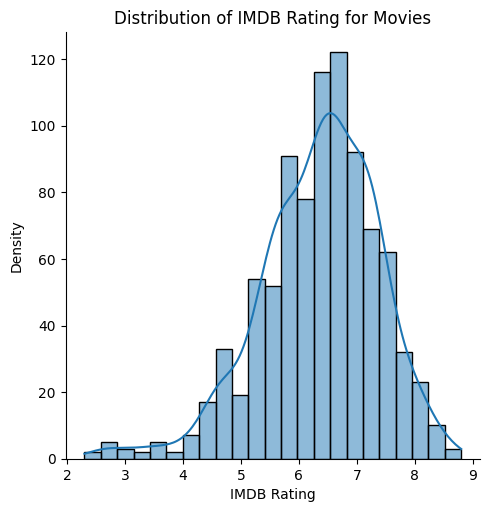

In [ ]:
# Extract the IMDB Rating data for movies
IMDB_Rating_data = movies_unexploded_df['IMDB_Rating']

# Plot the displot
sns.displot(IMDB_Rating_data,kde = True)

# Add labels and title
plt.xlabel('IMDB Rating')
plt.ylabel('Density')
plt.title('Distribution of IMDB Rating for Movies')

# Show the plot
plt.show()

# **Distribution of User Ratings for Movies**

Right skewed indicating that the majority of the data points are concentrated towards the left side of the distribution, and there are a few extreme values on the right side.

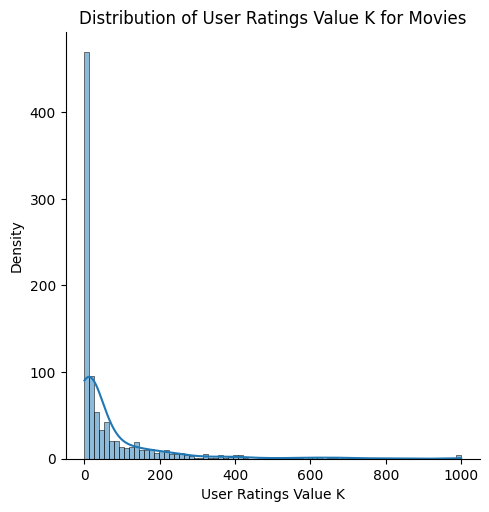

In [ ]:
# Extract the User Ratings Value K data for movies
User_Ratings_Value_K_data = movies_unexploded_df['User_Ratings_Value_K']

# Plot the displot
sns.displot(User_Ratings_Value_K_data,kde = True)

# Add labels and title
plt.xlabel('User Ratings Value K')
plt.ylabel('Density')
plt.title('Distribution of User Ratings Value K for Movies')

# Show the plot
plt.show()

# **Distribution of Runtime for TV Shows**

Right skewed indicating that the majority of the data points are concentrated towards the left side of the distribution, and there are a few extreme values on the right side.

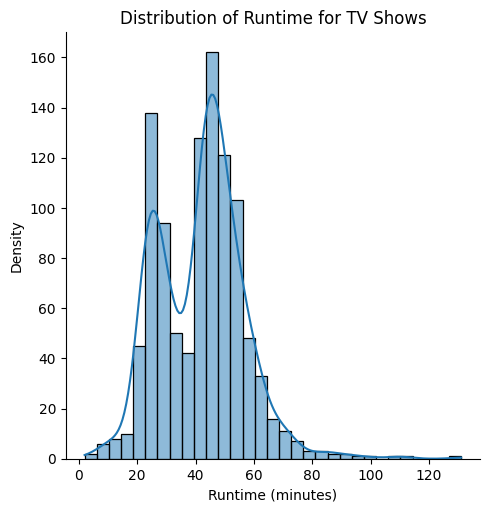

In [ ]:
# Filter the dataframe for the "tv shows" category
tvshow_unexploded_df = unexploded_df[unexploded_df['Category'] == 'TV-Show']

# Extract the runtime data for tv shows
tv_runtime_data = tvshow_unexploded_df['Runtime_In_Minutes']

# Plot the displot
sns.displot(tv_runtime_data, kde = True)

# Add labels and title
plt.xlabel('Runtime (minutes)')
plt.ylabel('Density')
plt.title('Distribution of Runtime for TV Shows')

# Show the plot
plt.show()

# **Distribution of Just Watch Rating In Percentage for TV Shows**

Left skewed indicating that the majority of the data points are concentrated towards the right side of the distribution, and there are a few extreme values on the left side.

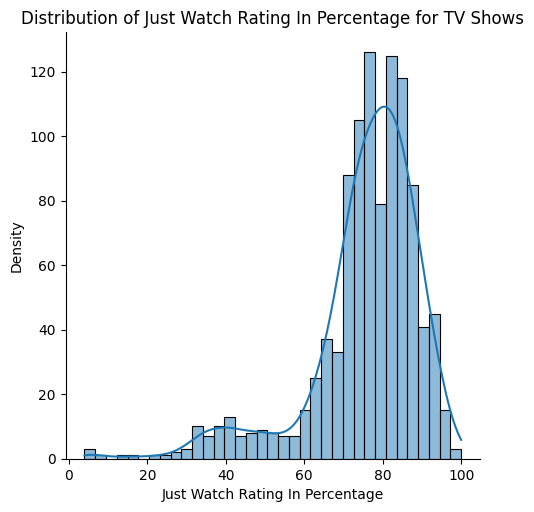

In [ ]:
# Extract the Just Watch Rating In Percentage data for tv shows
tv_just_watch_per_data = tvshow_unexploded_df['Just_Watch_Rating_In_Percentage']

# Plot the displot
sns.displot(tv_just_watch_per_data, kde = True)

# Add labels and title
plt.xlabel('Just Watch Rating In Percentage')
plt.ylabel('Density')
plt.title('Distribution of Just Watch Rating In Percentage for TV Shows')

# Show the plot
plt.show()

# **Distribution of IMDB Rating for TV Shows**

Left skewed indicating that the majority of the data points are concentrated towards the right side of the distribution, and there are a few extreme values on the left side.

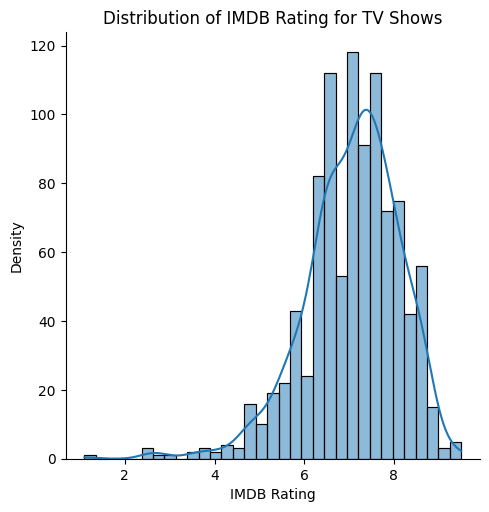

In [ ]:
# Extract the IMDB Rating data for tv shows
tv_IMDB_Rating_data = tvshow_unexploded_df['IMDB_Rating']

# Plot the displot
sns.displot(tv_IMDB_Rating_data,kde = True)

# Add labels and title
plt.xlabel('IMDB Rating')
plt.ylabel('Density')
plt.title('Distribution of IMDB Rating for TV Shows')


# Show the plot
plt.show()

# **Distribution of User Ratings Value K for TV Shows**
Right skewed indicating that the majority of the data points are concentrated towards the left side of the distribution, and there are a few extreme values on the right side.

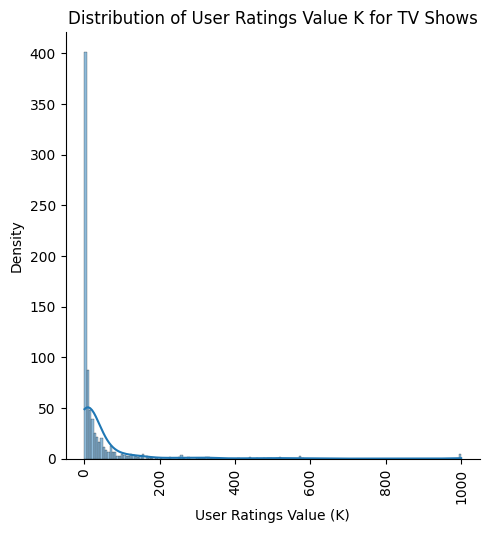

In [ ]:
# Extract the User Ratings Value K data for TV shows
tv_User_Ratings_Value_K_data = tvshow_unexploded_df['User_Ratings_Value_K']

# Plot the histogram
sns.displot(tv_User_Ratings_Value_K_data, kde=True)

# Add labels and title
plt.xlabel('User Ratings Value (K)')
plt.ylabel('Density')
plt.title('Distribution of User Ratings Value K for TV Shows')

# Rotate x-axis labels
plt.xticks(rotation=90)

# Show the plot
plt.show()


In [ ]:
movies_unexploded_df.head()

,Title,Category,Director,Release_Year,Release_Year_Range,Runtime_In_Minutes,Runtime_Range,Combined_Genre,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
1039,¡Que Viva México!,Movie,Luis Estrada,2023,2021-2025,191,190-195,"Drama, Comedy",74.0,70-80,5.5,5.6-6.0,1.0,1-50
1040,11:11,Movie,Karim Abouzeid,2015,2016-2020,60,60-65,"Science-Fiction, Drama, Music & Musical, Myste...",43.0,40-50,6.7,6.6-7.0,0.0,nan
1041,12 Strong,Movie,Nicolai Fuglsig,2018,2016-2020,130,130-135,"Drama, History, War & Military, Action & Adven...",71.0,70-80,6.5,6.6-7.0,86.0,51-100
1042,14 Peaks: Nothing Is Impossible,Movie,Torquil Jones,2021,2021-2025,101,100-105,"Documentary, Sport",82.0,80-90,7.7,7.6-8.0,27.0,1-50
1043,365 Days,Movie,Tomasz Mandes,2020,2021-2025,114,110-115,"Drama, Romance, Made in Europe",59.0,50-60,3.3,3.1-3.5,93.0,51-100


In [ ]:
movies_unexploded_df.dtypes

Title                                object
Category                             object
Director                             object
Release_Year                          int64
Release_Year_Range                   object
Runtime_In_Minutes                    int64
Runtime_Range                      category
Combined_Genre                       object
Just_Watch_Rating_In_Percentage     float64
JustWatch_Range                      object
IMDB_Rating                         float64
IMDB_Range                           object
User_Ratings_Value_K                float64
UserRatings_Range                    object
dtype: object

# **Correlation of Netflix Movie Dataset Variables**


**Release_Year and Runtime_In_Minutes:**
The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately -0.134. This indicates a weak negative correlation.

**Release_Year and Just_Watch_Rating_In_Percentage:**
The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.205. This suggests a weak negative correlation.

**Release_Year and IMDB_Rating:**
The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.242. This indicates a weak negative correlation.

**Release_Year and User_Ratings_Value_K:**
The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.455. This suggests a moderate negative correlation.

**Runtime_In_Minutes and Just_Watch_Rating_In_Percentage:**
The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.353. This suggests a moderate positive correlation.

**Runtime_In_Minutes and IMDB_Rating:**
The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.185. This indicates a weak positive correlation.

**Runtime_In_Minutes and User_Ratings_Value_K:**
The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.304. This suggests a moderate positive correlation.

**Just_Watch_Rating_In_Percentage and IMDB_Rating:**
The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.898. This indicates a strong positive correlation.

**Just_Watch_Rating_In_Percentage and User_Ratings_Value_K**:
The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.371. This suggests a moderate positive correlation.

**IMDB_Rating and User_Ratings_Value_K:**
The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.376. This suggests a moderate positive correlation.

In [ ]:
movies_unexploded_df.corr()

<ipython-input-1215-ca5c24e0b8ed>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  movies_unexploded_df.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,-0.134425,-0.205387,-0.242332,-0.455412
Runtime_In_Minutes,-0.134425,1.000000,0.353405,0.184961,0.303586
Just_Watch_Rating_In_Percentage,-0.205387,0.353405,1.000000,0.898097,0.371026
IMDB_Rating,-0.242332,0.184961,0.898097,1.000000,0.375995
User_Ratings_Value_K,-0.455412,0.303586,0.371026,0.375995,1.000000


<ipython-input-1216-3d4aa7729652>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(movies_unexploded_df.corr(),cmap='coolwarm',annot=True)


<Axes: >

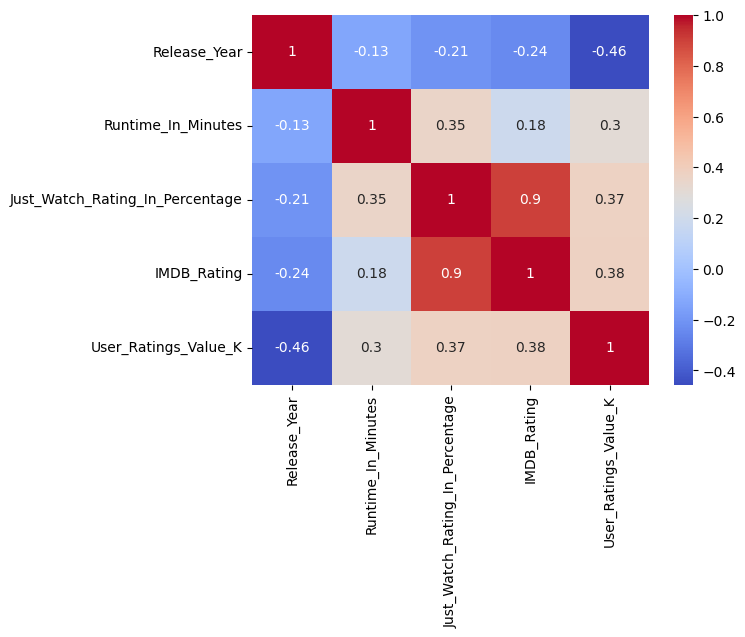

In [ ]:
sns.heatmap(movies_unexploded_df.corr(),cmap='coolwarm',annot=True)

## **Movie Dataset Summary Statistics**


**Release_Year:**

**Count**: There are 930 movies in the dataset.

**Mean**: The average release year of the movies is approximately 2016.58.

**Standard Deviation (Std)**: The release years have a standard deviation of approximately 9.38. This indicates a moderate amount of variation in the release years of the movies.

**Minimum (Min)**: The earliest release year in the dataset is 1954.

**25th Percentile (25%)**: 25% of the movies have a release year before or equal to 2016.

**Median (50%)**: The median release year is 2020, which represents the middle value when the release years are sorted in ascending order.

**75th Percentile (75%)**: 75% of the movies have a release year before or equal to 2022.

**Maximum (Max)**: The most recent release year in the dataset is 2023.

****

**Runtime_In_Minutes:**

**Count**: There are 930 movies in the dataset.

**Mean**: The average runtime of the movies is approximately 103.38 minutes.

**Std**: The runtime values have a standard deviation of approximately 23.89. This indicates a moderate amount of variation in the movie runtimes.

**Min**: The shortest movie in the dataset has a runtime of 3 minutes.

**25%**: 25% of the movies have a runtime of 92 minutes or less.

**Median**: The median runtime is 102 minutes, representing the middle value when the runtimes are sorted in ascending order.

**75%**: 75% of the movies have a runtime of 116 minutes or less.

**Max**: The longest movie in the dataset has a runtime of 209 minutes.


****

**Just_Watch_Rating_In_Percentage:**

**Count**: There are 930 movies in the dataset.

**Mean**: The average Just Watch rating percentage is approximately 70.11%.

**Std**: The Just Watch rating percentages have a standard deviation of approximately 10.82. This indicates a moderate amount of variation in the ratings.

**Min**: The lowest Just Watch rating percentage in the dataset is 17%.

**25%**: 25% of the movies have a Just Watch rating percentage of 65% or lower.

**Median**: The median Just Watch rating percentage is 71%, representing the middle value when the ratings are sorted in ascending order.

**75%**: 75% of the movies have a Just Watch rating percentage of 77% or lower.

**Max**: The highest Just Watch rating percentage in the dataset is 98%.

****

**IMDB_Rating:**

**Count**: There are 899 movies in the dataset with available IMDB ratings.

**Mean**: The average IMDB rating of the movies is approximately 6.35.

**Std**: The IMDB ratings have a standard deviation of approximately 1.02. This indicates a moderate amount of variation in the ratings.

**Min**: The lowest IMDB rating in the dataset is 2.3.

**25%**: 25% of the movies have an IMDB rating of 5.7 or lower.

**Median**: The median IMDB rating is 6.5, representing the middle value when the ratings are sorted in ascending order.

**75%**: 75% of the movies have an IMDB rating of 7.1 or lower.

**Max**: The highest IMDB rating in the dataset is 8

In [ ]:
movies_unexploded_df.describe()

,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,930.000000,930.000000,930.000000,899.000000,930.000000
mean,2016.579570,103.383871,70.113978,6.346496,70.558065
std,9.380522,23.891754,10.817396,1.023682,139.152948
min,1954.000000,3.000000,17.000000,2.300000,0.000000
25%,2016.000000,92.000000,65.000000,5.700000,3.000000
50%,2020.000000,102.000000,71.000000,6.500000,13.000000
75%,2022.000000,116.000000,77.000000,7.100000,67.750000
max,2023.000000,209.000000,98.000000,8.800000,1000.000000


In [ ]:
movie_correlation_matrix = movies_unexploded_df.corr()
movie_correlation_table = movie_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
movie_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']



# Define the correlation threshold
#threshold = 0.5

# Add a conditional column based on the correlation threshold
movie_correlation_table['Correlation Type'] = movie_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')

# Add a conditional column based on the correlation strength
movie_correlation_table['Correlation Strength'] = movie_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > 0.5 else 'Weak')

movie_correlation_table

<ipython-input-1218-4f6c51b180ab>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  movie_correlation_matrix = movies_unexploded_df.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.898097,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.898097,Positive,Strong
7,User_Ratings_Value_K,IMDB_Rating,0.375995,Positive,Weak
8,IMDB_Rating,User_Ratings_Value_K,0.375995,Positive,Weak
9,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.371026,Positive,Weak


# **Correlation of TV Shows Dataset Variables**

**Release_Year and Runtime_In_Minutes**: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately 0.215. This indicates a weak positive correlation.


**Release_Year and Just_Watch_Rating_In_Percentage**: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.252. This indicates a weak negative correlation.


**Release_Year and IMDB_Rating**: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.286. This indicates a weak negative correlation.


**Release_Year and User_Ratings_Value_K**: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.244. This indicates a weak negative correlation.


**Runtime_In_Minutes and Just_Watch_Rating_In_Percentage**: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.055. This indicates a very weak positive correlation.


**Runtime_In_Minutes and IMDB_Rating**: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.164. This indicates a weak positive correlation.


**Runtime_In_Minutes and User_Ratings_Value_K**: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.106. This indicates a very weak positive correlation.


**Just_Watch_Rating_In_Percentage and IMDB_Rating**: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.742. This indicates a strong positive correlation.


**Just_Watch_Rating_In_Percentage and User_Ratings_Value_K**: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.338. This indicates a moderate positive correlation.


**IMDB_Rating and User_Ratings_Value_K**: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.339. This indicates a moderate positive correlation.

In [ ]:
tvshow_unexploded_df.corr()

<ipython-input-1219-e004c32782ed>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  tvshow_unexploded_df.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,0.215348,-0.251636,-0.285875,-0.243900
Runtime_In_Minutes,0.215348,1.000000,0.055014,0.163629,0.105750
Just_Watch_Rating_In_Percentage,-0.251636,0.055014,1.000000,0.742006,0.337513
IMDB_Rating,-0.285875,0.163629,0.742006,1.000000,0.339263
User_Ratings_Value_K,-0.243900,0.105750,0.337513,0.339263,1.000000


<ipython-input-1220-2f3a2533c5f3>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(tvshow_unexploded_df.corr(),cmap='coolwarm',annot=True)


<Axes: >

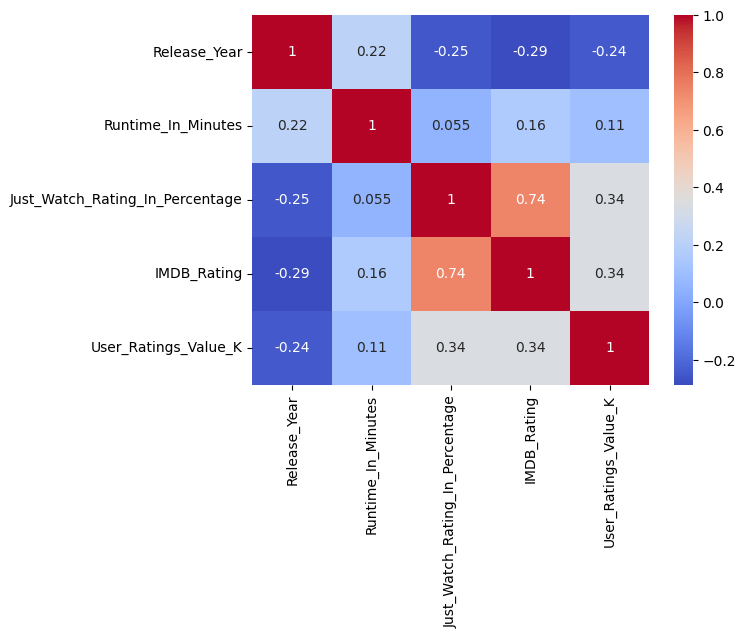

In [ ]:
sns.heatmap(tvshow_unexploded_df.corr(),cmap='coolwarm',annot=True)

In [ ]:
tvshow_correlation_matrix = tvshow_unexploded_df.corr()
tvshow_correlation_table = tvshow_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
tvshow_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']



# Define the correlation threshold
threshold = 0.5

# Add a conditional column based on the correlation threshold
tvshow_correlation_table['Correlation Type'] = tvshow_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')

# Add a conditional column based on the correlation strength
tvshow_correlation_table['Correlation Strength'] = tvshow_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')

tvshow_correlation_table

<ipython-input-1221-8deaeaf8fdcf>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  tvshow_correlation_matrix = tvshow_unexploded_df.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.742006,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.742006,Positive,Strong
7,User_Ratings_Value_K,IMDB_Rating,0.339263,Positive,Weak
8,IMDB_Rating,User_Ratings_Value_K,0.339263,Positive,Weak
9,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.337513,Positive,Weak


# **TV Shows Dataset Summary Statistics**

**Release_Year:**

Count: There are 1039 TV shows in the dataset.

**Mean**: The average release year of the TV shows is approximately 2018.82.

**Standard Deviation (Std)**: The release years have a standard deviation of approximately 5.26. This indicates a relatively low amount of variation in the release years of the TV shows.

**Minimum (Min)**: The earliest release year in the dataset is 1969.

**25th Percentile (25%)**: 25% of the TV shows have a release year before or equal to 2018.

**Median (50%)**: The median release year is 2020, which represents the middle value when the release years are sorted in ascending order.

**75th Percentile (75%)**: 75% of the TV shows have a release year before or equal to 2022.

**Maximum (Max)**: The most recent release year in the dataset is 2023.
****

**Runtime_In_Minutes**:

**Count**: There are 1039 TV shows in the dataset.

**Mean**: The average runtime of the TV shows is approximately 41.85 minutes.

**Standard Deviation (Std)**: The runtimes have a standard deviation of approximately 14.72 minutes. This indicates a moderate amount of variation in the durations of the TV shows.

**Minimum (Min)**: The shortest TV show in the dataset has a runtime of 2 minutes.

**25th Percentile (25%)**: 25% of the TV shows have a runtime of 29 minutes or less.

**Median (50%)**: The median runtime is 43 minutes, which represents the middle value when the runtimes are sorted in ascending order.

**75th Percentile (75%)**: 75% of the TV shows have a runtime of 50.5 minutes or less.

**Maximum (Max)**: The longest TV show in the dataset has a runtime of 131 minutes.
****
**Just_Watch_Rating_In_Percentage**:

**Count**: There are 1039 TV shows in the dataset.

**Mean**: The average Just Watch rating percentage of the TV shows is approximately 75.64%.

**Standard Deviation (Std)**: The Just Watch rating percentages have a standard deviation of approximately 14.12%. This indicates a moderate amount of variation in the ratings.

**Minimum (Min)**: The lowest Just Watch rating percentage in the dataset is 4%.

**25th Percentile (25%)**: 25% of the TV shows have a Just Watch rating percentage of 71% or lower.

**Median (50%)**: The median Just Watch rating percentage is 78%, which represents the middle value when the ratings are sorted in ascending order.

**75th Percentile (75%)**: 75% of the TV shows have a Just Watch rating percentage of 85% or lower.

**Maximum (Max)**: The highest Just Watch rating percentage in the dataset is 100%.
****

**IMDB_Rating**:

**Count**: There are 990 TV shows in the dataset.

**Mean**: The average IMDb rating of the TV shows is approximately 7.07.

**Standard Deviation (Std)**: The IMDb ratings have a standard deviation of approximately 1.06. This indicates a relatively low amount of variation in the ratings.

**Minimum (Min)**: The lowest IMDb rating in the dataset is 1.1.

**25th Percentile (25%)**: 25% of the TV shows have an IMDb rating of 6.5 or lower.

**Median (50%)**: The median IMDb rating is 7.2, which represents the middle value when the ratings are sorted in ascending order.

**75th Percentile (75%)**: 75% of the TV shows have an IMDb rating of 7.8 or lower.

**Maximum (Max)**: The highest IMDb rating in the dataset is
9.5.
****
**User_Ratings_Value_K**:

**Count**: There are 800 TV shows in the dataset.

**Mean**: The average user ratings value (in thousands) of the TV shows is approximately 44.04.

**Standard Deviation (Std)**: The user ratings values have a standard deviation of approximately 113.26. This indicates a large amount of variation in the user ratings.

**Minimum (Min)**: The lowest user ratings value in the dataset is 1,000.

**25th Percentile (25%)**: 25% of the TV shows have a user ratings value of 3,000 or lower.

**Median (50%)**: The median user ratings value is 7,000, which represents the middle value when the ratings are sorted in ascending order.

**75th Percentile (75%)**: 75% of the TV shows have a user ratings value of 31,250 or lower.

**Maximum (Max)**: The highest user ratings value in the dataset is 1,000,000.

In [ ]:
tvshow_unexploded_df.describe()

,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,1039.000000,1039.000000,1039.000000,990.000000,800.000000
mean,2018.818094,41.848893,75.642926,7.071010,44.036250
std,5.259968,14.720101,14.118632,1.057181,113.262352
min,1969.000000,2.000000,4.000000,1.100000,1.000000
25%,2018.000000,29.000000,71.000000,6.500000,3.000000
50%,2020.000000,43.000000,78.000000,7.200000,7.000000
75%,2022.000000,50.500000,85.000000,7.800000,31.250000
max,2023.000000,131.000000,100.000000,9.500000,1000.000000


# **df Dataset: Exploded dataset when genres delimited by row.

In [ ]:
df = pd.read_excel('/content/final_combined_dataset.xlsx')
df

,Title,Category,Just_Watch_Link,Director,Release_Year,Genre,Runtime,Runtime_In_Minutes,Combined_Rating,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings,User_Ratings_Value_K,IMDB_Link
0,#blackAF,TV-Show,https://www.justwatch.com/us/tv-show/blackaf,Kenya Barris,2020,Comedy,37min,37,0.38,38.0,0.0,No Value,0,No Link
1,(Un)Well,TV-Show,https://www.justwatch.com/us/tv-show/un-well,No Value,2020,Reality TV,52min,52,69% 6.4 (1k),69.0,6.4,1K,1,https://www.imdb.com/title/tt12759384/?ref_=ju...
2,(Un)Well,TV-Show,https://www.justwatch.com/us/tv-show/un-well,No Value,2020,Documentary,52min,52,69% 6.4 (1k),69.0,6.4,1K,1,https://www.imdb.com/title/tt12759384/?ref_=ju...
3,13 Reasons Why,TV-Show,https://www.justwatch.com/us/tv-show/13-reason...,Dylan Minnette,2017,Drama,58min,58,84% 7.5 (302k),84.0,7.5,302K,302,https://www.imdb.com/title/tt1837492/?ref_=jus...
4,13 Reasons Why,TV-Show,https://www.justwatch.com/us/tv-show/13-reason...,Dylan Minnette,2017,Mystery & Thriller,58min,58,84% 7.5 (302k),84.0,7.5,302K,302,https://www.imdb.com/title/tt1837492/?ref_=jus...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5677,Zombieland,Movie,https://www.justwatch.com/us/movie/zombieland,Ruben Fleischer,2009,Fantasy,1h 28min,88,82% 7.6 (595k),82.0,7.6,595K,595,https://www.imdb.com/title/tt1156398/?ref_=jus...
5678,Zookeeper,Movie,https://www.justwatch.com/us/movie/zookeeper,Frank Coraci,2011,Comedy,1h 42min,102,60% 5.2 (63k),60.0,5.2,63K,63,https://www.imdb.com/title/tt1222817/?ref_=jus...
5679,Zookeeper,Movie,https://www.justwatch.com/us/movie/zookeeper,Frank Coraci,2011,Romance,1h 42min,102,60% 5.2 (63k),60.0,5.2,63K,63,https://www.imdb.com/title/tt1222817/?ref_=jus...
5680,Zookeeper,Movie,https://www.justwatch.com/us/movie/zookeeper,Frank Coraci,2011,Kids & Family,1h 42min,102,60% 5.2 (63k),60.0,5.2,63K,63,https://www.imdb.com/title/tt1222817/?ref_=jus...


# **Drop unimportant columns**

In [ ]:
colums_to_drop = ['Just_Watch_Link', 'Runtime', 'Combined_Rating','User_Ratings','IMDB_Link']

# Drop the specified columns
cleaned_df = df.drop(columns=colums_to_drop)

# Print the modified DataFrame
cleaned_df
df = cleaned_df

In [ ]:
df

,Title,Category,Director,Release_Year,Genre,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
0,#blackAF,TV-Show,Kenya Barris,2020,Comedy,37,38.0,0.0,0
1,(Un)Well,TV-Show,No Value,2020,Reality TV,52,69.0,6.4,1
2,(Un)Well,TV-Show,No Value,2020,Documentary,52,69.0,6.4,1
3,13 Reasons Why,TV-Show,Dylan Minnette,2017,Drama,58,84.0,7.5,302
4,13 Reasons Why,TV-Show,Dylan Minnette,2017,Mystery & Thriller,58,84.0,7.5,302
...,...,...,...,...,...,...,...,...,...
5677,Zombieland,Movie,Ruben Fleischer,2009,Fantasy,88,82.0,7.6,595
5678,Zookeeper,Movie,Frank Coraci,2011,Comedy,102,60.0,5.2,63
5679,Zookeeper,Movie,Frank Coraci,2011,Romance,102,60.0,5.2,63
5680,Zookeeper,Movie,Frank Coraci,2011,Kids & Family,102,60.0,5.2,63


# **Assign ranges for numerical data columns as shown below**

In [ ]:
bins = [1975, 1980, 1985, 1990, 1995, 2000, 2005, 2010, 2015, 2020, 2025]

# Define the labels for the ranges
labels = ['1975-1980', '1981-1985', '1986-1990', '1991-1995', '1996-2000',
          '2001-2005', '2006-2010', '2011-2015', '2016-2020', '2021-2025']

# Create the new column based on the ranges
df['Release_Year_Range'] = pd.cut(df['Release_Year'], bins=bins, labels=labels, right=False)

# Print the updated DataFrame
df.head()

,Title,Category,Director,Release_Year,Genre,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K,Release_Year_Range
0,#blackAF,TV-Show,Kenya Barris,2020,Comedy,37,38.0,0.0,0,2021-2025
1,(Un)Well,TV-Show,No Value,2020,Reality TV,52,69.0,6.4,1,2021-2025
2,(Un)Well,TV-Show,No Value,2020,Documentary,52,69.0,6.4,1,2021-2025
3,13 Reasons Why,TV-Show,Dylan Minnette,2017,Drama,58,84.0,7.5,302,2016-2020
4,13 Reasons Why,TV-Show,Dylan Minnette,2017,Mystery & Thriller,58,84.0,7.5,302,2016-2020


In [ ]:
# Get the column names of the DataFrame
columns = df.columns.tolist()

# Remove the last column from the list of columns
last_column = columns.pop()

# Insert the last column at the desired position (5th column)
columns.insert(4, last_column)

# Reorder the DataFrame columns based on the updated column order
df = df[columns]

# Print the DataFrame with the column moved
df

,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
0,#blackAF,TV-Show,Kenya Barris,2020,2021-2025,Comedy,37,38.0,0.0,0
1,(Un)Well,TV-Show,No Value,2020,2021-2025,Reality TV,52,69.0,6.4,1
2,(Un)Well,TV-Show,No Value,2020,2021-2025,Documentary,52,69.0,6.4,1
3,13 Reasons Why,TV-Show,Dylan Minnette,2017,2016-2020,Drama,58,84.0,7.5,302
4,13 Reasons Why,TV-Show,Dylan Minnette,2017,2016-2020,Mystery & Thriller,58,84.0,7.5,302
...,...,...,...,...,...,...,...,...,...,...
5677,Zombieland,Movie,Ruben Fleischer,2009,2006-2010,Fantasy,88,82.0,7.6,595
5678,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Comedy,102,60.0,5.2,63
5679,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Romance,102,60.0,5.2,63
5680,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Kids & Family,102,60.0,5.2,63


In [ ]:
# Define the range bins
imdb_bins = [2.0, 2.5, 3.0, 3.5, 4.0, 4.5, 5.0, 5.5, 6.0, 6.5, 7.0, 7.5, 8.0, 8.5, 9.0, 9.5, 10.0]

# Define the labels for the ranges
imdb_labels = ['2.0-2.5', '2.6-3.0', '3.1-3.5', '3.6-4.0', '4.1-4.5', '4.6-5.0', '5.1-5.5',
          '5.6-6.0', '6.1-6.5', '6.6-7.0', '7.1-7.5', '7.6-8.0', '8.1-8.5', '8.6-9.0', '9.1-9.5', '9.6-10.0']

# Create the new column based on the ranges
df['IMDB_Range'] = pd.cut(df['IMDB_Rating'], bins=imdb_bins, labels=imdb_labels, right=False)

# Print the updated DataFrame
df

<ipython-input-1228-9648d42ed94e>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['IMDB_Range'] = pd.cut(df['IMDB_Rating'], bins=imdb_bins, labels=imdb_labels, right=False)


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K,IMDB_Range
0,#blackAF,TV-Show,Kenya Barris,2020,2021-2025,Comedy,37,38.0,0.0,0,NaN
1,(Un)Well,TV-Show,No Value,2020,2021-2025,Reality TV,52,69.0,6.4,1,6.1-6.5
2,(Un)Well,TV-Show,No Value,2020,2021-2025,Documentary,52,69.0,6.4,1,6.1-6.5
3,13 Reasons Why,TV-Show,Dylan Minnette,2017,2016-2020,Drama,58,84.0,7.5,302,7.6-8.0
4,13 Reasons Why,TV-Show,Dylan Minnette,2017,2016-2020,Mystery & Thriller,58,84.0,7.5,302,7.6-8.0
...,...,...,...,...,...,...,...,...,...,...,...
5677,Zombieland,Movie,Ruben Fleischer,2009,2006-2010,Fantasy,88,82.0,7.6,595,7.6-8.0
5678,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Comedy,102,60.0,5.2,63,5.1-5.5
5679,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Romance,102,60.0,5.2,63,5.1-5.5
5680,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Kids & Family,102,60.0,5.2,63,5.1-5.5


In [ ]:
columns = df.columns.tolist()
columns

['Title',
 'Category',
 'Director',
 'Release_Year',
 'Release_Year_Range',
 'Genre',
 'Runtime_In_Minutes',
 'Just_Watch_Rating_In_Percentage',
 'IMDB_Rating',
 'User_Ratings_Value_K',
 'IMDB_Range']

In [ ]:
# Remove the last column from the list of columns
last_column = columns.pop()

# Insert the last column at the desired position (10th column)
columns.insert(9, last_column)

# Reorder the DataFrame columns based on the updated column order
df = df[columns]

# Print the DataFrame with the column moved
df

,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,IMDB_Range,User_Ratings_Value_K
0,#blackAF,TV-Show,Kenya Barris,2020,2021-2025,Comedy,37,38.0,0.0,NaN,0
1,(Un)Well,TV-Show,No Value,2020,2021-2025,Reality TV,52,69.0,6.4,6.1-6.5,1
2,(Un)Well,TV-Show,No Value,2020,2021-2025,Documentary,52,69.0,6.4,6.1-6.5,1
3,13 Reasons Why,TV-Show,Dylan Minnette,2017,2016-2020,Drama,58,84.0,7.5,7.6-8.0,302
4,13 Reasons Why,TV-Show,Dylan Minnette,2017,2016-2020,Mystery & Thriller,58,84.0,7.5,7.6-8.0,302
...,...,...,...,...,...,...,...,...,...,...,...
5677,Zombieland,Movie,Ruben Fleischer,2009,2006-2010,Fantasy,88,82.0,7.6,7.6-8.0,595
5678,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Comedy,102,60.0,5.2,5.1-5.5,63
5679,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Romance,102,60.0,5.2,5.1-5.5,63
5680,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Kids & Family,102,60.0,5.2,5.1-5.5,63


In [ ]:
# Define the range bins
just_watch_bins = [0, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100]

# Define the labels for the ranges
just_watch_labels = ['0-10', '10-20', '20-30', '30-40', '40-50', '50-60', '60-70', '70-80', '80-90', '90-100']

# Create the new column based on the ranges
df['JustWatch_Range'] = pd.cut(df['Just_Watch_Rating_In_Percentage'], bins=just_watch_bins, labels=just_watch_labels, right=False)

# Print the updated DataFrame
df

<ipython-input-1231-ea5763706e72>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['JustWatch_Range'] = pd.cut(df['Just_Watch_Rating_In_Percentage'], bins=just_watch_bins, labels=just_watch_labels, right=False)


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,JustWatch_Range
0,#blackAF,TV-Show,Kenya Barris,2020,2021-2025,Comedy,37,38.0,0.0,NaN,0,30-40
1,(Un)Well,TV-Show,No Value,2020,2021-2025,Reality TV,52,69.0,6.4,6.1-6.5,1,60-70
2,(Un)Well,TV-Show,No Value,2020,2021-2025,Documentary,52,69.0,6.4,6.1-6.5,1,60-70
3,13 Reasons Why,TV-Show,Dylan Minnette,2017,2016-2020,Drama,58,84.0,7.5,7.6-8.0,302,80-90
4,13 Reasons Why,TV-Show,Dylan Minnette,2017,2016-2020,Mystery & Thriller,58,84.0,7.5,7.6-8.0,302,80-90
...,...,...,...,...,...,...,...,...,...,...,...,...
5677,Zombieland,Movie,Ruben Fleischer,2009,2006-2010,Fantasy,88,82.0,7.6,7.6-8.0,595,80-90
5678,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Comedy,102,60.0,5.2,5.1-5.5,63,60-70
5679,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Romance,102,60.0,5.2,5.1-5.5,63,60-70
5680,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Kids & Family,102,60.0,5.2,5.1-5.5,63,60-70


In [ ]:
columns = df.columns.tolist()

# Remove the last column from the list of columns
last_column = columns.pop()

# Insert the last column at the desired position (5th column)
columns.insert(8, last_column)

# Reorder the DataFrame columns based on the updated column order
df = df[columns]

# Print the DataFrame with the column moved
df

,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K
0,#blackAF,TV-Show,Kenya Barris,2020,2021-2025,Comedy,37,38.0,30-40,0.0,NaN,0
1,(Un)Well,TV-Show,No Value,2020,2021-2025,Reality TV,52,69.0,60-70,6.4,6.1-6.5,1
2,(Un)Well,TV-Show,No Value,2020,2021-2025,Documentary,52,69.0,60-70,6.4,6.1-6.5,1
3,13 Reasons Why,TV-Show,Dylan Minnette,2017,2016-2020,Drama,58,84.0,80-90,7.5,7.6-8.0,302
4,13 Reasons Why,TV-Show,Dylan Minnette,2017,2016-2020,Mystery & Thriller,58,84.0,80-90,7.5,7.6-8.0,302
...,...,...,...,...,...,...,...,...,...,...,...,...
5677,Zombieland,Movie,Ruben Fleischer,2009,2006-2010,Fantasy,88,82.0,80-90,7.6,7.6-8.0,595
5678,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Comedy,102,60.0,60-70,5.2,5.1-5.5,63
5679,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Romance,102,60.0,60-70,5.2,5.1-5.5,63
5680,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Kids & Family,102,60.0,60-70,5.2,5.1-5.5,63


In [ ]:

# Define the range bins
user_bins = [1, 50, 100, 150, 200, 250, 300, 350, 400, 450, 500, 550, 600, 650, 700, 750, 800, 850, 900, 950, 1000]

# Define the labels for the ranges
user_labels = ['1-50', '51-100', '101-150', '151-200', '201-250', '251-300', '301-350', '351-400',
          '401-450', '451-500', '501-550', '551-600', '601-650', '651-700', '701-750', '751-800',
          '801-850', '851-900', '901-950', '951-1000']

# Create the new column based on the ranges
df['UserRatings_Range'] = pd.cut(df['User_Ratings_Value_K'], bins=user_bins, labels=user_labels, right=False)

# Print the updated DataFrame
df


<ipython-input-1233-9b81dfcc75a3>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['UserRatings_Range'] = pd.cut(df['User_Ratings_Value_K'], bins=user_bins, labels=user_labels, right=False)


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
0,#blackAF,TV-Show,Kenya Barris,2020,2021-2025,Comedy,37,38.0,30-40,0.0,NaN,0,NaN
1,(Un)Well,TV-Show,No Value,2020,2021-2025,Reality TV,52,69.0,60-70,6.4,6.1-6.5,1,1-50
2,(Un)Well,TV-Show,No Value,2020,2021-2025,Documentary,52,69.0,60-70,6.4,6.1-6.5,1,1-50
3,13 Reasons Why,TV-Show,Dylan Minnette,2017,2016-2020,Drama,58,84.0,80-90,7.5,7.6-8.0,302,301-350
4,13 Reasons Why,TV-Show,Dylan Minnette,2017,2016-2020,Mystery & Thriller,58,84.0,80-90,7.5,7.6-8.0,302,301-350
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5677,Zombieland,Movie,Ruben Fleischer,2009,2006-2010,Fantasy,88,82.0,80-90,7.6,7.6-8.0,595,551-600
5678,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Comedy,102,60.0,60-70,5.2,5.1-5.5,63,51-100
5679,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Romance,102,60.0,60-70,5.2,5.1-5.5,63,51-100
5680,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Kids & Family,102,60.0,60-70,5.2,5.1-5.5,63,51-100


In [ ]:
# Define the range bins
bins = range(0, 251, 5)  # Bins from 0 to 250 with an interval of 5

# Define the labels for the ranges
labels = [f"{start}-{start+5}" for start in bins[:-1]]  # Labels for each range

# Create the new column based on the ranges
df['Runtime_Range'] = pd.cut(df['Runtime_In_Minutes'], bins=bins, labels=labels, right=False)

# Print the updated DataFrame
df


<ipython-input-1234-33534c081bff>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Runtime_Range'] = pd.cut(df['Runtime_In_Minutes'], bins=bins, labels=labels, right=False)


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range,Runtime_Range
0,#blackAF,TV-Show,Kenya Barris,2020,2021-2025,Comedy,37,38.0,30-40,0.0,NaN,0,NaN,35-40
1,(Un)Well,TV-Show,No Value,2020,2021-2025,Reality TV,52,69.0,60-70,6.4,6.1-6.5,1,1-50,50-55
2,(Un)Well,TV-Show,No Value,2020,2021-2025,Documentary,52,69.0,60-70,6.4,6.1-6.5,1,1-50,50-55
3,13 Reasons Why,TV-Show,Dylan Minnette,2017,2016-2020,Drama,58,84.0,80-90,7.5,7.6-8.0,302,301-350,55-60
4,13 Reasons Why,TV-Show,Dylan Minnette,2017,2016-2020,Mystery & Thriller,58,84.0,80-90,7.5,7.6-8.0,302,301-350,55-60
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5677,Zombieland,Movie,Ruben Fleischer,2009,2006-2010,Fantasy,88,82.0,80-90,7.6,7.6-8.0,595,551-600,85-90
5678,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Comedy,102,60.0,60-70,5.2,5.1-5.5,63,51-100,100-105
5679,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Romance,102,60.0,60-70,5.2,5.1-5.5,63,51-100,100-105
5680,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Kids & Family,102,60.0,60-70,5.2,5.1-5.5,63,51-100,100-105


In [ ]:
columns = df.columns.tolist()

# Remove the last column from the list of columns
last_column = columns.pop()

# Insert the last column at the desired position (5th column)
columns.insert(7, last_column)

# Reorder the DataFrame columns based on the updated column order
df = df[columns]

# Print the DataFrame with the column moved
df

,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
0,#blackAF,TV-Show,Kenya Barris,2020,2021-2025,Comedy,37,35-40,38.0,30-40,0.0,NaN,0,NaN
1,(Un)Well,TV-Show,No Value,2020,2021-2025,Reality TV,52,50-55,69.0,60-70,6.4,6.1-6.5,1,1-50
2,(Un)Well,TV-Show,No Value,2020,2021-2025,Documentary,52,50-55,69.0,60-70,6.4,6.1-6.5,1,1-50
3,13 Reasons Why,TV-Show,Dylan Minnette,2017,2016-2020,Drama,58,55-60,84.0,80-90,7.5,7.6-8.0,302,301-350
4,13 Reasons Why,TV-Show,Dylan Minnette,2017,2016-2020,Mystery & Thriller,58,55-60,84.0,80-90,7.5,7.6-8.0,302,301-350
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5677,Zombieland,Movie,Ruben Fleischer,2009,2006-2010,Fantasy,88,85-90,82.0,80-90,7.6,7.6-8.0,595,551-600
5678,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Comedy,102,100-105,60.0,60-70,5.2,5.1-5.5,63,51-100
5679,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Romance,102,100-105,60.0,60-70,5.2,5.1-5.5,63,51-100
5680,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Kids & Family,102,100-105,60.0,60-70,5.2,5.1-5.5,63,51-100


# **Checking for Null Values**

In [ ]:
df.dtypes

Title                                object
Category                             object
Director                             object
Release_Year                          int64
Release_Year_Range                 category
Genre                                object
Runtime_In_Minutes                    int64
Runtime_Range                      category
Just_Watch_Rating_In_Percentage     float64
JustWatch_Range                    category
IMDB_Rating                         float64
IMDB_Range                         category
User_Ratings_Value_K                  int64
UserRatings_Range                  category
dtype: object

In [ ]:
df.isnull().sum()

Title                                0
Category                             0
Director                             0
Release_Year                         0
Release_Year_Range                  26
Genre                                0
Runtime_In_Minutes                   0
Runtime_Range                        0
Just_Watch_Rating_In_Percentage      0
JustWatch_Range                      3
IMDB_Rating                          0
IMDB_Range                         127
User_Ratings_Value_K                 0
UserRatings_Range                  768
dtype: int64

In [ ]:
df['Release_Year_Range'] = df['Release_Year_Range'].astype(str).fillna('Unknown')
df['JustWatch_Range'] = df['JustWatch_Range'].astype(str).fillna('Unknown')
df['IMDB_Range'] = df['IMDB_Range'].astype(str).fillna('Unknown')
df['UserRatings_Range'] = df['UserRatings_Range'].astype(str).fillna('Unknown')
df.isnull().sum()

Title                              0
Category                           0
Director                           0
Release_Year                       0
Release_Year_Range                 0
Genre                              0
Runtime_In_Minutes                 0
Runtime_Range                      0
Just_Watch_Rating_In_Percentage    0
JustWatch_Range                    0
IMDB_Rating                        0
IMDB_Range                         0
User_Ratings_Value_K               0
UserRatings_Range                  0
dtype: int64

In [ ]:
df.dtypes

Title                                object
Category                             object
Director                             object
Release_Year                          int64
Release_Year_Range                   object
Genre                                object
Runtime_In_Minutes                    int64
Runtime_Range                      category
Just_Watch_Rating_In_Percentage     float64
JustWatch_Range                      object
IMDB_Rating                         float64
IMDB_Range                           object
User_Ratings_Value_K                  int64
UserRatings_Range                    object
dtype: object

In [ ]:
# Convert the column from int to float
df['User_Ratings_Value_K'] = df['User_Ratings_Value_K'].astype(float)


In [ ]:
df.dtypes

Title                                object
Category                             object
Director                             object
Release_Year                          int64
Release_Year_Range                   object
Genre                                object
Runtime_In_Minutes                    int64
Runtime_Range                      category
Just_Watch_Rating_In_Percentage     float64
JustWatch_Range                      object
IMDB_Rating                         float64
IMDB_Range                           object
User_Ratings_Value_K                float64
UserRatings_Range                    object
dtype: object

Category Distribution

In [ ]:
df['Category'].value_counts()

TV-Show    3033
Movie      2649
Name: Category, dtype: int64

# **Genre Counts**

Drama is the most prevalent category with 1,093 entries, indicating a significant presence of dramatic content.

Comedy is the second most common category with 685 entries, suggesting a considerable number of comedic movies or shows.

Mystery & Thriller category follows closely with 574 entries, indicating a substantial offering of suspenseful and mysterious content.

Action & Adventure and Crime categories have 471 and 463 entries, respectively, suggesting a significant presence of action-packed and crime-related content.

Documentary, Science-Fiction, Fantasy, Romance, and Animation categories also have notable representation, each with several hundred entries.

Genres like Horror, Kids & Family, History, Reality TV, Made in Europe, Sport, War & Military, Music & Musical, and Western have relatively fewer entries, indicating a smaller proportion of content in these categories.

The "No Value" category has only 2 entries, which could indicate either missing or undefined category values for those particular entries.

In [ ]:
genre_counts = df['Genre'].value_counts()
genre_counts

Drama                 1093
Comedy                 685
Mystery & Thriller     574
Action & Adventure     471
Crime                  463
Documentary            342
Science-Fiction        307
Fantasy                286
Romance                285
Animation              200
Horror                 191
Kids & Family          189
History                124
Reality TV             117
Made in Europe         107
Sport                   77
War & Military          76
Music & Musical         68
Western                 25
No Value                 2
Name: Genre, dtype: int64

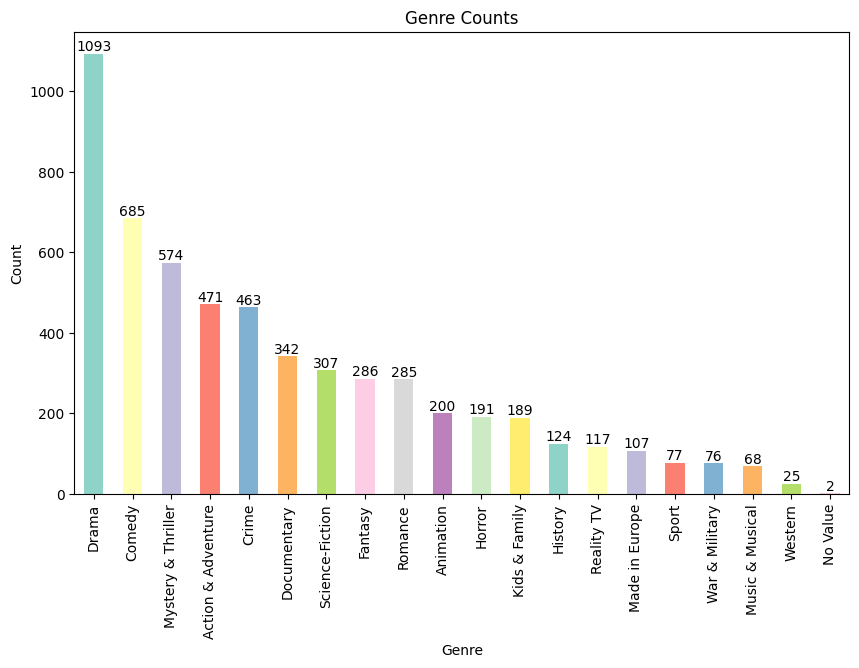

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns


# Define a color palette
color_palette = sns.color_palette('Set3')

# Create a bar plot
plt.figure(figsize=(10, 6))
ax = genre_counts.plot(kind='bar', color=color_palette)

# Set labels and title
plt.xlabel('Genre')
plt.ylabel('Count')
plt.title('Genre Counts')

# Add labels to the bars
for i, v in enumerate(genre_counts):
    ax.text(i, v, str(v), ha='center', va='bottom')

# Show the plot
plt.show()


#**The table provides a breakdown of the number of movies and TV shows hosted by Netflix across different genres.**

**Movie and TV Show Distribution**: The table is divided into two categories: "Movie" and "TV-Show." Each category represents the count of movies and TV shows available on Netflix, respectively.

**Genre Breakdown**: The genres are listed in rows, and the corresponding counts for movies and TV shows are displayed in the respective columns.

**Popular Genres**: Drama has the highest count for both movies (498) and TV shows (595), indicating that Netflix offers a wide selection of dramatic content. Other popular genres include Comedy, Crime, Mystery & Thriller, and Action & Adventure.

**Genre Disparity**: Some genres have a significant difference in counts between movies and TV shows. For example, Animation has a higher count for TV shows (140) compared to movies (60), while Reality TV has a higher count for TV shows (111) compared to movies (6). This suggests that Netflix has focused on acquiring and producing specific genres more heavily for TV shows or movies.

**Genre Preferences**: The genre preferences of Netflix users can be inferred based on the counts. Genres like Comedy, Drama, Mystery & Thriller, and Romance have relatively high counts for both movies and TV shows, indicating their popularity among viewers.

**Niche Genres**: Some genres have relatively lower counts, such as Made in Europe, Music & Musical, Sport, War & Military, and Western. These genres may cater to more specific or niche audience interests.

In [ ]:
pd.crosstab(df['Genre'], df['Category']).drop('No Value', axis=0)

Category,Movie,TV-Show
Genre,,
Action & Adventure,245,226
Animation,60,140
Comedy,368,317
Crime,194,269
Documentary,136,206
Drama,498,595
Fantasy,118,168
History,51,73
Horror,112,79


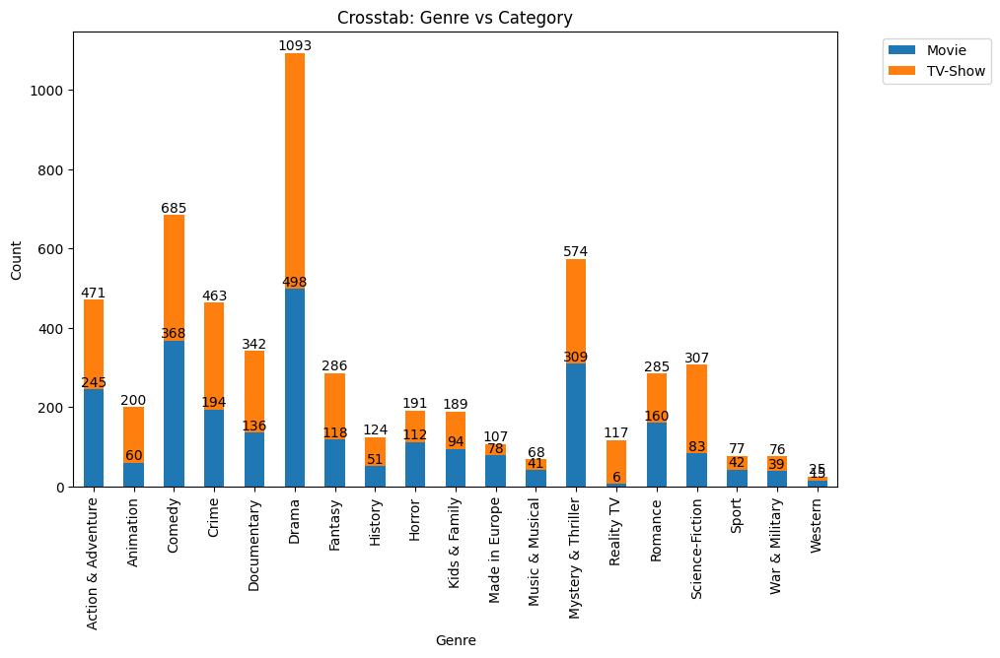

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Perform the crosstabulation and drop a specific row
crosstab_data = pd.crosstab(df['Genre'], df['Category']).drop('No Value', axis=0)

# Plot the crosstab data as a stacked bar graph
ax = crosstab_data.plot(kind='bar', stacked=True, figsize=(10, 6))

# Set labels and title
plt.xlabel('Genre')
plt.ylabel('Count')
plt.title('Crosstab: Genre vs Category')

# Add bar labels
for container in ax.containers:
    ax.bar_label(container)

# Show the legend outside the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# Show the plot
plt.show()


#**The table provides a breakdown of the number of movies and TV shows hosted by Netflix across different genres and release year ranges.**

Release Year Ranges: The release year ranges are listed in columns, representing different periods. Each column represents a specific time frame in which the movies and TV shows were released.

Genre Breakdown: The genres are listed in rows, and the corresponding counts for movies and TV shows are displayed in the respective columns.

Genre Distribution: The table shows the distribution of movies and TV shows across various genres for each release year range. It provides insights into how the availability of content has evolved over time.

Popular Genres: Drama has a consistently high count across all release year ranges, indicating its enduring popularity among Netflix viewers. Other popular genres include Comedy, Action & Adventure, Mystery & Thriller, and Romance.

Genre Preferences Over Time: The counts within each genre for different release year ranges can give an indication of genre preferences over time. For example, the number of Action & Adventure, Animation, and Fantasy movies and TV shows has increased in recent years (2016-2020 and 2021-2025) compared to earlier periods.

Genre Trends: Some genres, such as Documentary, Horror, and Science-Fiction, show variations in counts across different release year ranges, suggesting shifts in audience preferences or changes in content production.

In [ ]:
pd.crosstab(df['Genre'], df['Release_Year_Range']).iloc[:, :-1]

Release_Year_Range,1975-1980,1981-1985,1986-1990,1991-1995,1996-2000,2001-2005,2006-2010,2011-2015,2016-2020,2021-2025
Genre,,,,,,,,,,
Action & Adventure,2,3,1,7,14,26,10,45,123,237
Animation,0,1,1,5,6,11,6,22,60,88
Comedy,5,1,5,10,13,26,17,61,217,327
Crime,0,0,1,3,6,14,7,25,133,273
Documentary,1,0,0,1,1,1,4,5,96,233
Drama,4,2,6,8,13,27,28,81,326,591
Fantasy,1,2,0,6,7,17,8,29,81,135
History,0,0,0,0,1,1,5,6,34,77
Horror,0,0,0,0,3,4,7,15,56,104


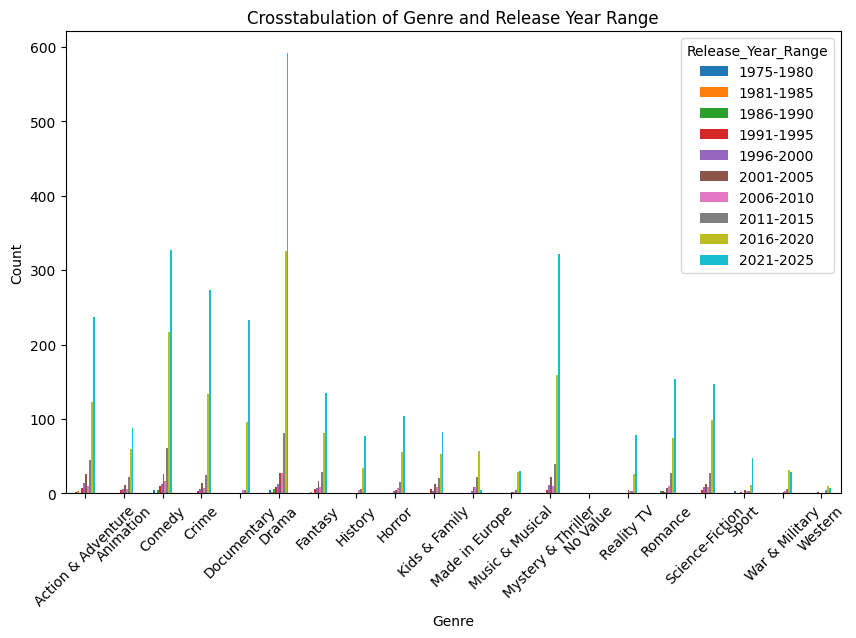

In [ ]:
import matplotlib.pyplot as plt

# Perform the crosstabulation and exclude the last column
crosstab_data = pd.crosstab(df['Genre'], df['Release_Year_Range']).iloc[:, :-1]

# Create the bar plot
fig, ax = plt.subplots(figsize=(10, 6))  # Set the figure size
crosstab_data.plot(kind='bar', ax=ax)

# Set labels and title
ax.set_xlabel('Genre')
ax.set_ylabel('Count')
ax.set_title('Crosstabulation of Genre and Release Year Range')

# Rotate x-axis labels for better visibility (optional)
plt.xticks(rotation=45)

# Show the plot
plt.show()


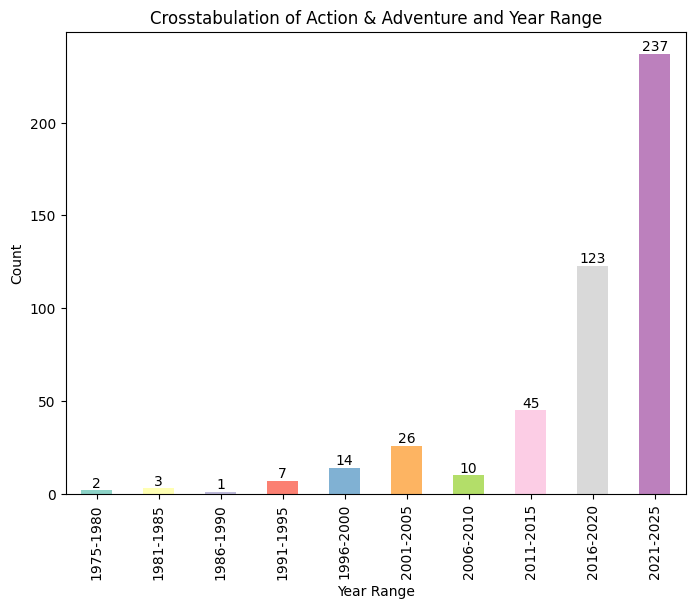

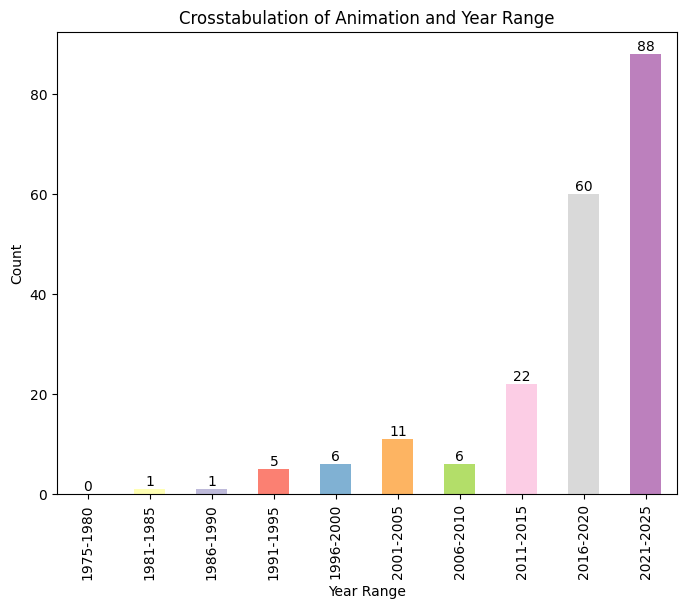

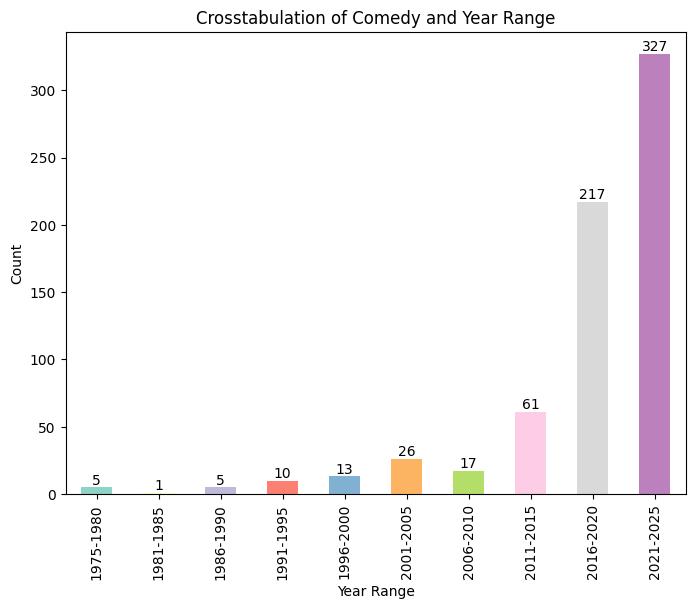

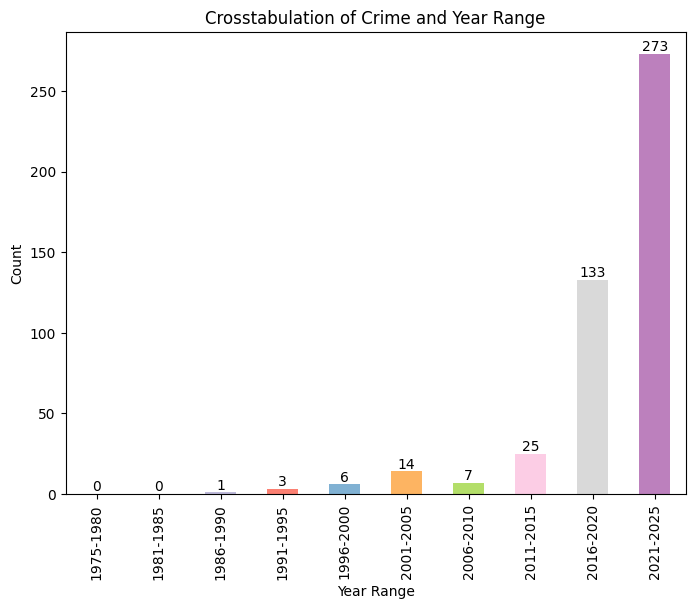

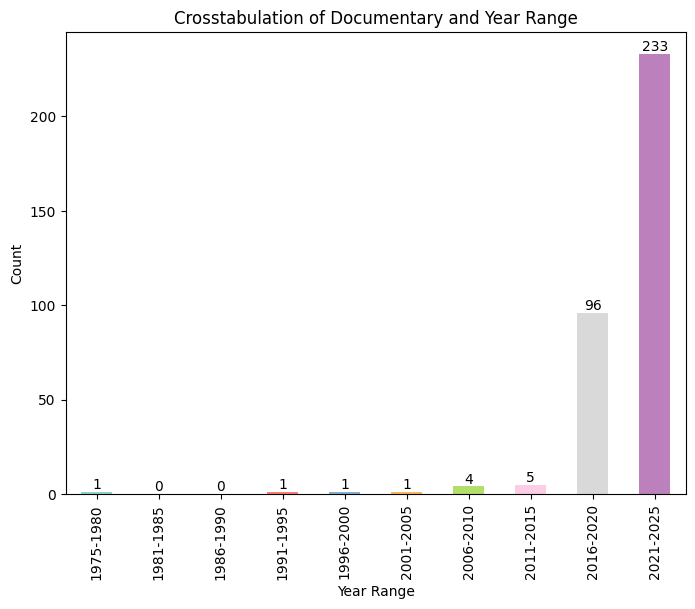

...

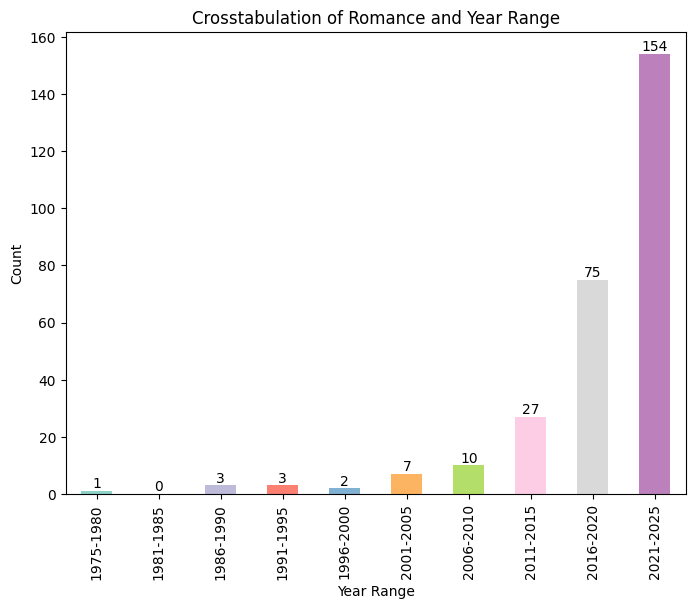

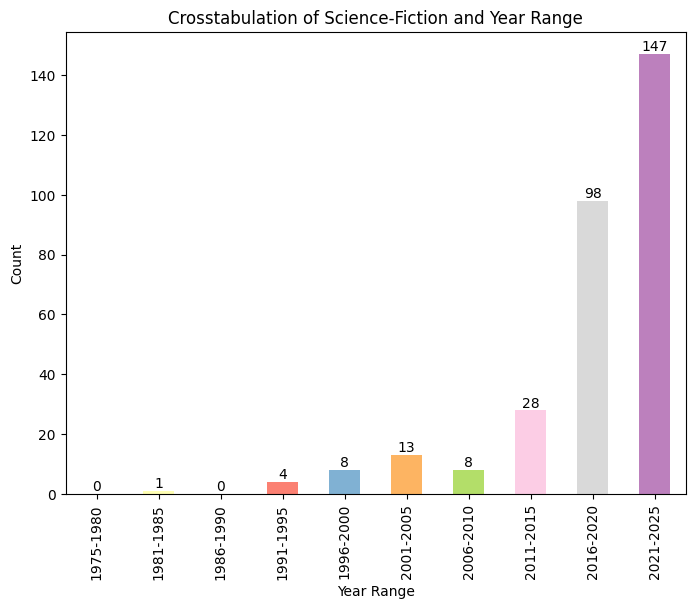

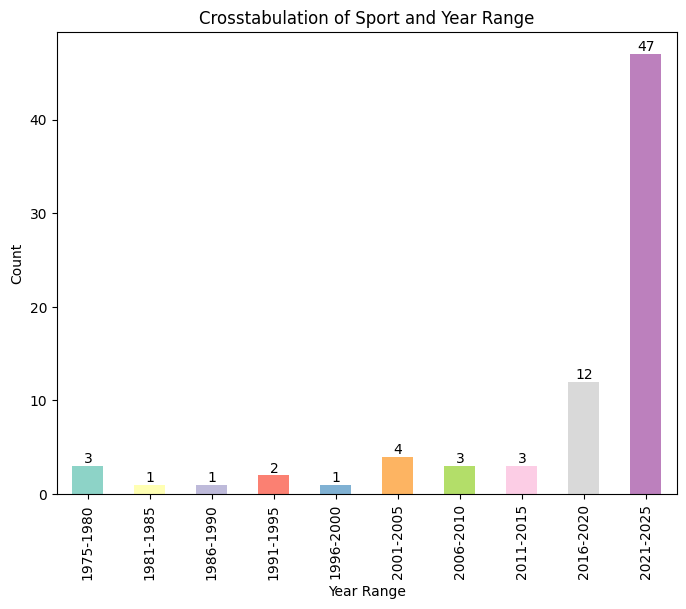

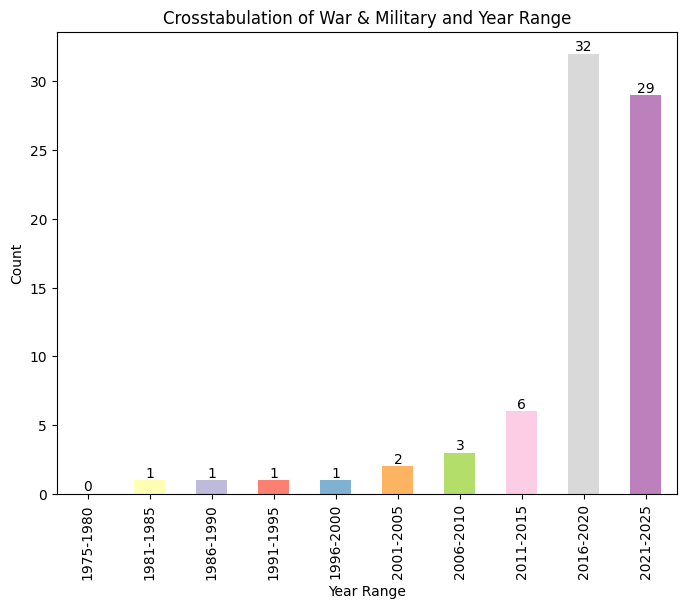

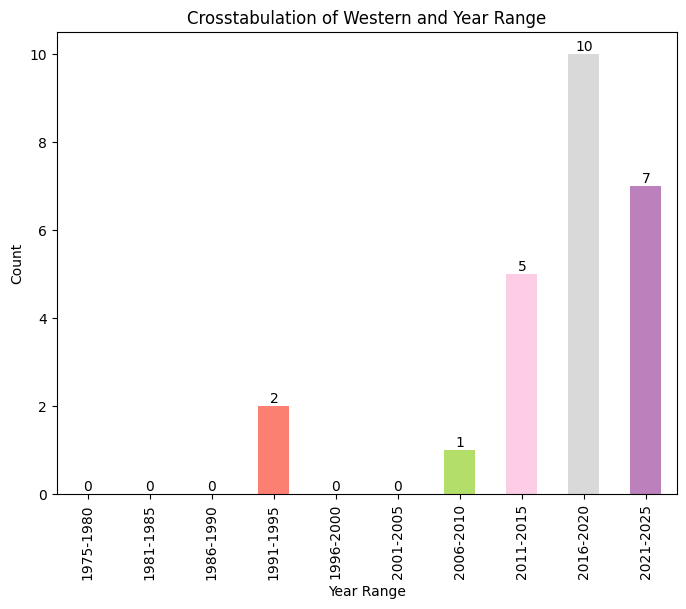

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Define a color palette
color_palette = sns.color_palette('Set3')

# Perform the crosstabulation and exclude the last column
crosstab_data = pd.crosstab(df['Genre'], df['Release_Year_Range']).iloc[:, :-1]

# Iterate over the rows (genres) and create individual plots
for genre in crosstab_data.index:
    # Create a new figure for each genre
    fig, ax = plt.subplots(figsize=(8, 6))

    # Plot the data for all year ranges for the current genre with the specified color palette
    crosstab_data.loc[genre].plot(kind='bar', ax=ax, color=color_palette)

    # Set labels and title
    ax.set_xlabel('Year Range')
    ax.set_ylabel('Count')
    ax.set_title(f'Crosstabulation of {genre} and Year Range')

    # Add labels to the bars
    for i, v in enumerate(crosstab_data.loc[genre]):
        ax.annotate(str(v), xy=(i, v), ha='center', va='bottom')

    # Show the plot
    plt.show()


**The table provides a breakdown of the number of movies and TV shows hosted by Netflix across different runtime ranges and genres.**

Runtime Ranges: The runtime ranges are listed in columns, representing different intervals of movie and TV show durations. Each column represents a specific range of runtime duration.

Genre Breakdown: The genres are listed in rows, and the corresponding counts for movies and TV shows are displayed in the respective columns.

Genre Distribution: The table shows the distribution of movies and TV shows across various genres for each runtime range. It provides insights into how the availability of content varies based on duration.

Popular Genres: Drama has the highest count across most runtime ranges, indicating its prevalence in various durations. Other popular genres include Comedy, Action & Adventure, Mystery & Thriller, Animation, and Crime.

Runtime Preferences: The counts within each genre for different runtime ranges can give an indication of viewer preferences for content of specific durations. For example, Action & Adventure, Drama, and Comedy genres have a substantial presence across multiple runtime ranges, suggesting their popularity among viewers.

Runtime Trends: The table reveals variations in genre counts across different runtime ranges. For instance, Animation and Family genres have higher counts in the 20-25 and 25-30 minute ranges, while Drama and Crime genres are more prevalent in the 45-50 and 50-55 minute ranges.

In [ ]:
pd.crosstab(df['Runtime_Range'], df['Genre'])
pd.crosstab(df['Runtime_Range'], df['Genre']).drop('No Value', axis=1)

Genre,Action & Adventure,Animation,Comedy,Crime,Documentary,Drama,Fantasy,History,Horror,Kids & Family,Made in Europe,Music & Musical,Mystery & Thriller,Reality TV,Romance,Science-Fiction,Sport,War & Military,Western
Runtime_Range,,,,,,,,,,,,,,,,,,,
0-5,0,1,0,1,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0
5-10,0,4,2,0,0,0,1,0,0,4,1,0,0,0,0,0,0,0,0
10-15,5,6,8,1,1,5,3,0,2,5,0,1,2,0,0,4,0,1,0
15-20,8,10,13,1,1,6,5,0,0,6,1,2,0,2,2,4,0,1,0
20-25,50,58,71,11,10,45,46,1,7,40,2,6,23,7,15,51,1,0,2
25-30,37,49,86,16,21,53,34,4,12,22,2,2,18,8,15,36,2,3,0
30-35,5,6,41,9,12,34,4,2,4,2,2,2,8,13,9,8,6,0,1
35-40,3,0,14,5,13,23,3,2,1,2,0,2,9,14,9,7,2,0,1
40-45,37,3,26,51,42,108,18,13,13,3,1,4,48,25,16,32,5,9,1


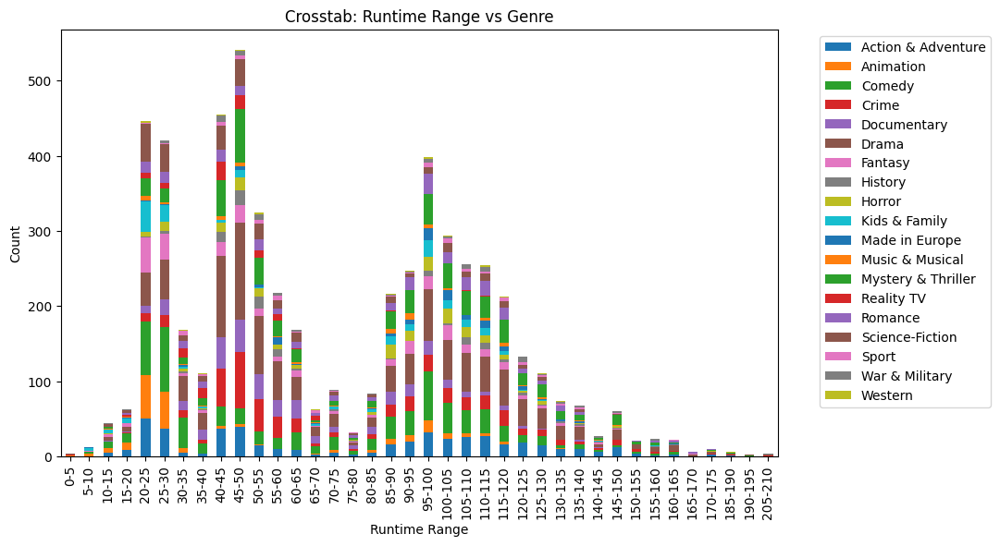

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Perform the crosstabulation and drop a specific column
crosstab_data = pd.crosstab(df['Runtime_Range'], df['Genre']).drop('No Value', axis=1)

# Create a larger figure
fig, ax = plt.subplots(figsize=(10, 6))

# Plotting the data
crosstab_data.plot(kind='bar', stacked=True, ax=ax)

# Add labels and title
plt.xlabel('Runtime Range')
plt.ylabel('Count')
plt.title('Crosstab: Runtime Range vs Genre')

# Show the legend outside the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# Show the plot
plt.show()


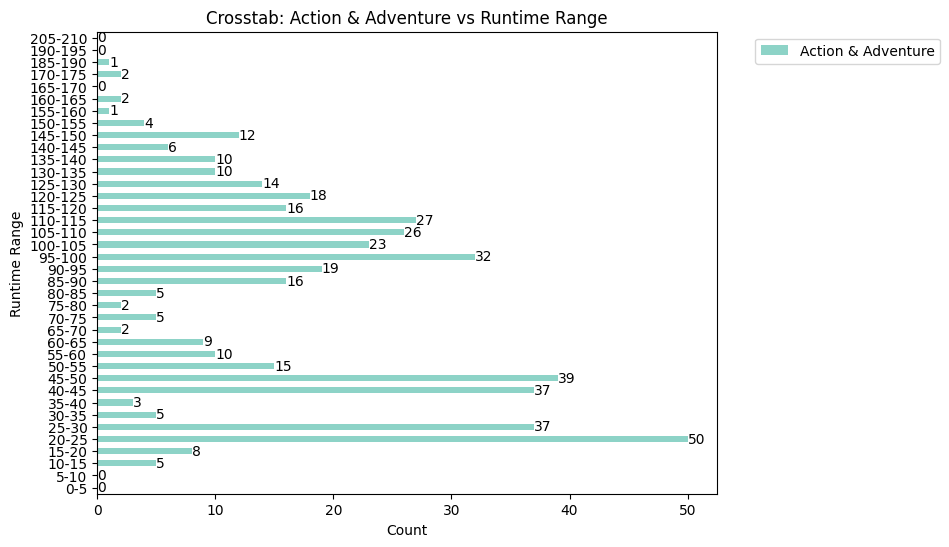

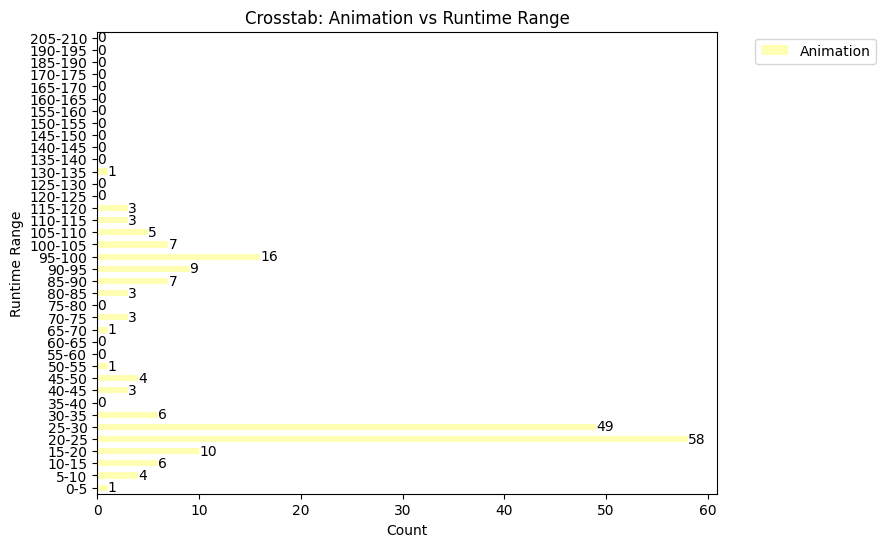

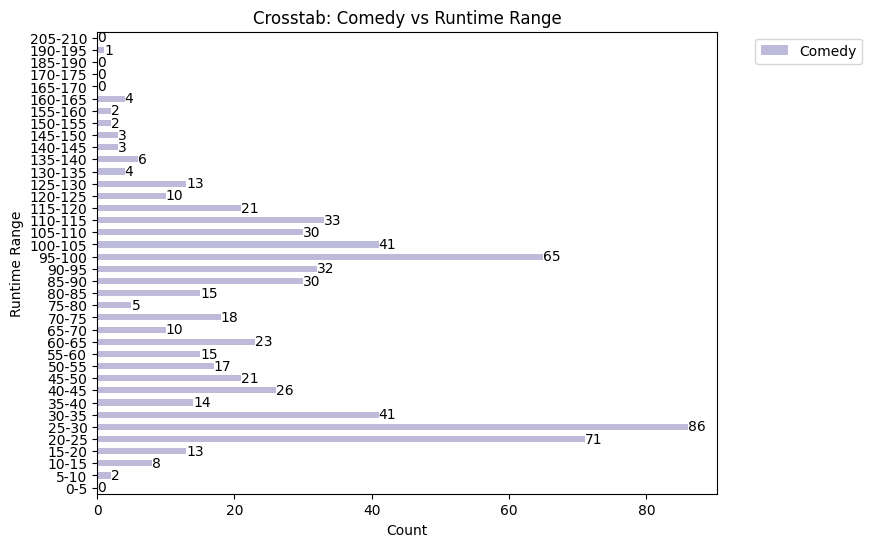

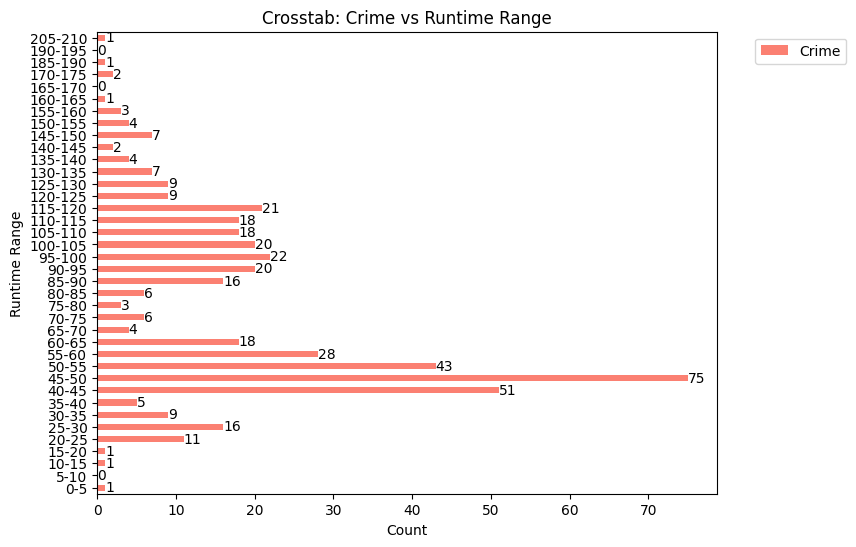

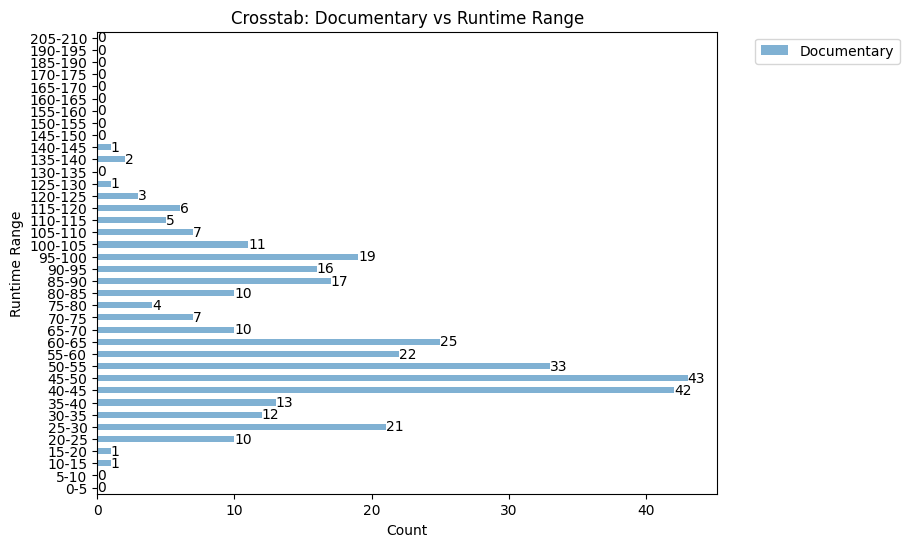

...

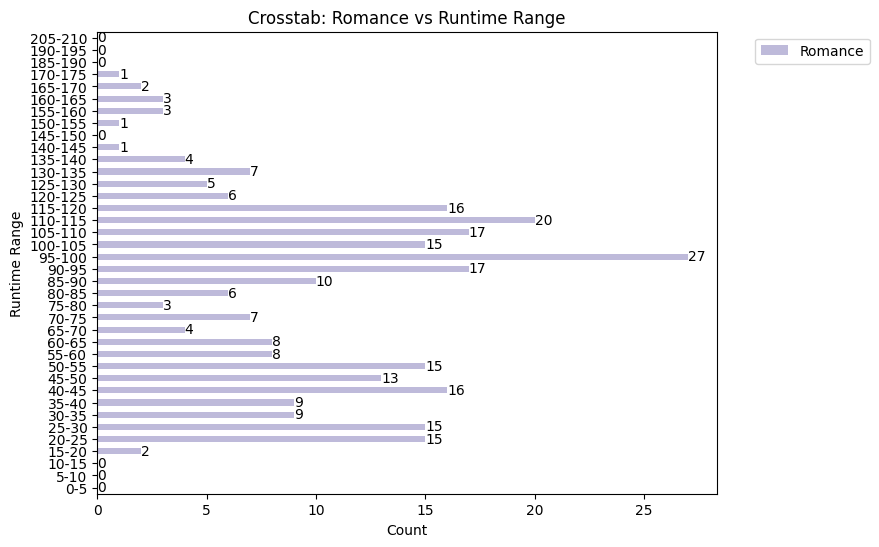

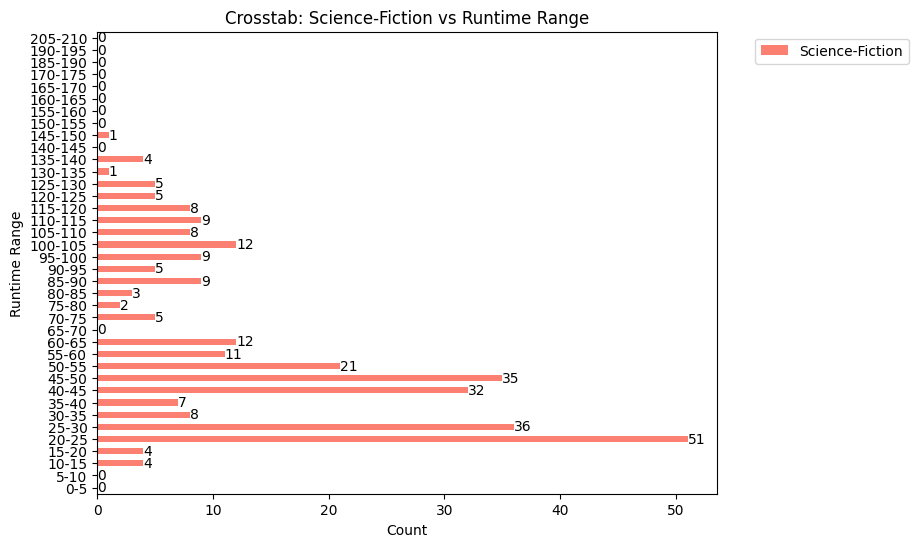

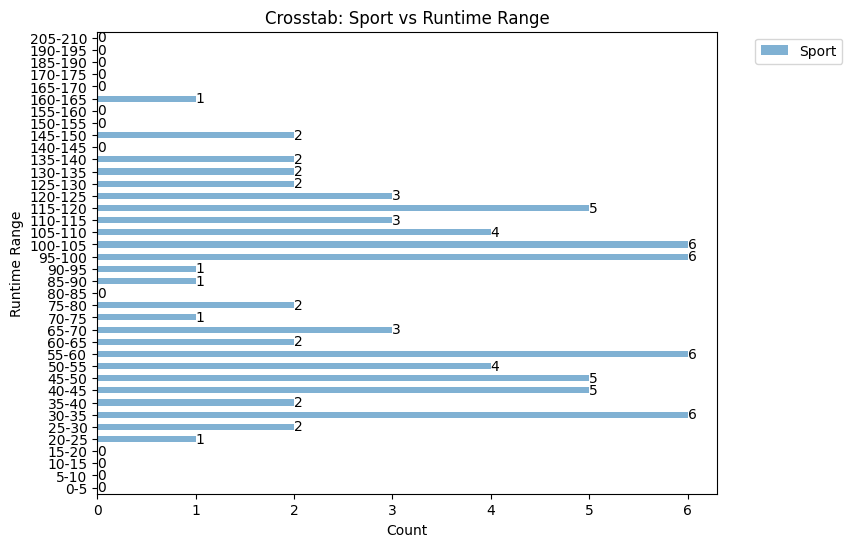

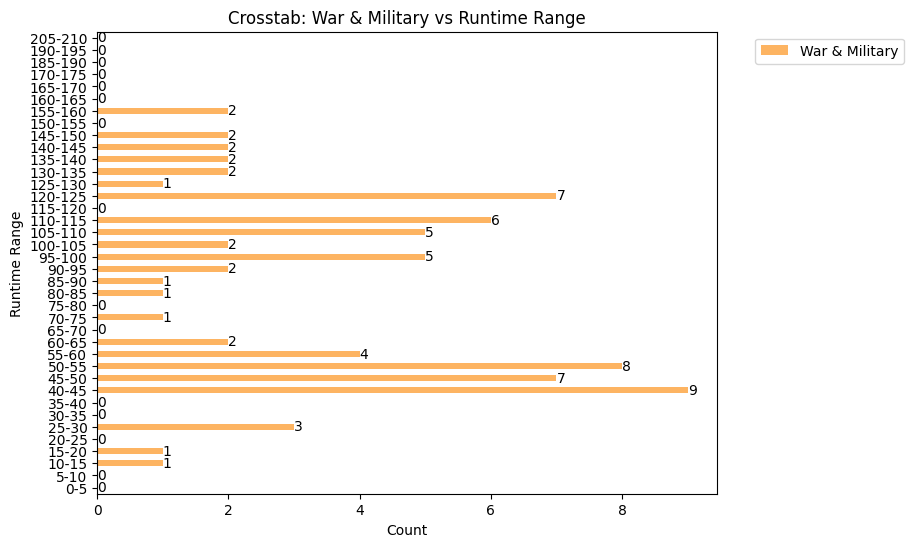

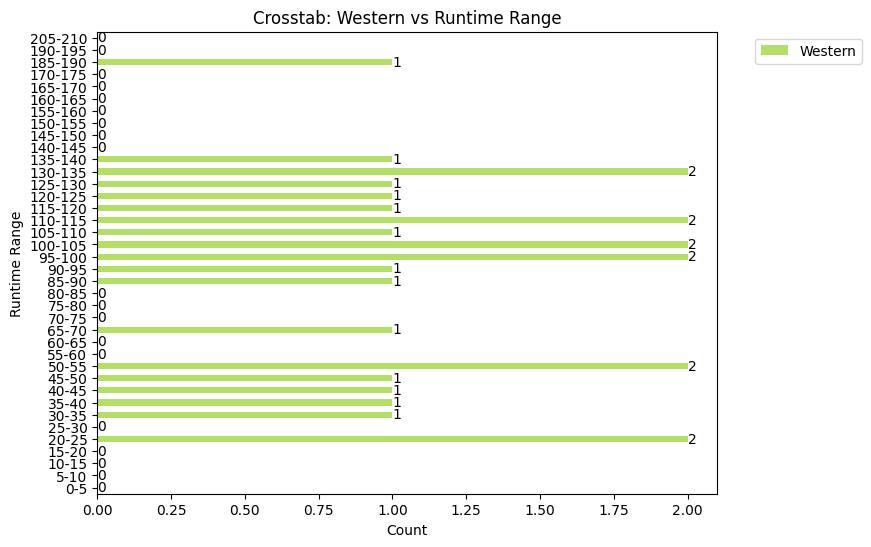

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Perform the crosstabulation and drop a specific column
crosstab_data = pd.crosstab(df['Runtime_Range'], df['Genre']).drop('No Value', axis=1)

# Define a color palette
colors = sns.color_palette('Set3', len(crosstab_data.columns))

# Iterate over each column (genre) and plot a separate graph
for i, genre in enumerate(crosstab_data.columns):
    # Create a new figure for each genre
    fig, ax = plt.subplots(figsize=(8, 6))

    # Plot the transposed data for the specific genre with the corresponding color
    crosstab_data[genre].plot(kind='barh', stacked=True, ax=ax, color=colors[i])

    # Add labels and title
    plt.xlabel('Count')
    plt.ylabel('Runtime Range')
    plt.title(f'Crosstab: {genre} vs Runtime Range')

    # Add bar labels
    for j, count in enumerate(crosstab_data[genre]):
        plt.text(count, j, str(count), ha='left', va='center')

    # Show the legend outside the plot
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

    # Show the plot
    plt.show()


# **The table provides a breakdown of the number of movies and TV shows hosted by Netflix across different IMDb rating ranges and genres.**

IMDb Rating Ranges: The IMDb rating ranges are listed in columns, representing different intervals of IMDb ratings. Each column represents a specific range of IMDb ratings.

Genre Breakdown: The genres are listed in rows, and the corresponding counts for movies and TV shows are displayed in the respective columns.

Genre Distribution: The table shows the distribution of movies and TV shows across various genres for each IMDb rating range. It provides insights into the popularity and reception of content based on IMDb ratings.
Popular Genres: Drama has the highest count across most IMDb rating ranges, indicating its prevalence and popularity across various IMDb ratings. Other popular genres include Comedy, Action & Adventure, Mystery & Thriller, Animation, and Crime.

IMDb Rating Preferences: The counts within each genre for different IMDb rating ranges can give an indication of viewer preferences for content of specific IMDb ratings. For example, genres like Animation and Kids & Family have higher counts in lower IMDb rating ranges, indicating their popularity among younger audiences. On the other hand, genres like Drama and Mystery & Thriller have a higher count in the higher IMDb rating ranges, suggesting their appeal to viewers who prefer critically acclaimed content.

IMDb Rating Trends: The table reveals variations in genre counts across different IMDb rating ranges. For instance, genres like Animation and Comedy have a higher count in the lower IMDb rating ranges, while genres like Drama, Mystery & Thriller, and Action & Adventure have a higher count in the higher IMDb rating ranges.

In [ ]:
pd.crosstab(df['Genre'], df['IMDB_Range']).drop('No Value', axis=0).drop('nan', axis=1)

IMDB_Range,2.0-2.5,2.6-3.0,3.1-3.5,3.6-4.0,4.1-4.5,4.6-5.0,5.1-5.5,5.6-6.0,6.1-6.5,6.6-7.0,7.1-7.5,7.6-8.0,8.1-8.5,8.6-9.0,9.1-9.5,9.6-10.0
Genre,,,,,,,,,,,,,,,,
Action & Adventure,0,1,2,2,5,17,22,68,70,87,71,55,41,16,4,0
Animation,0,0,1,0,0,2,5,15,28,37,38,25,22,17,4,0
Comedy,0,1,2,5,7,21,36,86,90,118,124,90,60,27,2,0
Crime,1,0,1,1,3,13,13,47,68,95,100,60,36,20,0,1
Documentary,0,3,0,0,0,7,6,12,43,68,97,49,29,9,2,0
Drama,0,3,1,7,8,30,49,110,129,198,215,157,96,51,2,1
Fantasy,0,1,0,1,3,8,16,33,36,50,50,35,32,17,4,0
History,0,1,0,0,0,0,2,4,9,25,47,22,6,7,1,0
Horror,0,1,0,2,4,18,23,24,29,24,29,12,16,6,0,0


<Figure size 1200x800 with 0 Axes>

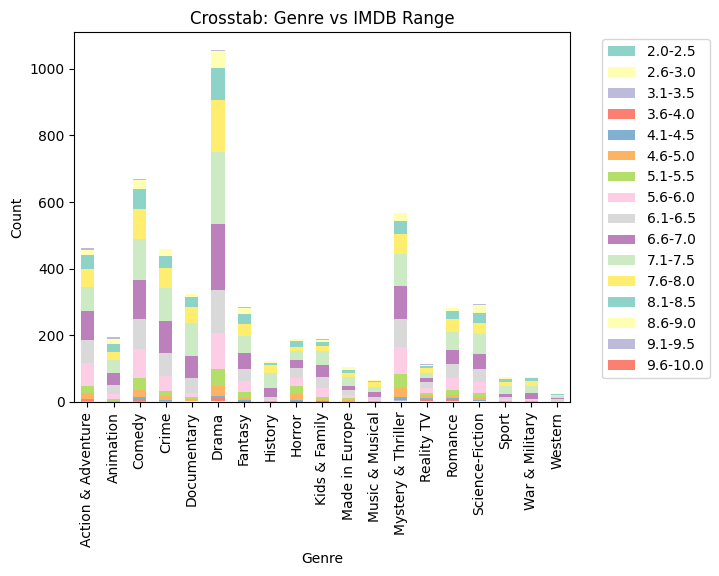

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Perform the crosstabulation
crosstab_data = pd.crosstab(df['Genre'], df['IMDB_Range']).drop('No Value', axis=0).drop('nan', axis=1)

# Define a color palette
color_palette = sns.color_palette('Set3')

# Create a larger figure
plt.figure(figsize=(12, 8))

# Create a bar plot
ax = crosstab_data.plot(kind='bar', stacked=True, color=color_palette)

# Set labels and title
plt.xlabel('Genre')
plt.ylabel('Count')
plt.title('Crosstab: Genre vs IMDB Range')

# Move the legend outside the plot area
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# Show the plot
plt.show()


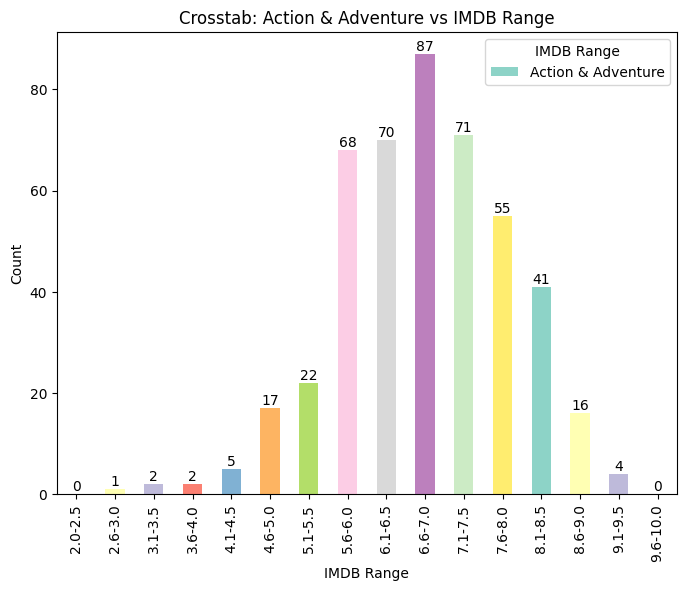

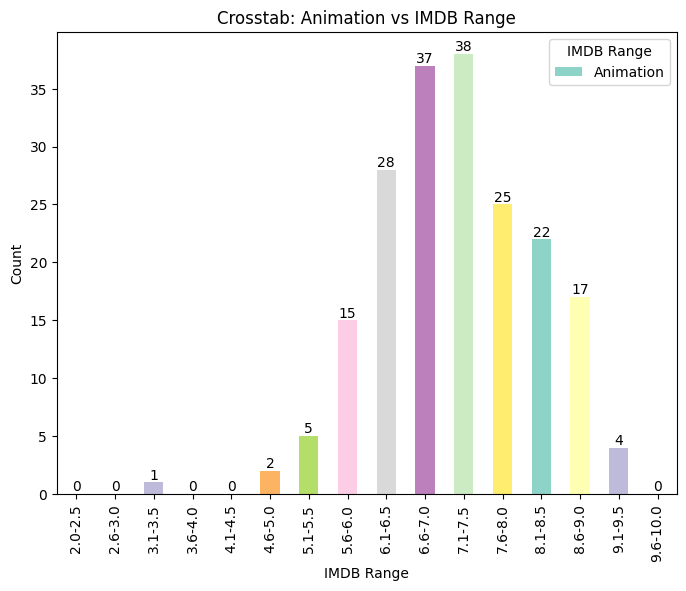

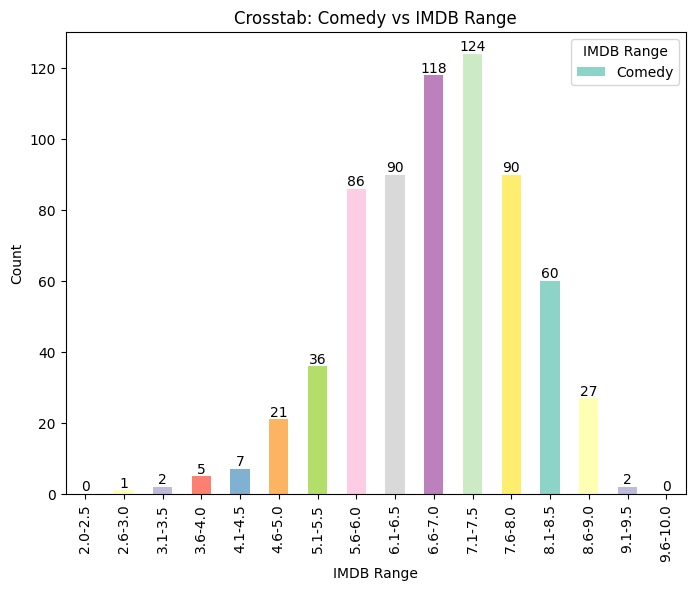

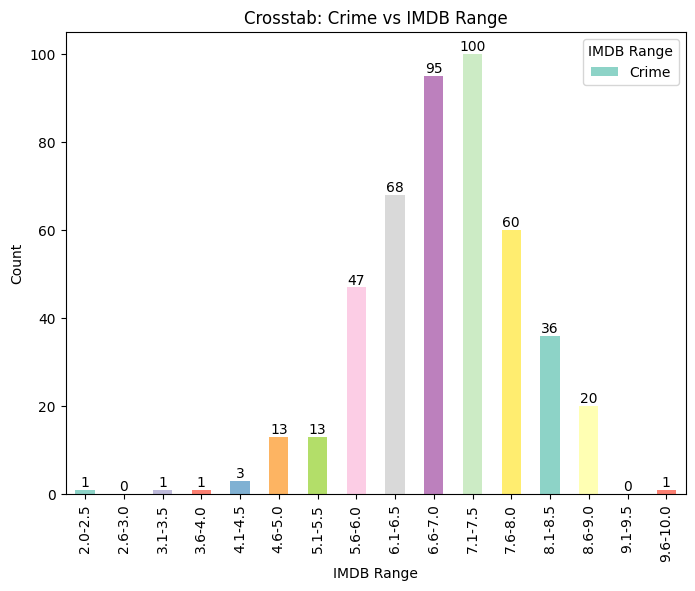

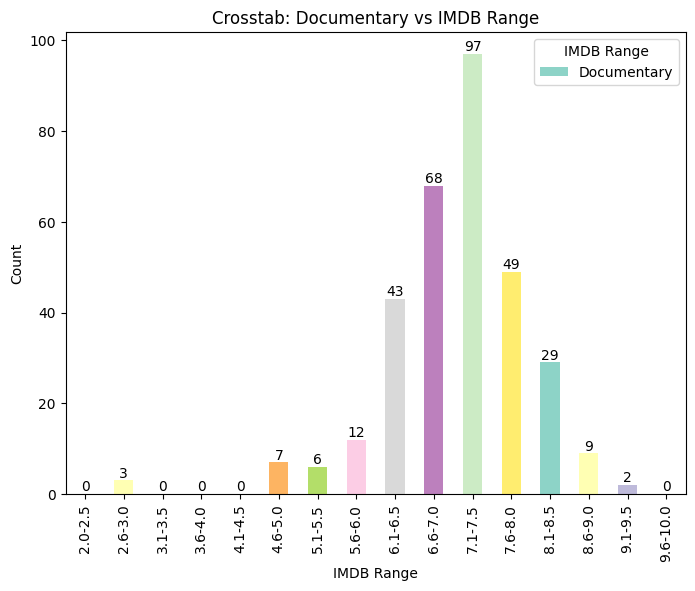

...

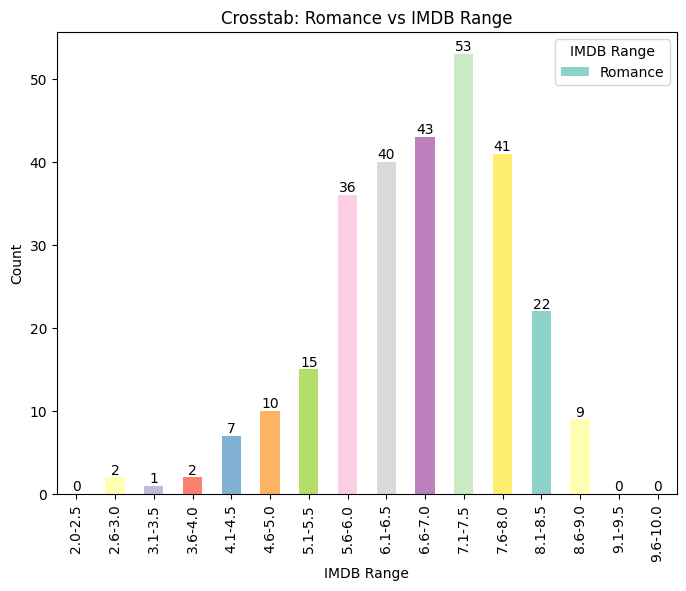

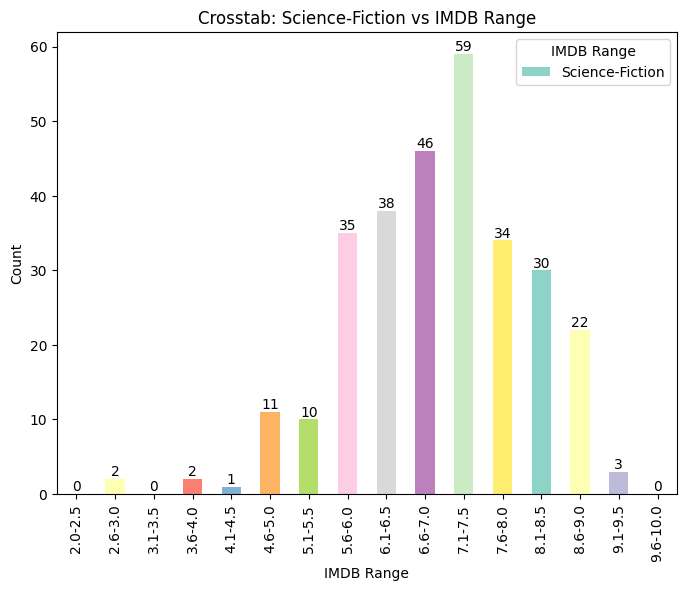

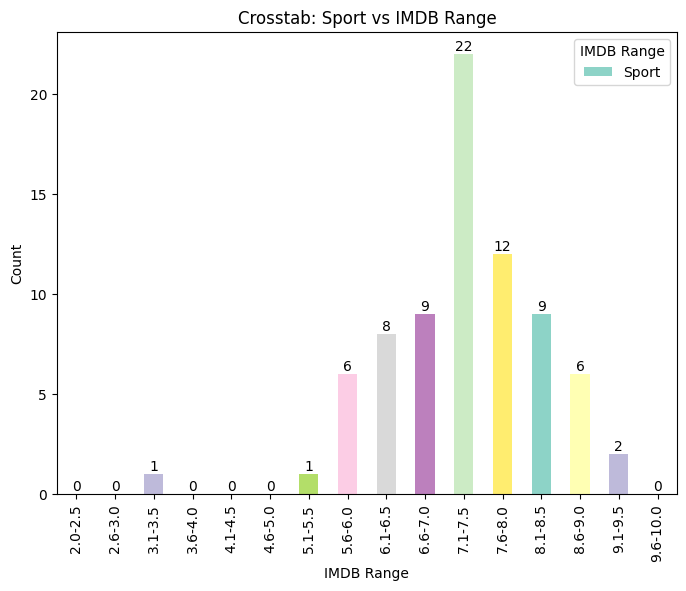

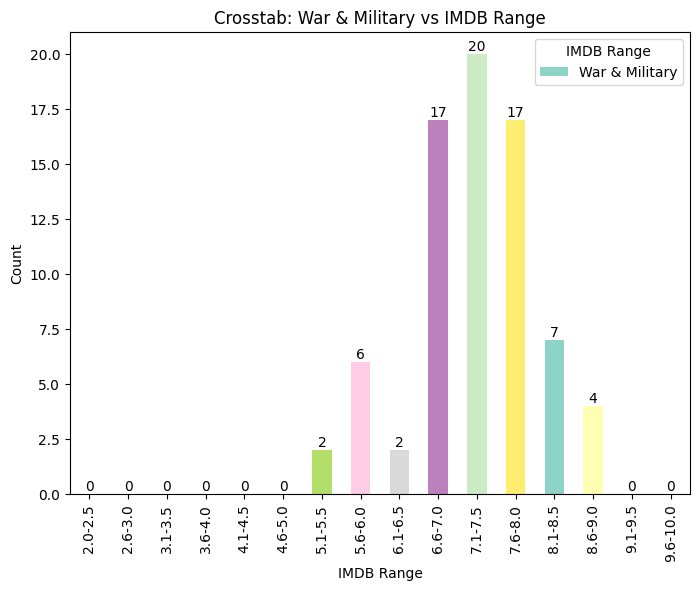

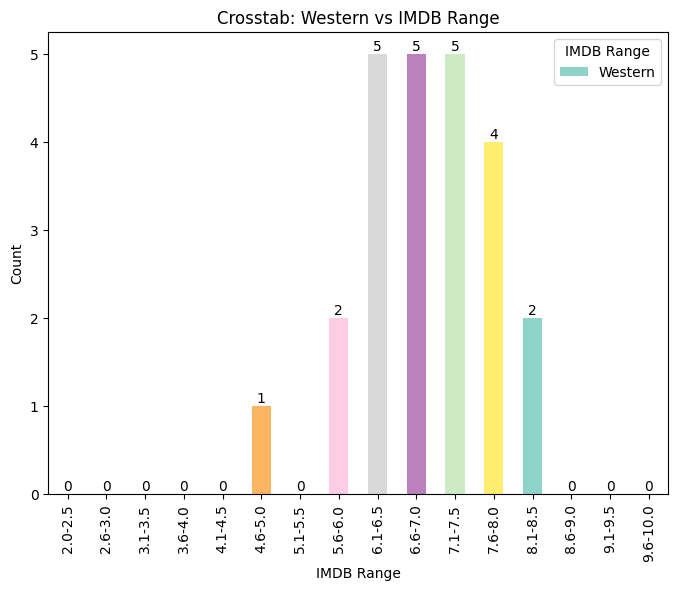

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Perform the crosstabulation
crosstab_data = pd.crosstab(df['Genre'], df['IMDB_Range']).drop('No Value', axis=0).drop('nan', axis=1)

# Define a color palette
color_palette = sns.color_palette('Set3')

# Iterate over the genres and create separate plots
for genre in crosstab_data.index:
    # Create a new figure for each genre
    plt.figure(figsize=(8, 6))

    # Filter the data for the current genre
    genre_data = crosstab_data.loc[genre]

    # Create a bar plot for the current genre
    ax = genre_data.plot(kind='bar', color=color_palette)

    # Set labels and title
    plt.xlabel('IMDB Range')
    plt.ylabel('Count')
    plt.title(f'Crosstab: {genre} vs IMDB Range')

    # Add labels to the bars
    for i, v in enumerate(genre_data):
        ax.text(i, v, str(v), ha='center', va='bottom')

    # Add legend
    ax.legend(title='IMDB Range')

    # Show the plot
    plt.show()


**The table provides a breakdown of the number of movies and TV shows available on the JustWatch platform across different score ranges and genres.**

JustWatch Score Ranges: The JustWatch score ranges are listed in columns, representing different intervals of scores. Each column represents a specific range of scores.

Genre Breakdown: The genres are listed in rows, and the corresponding counts for movies and TV shows are displayed in the respective columns.

Genre Distribution: The table shows the distribution of movies and TV shows across various genres for each score range. It provides insights into the popularity and availability of content based on JustWatch scores.

Popular Genres: Drama has the highest count across most score ranges, indicating its prevalence and popularity across different scores. Other popular genres include Comedy, Action & Adventure, Mystery & Thriller, Animation, and Crime.

JustWatch Score Preferences: The counts within each genre for different score ranges can give an indication of viewer preferences for content of specific scores. For example, genres like Animation and Kids & Family have higher counts in the lower score ranges, indicating their popularity among younger audiences. On the other hand, genres like Drama, Mystery & Thriller, and Action & Adventure have a higher count in the higher score ranges, suggesting their appeal to viewers who prefer critically acclaimed content.

JustWatch Score Trends: The table reveals variations in genre counts across different score ranges. For instance, genres like Animation and Comedy have a higher count in the lower score ranges, while genres like Drama, Mystery & Thriller, and Action & Adventure have a higher count in the higher score ranges.

In [ ]:
pd.crosstab(df['Genre'], df['JustWatch_Range']).drop('No Value', axis=0).drop('nan', axis=1)

JustWatch_Range,0-10,10-20,20-30,30-40,40-50,50-60,60-70,70-80,80-90,90-100
Genre,,,,,,,,,,
Action & Adventure,1,0,0,6,13,13,100,178,121,39
Animation,1,0,0,5,3,4,18,67,67,35
Comedy,1,0,0,12,15,29,154,250,181,43
Crime,1,1,0,10,5,13,77,213,116,26
Documentary,0,0,1,17,10,8,48,161,93,4
Drama,2,2,3,18,26,38,173,415,329,86
Fantasy,0,0,0,3,0,10,42,104,83,44
History,0,0,0,1,1,1,6,61,46,8
Horror,0,0,0,3,1,21,53,61,34,18


<Figure size 1200x800 with 0 Axes>

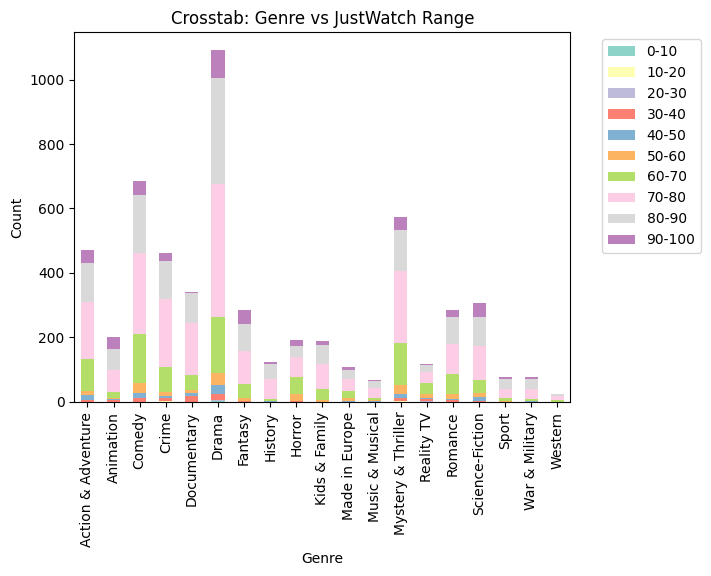

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Perform the crosstabulation
crosstab_data = pd.crosstab(df['Genre'], df['JustWatch_Range']).drop('No Value', axis=0).drop('nan', axis=1)

# Define a color palette
color_palette = sns.color_palette('Set3')

# Create a larger figure
plt.figure(figsize=(12, 8))

# Create a bar plot
ax = crosstab_data.plot(kind='bar', stacked=True, color=color_palette)

# Set labels and title
plt.xlabel('Genre')
plt.ylabel('Count')
plt.title('Crosstab: Genre vs JustWatch Range')

# Move the legend outside the plot area
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# Show the plot
plt.show()


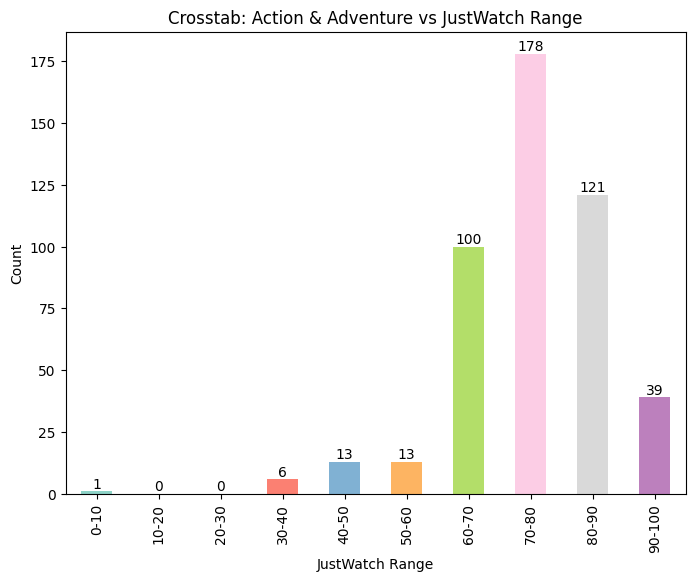

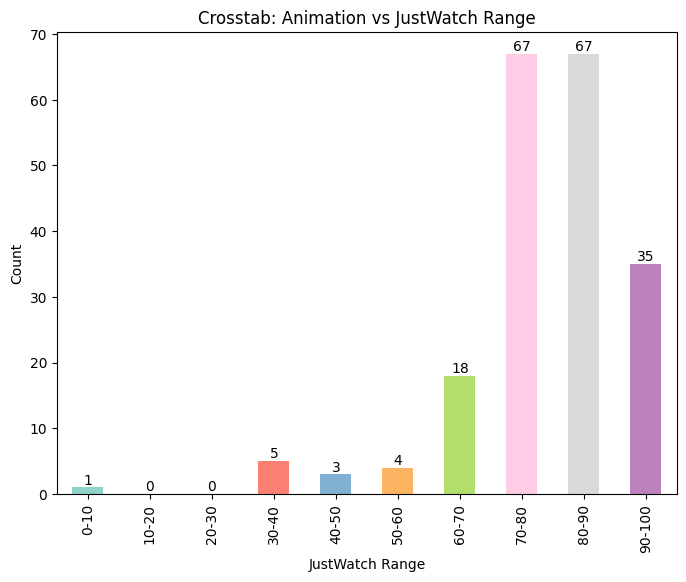

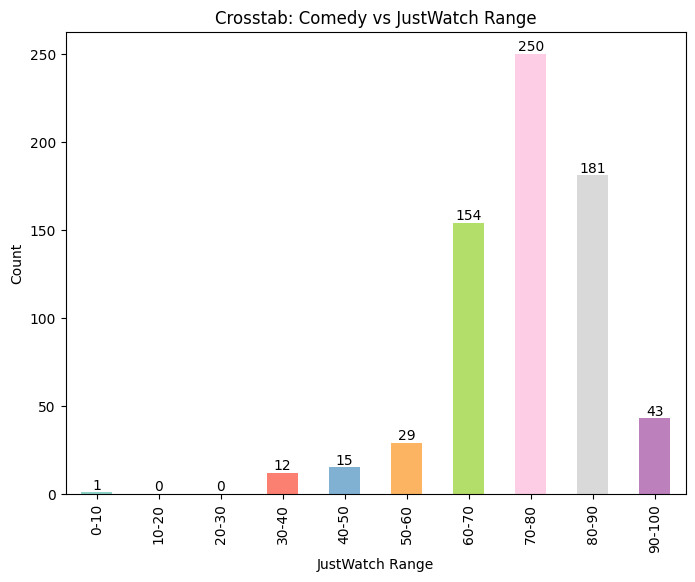

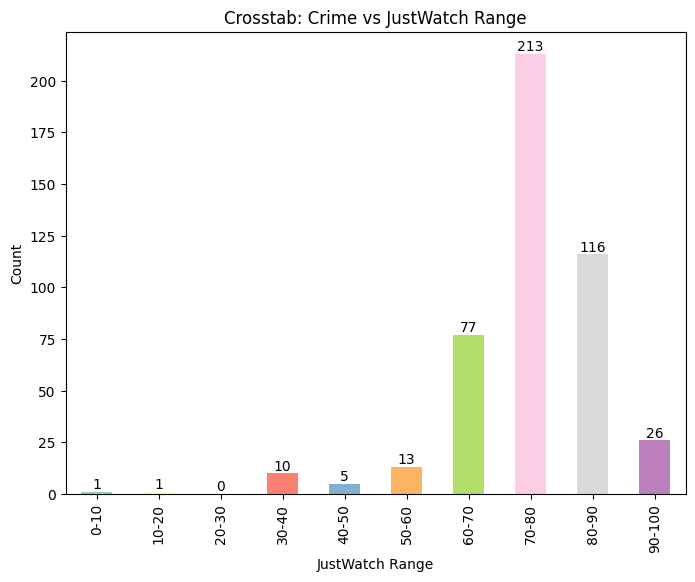

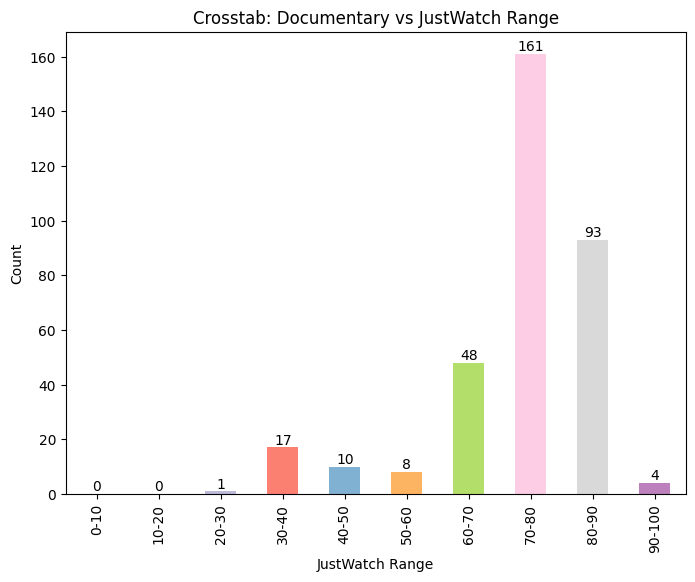

...

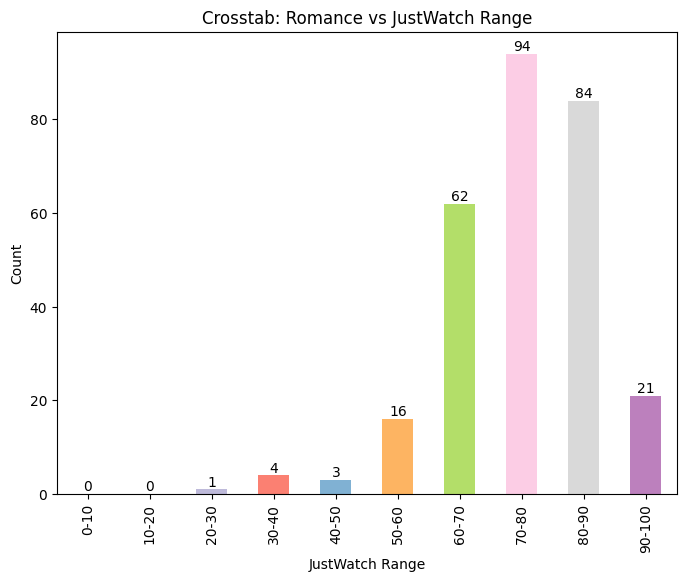

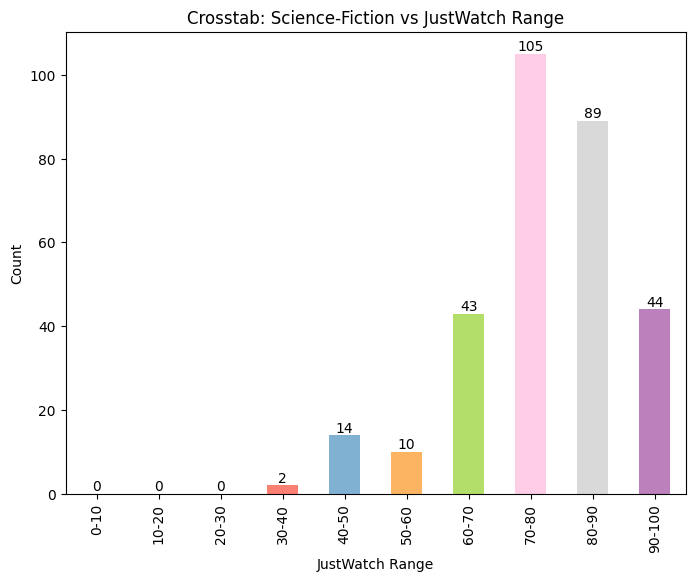

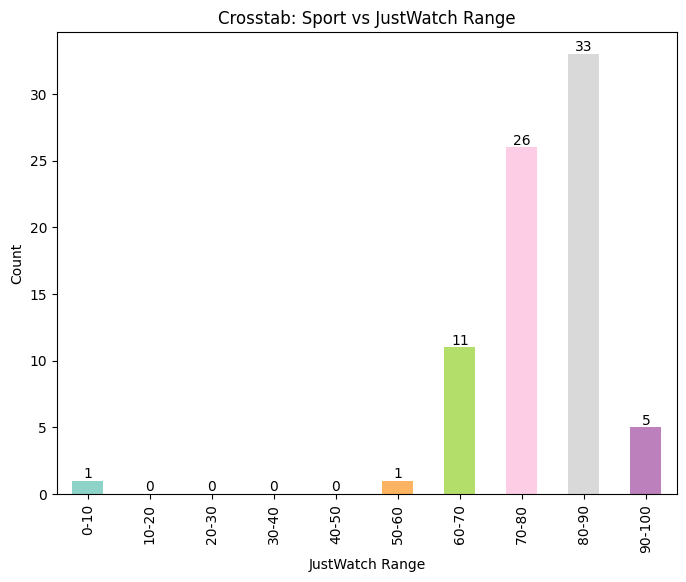

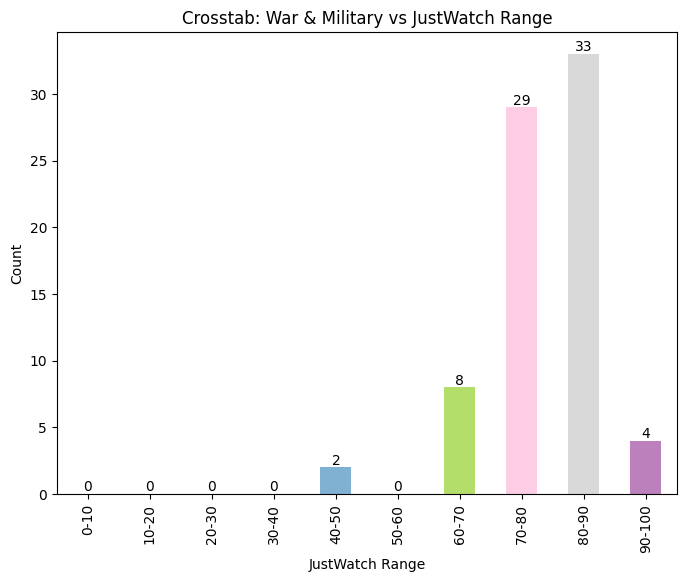

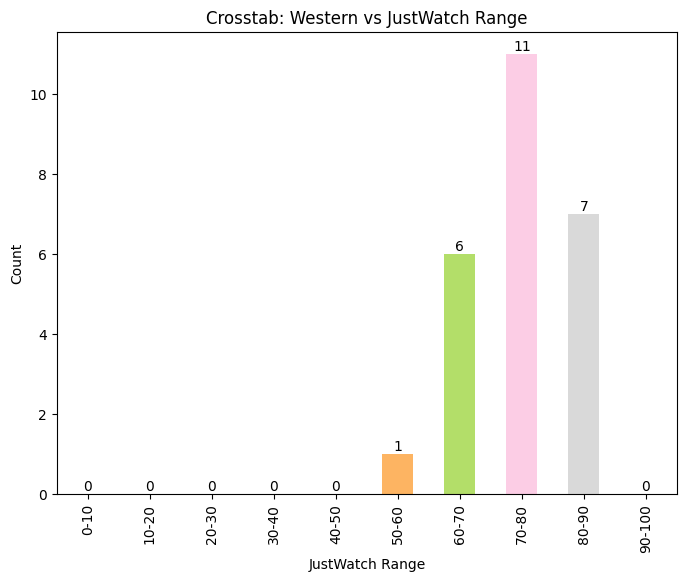

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Perform the crosstabulation
crosstab_data = pd.crosstab(df['Genre'], df['JustWatch_Range']).drop('No Value', axis=0).drop('nan', axis=1)

# Define a color palette
color_palette = sns.color_palette('Set3', n_colors=len(crosstab_data.columns))

# Create separate bar plots for each genre
for genre in crosstab_data.index:
    # Filter the data for the current genre
    genre_data = crosstab_data.loc[genre]

    # Create a new figure for each genre
    plt.figure(figsize=(8, 6))

    # Plot the data for the current genre using the specified color palette
    genre_data.plot(kind='bar', color=color_palette)

    # Set labels and title
    plt.xlabel('JustWatch Range')
    plt.ylabel('Count')
    plt.title(f'Crosstab: {genre} vs JustWatch Range')

    # Add labels to the bars
    for i, v in enumerate(genre_data):
        plt.text(i, v, str(v), ha='center', va='bottom')

    # Show the plot
    plt.show()


# **The table provides a breakdown of user ratings for movies and TV shows across different score ranges and genres.**

User Ratings Ranges: The user ratings ranges are listed in columns, representing different intervals of user ratings. Each column represents a specific range of ratings.

Genre Breakdown: The genres are listed in rows, and the corresponding counts for movies and TV shows are displayed in the respective columns.

Genre Distribution: The table shows the distribution of movies and TV shows across various genres for each user rating range. It provides insights into the popularity and user preferences for content based on user ratings.

Popular Genres: Drama has the highest count across most user rating ranges, indicating its popularity among users. Other popular genres include Comedy, Action & Adventure, Mystery & Thriller, and Animation.

User Rating Preferences: The counts within each genre for different user rating ranges can give an indication of user preferences for content of specific ratings. For example, genres like Animation and Kids & Family have higher counts in the lower user rating ranges, indicating their appeal to younger audiences. On the other hand, genres like Drama, Mystery & Thriller, and Action & Adventure have a higher count in the higher user rating ranges, suggesting their popularity among users who rate movies and TV shows more positively.

User Rating Trends: The table reveals variations in genre counts across different user rating ranges. For instance, genres like Drama and Comedy have a higher count in the higher user rating ranges, while genres like Animation and Kids & Family have a higher count in the lower user rating ranges.

In [ ]:
pd.crosstab(df['Genre'], df['UserRatings_Range']).drop('No Value', axis=0).drop('nan', axis=1)

UserRatings_Range,1-50,101-150,151-200,201-250,251-300,301-350,351-400,401-450,451-500,501-550,51-100,551-600,601-650,651-700,701-750,751-800,801-850
Genre,,,,,,,,,,,,,,,,,
Action & Adventure,265,30,23,18,9,4,3,2,4,2,51,1,2,3,1,1,1
Animation,121,12,9,2,1,2,0,0,0,0,16,0,0,0,0,1,0
Comedy,416,36,22,9,12,9,3,5,1,0,61,3,2,1,0,1,1
Crime,297,21,7,11,8,6,3,5,4,0,39,4,0,1,1,0,0
Documentary,249,2,0,0,0,0,0,0,0,0,8,0,0,0,0,0,0
Drama,659,64,33,20,12,10,6,9,7,4,109,7,3,6,1,1,0
Fantasy,163,19,17,5,3,4,0,2,1,2,33,2,2,3,0,1,1
History,93,7,4,3,0,1,0,2,0,0,10,0,1,0,0,0,0
Horror,113,15,4,4,5,2,2,0,1,2,19,1,0,2,0,0,0


<Figure size 1200x800 with 0 Axes>

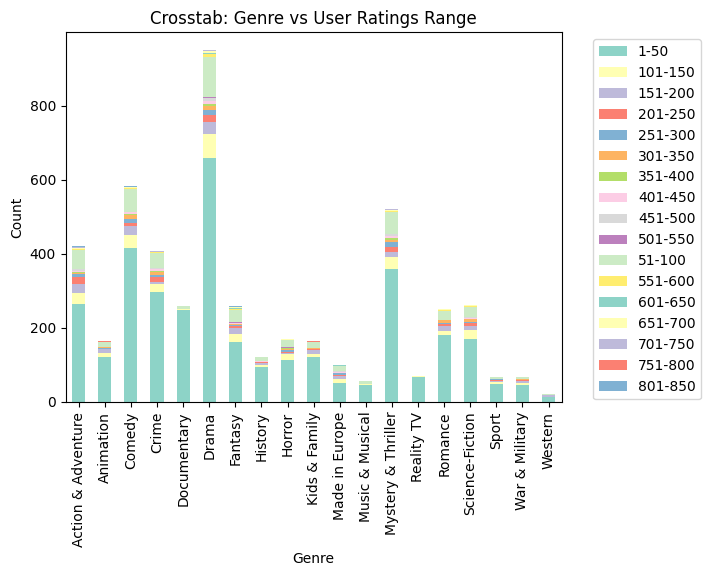

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Perform the crosstabulation
crosstab_data = pd.crosstab(df['Genre'], df['UserRatings_Range']).drop('No Value', axis=0).drop('nan', axis=1)

# Define a color palette
color_palette = sns.color_palette('Set3')

# Create a larger figure
plt.figure(figsize=(12, 8))

# Create a bar plot
ax = crosstab_data.plot(kind='bar', stacked=True, color=color_palette)

# Set labels and title
plt.xlabel('Genre')
plt.ylabel('Count')
plt.title('Crosstab: Genre vs User Ratings Range')


# Move the legend outside the plot area
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# Show the plot
plt.show()


<Figure size 800x600 with 0 Axes>

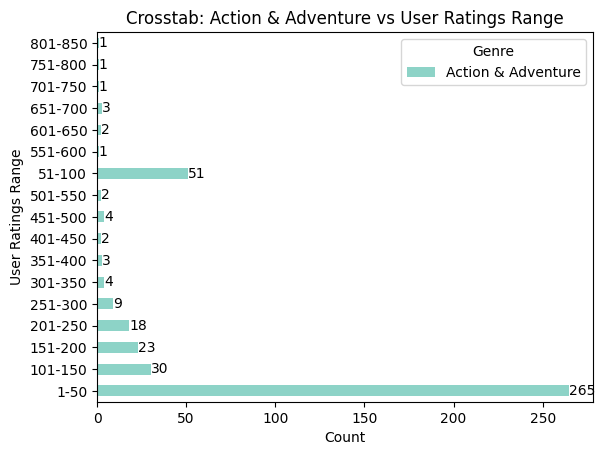

<Figure size 800x600 with 0 Axes>

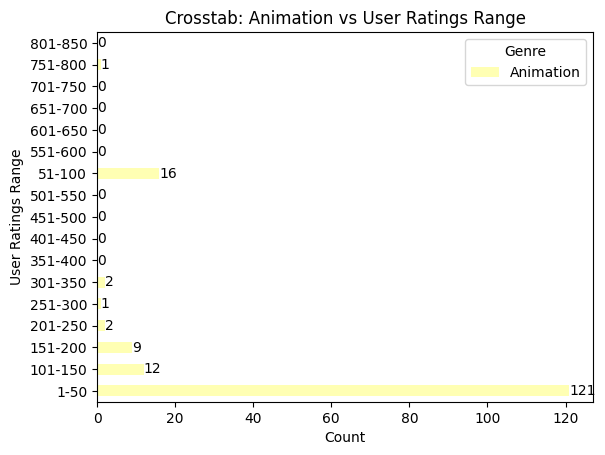

<Figure size 800x600 with 0 Axes>

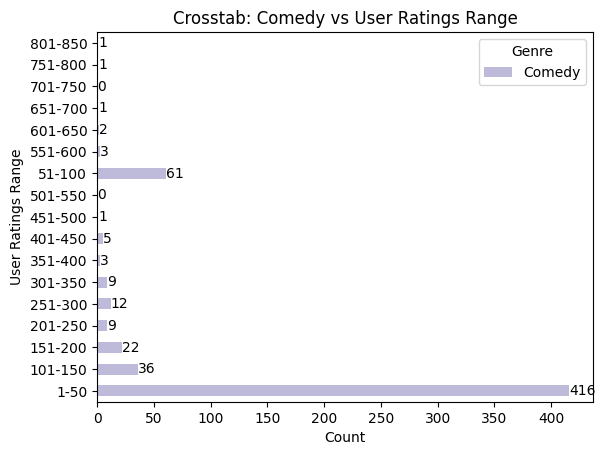

<Figure size 800x600 with 0 Axes>

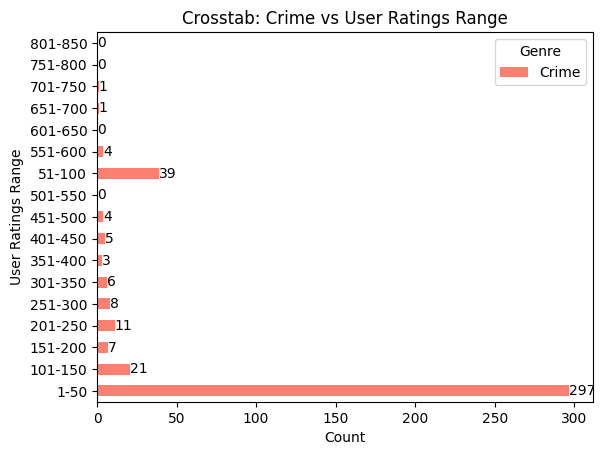

<Figure size 800x600 with 0 Axes>

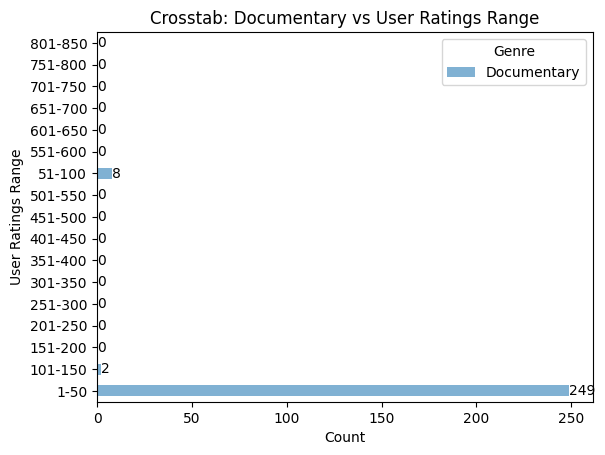

<Figure size 800x600 with 0 Axes>

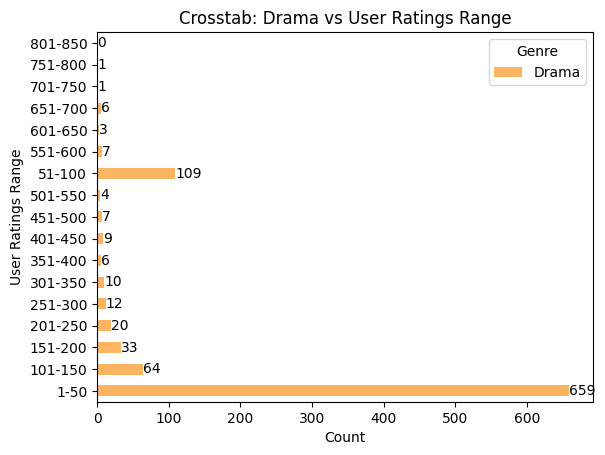

<Figure size 800x600 with 0 Axes>

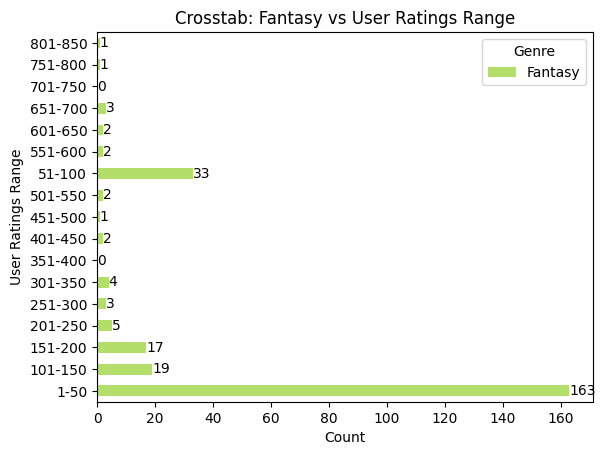

<Figure size 800x600 with 0 Axes>

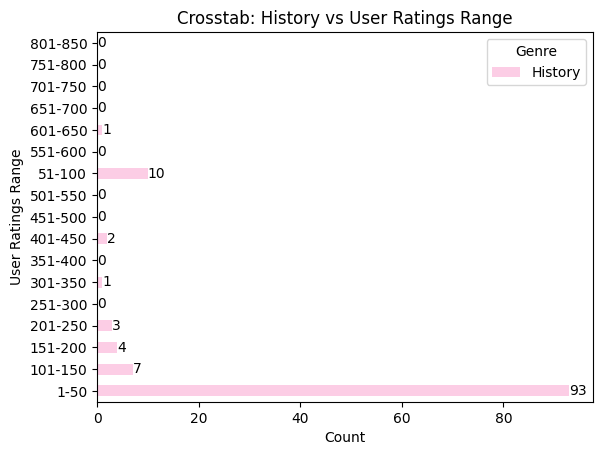

<Figure size 800x600 with 0 Axes>

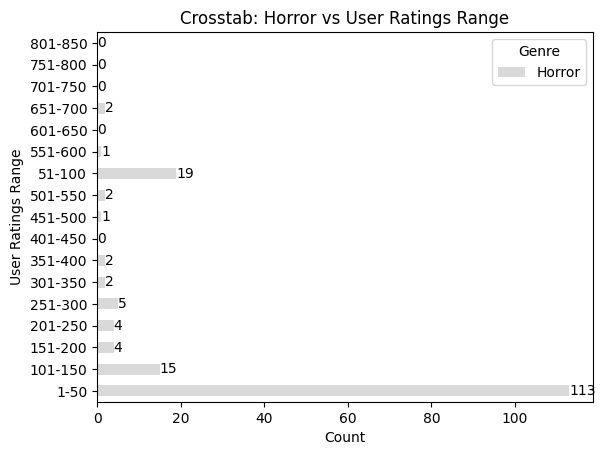

<Figure size 800x600 with 0 Axes>

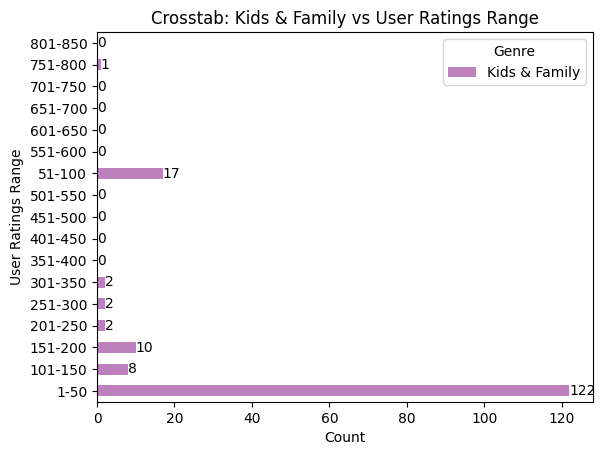

<Figure size 800x600 with 0 Axes>

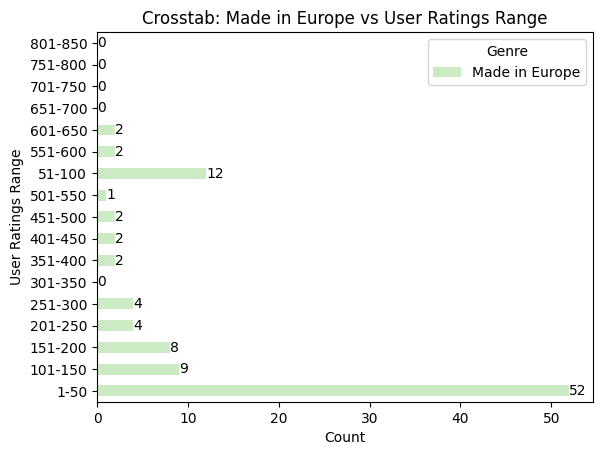

<Figure size 800x600 with 0 Axes>

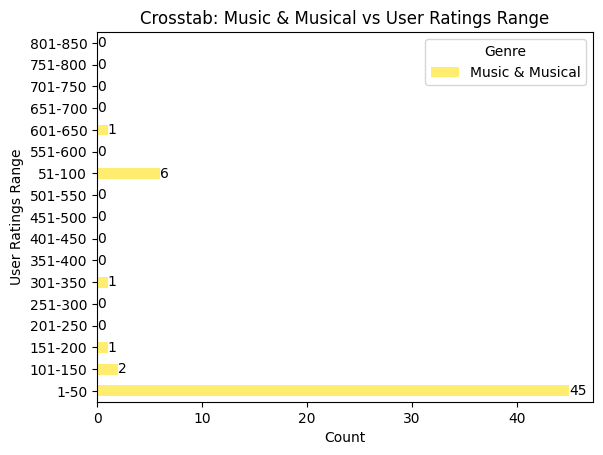

<Figure size 800x600 with 0 Axes>

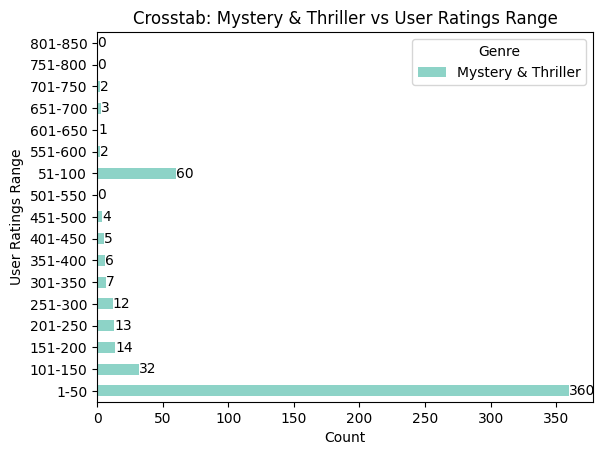

<Figure size 800x600 with 0 Axes>

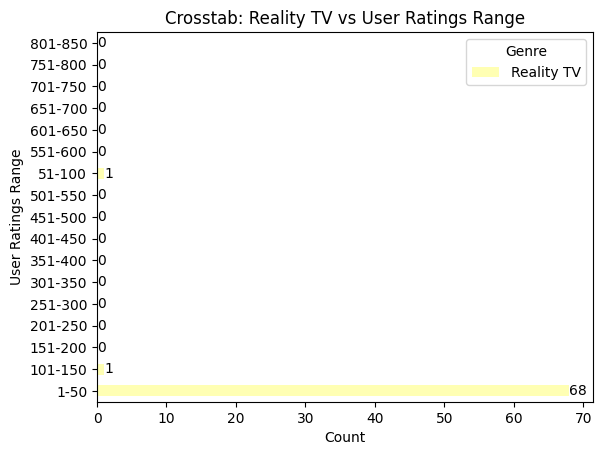

<Figure size 800x600 with 0 Axes>

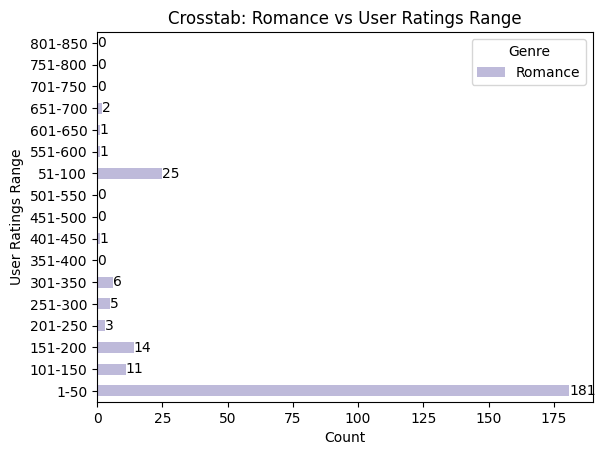

<Figure size 800x600 with 0 Axes>

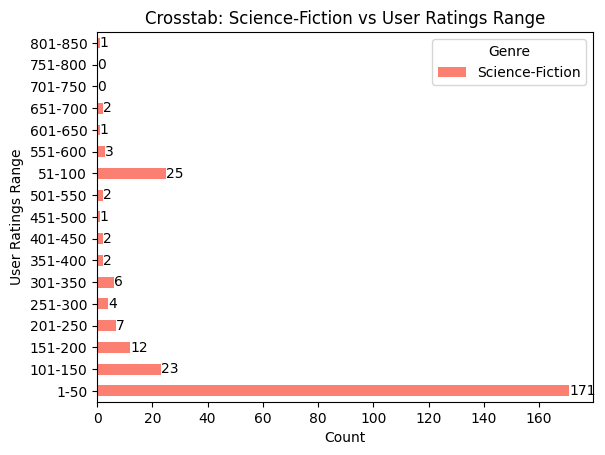

<Figure size 800x600 with 0 Axes>

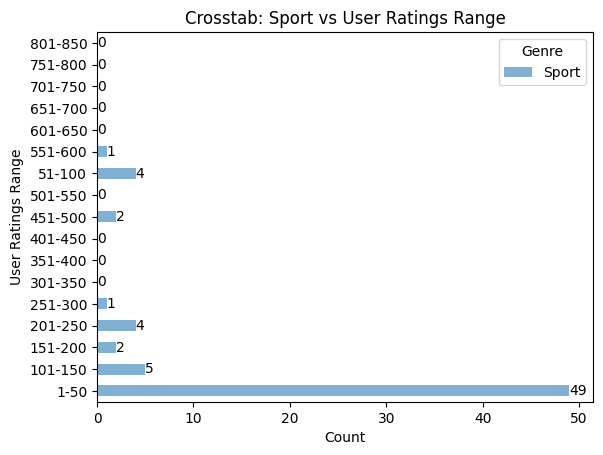

<Figure size 800x600 with 0 Axes>

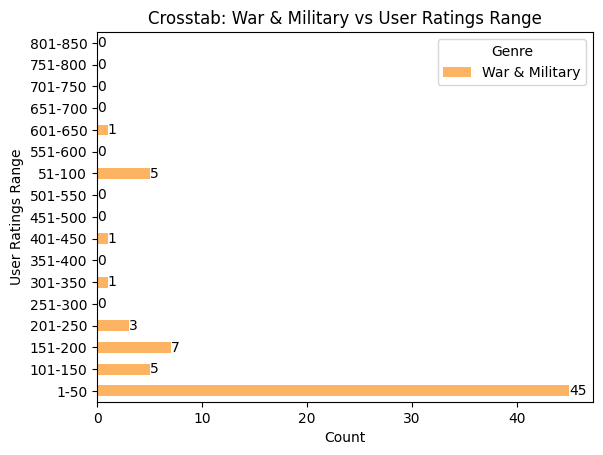

<Figure size 800x600 with 0 Axes>

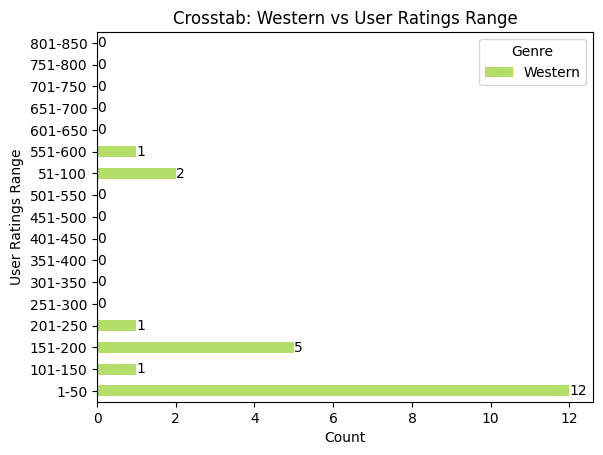

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from itertools import cycle

# Perform the crosstabulation
crosstab_data = pd.crosstab(df['Genre'], df['UserRatings_Range']).drop('No Value', axis=0).drop('nan', axis=1)

# Define a color palette
color_palette = cycle(sns.color_palette('Set3'))

# Iterate over each genre and create a separate graph
for genre in crosstab_data.index:
    # Create a new figure for each genre
    plt.figure(figsize=(8, 6))

    # Get the data for the current genre
    genre_data = crosstab_data.loc[[genre]]

    # Transpose the data to have 'UserRatings_Range' on the y-axis
    genre_data = genre_data.transpose()

    # Create a bar plot for the current genre with a different color
    ax = genre_data.plot(kind='barh', stacked=True, color=next(color_palette))

    # Set labels and title for the plot
    plt.xlabel('Count')
    plt.ylabel('User Ratings Range')
    plt.title(f'Crosstab: {genre} vs User Ratings Range')

    # Add bar labels
    for container in ax.containers:
        ax.bar_label(container, label_type='edge', fontsize=10)

    # Show the plot
    plt.show()


# **Movies Genre Dataset**

In [ ]:
movies = df[df['Category'] == 'Movie']
movies

,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
3033,¡Que Viva México!,Movie,Luis Estrada,2023,2021-2025,Drama,191,190-195,74.0,70-80,5.5,5.6-6.0,1.0,1-50
3034,¡Que Viva México!,Movie,Luis Estrada,2023,2021-2025,Comedy,191,190-195,74.0,70-80,5.5,5.6-6.0,1.0,1-50
3035,11:11,Movie,Karim Abouzeid,2015,2016-2020,Science-Fiction,60,60-65,43.0,40-50,6.7,6.6-7.0,0.0,nan
3036,11:11,Movie,Karim Abouzeid,2015,2016-2020,Drama,60,60-65,43.0,40-50,6.7,6.6-7.0,0.0,nan
3037,11:11,Movie,Karim Abouzeid,2015,2016-2020,Music & Musical,60,60-65,43.0,40-50,6.7,6.6-7.0,0.0,nan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5677,Zombieland,Movie,Ruben Fleischer,2009,2006-2010,Fantasy,88,85-90,82.0,80-90,7.6,7.6-8.0,595.0,551-600
5678,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Comedy,102,100-105,60.0,60-70,5.2,5.1-5.5,63.0,51-100
5679,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Romance,102,100-105,60.0,60-70,5.2,5.1-5.5,63.0,51-100
5680,Zookeeper,Movie,Frank Coraci,2011,2011-2015,Kids & Family,102,100-105,60.0,60-70,5.2,5.1-5.5,63.0,51-100


In [ ]:
movies.shape

(2649, 14)

# Total of 927 movies hosted by Netflix in the dataset acording to JustWatch Website

In [ ]:
len(movies.Title.value_counts())

927

# Checking for null values

In [ ]:
movies.isnull().sum()

Title                              0
Category                           0
Director                           0
Release_Year                       0
Release_Year_Range                 0
Genre                              0
Runtime_In_Minutes                 0
Runtime_Range                      0
Just_Watch_Rating_In_Percentage    0
JustWatch_Range                    0
IMDB_Rating                        0
IMDB_Range                         0
User_Ratings_Value_K               0
UserRatings_Range                  0
dtype: int64

# **The provided data represents the frequency or count of different genres in the movie category of a Netflix dataset.**



Drama: Drama is the most prevalent genre among Netflix movies, with 498 titles. This indicates a strong emphasis on dramatic storytelling and character-driven narratives in the movie selection.

Comedy: Comedy is the second most common genre, with 368 titles. This suggests that Netflix offers a wide range of comedic movies, catering to viewers who enjoy light-hearted and humorous entertainment.

Mystery & Thriller: The Mystery & Thriller genre follows closely behind with 309 titles. This indicates a significant presence of suspenseful and intriguing movies, appealing to viewers who enjoy thrilling and enigmatic storylines.

Action & Adventure: Netflix provides a considerable selection of Action & Adventure movies, with 245 titles. This genre caters to viewers who enjoy adrenaline-pumping action sequences and exciting adventures.

Crime: The Crime genre has 194 titles, indicating a significant collection of movies centered around criminal activities, investigations, and the criminal justice system.

Romance: Netflix offers a range of romantic movies, with 160 titles. This genre caters to viewers who enjoy love stories, romantic comedies, and heartfelt dramas.

Other Genres: The remaining genres include Documentary (136 titles), Fantasy (118 titles), Horror (112 titles), Kids & Family (94 titles), Science-Fiction (83 titles), and others. These genres represent specific interests and preferences of viewers within the movie category.

In [ ]:
movie_genre_counts = movies['Genre'].value_counts()
movie_genre_counts

Drama                 498
Comedy                368
Mystery & Thriller    309
Action & Adventure    245
Crime                 194
Romance               160
Documentary           136
Fantasy               118
Horror                112
Kids & Family          94
Science-Fiction        83
Made in Europe         78
Animation              60
History                51
Sport                  42
Music & Musical        41
War & Military         39
Western                15
Reality TV              6
Name: Genre, dtype: int64

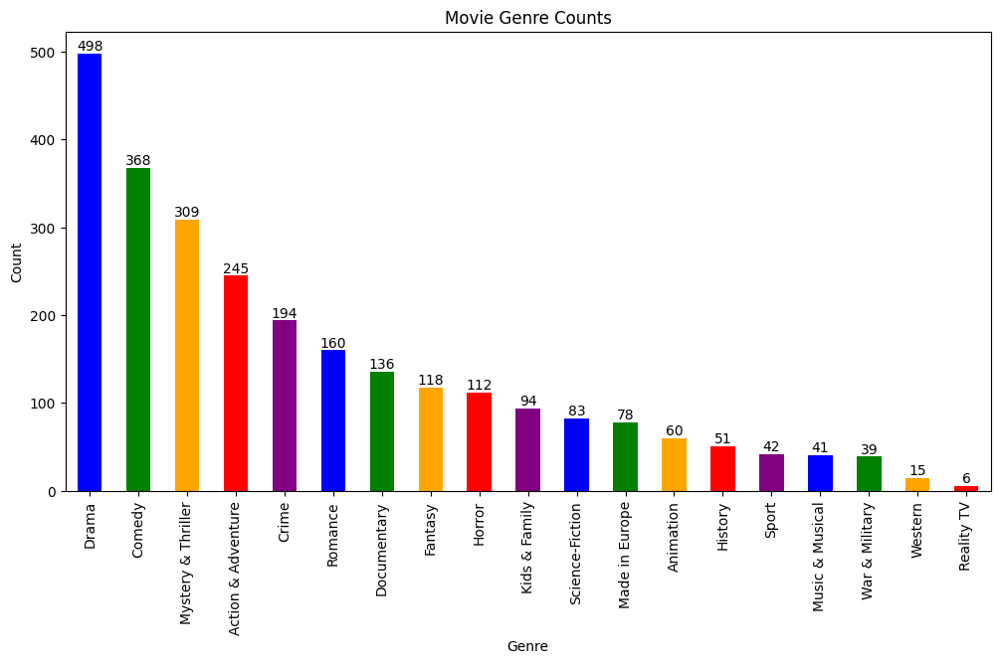

In [ ]:
import matplotlib.pyplot as plt

# Calculate movie genre counts
movie_genre_counts = movies['Genre'].value_counts()

# Define a color palette
color_palette = ['blue', 'green', 'orange', 'red', 'purple']

# Create a bar plot with color
plt.figure(figsize=(12, 6))
bar_plot = movie_genre_counts.plot(kind='bar', color=color_palette)

# Set labels and title
plt.xlabel('Genre')
plt.ylabel('Count')
plt.title('Movie Genre Counts')

# Add bar labels
for i, count in enumerate(movie_genre_counts):
    plt.text(i, count, str(count), ha='center', va='bottom')

# Show the plot
plt.show()


#**The table provides a breakdown of movies across different genres and release year ranges.**

Release Year Ranges: The release year ranges are listed in columns, representing different intervals of years. Each column represents a specific range of release years.

Genre Breakdown: The genres are listed in rows, and the corresponding counts for movies are displayed in the respective columns.

Genre Distribution: The table shows the distribution of movies across various genres for each release year range. It provides insights into the popularity and production trends of different genres over time.

Popular Genres: Drama is the most prevalent genre across most release year ranges, indicating its enduring popularity over time. Other popular genres include Comedy, Action & Adventure, Mystery & Thriller, and Animation.

Release Year Trends: The counts within each genre for different release year ranges can give an indication of the production trends and popularity of genres during specific time periods. For example, genres like Action & Adventure, Drama, and Comedy have a higher count in the more recent release year ranges, suggesting their continued popularity and production.

Genre Evolution: The table also reveals changes in genre counts over different release year ranges. For example, genres like Crime, Mystery & Thriller, and Horror show an increase in counts in the more recent release year ranges, indicating their growing popularity in recent years.

In [ ]:
pd.crosstab(movies['Genre'], movies['Release_Year_Range']).drop('nan', axis=1)

Release_Year_Range,1975-1980,1981-1985,1986-1990,1991-1995,1996-2000,2001-2005,2006-2010,2011-2015,2016-2020,2021-2025
Genre,,,,,,,,,,
Action & Adventure,2,2,1,5,9,17,7,24,57,118
Animation,0,0,1,0,1,2,1,9,21,25
Comedy,5,0,4,6,8,12,11,36,110,174
Crime,0,0,1,3,6,8,5,12,51,107
Documentary,1,0,0,0,1,0,1,2,46,85
Drama,4,1,6,7,10,15,17,41,135,255
Fantasy,1,1,0,3,3,9,4,15,27,55
History,0,0,0,0,1,1,5,2,15,27
Horror,0,0,0,0,3,4,5,8,26,64


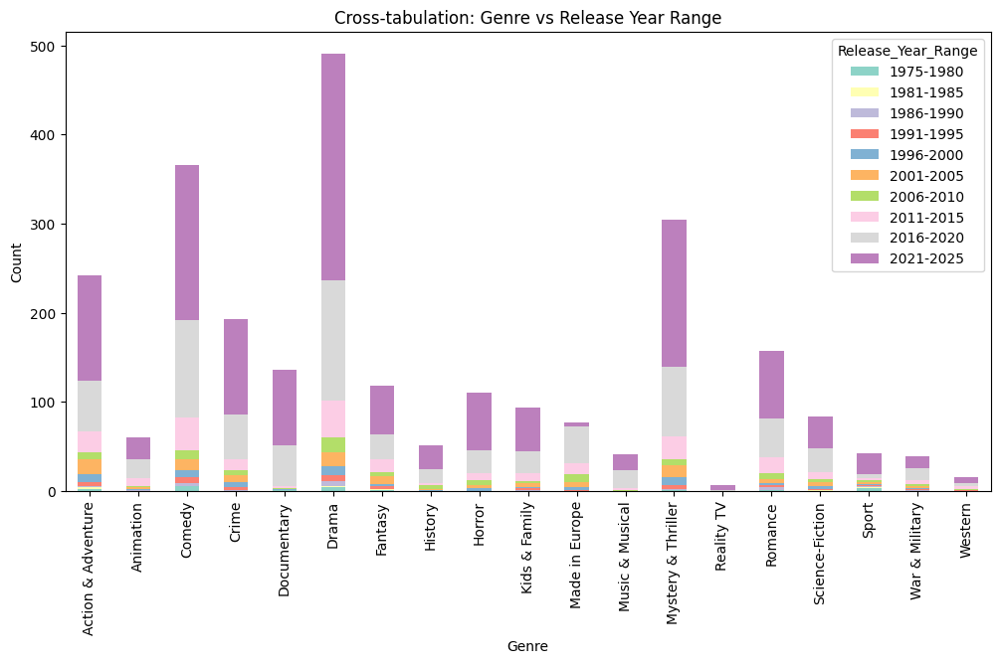

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Perform the crosstabulation
crosstab_data = pd.crosstab(movies['Genre'], movies['Release_Year_Range']).drop('nan', axis=1)

# Define a color palette
color_palette = sns.color_palette('Set3', n_colors=len(crosstab_data.columns))

# Create a bar plot with colors
crosstab_data.plot(kind='bar', stacked=True, figsize=(12, 6), color=color_palette)

# Set labels and title
plt.xlabel('Genre')
plt.ylabel('Count')
plt.title('Cross-tabulation: Genre vs Release Year Range')


# Show the plot
plt.show()


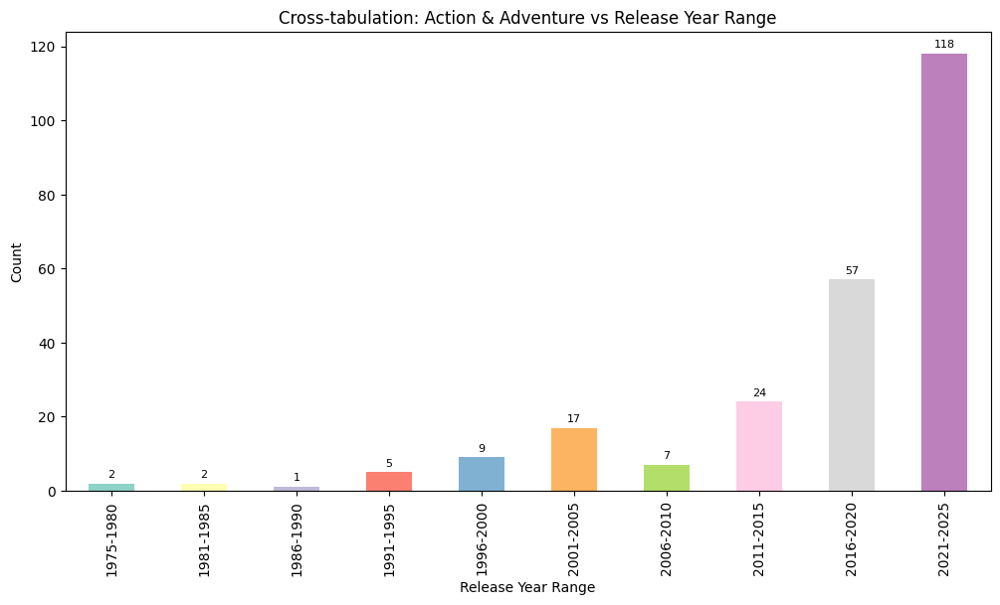

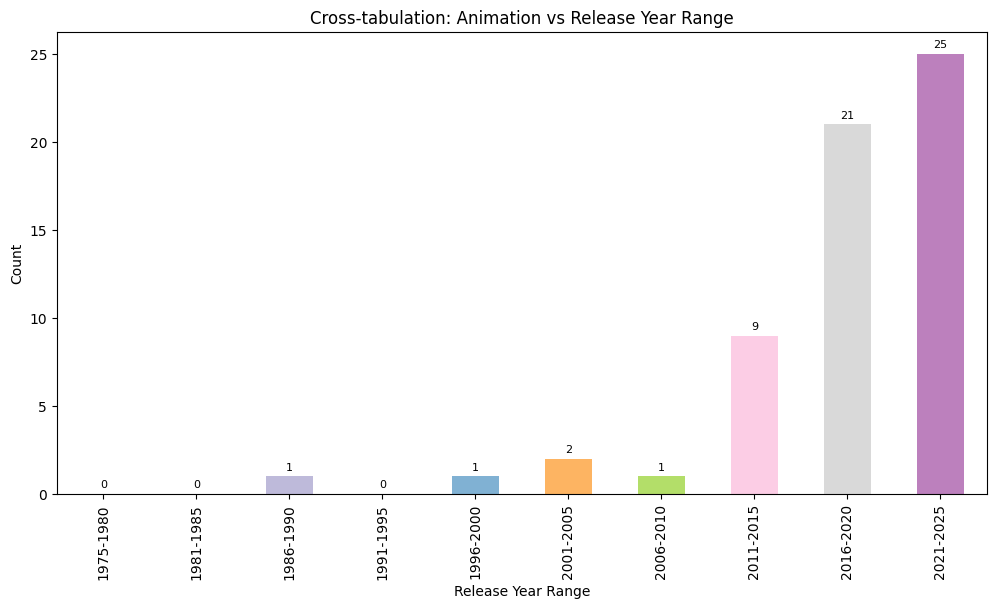

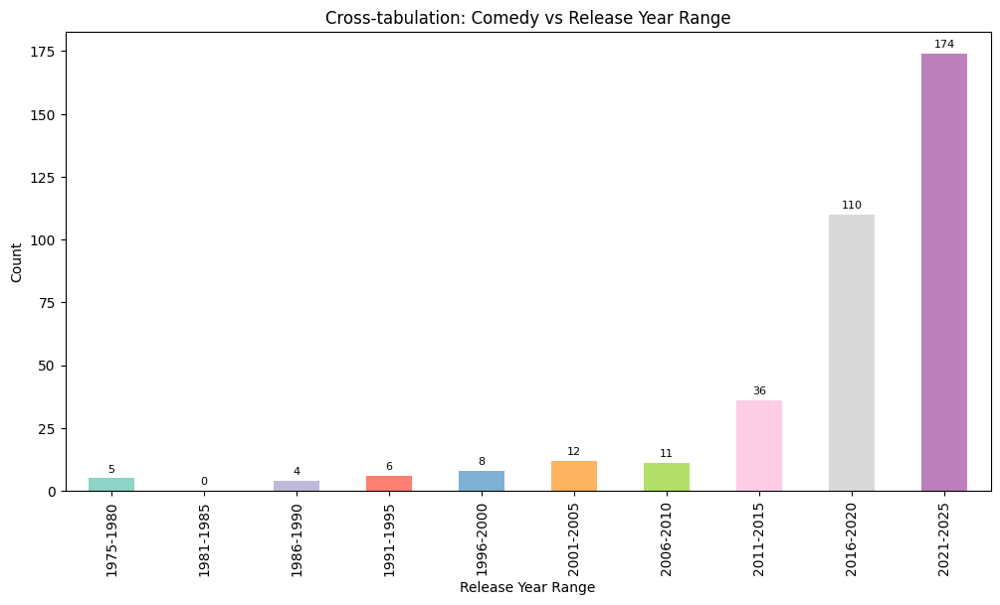

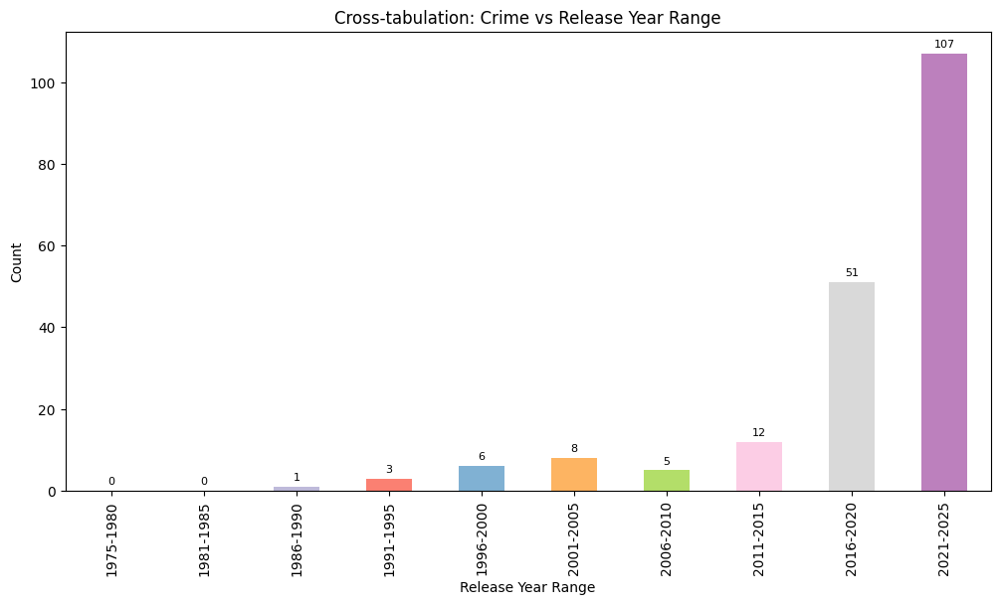

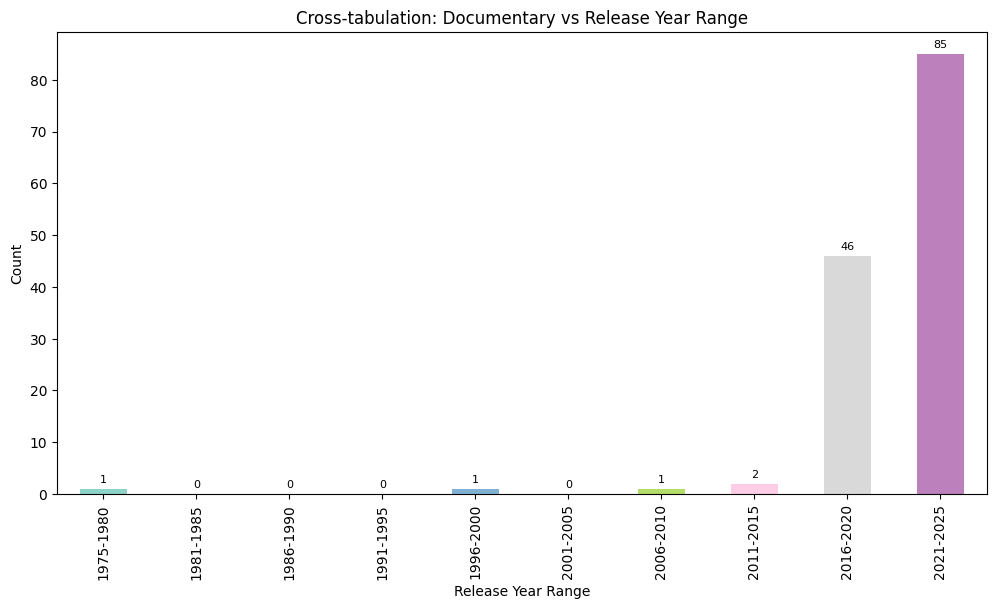

...

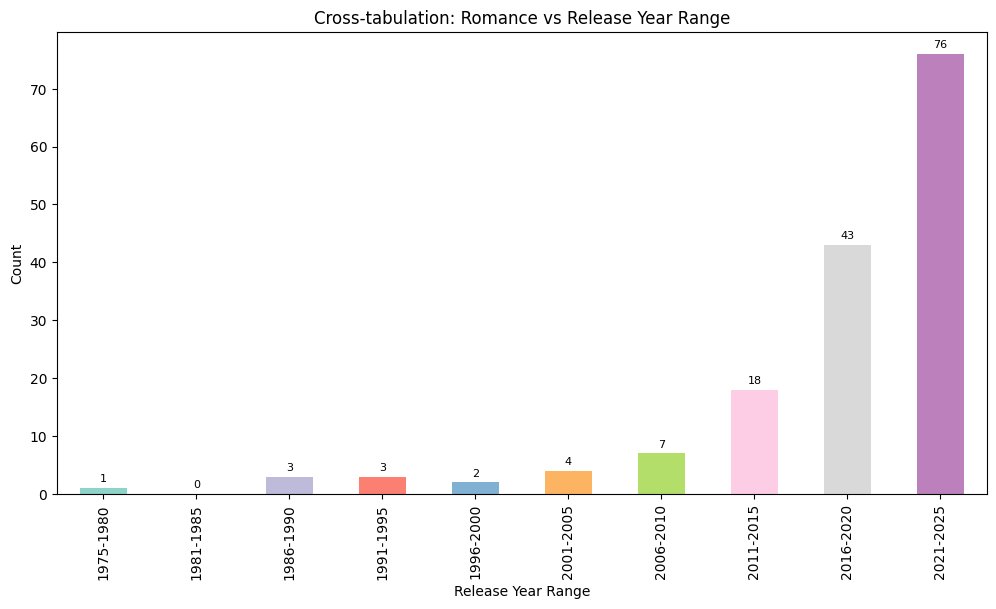

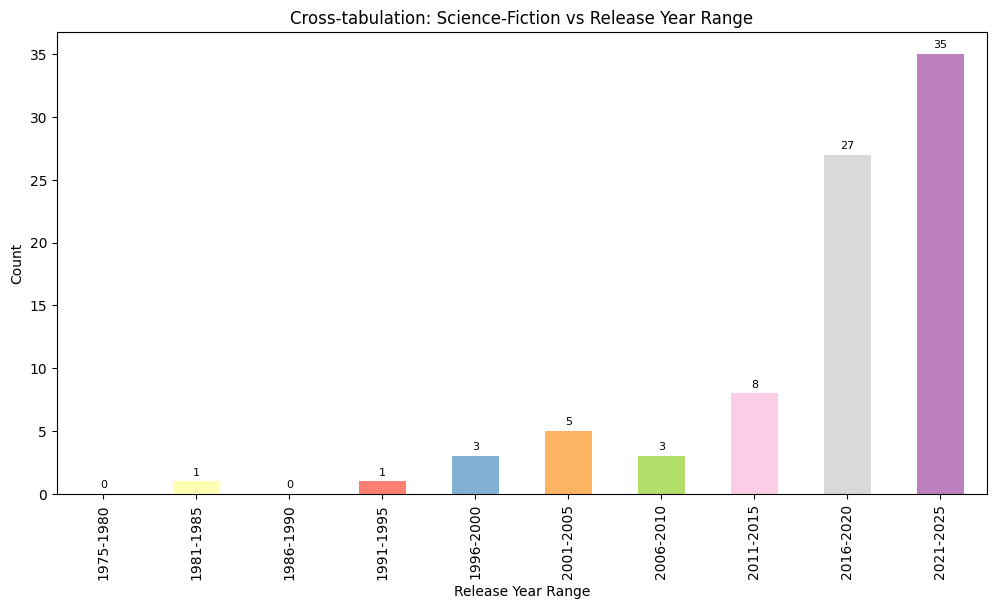

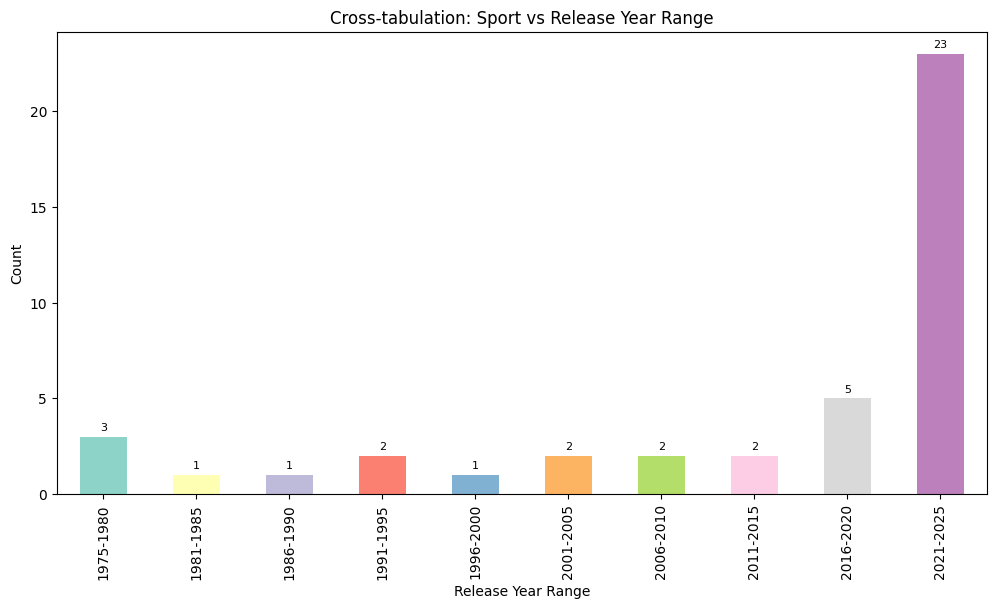

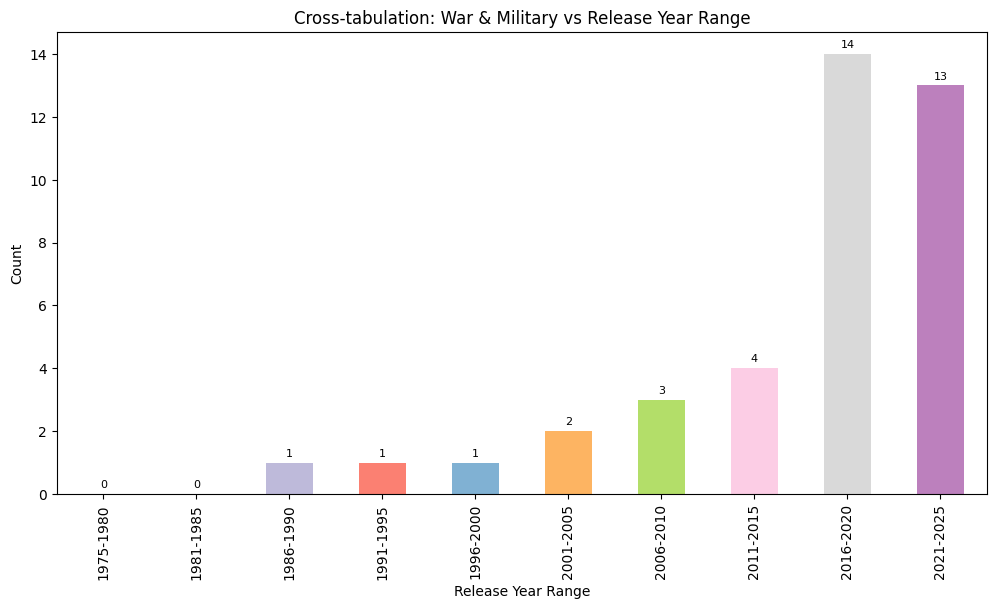

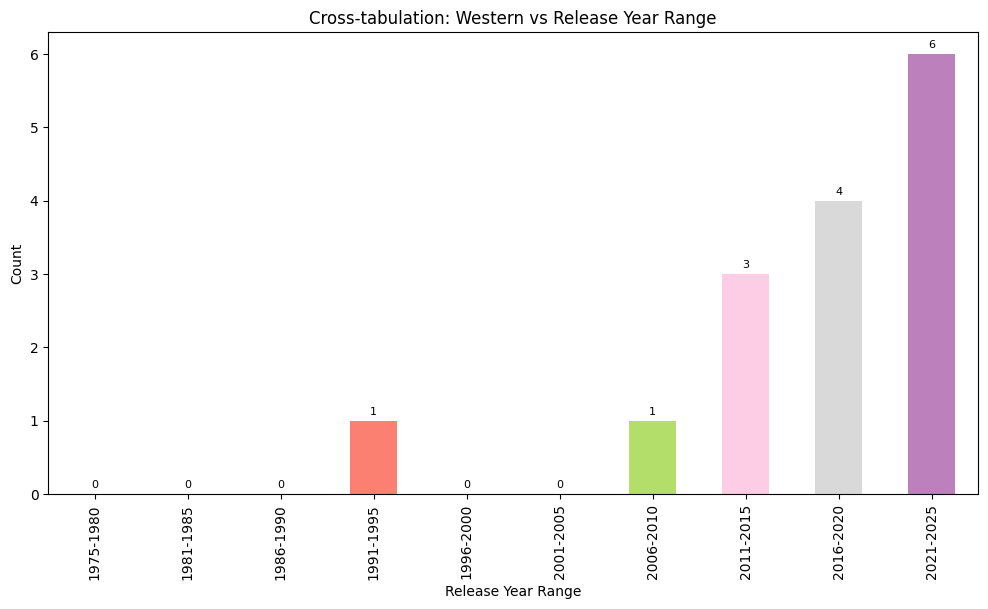

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Perform the crosstabulation
crosstab_data = pd.crosstab(movies['Genre'], movies['Release_Year_Range']).drop('nan', axis=1)

# Define a color palette
color_palette = sns.color_palette('Set3', n_colors=len(crosstab_data.columns))

# Iterate over each genre and create a separate plot
for genre in crosstab_data.index:
    # Create a new figure and axis for each genre
    fig, ax = plt.subplots(figsize=(12, 6))

    # Get the data for the current genre
    genre_data = crosstab_data.loc[genre]

    # Create a bar plot for the current genre with a different color
    genre_data.plot(kind='bar', stacked=True, color=color_palette, ax=ax)

    # Set labels and title for the plot
    ax.set_xlabel('Release Year Range')
    ax.set_ylabel('Count')
    ax.set_title(f'Cross-tabulation: {genre} vs Release Year Range')

    # Add bar labels
    for container in ax.containers:
        ax.bar_label(container, label_type='edge', fontsize=8, color='black', padding=3)

    # Show the plot
    plt.show()


#**The table provides a breakdown of movies across different genres and runtime ranges.**

Runtime Range: The runtime ranges are listed in rows, representing different intervals of movie runtimes.

Genre Breakdown: The genres are listed in columns, and the corresponding counts for movies are displayed in the respective cells.

Genre Distribution: The table shows the distribution of movies across various genres for each runtime range. It provides insights into the popularity and production trends of different genres based on movie runtimes.

Popular Genres: Drama is the most prevalent genre across most runtime ranges, indicating its enduring popularity. Other popular genres include Comedy, Action & Adventure, Mystery & Thriller, and Animation.

Runtime Trends: The counts within each genre for different runtime ranges can give an indication of the production trends and popularity of genres within specific runtime durations. For example, genres like Drama, Comedy, and Animation have a higher count in the longer runtime ranges, suggesting their prominence in feature-length films.

Genre Evolution: The table also reveals changes in genre counts over different runtime ranges. For example, genres like Comedy, Drama, Mystery & Thriller, and Animation show an increase in counts in the longer runtime ranges, indicating their prevalence in full-length movies.


In [ ]:
pd.crosstab(movies['Runtime_Range'], movies['Genre'])

Genre,Action & Adventure,Animation,Comedy,Crime,Documentary,Drama,Fantasy,History,Horror,Kids & Family,Made in Europe,Music & Musical,Mystery & Thriller,Reality TV,Romance,Science-Fiction,Sport,War & Military,Western
Runtime_Range,,,,,,,,,,,,,,,,,,,
0-5,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
10-15,0,0,0,0,1,2,0,0,0,0,0,0,0,0,0,0,0,0,0
15-20,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0
20-25,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
25-30,0,0,1,0,3,0,0,0,0,0,0,0,0,0,0,0,1,1,0
30-35,0,0,1,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0
35-40,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
40-45,0,1,1,1,4,0,0,0,0,0,0,1,0,0,0,0,0,0,0
45-50,1,1,1,0,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0


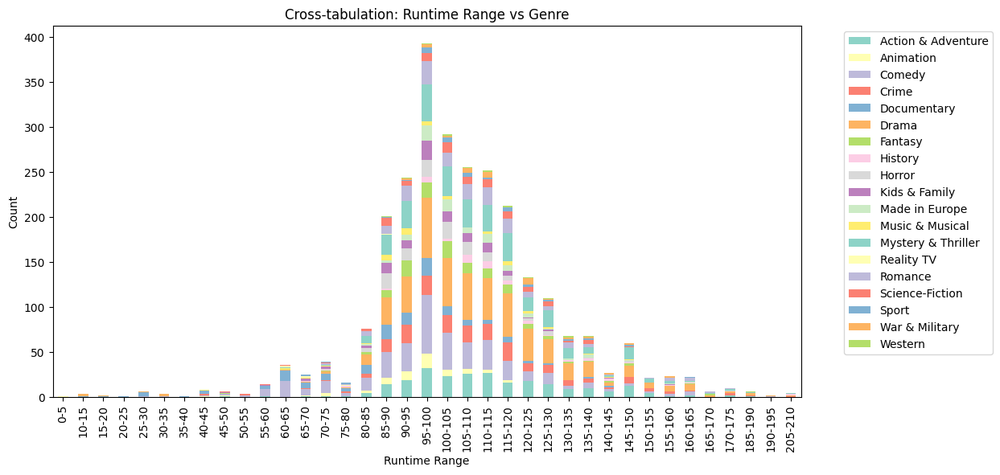

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Perform the crosstabulation
crosstab_data = pd.crosstab(movies['Runtime_Range'], movies['Genre'])

# Define a color palette
color_palette = sns.color_palette('Set3', n_colors=len(crosstab_data.columns))

# Create a bar plot with colors
ax = crosstab_data.plot(kind='bar', stacked=True, figsize=(12, 6), color=color_palette)

# Set labels and title
plt.xlabel('Runtime Range')
plt.ylabel('Count')
plt.title('Cross-tabulation: Runtime Range vs Genre')

# Move the legend outside the plot area
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# Show the plot
plt.show()


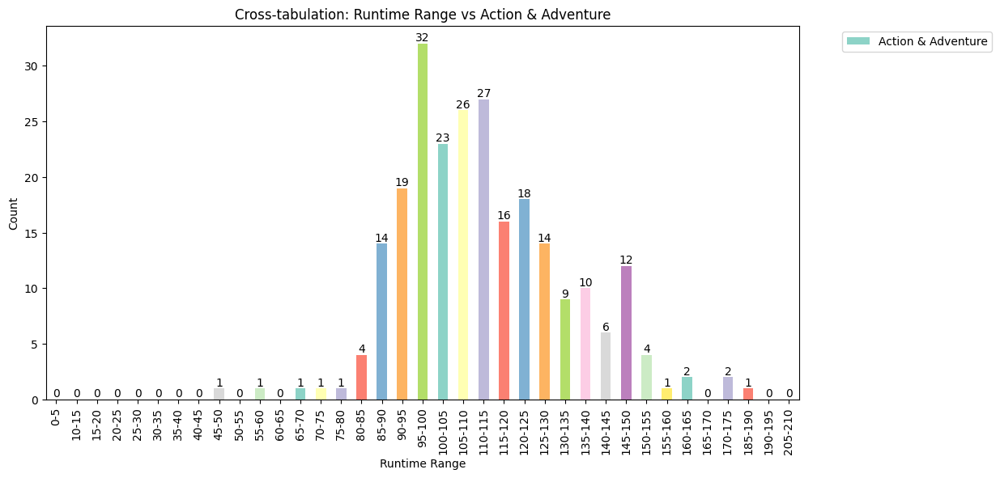

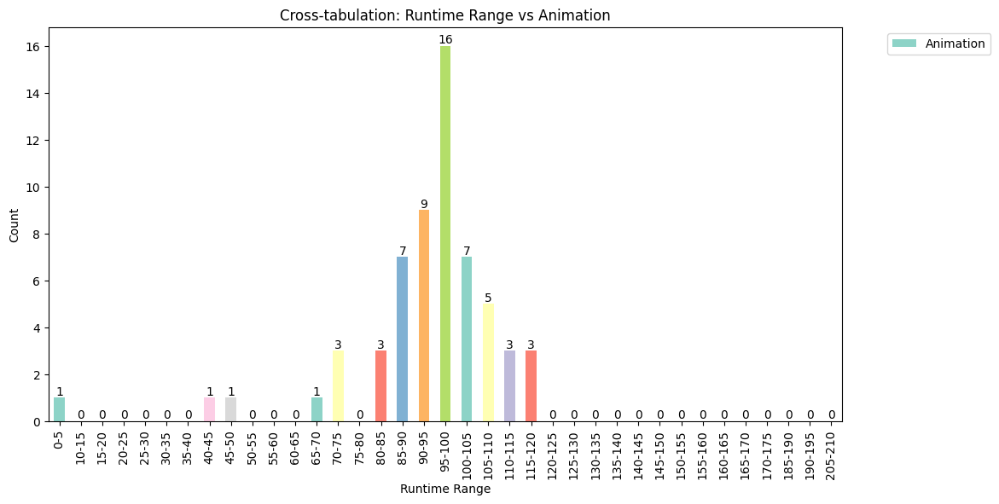

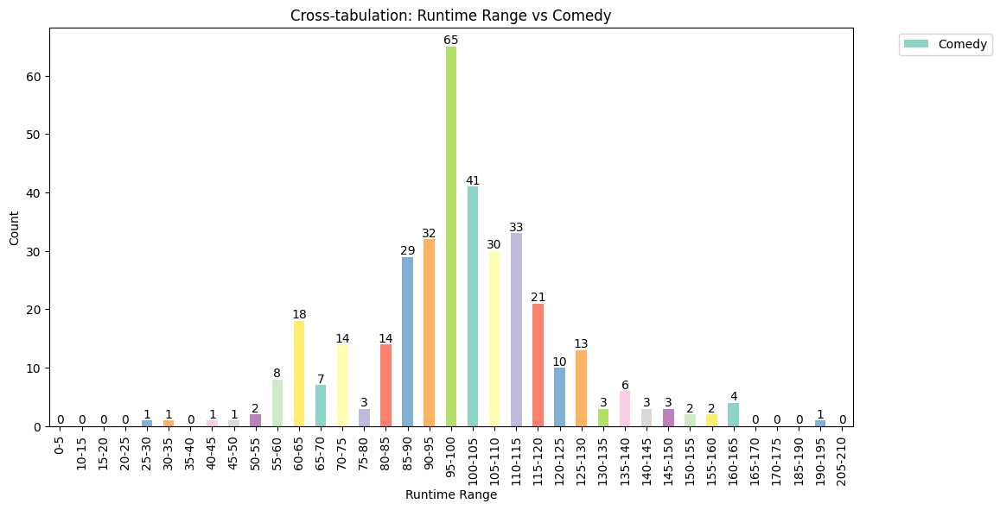

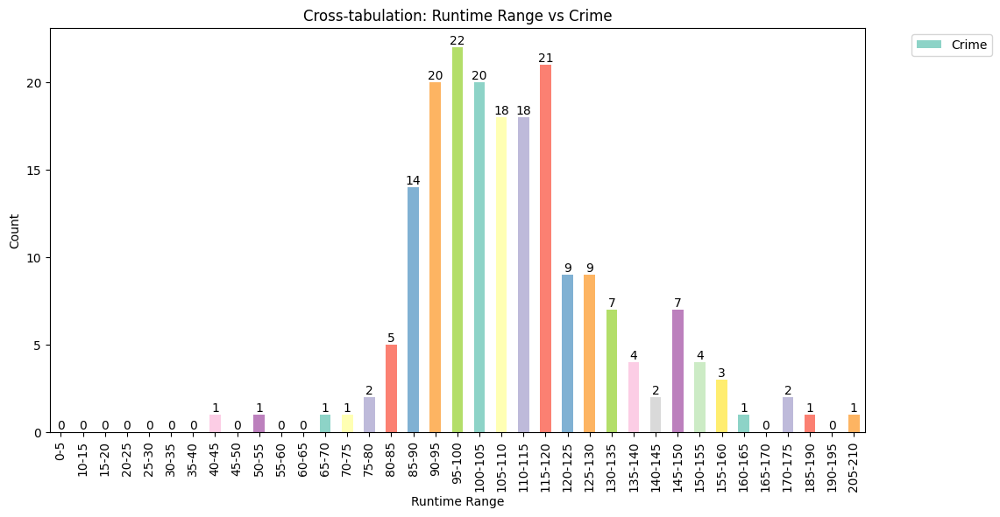

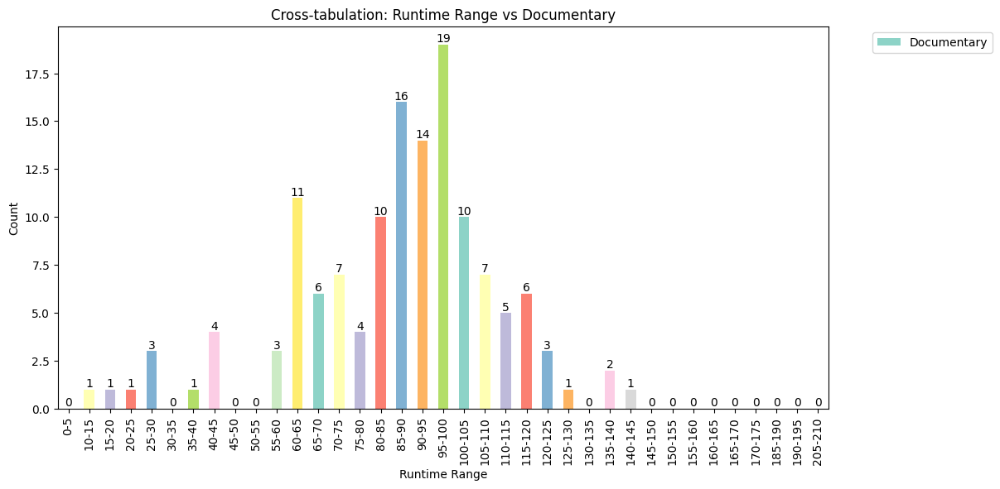

...

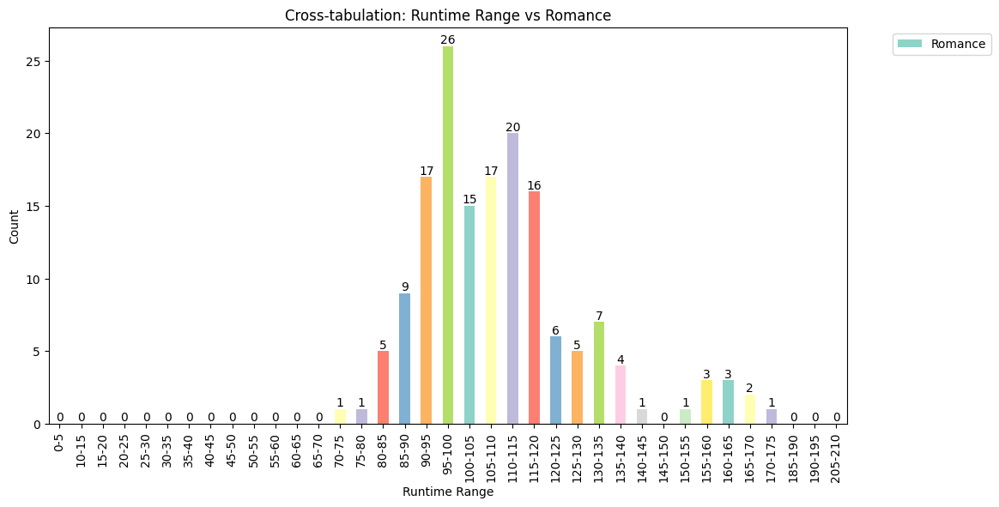

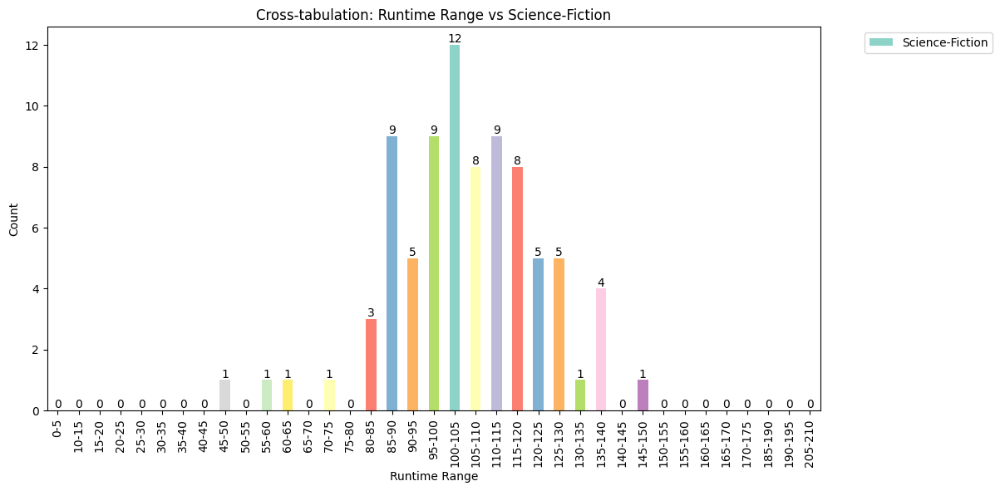

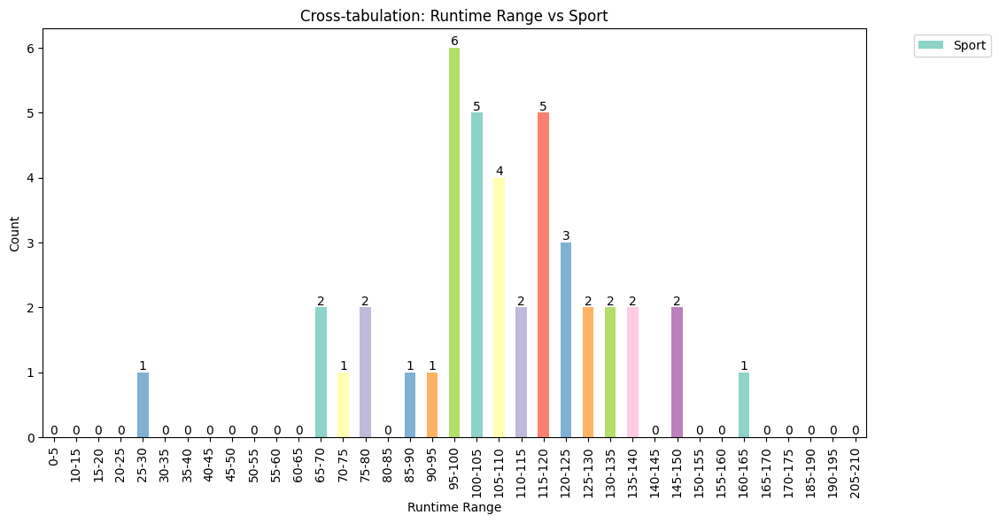

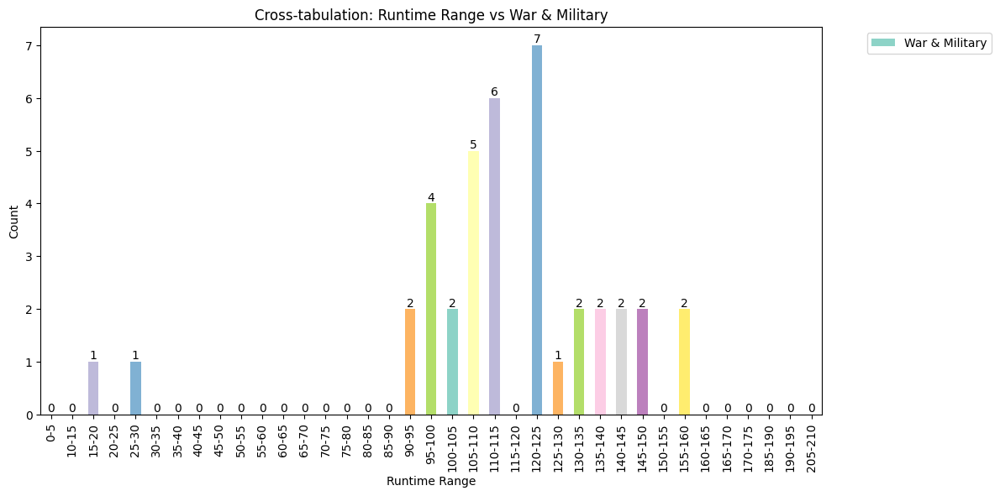

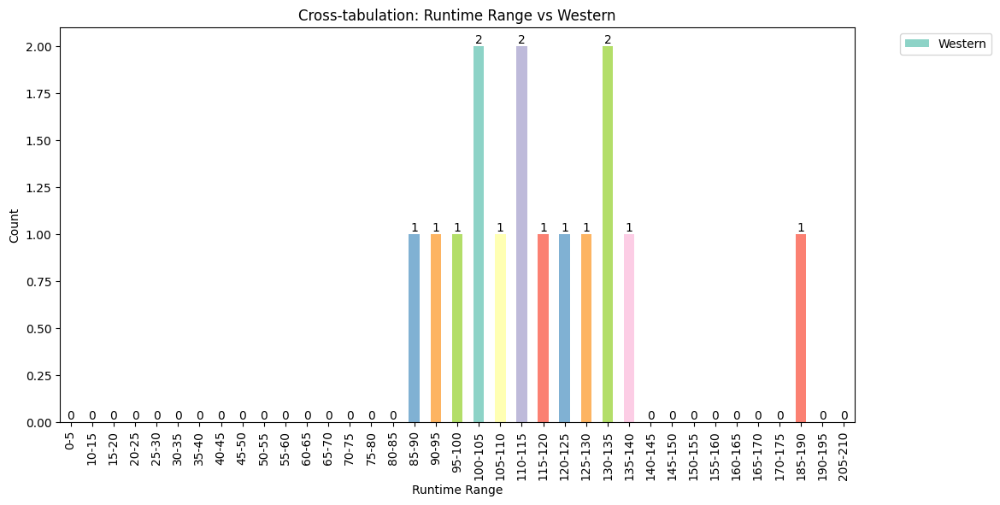

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Perform the crosstabulation
crosstab_data = pd.crosstab(movies['Runtime_Range'], movies['Genre'])

# Define a color palette
color_palette = sns.color_palette('Set3', n_colors=len(crosstab_data.columns))

# Iterate over each genre and create a separate plot
for genre in crosstab_data.columns:
    # Create a new figure for each genre
    plt.figure(figsize=(12, 6))

    # Get the data for the current genre
    genre_data = crosstab_data[genre]

    # Create a bar plot for the current genre with a different color
    ax = genre_data.plot(kind='bar', stacked=True, color=color_palette)

    # Set labels and title for the plot
    plt.xlabel('Runtime Range')
    plt.ylabel('Count')
    plt.title(f'Cross-tabulation: Runtime Range vs {genre}')

    # Add labels to the bars
    for i, v in enumerate(genre_data):
        ax.text(i, v, str(v), ha='center', va='bottom')

    # Add legend outside the plot
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

    # Show the plot
    plt.show()


#**The table provides a breakdown of genres across different IMDb rating ranges.**

IMDb Range: The IMDb rating ranges are listed in columns, representing different intervals of IMDb ratings.

Genre Breakdown: The genres are listed in rows, and the corresponding counts for each genre are displayed in the respective cells.

Genre Distribution: The table shows the distribution of genres across various IMDb rating ranges. It provides insights into the popularity and rating trends of different genres.

Popular Genres: Drama is the most prevalent genre across most IMDb rating ranges, indicating its enduring popularity and critical acclaim. Other popular genres include Comedy, Action & Adventure, Mystery & Thriller, and Animation.

IMDb Rating Trends: The counts within each genre for different IMDb rating ranges can give an indication of the rating trends and audience reception of genres. For example, genres like Drama, Comedy, and Animation have a higher count in the higher IMDb rating ranges, suggesting their higher quality and positive audience reception.

Genre Evolution: The table also reveals changes in genre counts over different IMDb rating ranges. For example, genres like Comedy, Drama, Mystery & Thriller, and Animation show a significant increase in counts in the higher IMDb rating ranges, indicating their higher-rated and well-regarded movies.

In [ ]:
pd.crosstab(movies['Genre'], movies['IMDB_Range']).drop('nan', axis=1)

IMDB_Range,2.0-2.5,2.6-3.0,3.1-3.5,3.6-4.0,4.1-4.5,4.6-5.0,5.1-5.5,5.6-6.0,6.1-6.5,6.6-7.0,7.1-7.5,7.6-8.0,8.1-8.5,8.6-9.0
Genre,,,,,,,,,,,,,,
Action & Adventure,0,1,2,1,4,14,16,53,45,47,35,13,9,4
Animation,0,0,1,0,0,0,3,5,12,17,12,4,3,1
Comedy,0,0,2,4,7,17,30,67,63,68,66,24,11,2
Crime,1,0,1,1,3,11,10,33,42,38,34,13,4,2
Documentary,0,1,0,0,0,3,3,8,21,28,38,17,7,0
Drama,0,3,1,5,7,24,34,73,73,108,105,33,16,5
Fantasy,0,1,0,0,3,6,12,20,24,27,16,3,5,1
History,0,0,0,0,0,0,1,1,5,16,18,8,2,0
Horror,0,1,0,0,3,16,21,17,21,12,13,4,0,1


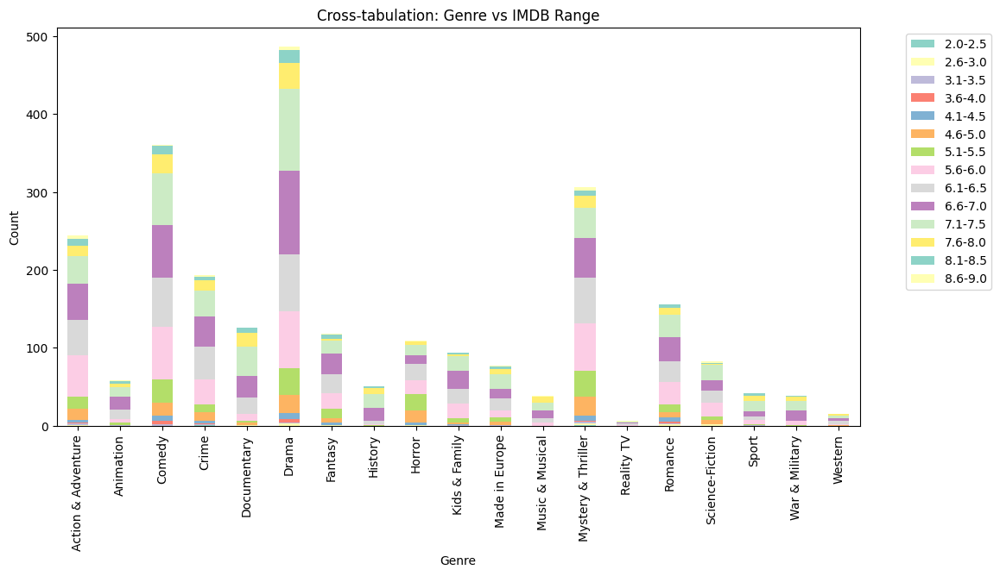

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Perform the crosstabulation
crosstab_data = pd.crosstab(movies['Genre'], movies['IMDB_Range']).drop('nan', axis=1)

# Define a color palette
color_palette = sns.color_palette('Set3', n_colors=len(crosstab_data.columns))

# Create a bar plot
ax = crosstab_data.plot(kind='bar', stacked=True, color=color_palette, figsize=(12, 6))

# Set labels and title
plt.xlabel('Genre')
plt.ylabel('Count')
plt.title('Cross-tabulation: Genre vs IMDB Range')

# Add legend outside the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# Show the plot
plt.show()


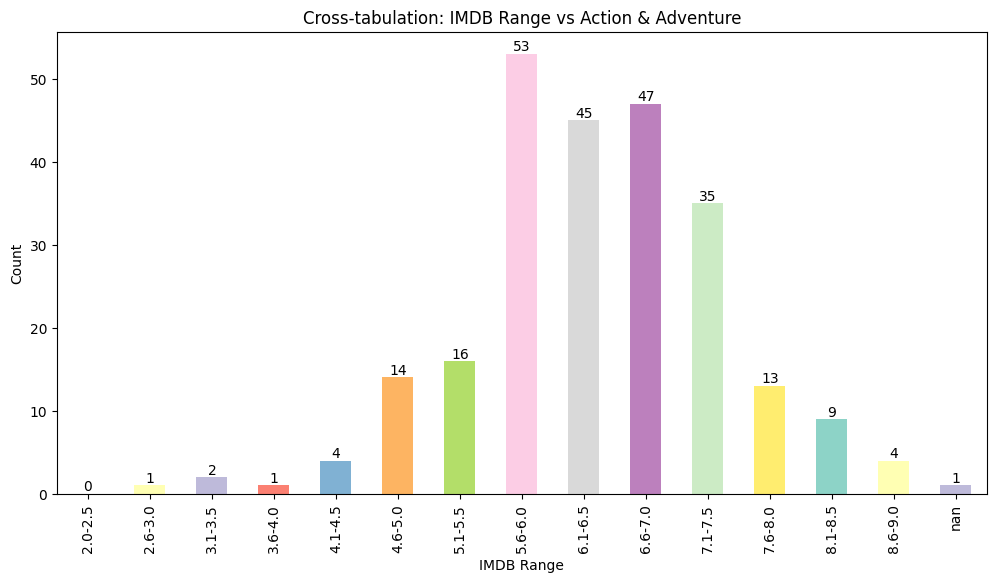

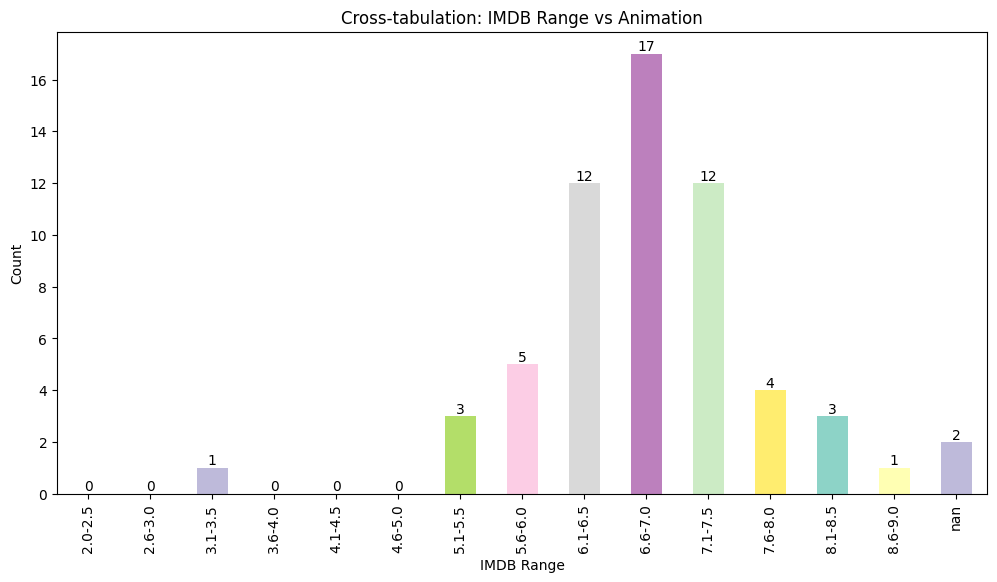

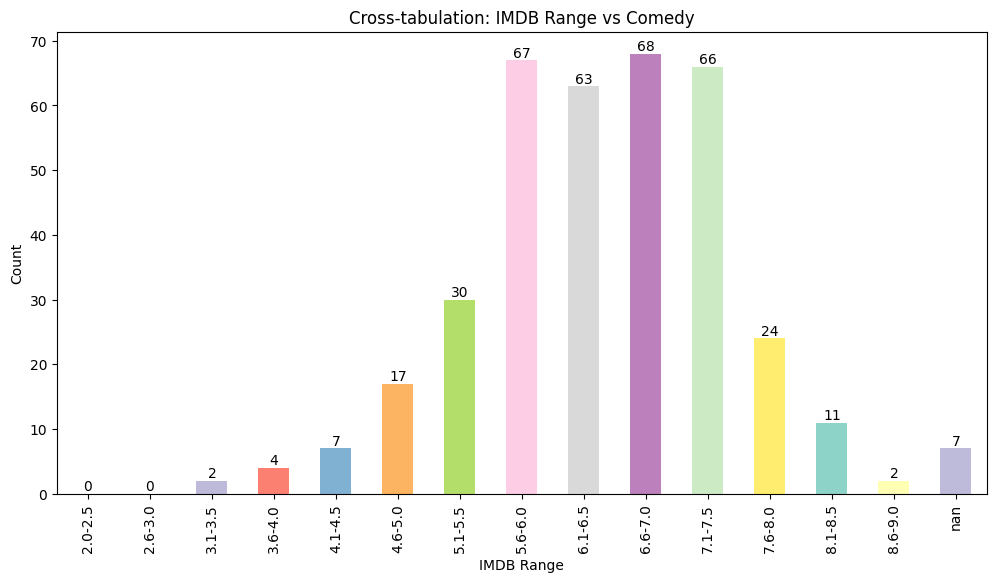

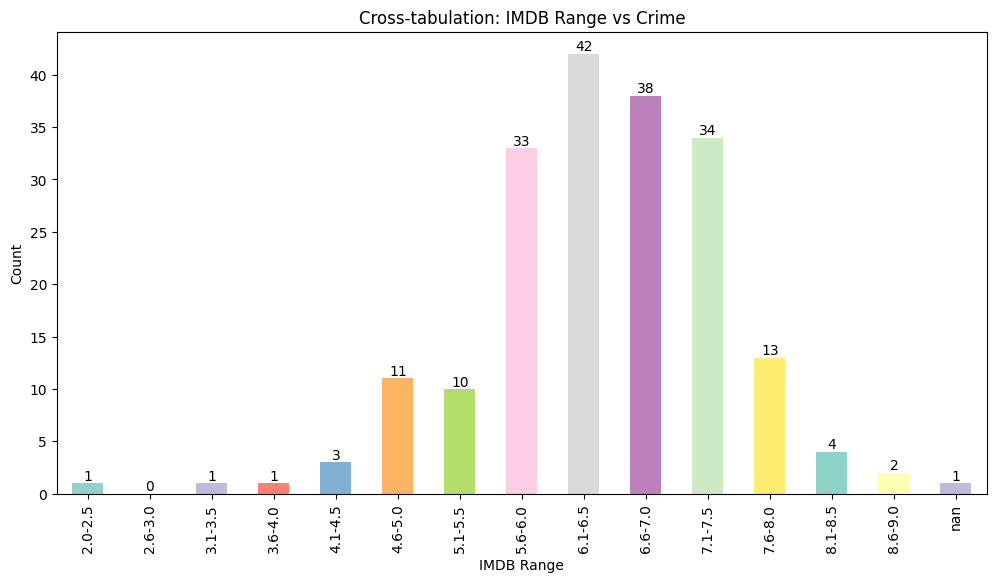

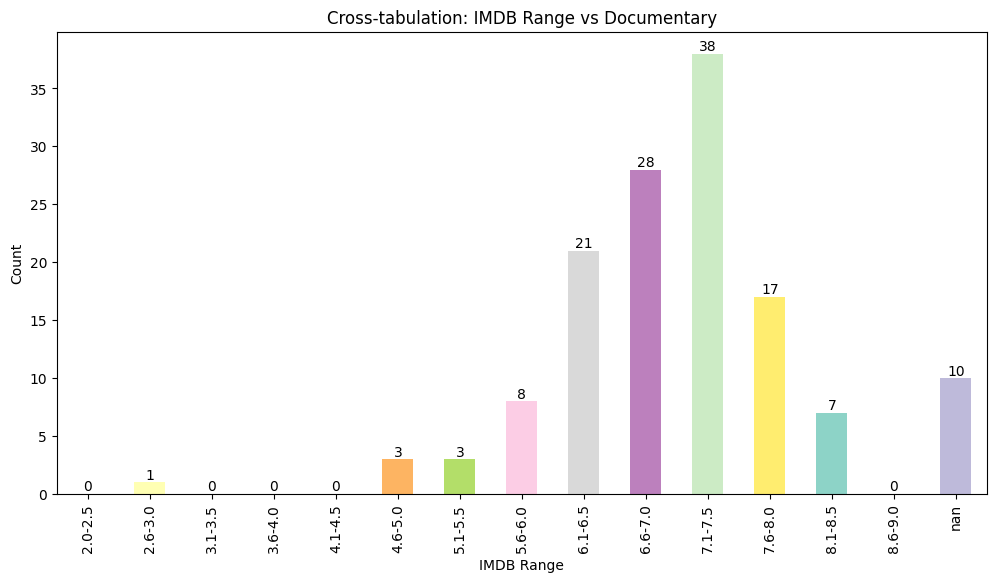

...

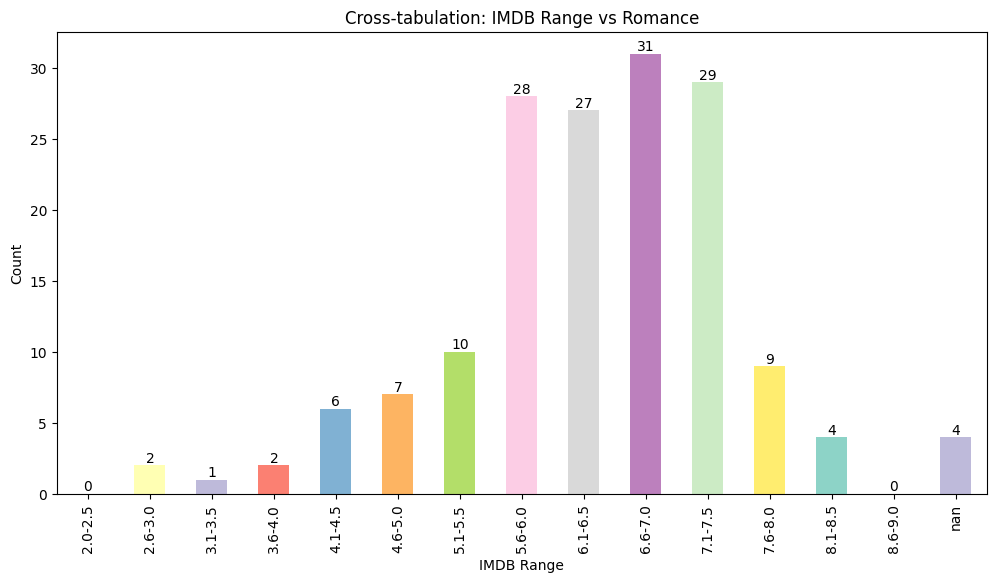

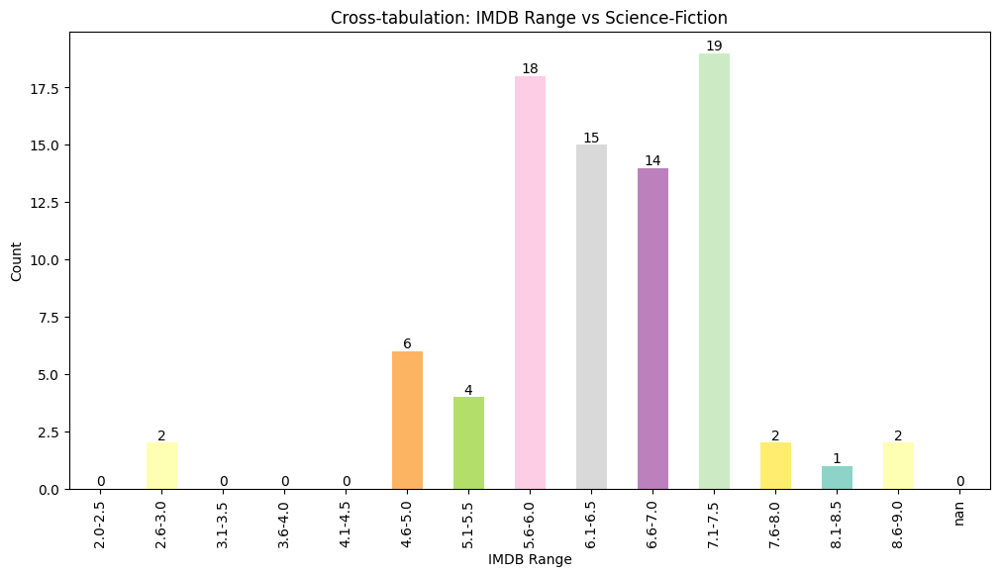

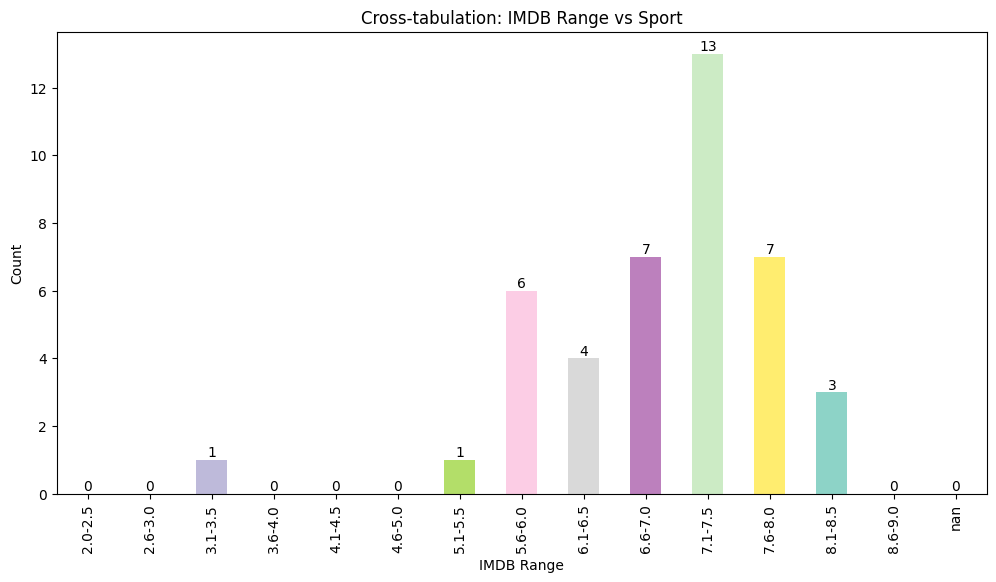

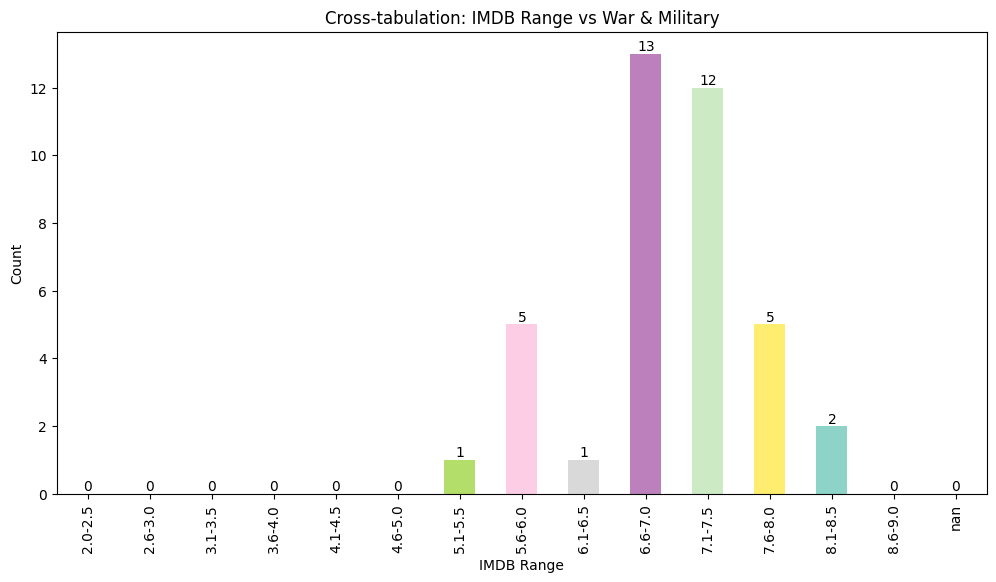

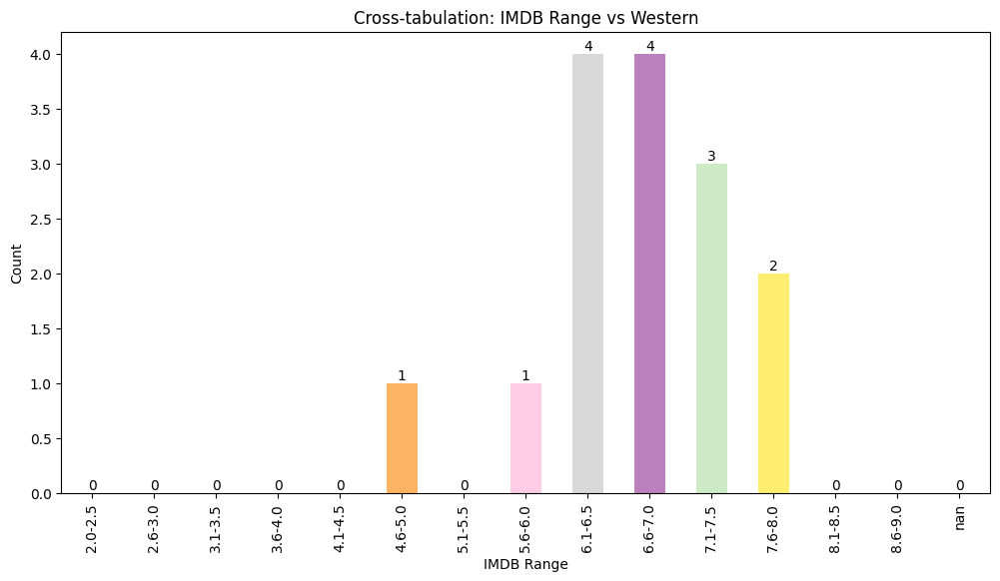

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Perform the crosstabulation
crosstab_data = pd.crosstab(movies['IMDB_Range'], movies['Genre'])

# Define a color palette
color_palette = sns.color_palette('Set3', n_colors=len(crosstab_data.columns))

# Iterate over each genre and create a separate plot
for genre in crosstab_data.columns:
    # Create a new figure for each genre
    plt.figure(figsize=(12, 6))

    # Get the data for the current genre
    genre_data = crosstab_data[genre]

    # Create a bar plot for the current genre with a different color
    ax = genre_data.plot(kind='bar', stacked=True, color=color_palette)

    # Set labels and title for the plot
    plt.xlabel('IMDB Range')
    plt.ylabel('Count')
    plt.title(f'Cross-tabulation: IMDB Range vs {genre}')

    # Add labels to the bars
    for i, v in enumerate(genre_data):
        ax.text(i, v, str(v), ha='center', va='bottom')


    # Show the plot
    plt.show()


#**The table provides a breakdown of genres across different JustWatch popularity ranges.**

JustWatch Range: The JustWatch popularity ranges are listed in columns, representing different intervals of popularity.

Genre Breakdown: The genres are listed in rows, and the corresponding counts for each genre are displayed in the respective cells.

Genre Distribution: The table shows the distribution of genres across various JustWatch popularity ranges. It provides insights into the popularity and viewer interest in different genres.

Popular Genres: Drama is the most prevalent genre across most JustWatch popularity ranges, indicating its widespread appeal and viewer interest. Other popular genres include Comedy, Action & Adventure, Mystery & Thriller, and Animation.

JustWatch Popularity Trends: The counts within each genre for different JustWatch popularity ranges can give an indication of the popularity trends and viewer engagement with genres. For example, genres like Drama, Comedy, and Animation have a higher count in the higher JustWatch popularity ranges, suggesting their higher viewership and interest.

Genre Evolution: The table also reveals changes in genre counts over different JustWatch popularity ranges. For example, genres like Drama, Comedy, and Mystery & Thriller show a significant increase in counts in the higher JustWatch popularity ranges, indicating their popularity among viewers.

In [ ]:
pd.crosstab(movies['Genre'], movies['JustWatch_Range'])

JustWatch_Range,10-20,30-40,40-50,50-60,60-70,70-80,80-90,90-100
Genre,,,,,,,,
Action & Adventure,0,2,4,11,85,104,33,6
Animation,0,2,0,2,9,30,14,3
Comedy,0,7,8,21,125,160,44,3
Crime,1,2,2,11,63,87,25,3
Documentary,0,7,5,4,24,69,27,0
Drama,0,8,10,31,134,221,87,7
Fantasy,0,1,0,7,33,58,16,3
History,0,0,0,0,4,31,16,0
Horror,0,3,1,19,45,36,7,1


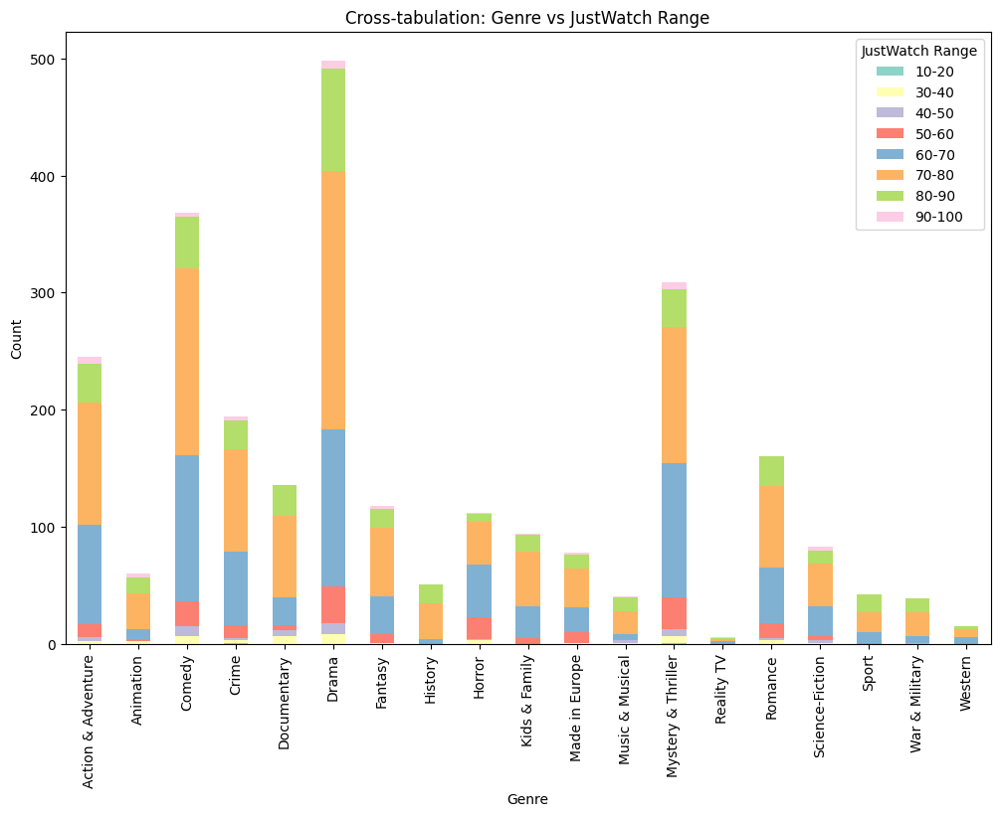

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Perform the crosstabulation
crosstab_data = pd.crosstab(movies['Genre'], movies['JustWatch_Range'])


# Define a color palette
color_palette = sns.color_palette('Set3')

# Create a stacked bar plot
ax = crosstab_data.plot(kind='bar', stacked=True, figsize=(12, 8), color=color_palette)

# Set labels and title
plt.xlabel('Genre')
plt.ylabel('Count')
plt.title('Cross-tabulation: Genre vs JustWatch Range')

# Add legend
plt.legend(title='JustWatch Range')

# Show the plot
plt.show()


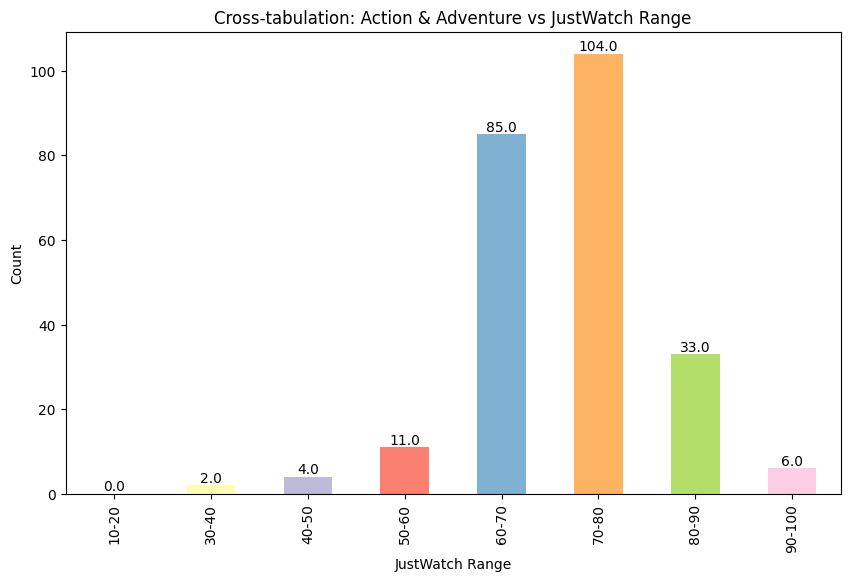

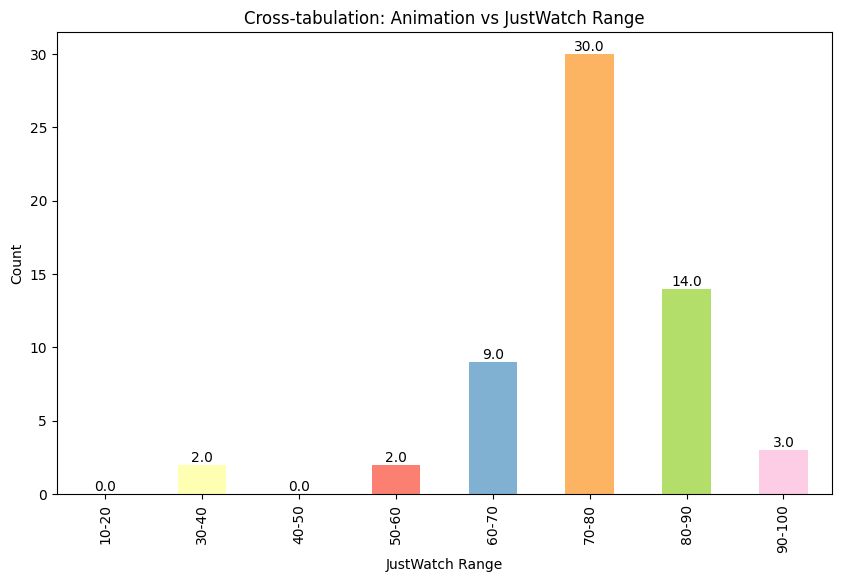

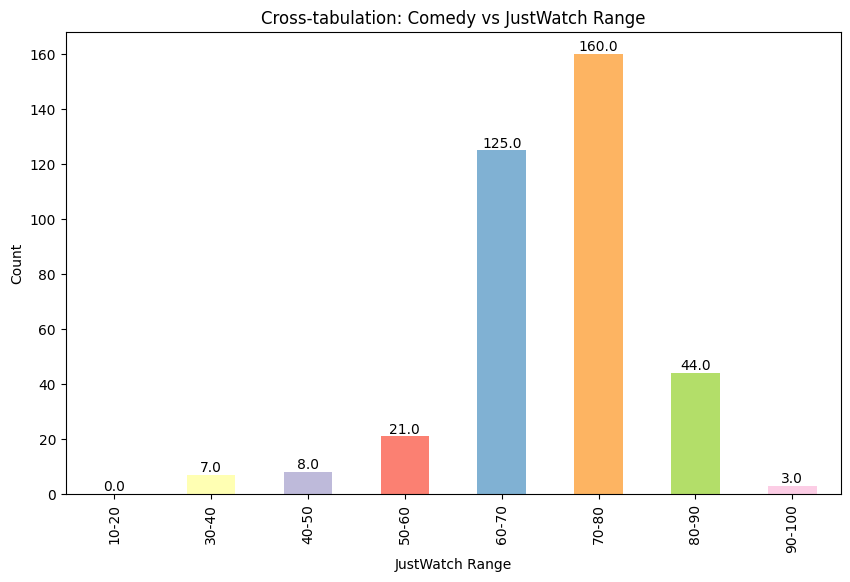

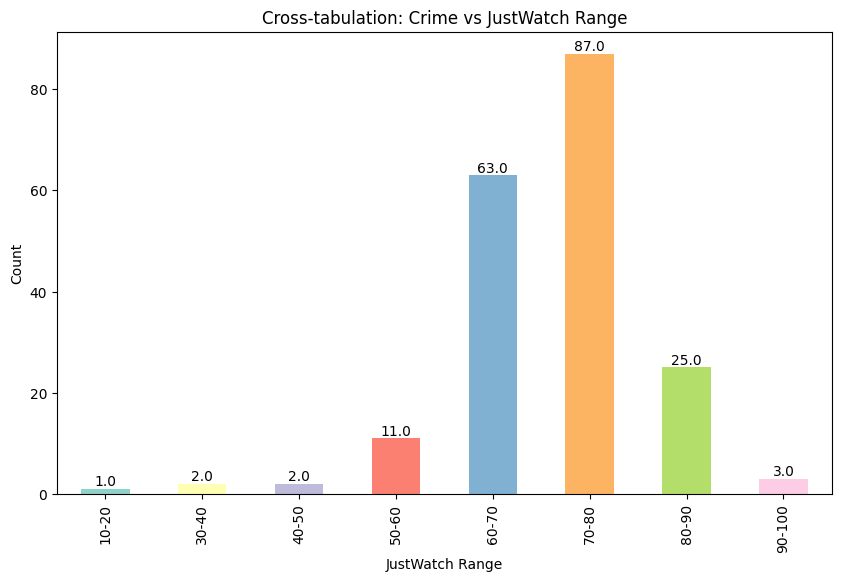

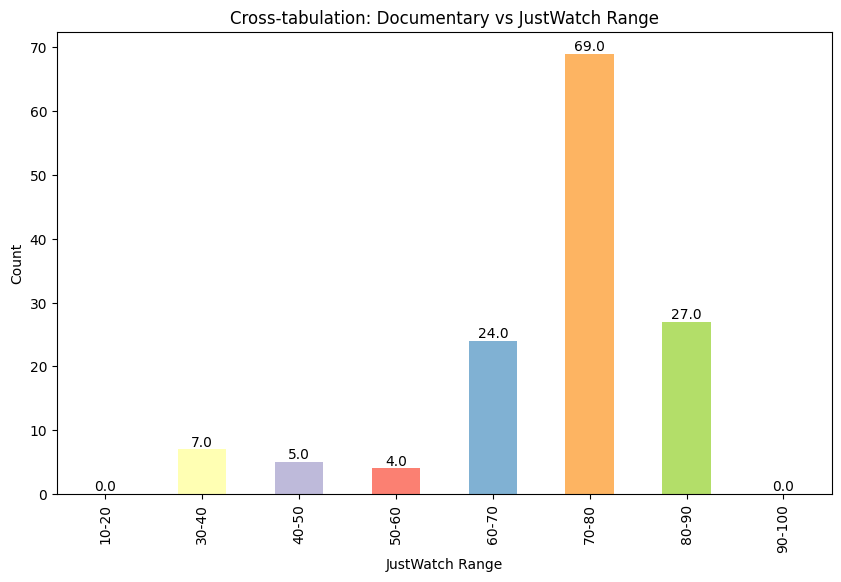

...

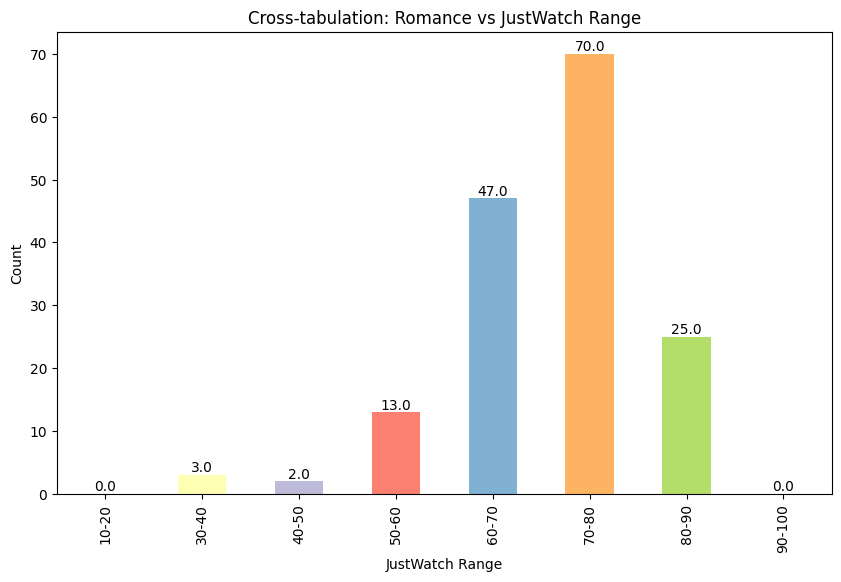

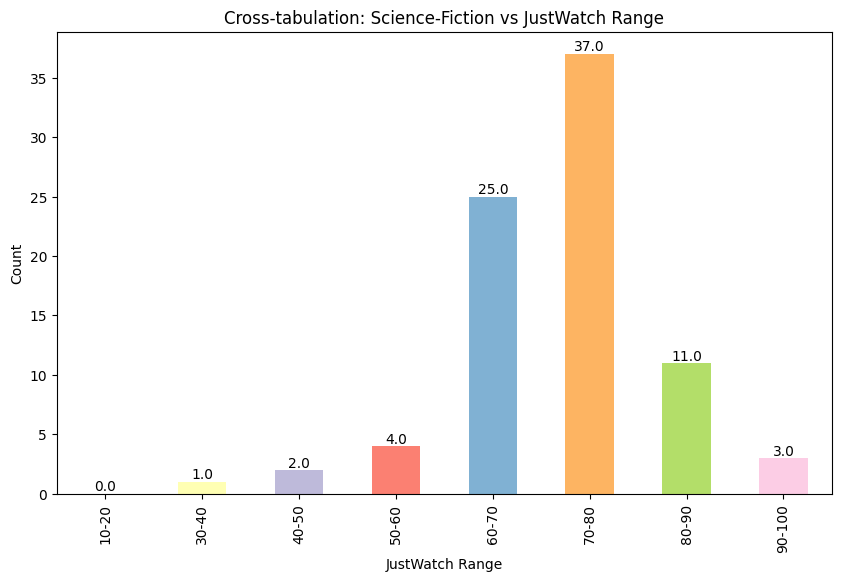

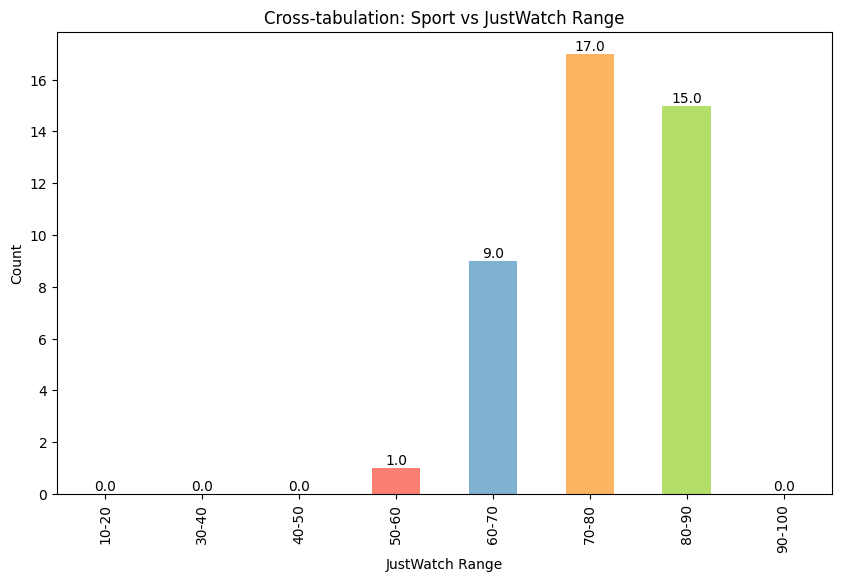

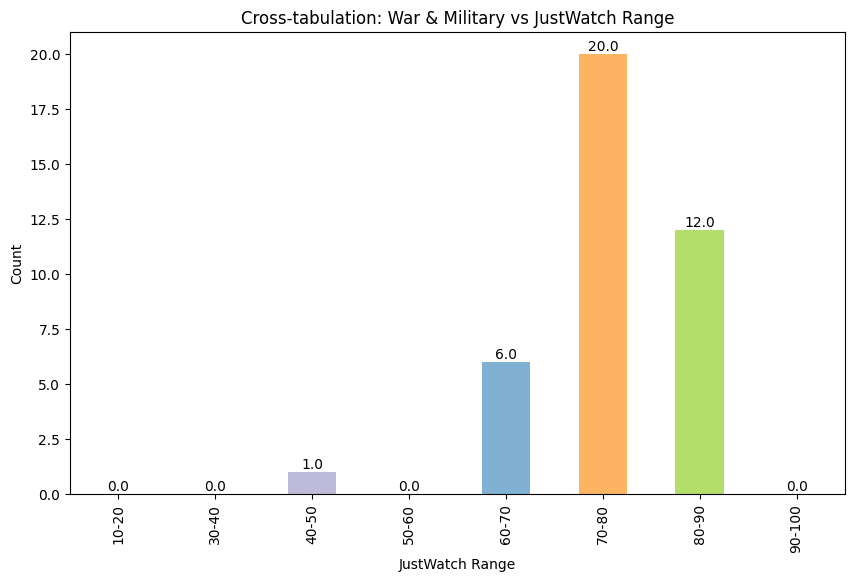

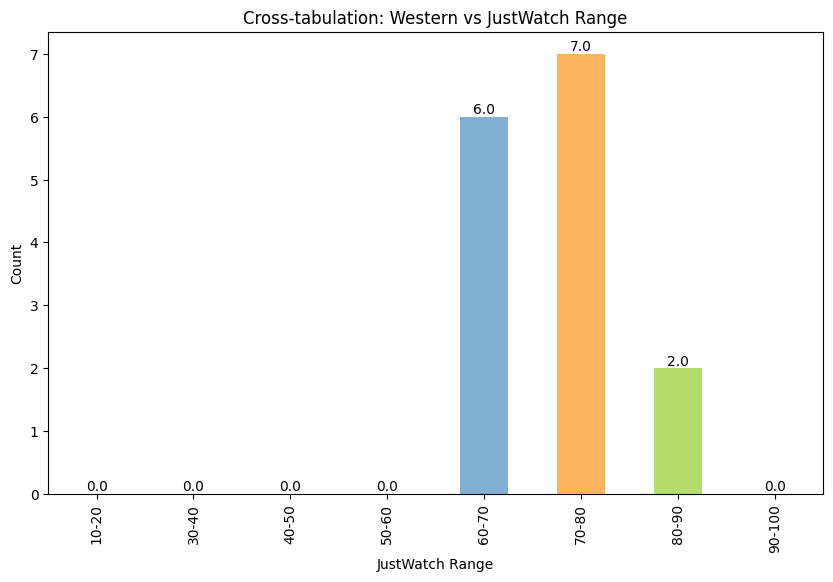

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Perform the crosstabulation
crosstab_data = pd.crosstab(movies['Genre'], movies['JustWatch_Range'])

# Define a color palette
color_palette = sns.color_palette('Set3')

# Iterate over each genre and create a separate plot
for genre in crosstab_data.index:
    # Create a new figure for each genre
    plt.figure(figsize=(10, 6))

    # Get the data for the current genre
    genre_data = crosstab_data.loc[genre]

    # Create a bar plot for the current genre with a different color
    ax = genre_data.plot(kind='bar', stacked=True, color=color_palette)

    # Set labels and title for the plot
    plt.xlabel('JustWatch Range')
    plt.ylabel('Count')
    plt.title(f'Cross-tabulation: {genre} vs JustWatch Range')

    # Add bar labels
    for p in ax.patches:
        ax.annotate(str(p.get_height()), (p.get_x() + p.get_width() / 2, p.get_height()), ha='center', va='bottom')


    # Show the plot
    plt.show()


#**The table provides a breakdown of genres across different User Ratings ranges.**

User Ratings Range: The User Ratings ranges are listed in columns, representing different intervals of user ratings.

Genre Breakdown: The genres are listed in rows, and the corresponding counts for each genre are displayed in the respective cells.

Genre Distribution: The table shows the distribution of genres across various User Ratings ranges. It provides insights into the user ratings and popularity of different genres.

Popular Genres: Drama is the most prevalent genre across most User Ratings ranges, indicating its popularity among users. Other popular genres include Comedy, Action & Adventure, Mystery & Thriller, and Animation.

User Ratings Trends: The counts within each genre for different User Ratings ranges can give an indication of the rating trends and user preferences for genres. For example, genres like Drama, Comedy, and Action & Adventure have higher counts in the higher User Ratings ranges, suggesting that they tend to receive more positive ratings from users.

Genre Evolution: The table also reveals changes in genre counts over different User Ratings ranges. For example, genres like Drama, Comedy, and Mystery & Thriller show a decrease in counts as the User Ratings range increases, indicating that these genres are more likely to receive higher ratings.

In [ ]:
pd.crosstab(movies['Genre'], movies['UserRatings_Range'])

UserRatings_Range,1-50,101-150,151-200,201-250,251-300,301-350,351-400,401-450,451-500,501-550,51-100,551-600,601-650,651-700,701-750,751-800,801-850,nan
Genre,,,,,,,,,,,,,,,,,,
Action & Adventure,121,17,17,17,7,3,2,1,2,0,34,1,2,3,1,1,1,15
Animation,32,5,7,1,1,0,0,0,0,0,9,0,0,0,0,1,0,4
Comedy,208,24,17,8,8,5,3,5,1,0,41,3,2,1,0,1,1,40
Crime,108,14,5,10,5,1,3,2,3,0,25,1,0,1,1,0,0,15
Documentary,102,1,0,0,0,0,0,0,0,0,4,0,0,0,0,0,0,29
Drama,277,37,23,17,4,4,5,6,3,1,60,3,3,6,1,1,0,47
Fantasy,53,8,13,4,2,0,0,2,0,0,20,2,2,3,0,1,1,7
History,33,3,3,2,0,1,0,2,0,0,5,0,1,0,0,0,0,1
Horror,62,9,3,4,4,1,2,0,0,0,11,1,0,2,0,0,0,13


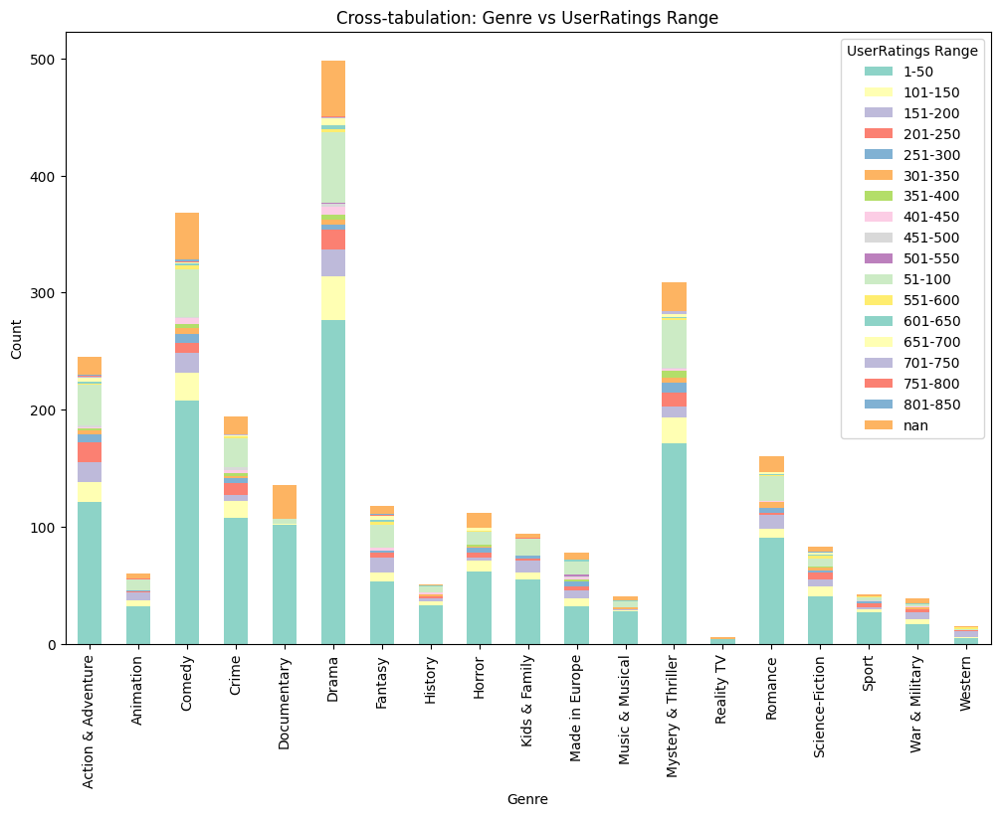

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Perform the crosstabulation
crosstab_data = pd.crosstab(movies['Genre'], movies['UserRatings_Range'])


# Define a color palette
color_palette = sns.color_palette('Set3')

# Create a stacked bar plot
ax = crosstab_data.plot(kind='bar', stacked=True, figsize=(12, 8), color=color_palette)

# Set labels and title
plt.xlabel('Genre')
plt.ylabel('Count')
plt.title('Cross-tabulation: Genre vs UserRatings Range')

# Add legend
plt.legend(title='UserRatings Range')

# Show the plot
plt.show()


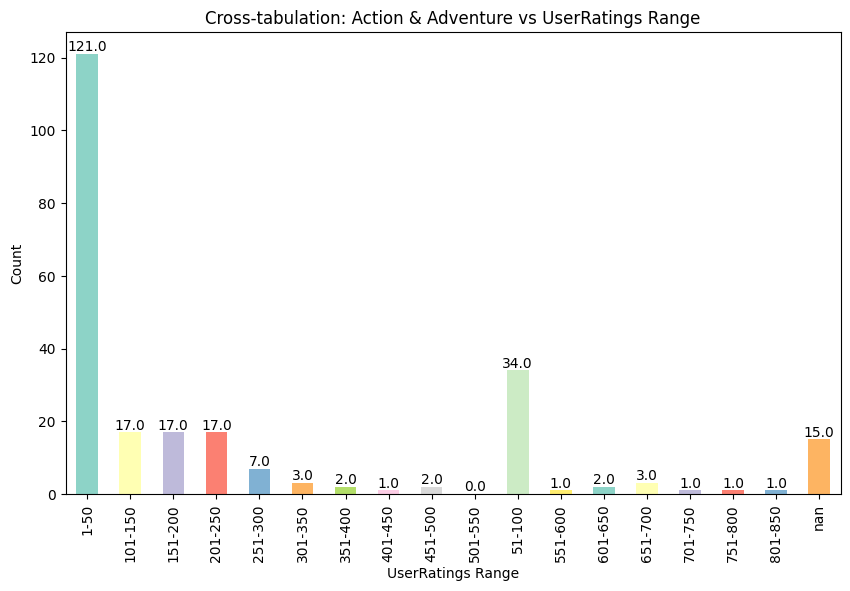

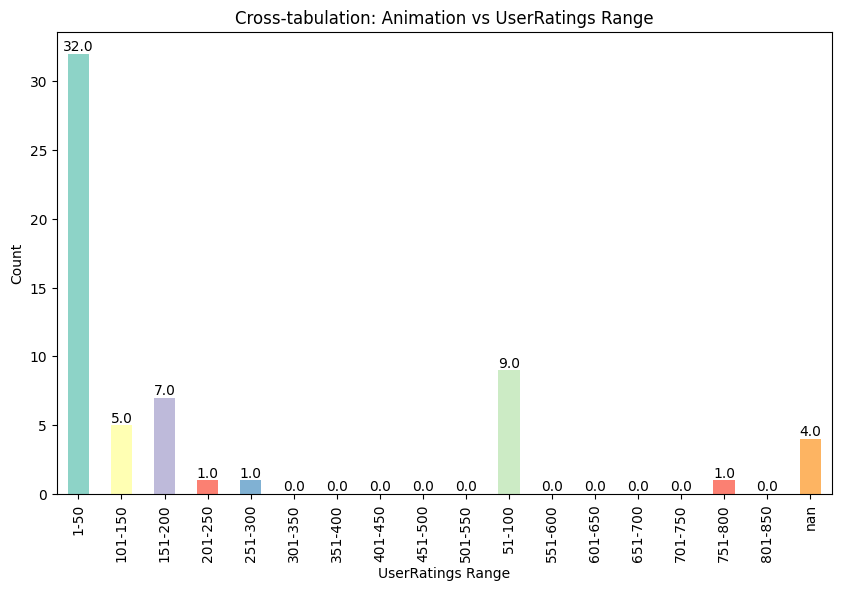

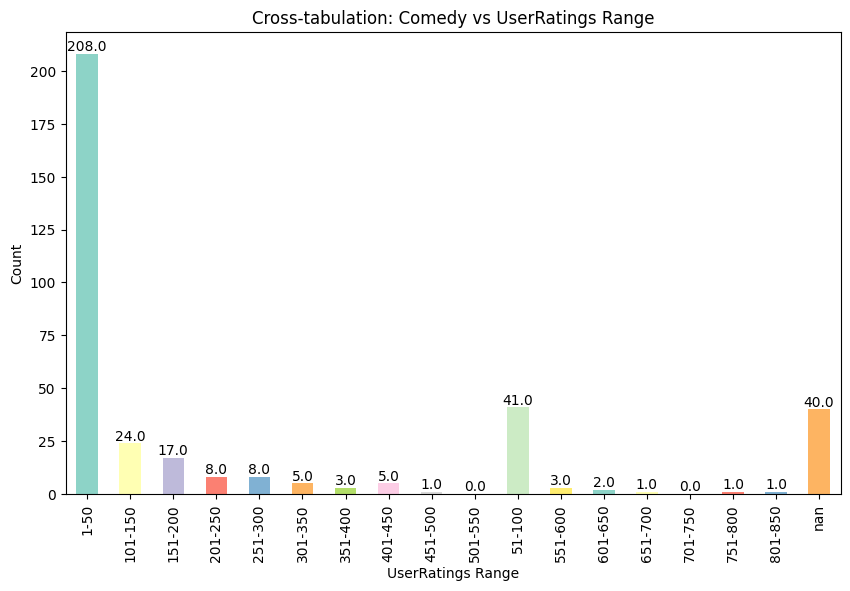

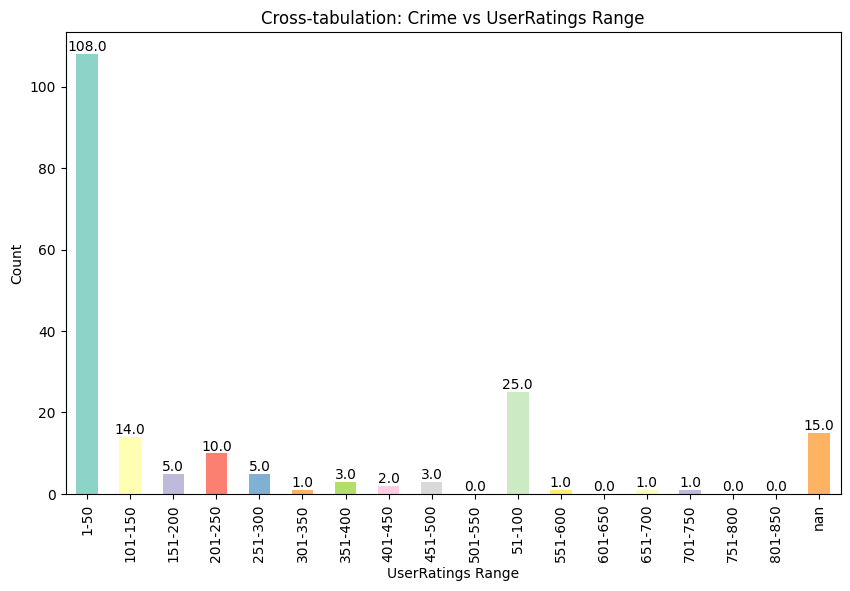

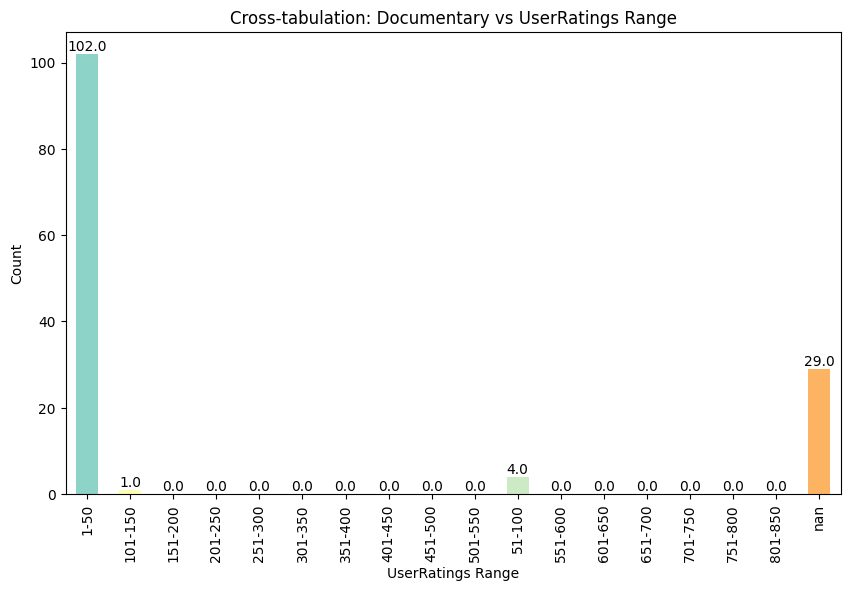

...

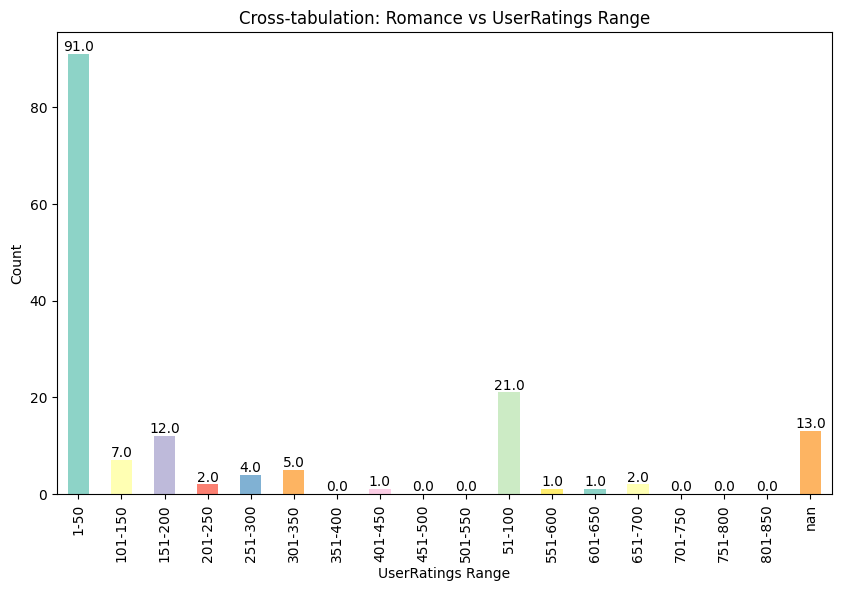

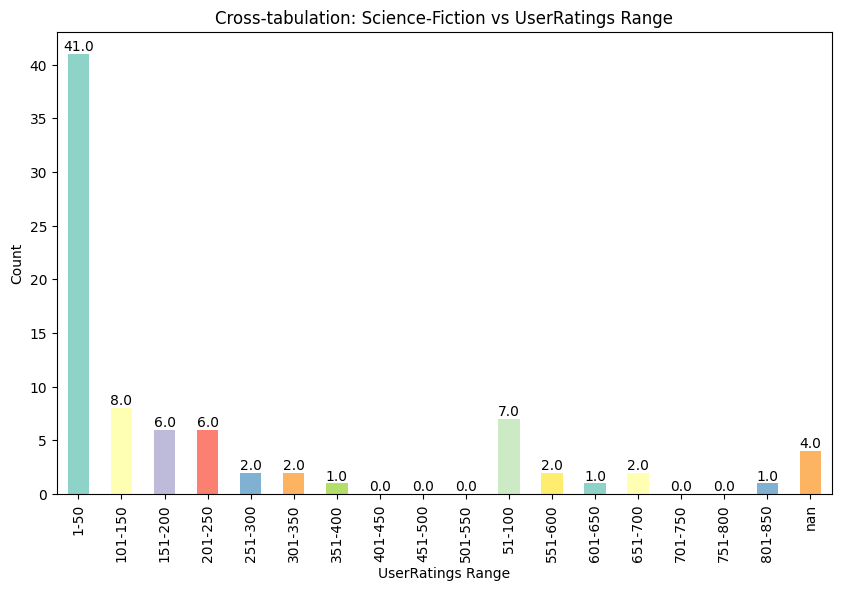

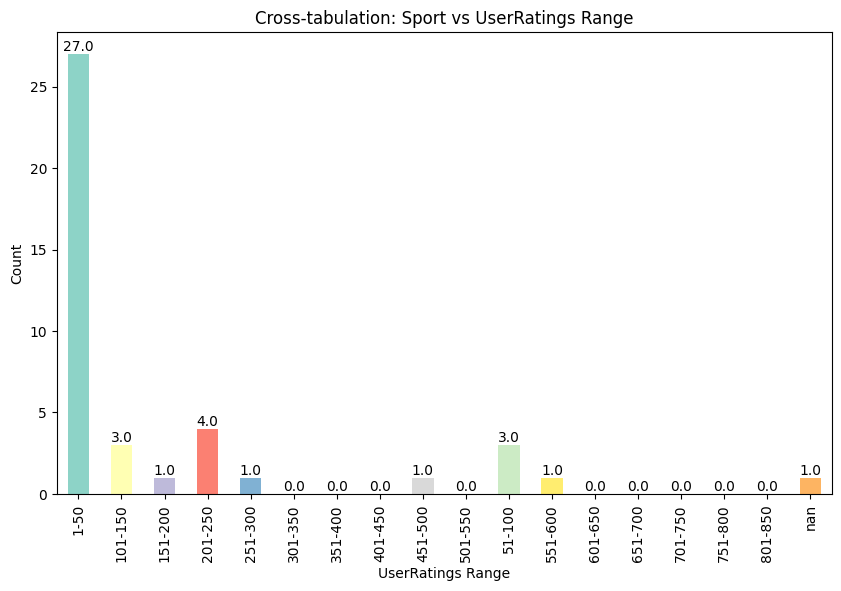

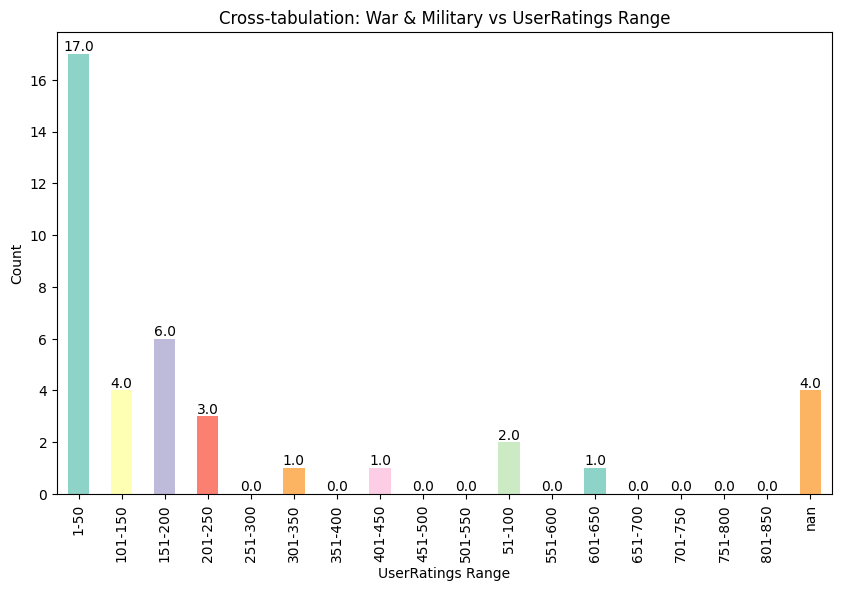

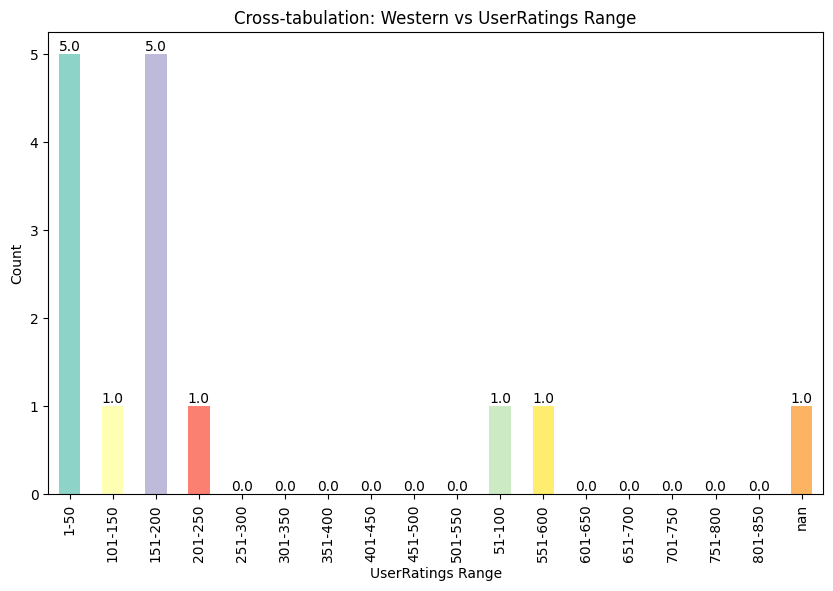

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Perform the crosstabulation
crosstab_data = pd.crosstab(movies['Genre'], movies['UserRatings_Range'])

# Define a color palette
color_palette = sns.color_palette('Set3')

# Iterate over each genre and create a separate plot
for genre in crosstab_data.index:
    # Create a new figure for each genre
    plt.figure(figsize=(10, 6))

    # Get the data for the current genre
    genre_data = crosstab_data.loc[genre]

    # Create a bar plot for the current genre with a different color
    ax = genre_data.plot(kind='bar', stacked=True, color=color_palette)

    # Set labels and title for the plot
    plt.xlabel('UserRatings Range')
    plt.ylabel('Count')
    plt.title(f'Cross-tabulation: {genre} vs UserRatings Range')

    # Add bar labels
    for p in ax.patches:
        ax.annotate(str(p.get_height()), (p.get_x() + p.get_width() / 2, p.get_height()), ha='center', va='bottom')


    # Show the plot
    plt.show()


# **Filtering movies DataFrame to include only movies with the specific genres**

In [ ]:
drama_movies = movies[movies['Genre'] == 'Drama']
comedy_movies = movies[movies['Genre'] == 'Comedy']
mystery_thriller_movies = movies[movies['Genre'] == 'Mystery & Thriller']
action_adventure_movies = movies[movies['Genre'] == 'Action & Adventure']
crime_movies = movies[movies['Genre'] == 'Crime']
romance_movies = movies[movies['Genre'] == 'Romance']
documentary_movies = movies[movies['Genre'] == 'Documentary']
fantasy_movies = movies[movies['Genre'] == 'Fantasy']
horror_movies = movies[movies['Genre'] == 'Horror']
kids_family_movies = movies[movies['Genre'] == 'Kids & Family']
science_fiction_movies = movies[movies['Genre'] == 'Science-Fiction']
europe_movies = movies[movies['Genre'] == 'Made in Europe']
animation_movies = movies[movies['Genre'] == 'Animation']
history_movies = movies[movies['Genre'] == 'History']
sport_movies = movies[movies['Genre'] == 'Sport']
musical_movies = movies[movies['Genre'] == 'Music & Musical']
war_military_movies = movies[movies['Genre'] == 'War & Military']
western_movies = movies[movies['Genre'] == 'Western']
reality_tv_movies = movies[movies['Genre'] == 'Reality TV']



# Drama Movies Analysis

In [ ]:
drama_movies.head()

,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
3033,¡Que Viva México!,Movie,Luis Estrada,2023,2021-2025,Drama,191,190-195,74.0,70-80,5.5,5.6-6.0,1.0,1-50
3036,11:11,Movie,Karim Abouzeid,2015,2016-2020,Drama,60,60-65,43.0,40-50,6.7,6.6-7.0,0.0,nan
3039,12 Strong,Movie,Nicolai Fuglsig,2018,2016-2020,Drama,130,130-135,71.0,70-80,6.5,6.6-7.0,86.0,51-100
3045,365 Days,Movie,Tomasz Mandes,2020,2021-2025,Drama,114,110-115,59.0,50-60,3.3,3.1-3.5,93.0,51-100
3048,365 Days: This Day,Movie,Tomasz Mandes,2022,2021-2025,Drama,111,110-115,51.0,50-60,2.6,2.6-3.0,22.0,1-50


# 498 Drama Movies

In [ ]:
drama_movies.shape

(498, 14)

In [ ]:
drama_movies.Release_Year_Range.value_counts()

2021-2025    255
2016-2020    135
2011-2015     41
2006-2010     17
2001-2005     15
1996-2000     10
1991-1995      7
nan            7
1986-1990      6
1975-1980      4
1981-1985      1
Name: Release_Year_Range, dtype: int64

In [ ]:
drama_movies.JustWatch_Range.value_counts()

70-80     221
60-70     134
80-90      87
50-60      31
40-50      10
30-40       8
90-100      7
Name: JustWatch_Range, dtype: int64

In [ ]:
drama_movies.IMDB_Range.value_counts()

6.6-7.0    108
7.1-7.5    105
5.6-6.0     73
6.1-6.5     73
5.1-5.5     34
7.6-8.0     33
4.6-5.0     24
8.1-8.5     16
nan         11
4.1-4.5      7
8.6-9.0      5
3.6-4.0      5
2.6-3.0      3
3.1-3.5      1
Name: IMDB_Range, dtype: int64

In [ ]:
drama_movies.UserRatings_Range.value_counts()

1-50       277
51-100      60
nan         47
101-150     37
151-200     23
201-250     17
401-450      6
651-700      6
351-400      5
251-300      4
301-350      4
551-600      3
601-650      3
451-500      3
751-800      1
701-750      1
501-550      1
Name: UserRatings_Range, dtype: int64

In [ ]:
drama_movies.Runtime_Range.value_counts()

95-100     67
100-105    53
105-110    51
115-120    48
110-115    46
90-95      40
120-125    36
85-90      31
125-130    27
130-135    18
135-140    17
145-150    13
80-85      11
160-165     7
150-155     6
155-160     6
140-145     4
30-35       2
10-15       2
165-170     2
170-175     2
185-190     2
70-75       2
75-80       1
65-70       1
60-65       1
205-210     1
190-195     1
195-200     0
215-220     0
200-205     0
210-215     0
235-240     0
230-235     0
225-230     0
220-225     0
240-245     0
0-5         0
180-185     0
175-180     0
5-10        0
55-60       0
50-55       0
45-50       0
40-45       0
35-40       0
25-30       0
20-25       0
15-20       0
245-250     0
Name: Runtime_Range, dtype: int64

# **Drama Movies Summary Statistics**
Release Year:

Count: There are 498 drama movies in the dataset.

Mean: The average release year for drama movies is approximately 2016.

Standard Deviation: The release years of drama movies vary by approximately 9.98 years.

Minimum: The earliest release year for a drama movie is 1960.

Maximum: The latest release year for a drama movie is 2023.
25th Percentile: 25% of the drama movies were released in or before the year 2015.

50th Percentile (Median): 50% of the drama movies were released in or before the year 2020.

75th Percentile: 75% of the drama movies were released in or before the year 2022.

****
Runtime in Minutes:

Mean: The average runtime of drama movies is approximately 111 minutes.

Standard Deviation: The runtime of drama movies varies by approximately 21.8 minutes.

Minimum: The shortest runtime for a drama movie is 10 minutes.

Maximum: The longest runtime for a drama movie is 209 minutes.

25th Percentile: 25% of the drama movies have a runtime of 97 minutes or less.

50th Percentile (Median): 50% of the drama movies have a runtime of 108 minutes or less.

75th Percentile: 75% of the drama movies have a runtime of 122.75 minutes or less.
****

Just Watch Rating in Percentage:

Mean: The average Just Watch rating for drama movies is approximately 71.5%.

Standard Deviation: The Just Watch ratings for drama movies vary by approximately 9.99%.

Minimum: The lowest Just Watch rating for a drama movie is 31%.

Maximum: The highest Just Watch rating for a drama movie is 94%.

25th Percentile: 25% of the drama movies have a Just Watch rating of 66% or lower.

50th Percentile (Median): 50% of the drama movies have a Just Watch rating of 73% or lower.

75th Percentile: 75% of the drama movies have a Just Watch rating of 78% or lower.

****
IMDb Rating:

Mean: The average IMDb rating for drama movies is approximately 6.28.

Standard Deviation: The IMDb ratings for drama movies vary by approximately 1.36.

Minimum: The lowest IMDb rating for a drama movie is 0.

Maximum: The highest IMDb rating for a drama movie is 8.8.
25th Percentile: 25% of the drama movies have an IMDb rating of 5.7 or lower.

50th Percentile (Median): 50% of the drama movies have an IMDb rating of 6.5 or lower.

75th Percentile: 75% of the drama movies have an IMDb rating of 7.1 or lower.

****

User Ratings Value (K):

Mean: The average user ratings value for drama movies is approximately 83.3 thousand.

Standard Deviation: The user ratings values for drama movies vary by approximately 152.08 thousand.

Minimum: The lowest user ratings value for a drama movie is 0 thousand.

Maximum: The highest user ratings value for a drama movie is 1000 thousand.
25th Percent

50th Percentile (Median): 50% of the drama movies have an User Ratings Value of 22.0 or lower.

75th Percentile: 75% of the drama movies have an User Ratings of 91.5 or lower.


In [ ]:
drama_movies.describe()

,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,498.000000,498.000000,498.000000,498.00000,498.000000
mean,2016.140562,110.977912,71.502008,6.27751,83.267068
std,9.976245,21.808419,9.989582,1.36350,152.081980
min,1960.000000,10.000000,31.000000,0.00000,0.000000
25%,2015.000000,97.000000,66.000000,5.70000,4.250000
50%,2020.000000,108.000000,73.000000,6.50000,22.000000
75%,2022.000000,122.750000,78.000000,7.10000,91.500000
max,2023.000000,209.000000,94.000000,8.80000,1000.000000


# **Drama Movies Correlation**

Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately -0.095. This indicates a weak negative correlation, suggesting a slight tendency for drama movies released in later years to have slightly shorter runtimes, but the correlation is not strong.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.227. This indicates a weak negative correlation, suggesting a slight tendency for drama movies released in later years to have slightly lower Just Watch rating percentages, but the correlation is not strong.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.240. This indicates a weak negative correlation, suggesting a slight tendency for drama movies released in later years to have slightly lower IMDB ratings, but the correlation is not strong.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.415. This suggests a moderate negative correlation, indicating a tendency for drama movies released in later years to have lower user ratings values (in thousands), but the correlation is not very strong.

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.436. This suggests a moderate positive correlation, indicating a tendency for longer runtime drama movies to have higher Just Watch rating percentages, but the correlation is not very strong.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.422. This indicates a weak positive correlation, suggesting a slight tendency for drama movies with longer runtimes to have slightly higher IMDB ratings, but the correlation is not strong.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.304. This suggests a weak positive correlation, indicating a slight tendency for drama movies with longer runtimes to have slightly higher user ratings values (in thousands), but the correlation is not strong.

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.908. This indicates a strong positive correlation, suggesting a strong tendency for drama movies with higher Just Watch rating percentages to also have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.444. This suggests a moderate positive correlation, indicating a tendency for drama movies with higher Just Watch rating percentages to have higher user ratings values (in thousands), but the correlation is not very strong.

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.390. This suggests a weak positive correlation, indicating a slight tendency for drama movies with higher IMDB ratings to have slightly higher user ratings values (in thousands), but the correlation is not strong.


In [ ]:
drama_movies.corr()

<ipython-input-1292-959fa26cd433>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  drama_movies.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,-0.095361,-0.226854,-0.240282,-0.414755
Runtime_In_Minutes,-0.095361,1.000000,0.436283,0.421888,0.303986
Just_Watch_Rating_In_Percentage,-0.226854,0.436283,1.000000,0.907717,0.444316
IMDB_Rating,-0.240282,0.421888,0.907717,1.000000,0.389738
User_Ratings_Value_K,-0.414755,0.303986,0.444316,0.389738,1.000000


<ipython-input-1293-ea648ea0f026>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(drama_movies.corr(),cmap='coolwarm',annot=True)


<Axes: >

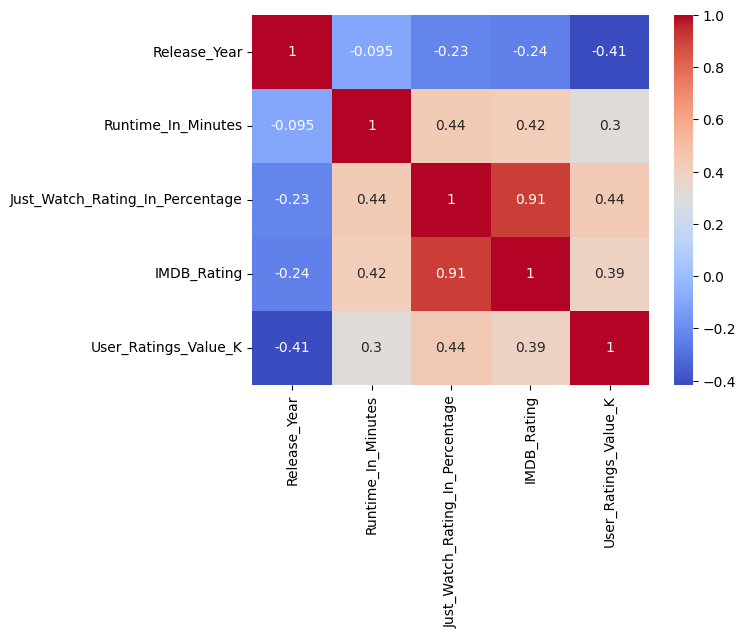

In [ ]:
sns.heatmap(drama_movies.corr(),cmap='coolwarm',annot=True)


In [ ]:
drama_correlation_matrix = drama_movies.corr()
drama_correlation_table = drama_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
drama_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']



# Define the correlation threshold
threshold = 0.5

# Add a conditional column based on the correlation threshold
drama_correlation_table['Correlation Type'] = drama_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')

# Add a conditional column based on the correlation strength
drama_correlation_table['Correlation Strength'] = drama_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')

drama_correlation_table

<ipython-input-1294-3718d7848b04>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  drama_correlation_matrix = drama_movies.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.907717,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.907717,Positive,Strong
7,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.444316,Positive,Weak
8,Just_Watch_Rating_In_Percentage,User_Ratings_Value_K,0.444316,Positive,Weak
9,Just_Watch_Rating_In_Percentage,Runtime_In_Minutes,0.436283,Positive,Weak


# Comedy Movies Analysis

In [ ]:
comedy_movies.head()

,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
3034,¡Que Viva México!,Movie,Luis Estrada,2023,2021-2025,Comedy,191,190-195,74.0,70-80,5.5,5.6-6.0,1.0,1-50
3050,4 latas,Movie,Gerardo Olivares,2019,2016-2020,Comedy,104,100-105,64.0,60-70,5.9,5.6-6.0,3.0,1-50
3076,A Castle for Christmas,Movie,Mary Lambert,2021,2021-2025,Comedy,98,95-100,64.0,60-70,5.5,5.6-6.0,14.0,1-50
3094,A League of Their Own,Movie,Penny Marshall,1992,1991-1995,Comedy,128,125-130,79.0,70-80,7.3,7.1-7.5,115.0,101-150
3098,A Man Called Otto,Movie,Marc Forster,2022,2021-2025,Comedy,126,125-130,86.0,80-90,7.5,7.6-8.0,90.0,51-100


# 368 Comedy Movies

In [ ]:
comedy_movies.shape

(368, 14)

In [ ]:
comedy_movies.Release_Year_Range.value_counts()

2021-2025    174
2016-2020    110
2011-2015     36
2001-2005     12
2006-2010     11
1996-2000      8
1991-1995      6
1975-1980      5
1986-1990      4
nan            2
Name: Release_Year_Range, dtype: int64

In [ ]:
comedy_movies.JustWatch_Range.value_counts()

70-80     160
60-70     125
80-90      44
50-60      21
40-50       8
30-40       7
90-100      3
Name: JustWatch_Range, dtype: int64

In [ ]:
comedy_movies.IMDB_Range.value_counts()

6.6-7.0    68
5.6-6.0    67
7.1-7.5    66
6.1-6.5    63
5.1-5.5    30
7.6-8.0    24
4.6-5.0    17
8.1-8.5    11
nan         7
4.1-4.5     7
3.6-4.0     4
3.1-3.5     2
8.6-9.0     2
Name: IMDB_Range, dtype: int64

In [ ]:
comedy_movies.UserRatings_Range.value_counts()

1-50       208
51-100      41
nan         40
101-150     24
151-200     17
201-250      8
251-300      8
401-450      5
301-350      5
351-400      3
551-600      3
601-650      2
651-700      1
751-800      1
801-850      1
451-500      1
Name: UserRatings_Range, dtype: int64

In [ ]:
comedy_movies.Runtime_Range.value_counts()

95-100     65
100-105    41
110-115    33
90-95      32
105-110    30
85-90      29
115-120    21
60-65      18
80-85      14
70-75      14
125-130    13
120-125    10
55-60       8
65-70       7
135-140     6
160-165     4
75-80       3
145-150     3
140-145     3
130-135     3
150-155     2
50-55       2
155-160     2
45-50       1
25-30       1
190-195     1
30-35       1
40-45       1
215-220     0
205-210     0
200-205     0
210-215     0
220-225     0
240-245     0
235-240     0
230-235     0
225-230     0
195-200     0
0-5         0
185-190     0
180-185     0
175-180     0
170-175     0
165-170     0
5-10        0
35-40       0
20-25       0
15-20       0
10-15       0
245-250     0
Name: Runtime_Range, dtype: int64

# **Comedy Movies Summary Statistics**

Release Year:

Count: There are 368 comedy movies in the dataset.

Mean: The average release year for comedy movies is approximately 2016.2.

Standard Deviation: The release years of comedy movies vary by approximately 9.49 years.

Minimum: The earliest release year for a comedy movie is 1954.

Maximum: The latest release year for a comedy movie is 2023.
25th Percentile: 25% of the comedy movies were released in or before the year 2015.

50th Percentile (Median): 50% of the comedy movies were released in or before the year 2019.

75th Percentile: 75% of the comedy movies were released in or before the year 2022.


Runtime in Minutes:

Mean: The average runtime of comedy movies is approximately 98.9 minutes.

Standard Deviation: The runtime of comedy movies varies by approximately 22.1 minutes.

Minimum: The shortest runtime for a comedy movie is 29 minutes.

Maximum: The longest runtime for a comedy movie is 191 minutes.

25th Percentile: 25% of the comedy movies have a runtime of 89 minutes or less.

50th Percentile (Median): 50% of the comedy movies have a runtime of 98 minutes or less.

75th Percentile: 75% of the comedy movies have a runtime of 110 minutes or less.


Just Watch Rating in Percentage:

Mean: The average Just Watch rating for comedy movies is approximately 70.1%.

Standard Deviation: The Just Watch ratings for comedy movies vary by approximately 9.9%.

Minimum: The lowest Just Watch rating for a comedy movie is 31%.

Maximum: The highest Just Watch rating for a comedy movie is 94%.

25th Percentile: 25% of the comedy movies have a Just Watch rating of 65% or lower.

50th Percentile (Median): 50% of the comedy movies have a Just Watch rating of 71% or lower.

75th Percentile: 75% of the comedy movies have a Just Watch rating of 77% or lower.


IMDb Rating:

Mean: The average IMDb rating for comedy movies is approximately 6.18.

Standard Deviation: The IMDb ratings for comedy movies vary by approximately 1.29.

Minimum: The lowest IMDb rating for a comedy movie is 0.

Maximum: The highest IMDb rating for a comedy movie is 8.8.
25th Percentile: 25% of the comedy movies have an IMDb rating of 5.6 or lower.

50th Percentile (Median): 50% of the comedy movies have an IMDb rating of 6.4 or lower.

75th Percentile: 75% of the comedy movies have an IMDb rating of 7.0 or lower.


User Ratings Value (K):
Mean: The average user ratings value for comedy movies is approximately 69.9 thousand.

Standard Deviation: The user ratings values for comedy movies vary by approximately 125.3 thousand.

Minimum: The lowest user ratings value for a comedy movie is 0 thousand.

Maximum: The highest user ratings value for a comedy movie is 808 thousand.

25th Percentile: 25% of the comedy movies have a user ratings value of 3.0 thousand or lower.

50th Percentile (Median): 50% of the comedy movies have a user ratings value of 15.5 thousand or lower.

75th Percentile: 75% of the comedy movies have a user ratings value of 83.0 thousand or lower.

In [ ]:
comedy_movies.describe()

,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,368.000000,368.000000,368.000000,368.000000,368.000000
mean,2016.222826,98.869565,70.089674,6.181522,69.945652
std,9.491963,22.105872,9.900326,1.293638,125.345418
min,1954.000000,29.000000,31.000000,0.000000,0.000000
25%,2015.000000,89.000000,65.000000,5.600000,3.000000
50%,2019.000000,98.000000,71.000000,6.400000,15.500000
75%,2022.000000,110.000000,77.000000,7.000000,83.000000
max,2023.000000,191.000000,94.000000,8.800000,808.000000


#**Comedy Movies Correlation**

Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately -0.119. This indicates a weak negative correlation, suggesting a slight tendency for comedy movies released in later years to have slightly shorter runtimes, but the correlation is not strong.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.258. This indicates a weak negative correlation, suggesting a slight tendency for comedy movies released in later years to have slightly lower Just Watch rating percentages, but the correlation is not strong.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.337. This indicates a weak negative correlation, suggesting a slight tendency for comedy movies released in later years to have slightly lower IMDB ratings, but the correlation is not strong.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.467. This suggests a moderate negative correlation, indicating a tendency for comedy movies released in later years to have lower user ratings values (in thousands), but the correlation is not very strong.

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.132. This indicates a weak positive correlation, suggesting a slight tendency for longer runtime comedy movies to have slightly higher Just Watch rating percentages, but the correlation is not strong.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.084. This indicates a weak positive correlation, suggesting a slight tendency for comedy movies with longer runtimes to have slightly higher IMDB ratings, but the correlation is not strong.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.263. This suggests a moderate positive correlation, indicating a tendency for comedy movies with longer runtimes to have higher user ratings values (in thousands), but the correlation is not very strong.

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.893. This indicates a strong positive correlation, suggesting a strong tendency for comedy movies with higher Just Watch rating percentages to also have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.458. This suggests a moderate positive correlation, indicating a tendency for comedy movies with higher Just Watch rating percentages to have higher user ratings values (in thousands), but the correlation is not very strong.

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.358. This suggests a moderate positive correlation, indicating a tendency for comedy movies with higher IMDB ratings to have higher user ratings values (in thousands), but the correlation is not very strong.

In [ ]:
comedy_movies.corr()

<ipython-input-1303-287a84812b91>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  comedy_movies.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,-0.084594,-0.198020,-0.224386,-0.422269
Runtime_In_Minutes,-0.084594,1.000000,0.145260,0.076618,0.238943
Just_Watch_Rating_In_Percentage,-0.198020,0.145260,1.000000,0.893344,0.361904
IMDB_Rating,-0.224386,0.076618,0.893344,1.000000,0.325445
User_Ratings_Value_K,-0.422269,0.238943,0.361904,0.325445,1.000000


<ipython-input-1304-e498d9512e60>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(comedy_movies.corr(),cmap='coolwarm',annot=True)


<Axes: >

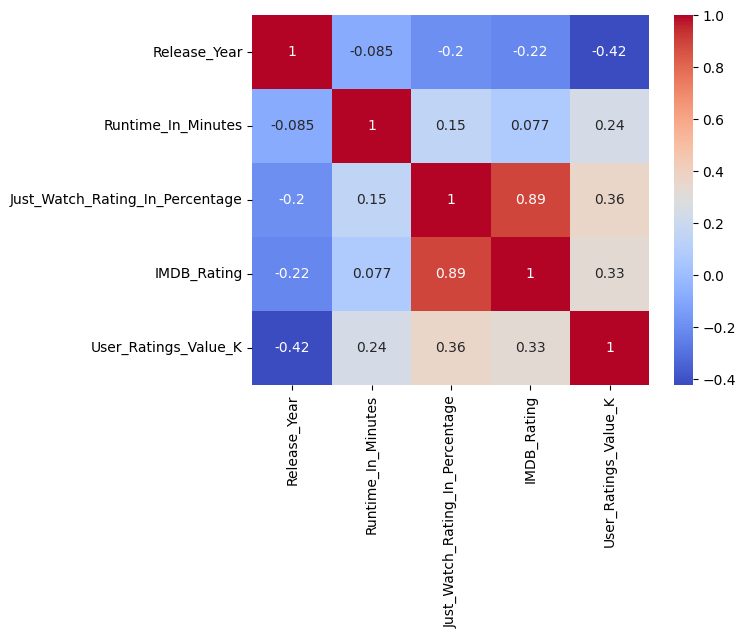

In [ ]:

sns.heatmap(comedy_movies.corr(),cmap='coolwarm',annot=True)

In [ ]:
comedy_correlation_matrix = comedy_movies.corr()
comedy_correlation_table = comedy_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
comedy_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
comedy_correlation_table['Correlation Type'] = comedy_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
comedy_correlation_table['Correlation Strength'] = comedy_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


comedy_correlation_table


<ipython-input-1305-0c5716f308f2>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  comedy_correlation_matrix = comedy_movies.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.893344,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.893344,Positive,Strong
7,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.361904,Positive,Weak
8,Just_Watch_Rating_In_Percentage,User_Ratings_Value_K,0.361904,Positive,Weak
9,IMDB_Rating,User_Ratings_Value_K,0.325445,Positive,Weak


# Myster and Thriller Movies Analysis

In [ ]:
mystery_thriller_movies.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
3038,11:11,Movie,Karim Abouzeid,2015,2016-2020,Mystery & Thriller,60,60-65,43.0,40-50,6.7,6.6-7.0,0.0,nan
3055,47 Meters Down: Uncaged,Movie,Johannes Roberts,2019,2016-2020,Mystery & Thriller,89,85-90,61.0,60-70,5.0,5.1-5.5,28.0,1-50
3073,A Call to Spy,Movie,Lydia Dean Pilcher,2019,2016-2020,Mystery & Thriller,123,120-125,74.0,70-80,6.6,6.6-7.0,8.0,1-50
3081,A Cop Movie,Movie,Alonso Ruizpalacios,2021,2021-2025,Mystery & Thriller,107,105-110,78.0,70-80,7.0,7.1-7.5,2.0,1-50
3084,A Fall from Grace,Movie,Tyler Perry,2020,2021-2025,Mystery & Thriller,120,120-125,71.0,70-80,5.9,5.6-6.0,16.0,1-50


# 309 Mystery and Thriller Movies

In [ ]:
mystery_thriller_movies.shape


(309, 14)

In [ ]:
mystery_thriller_movies.Release_Year_Range.value_counts()


2021-2025    165
2016-2020     78
2011-2015     25
2001-2005     14
1996-2000      9
2006-2010      7
nan            5
1991-1995      4
1975-1980      1
1986-1990      1
Name: Release_Year_Range, dtype: int64

In [ ]:
mystery_thriller_movies.JustWatch_Range.value_counts()


70-80     117
60-70     114
80-90      32
50-60      27
40-50       6
30-40       6
90-100      6
10-20       1
Name: JustWatch_Range, dtype: int64

In [ ]:
mystery_thriller_movies.IMDB_Range.value_counts()


5.6-6.0    61
6.1-6.5    58
6.6-7.0    51
7.1-7.5    39
5.1-5.5    33
4.6-5.0    25
7.6-8.0    15
8.1-8.5     7
4.1-4.5     6
8.6-9.0     4
nan         3
3.1-3.5     2
2.6-3.0     2
3.6-4.0     2
2.0-2.5     1
Name: IMDB_Range, dtype: int64

In [ ]:
mystery_thriller_movies.UserRatings_Range.value_counts()


1-50       171
51-100      41
nan         25
101-150     22
201-250     12
151-200     10
251-300      8
351-400      6
301-350      4
651-700      3
401-450      2
701-750      2
451-500      1
601-650      1
551-600      1
Name: UserRatings_Range, dtype: int64

In [ ]:
mystery_thriller_movies.Runtime_Range.value_counts()


95-100     41
100-105    33
105-110    32
90-95      31
115-120    31
110-115    29
85-90      22
125-130    18
120-125    16
145-150    13
130-135    11
80-85       8
135-140     7
150-155     4
155-160     3
170-175     2
140-145     2
165-170     1
160-165     1
60-65       1
70-75       1
185-190     1
205-210     1
180-185     0
210-215     0
240-245     0
235-240     0
225-230     0
220-225     0
215-220     0
175-180     0
190-195     0
195-200     0
200-205     0
230-235     0
0-5         0
5-10        0
75-80       0
65-70       0
55-60       0
50-55       0
45-50       0
40-45       0
35-40       0
30-35       0
25-30       0
20-25       0
15-20       0
10-15       0
245-250     0
Name: Runtime_Range, dtype: int64

# **Mystery and Thriller Summary Statistics**

Release Year:

Count: There are 309 mystery and thriller movies in the dataset.

Mean: The average release year for mystery and thriller movies is approximately 2016.4.

Standard Deviation: The release years of mystery and thriller movies vary by approximately 9.6 years.

Minimum: The earliest release year for a mystery and thriller movie is 1960.

Maximum: The latest release year for a mystery and thriller movie is 2023.

25th Percentile: 25% of the mystery and thriller movies were released in or before the year 2016.

50th Percentile (Median): 50% of the mystery and thriller movies were released in or before the year 2020.

75th Percentile: 75% of the mystery and thriller movies were released in or before the year 2022.
****

Runtime in Minutes:

Mean: The average runtime of mystery and thriller movies is approximately 110.5 minutes.

Standard Deviation: The runtime of mystery and thriller movies varies by approximately 20 minutes.

Minimum: The shortest runtime for a mystery and thriller movie is 60 minutes.

Maximum: The longest runtime for a mystery and thriller movie is 209 minutes.

25th Percentile: 25% of the mystery and thriller movies have a runtime of 96 minutes or less.

50th Percentile (Median): 50% of the mystery and thriller movies have a runtime of 107 minutes or less.

75th Percentile: 75% of the mystery and thriller movies have a runtime of 120 minutes or less.
****

Just Watch Rating in Percentage:

Mean: The average Just Watch rating for mystery and thriller movies is approximately 68.9%.

Standard Deviation: The Just Watch ratings for mystery and thriller movies vary by approximately 10.2%.

Minimum: The lowest Just Watch rating for a mystery and thriller movie is 17%.

Maximum: The highest Just Watch rating for a mystery and thriller movie is 92%.

25th Percentile: 25% of the mystery and thriller movies have a Just Watch rating of 64% or lower.

50th Percentile (Median): 50% of the mystery and thriller movies have a Just Watch rating of 70% or lower.

75th Percentile: 75% of the mystery and thriller movies have a Just Watch rating of 75% or lower.

****
IMDb Rating:

Mean: The average IMDb rating for mystery and thriller movies is approximately 6.07.

Standard Deviation: The IMDb ratings for mystery and thriller movies vary by approximately 1.19.

Minimum: The lowest IMDb rating for a mystery and thriller movie is 0.

Maximum: The highest IMDb rating for a mystery and thriller movie is 8.6.

25th Percentile: 25% of the mystery and thriller movies have an IMDb rating of 5.5 or lower.

50th Percentile (Median): 50% of the mystery and thriller movies have an IMDb rating of 6.2 or lower.

75th Percentile: 75% of the mystery and thriller movies have an IMDb rating of 6.8 or lower.

****
User Ratings Value (K):

Mean: The average user ratings value for mystery and thriller movies is approximately 90.7 thousand.

Standard Deviation: The user ratings values for mystery and thriller movies vary by approximately 166.6 thousand.

Minimum: The lowest user ratings value for a mystery and thriller movie is 0 thousand.

Maximum: The highest user ratings value for a mystery and thriller movie is 1000 thousand.

25th Percentile: 25% of the mystery and thriller movies have a user ratings value of 5 thousand or lower.

50th Percentile (Median): 50% of the mystery and thriller movies have a user ratings value of 22 thousand or lower.

75th Percentile: 75% of the mystery and thriller movies have a user ratings value of 97 thousand or lower.

In [ ]:
mystery_thriller_movies.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,309.000000,309.000000,309.000000,309.000000,309.000000
mean,2016.365696,110.488673,68.922330,6.068285,90.669903
std,9.598038,20.032539,10.169686,1.192821,166.581756
min,1960.000000,60.000000,17.000000,0.000000,0.000000
25%,2016.000000,96.000000,64.000000,5.500000,5.000000
50%,2020.000000,107.000000,70.000000,6.200000,22.000000
75%,2022.000000,120.000000,75.000000,6.800000,97.000000
max,2023.000000,209.000000,92.000000,8.600000,1000.000000


# **Mystery and Thriller Movies Correlation**

Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately -0.206. This indicates a weak negative correlation, suggesting a slight tendency for mystery and thriller movies released in later years to have slightly shorter runtimes, but the correlation is not strong.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.355. This indicates a moderate negative correlation, suggesting a tendency for mystery and thriller movies released in later years to have lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.398. This indicates a moderate negative correlation, suggesting a tendency for mystery and thriller movies released in later years to have lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.370. This suggests a moderate negative correlation, indicating a tendency for mystery and thriller movies released in later years to have lower user ratings values (in thousands).

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.156. This indicates a weak positive correlation, suggesting a slight tendency for mystery and thriller movies with longer runtimes to have higher Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.137. This indicates a weak positive correlation, suggesting a slight tendency for mystery and thriller movies with longer runtimes to have higher IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.138. This indicates a weak positive correlation, suggesting a slight tendency for mystery and thriller movies with longer runtimes to have slightly higher user ratings values (in thousands).

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.607. This indicates a moderate positive correlation, suggesting a tendency for mystery and thriller movies with higher Just Watch rating percentages to also have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.377. This suggests a moderate positive correlation, indicating a tendency for mystery and thriller movies with higher Just Watch rating percentages to have higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.409. This suggests a moderate positive correlation, indicating a tendency for mystery and thriller movies with higher IMDB ratings to have higher user ratings values (in thousands).

In [ ]:
mystery_thriller_movies.corr()


<ipython-input-1314-9a83d855fe18>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  mystery_thriller_movies.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,-0.148450,-0.250410,-0.278519,-0.439861
Runtime_In_Minutes,-0.148450,1.000000,0.462088,0.465559,0.335402
Just_Watch_Rating_In_Percentage,-0.250410,0.462088,1.000000,0.918316,0.506756
IMDB_Rating,-0.278519,0.465559,0.918316,1.000000,0.484183
User_Ratings_Value_K,-0.439861,0.335402,0.506756,0.484183,1.000000


<ipython-input-1315-9cc797e93acd>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(mystery_thriller_movies.corr(),cmap='coolwarm',annot=True)


<Axes: >

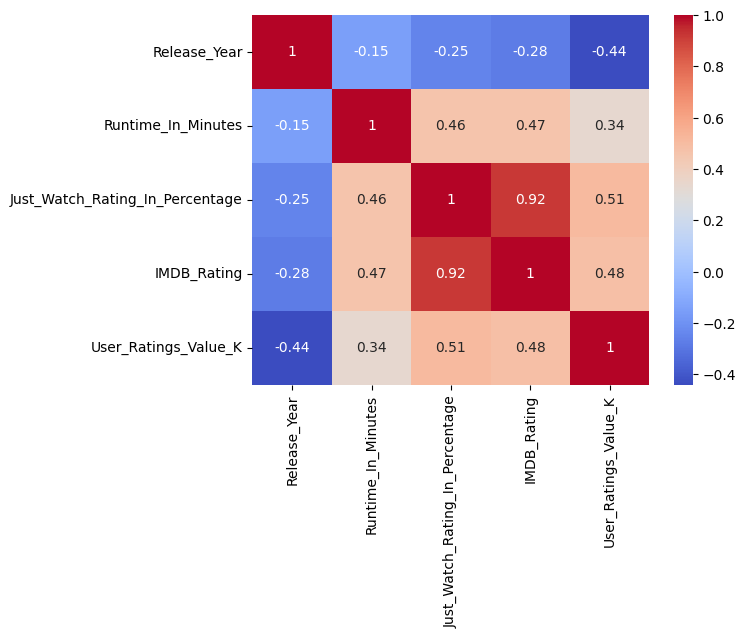

In [ ]:

sns.heatmap(mystery_thriller_movies.corr(),cmap='coolwarm',annot=True)

In [ ]:

mystery_thriller_correlation_matrix = mystery_thriller_movies.corr()
mystery_thriller_correlation_table = mystery_thriller_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
mystery_thriller_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
mystery_thriller_correlation_table['Correlation Type'] = mystery_thriller_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
mystery_thriller_correlation_table['Correlation Strength'] = mystery_thriller_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


mystery_thriller_correlation_table


<ipython-input-1316-7f3431ab6edb>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  mystery_thriller_correlation_matrix = mystery_thriller_movies.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.918316,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.918316,Positive,Strong
7,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.506756,Positive,Strong
8,Just_Watch_Rating_In_Percentage,User_Ratings_Value_K,0.506756,Positive,Strong
9,IMDB_Rating,User_Ratings_Value_K,0.484183,Positive,Weak


# Action and Adventure Movies Analysis

In [ ]:
action_adventure_movies.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
3042,12 Strong,Movie,Nicolai Fuglsig,2018,2016-2020,Action & Adventure,130,130-135,71.0,70-80,6.5,6.6-7.0,86.0,51-100
3059,47 Ronin,Movie,Carl Rinsch,2013,2011-2015,Action & Adventure,119,115-120,69.0,60-70,6.2,6.1-6.5,165.0,151-200
3083,A Cop Movie,Movie,Alonso Ruizpalacios,2021,2021-2025,Action & Adventure,107,105-110,78.0,70-80,7.0,7.1-7.5,2.0,1-50
3093,A Knight's Tale,Movie,Brian Helgeland,2001,2001-2005,Action & Adventure,132,130-135,76.0,70-80,7.0,7.1-7.5,182.0,151-200
3101,A Man of Action,Movie,Javier Ruiz Caldera,2022,2021-2025,Action & Adventure,111,110-115,72.0,70-80,6.3,6.1-6.5,2.0,1-50


# 245 Action and Adventure Movies

In [ ]:
action_adventure_movies.shape


(245, 14)

In [ ]:
action_adventure_movies.Release_Year_Range.value_counts()


2021-2025    118
2016-2020     57
2011-2015     24
2001-2005     17
1996-2000      9
2006-2010      7
1991-1995      5
nan            3
1975-1980      2
1981-1985      2
1986-1990      1
Name: Release_Year_Range, dtype: int64

In [ ]:
action_adventure_movies.JustWatch_Range.value_counts()


70-80     104
60-70      85
80-90      33
50-60      11
90-100      6
40-50       4
30-40       2
Name: JustWatch_Range, dtype: int64

In [ ]:
action_adventure_movies.IMDB_Range.value_counts()


5.6-6.0    53
6.6-7.0    47
6.1-6.5    45
7.1-7.5    35
5.1-5.5    16
4.6-5.0    14
7.6-8.0    13
8.1-8.5     9
8.6-9.0     4
4.1-4.5     4
3.1-3.5     2
2.6-3.0     1
nan         1
3.6-4.0     1
Name: IMDB_Range, dtype: int64

In [ ]:
action_adventure_movies.UserRatings_Range.value_counts()


1-50       121
51-100      34
201-250     17
151-200     17
101-150     17
nan         15
251-300      7
301-350      3
651-700      3
601-650      2
451-500      2
351-400      2
751-800      1
401-450      1
701-750      1
801-850      1
551-600      1
Name: UserRatings_Range, dtype: int64

In [ ]:
action_adventure_movies.Runtime_Range.value_counts()


95-100     32
110-115    27
105-110    26
100-105    23
90-95      19
120-125    18
115-120    16
85-90      14
125-130    14
145-150    12
135-140    10
130-135     9
140-145     6
150-155     4
80-85       4
170-175     2
160-165     2
45-50       1
155-160     1
185-190     1
75-80       1
70-75       1
65-70       1
55-60       1
220-225     0
225-230     0
205-210     0
235-240     0
240-245     0
195-200     0
215-220     0
180-185     0
210-215     0
200-205     0
190-195     0
230-235     0
0-5         0
175-180     0
165-170     0
5-10        0
60-65       0
50-55       0
40-45       0
35-40       0
30-35       0
25-30       0
20-25       0
15-20       0
10-15       0
245-250     0
Name: Runtime_Range, dtype: int64

#**Action and Adventure Movies

Release Year:

Count: There are 245 action and adventure movies in the dataset.

Mean: The average release year for action and adventure movies is approximately 2015.1.

Standard Deviation: The release years of action and adventure movies vary by approximately 10.2 years.

Minimum: The earliest release year for an action and adventure movie is 1970.

Maximum: The latest release year for an action and adventure movie is 2023.

25th Percentile: 25% of the action and adventure movies were released in or before the year 2013.

50th Percentile (Median): 50% of the action and adventure movies were released in or before the year 2019.

75th Percentile: 75% of the action and adventure movies were released in or before the year 2022.
****

Runtime in Minutes:

Mean: The average runtime of action and adventure movies is approximately 112.2 minutes.

Standard Deviation: The runtime of action and adventure movies varies by approximately 20.6 minutes.

Minimum: The shortest runtime for an action and adventure movie is 45 minutes.

Maximum: The longest runtime for an action and adventure movie is 187 minutes.

25th Percentile: 25% of the action and adventure movies have a runtime of 97 minutes or less.

50th Percentile (Median): 50% of the action and adventure movies have a runtime of 109 minutes or less.

75th Percentile: 75% of the action and adventure movies have a runtime of 124 minutes or less.

****
Just Watch Rating in Percentage:

Mean: The average Just Watch rating for action and adventure movies is approximately 71.2%.

Standard Deviation: The Just Watch ratings for action and adventure movies vary by approximately 9.1%.

Minimum: The lowest Just Watch rating for an action and adventure movie is 36%.

Maximum: The highest Just Watch rating for an action and adventure movie is 98%.

25th Percentile: 25% of the action and adventure movies have a Just Watch rating of 66% or lower.

50th Percentile (Median): 50% of the action and adventure movies have a Just Watch rating of 71% or lower.

75th Percentile: 75% of the action and adventure movies have a Just Watch rating of 77% or lower.

****
IMDb Rating:

Mean: The average IMDb rating for action and adventure movies is approximately 6.27.

Standard Deviation: The IMDb ratings for action and adventure movies vary by approximately 1.07.

Minimum: The lowest IMDb rating for an action and adventure movie is 0.

Maximum: The highest IMDb rating for an action and adventure movie is 8.6.

25th Percentile: 25% of the action and adventure movies have an IMDb rating of 5.7 or lower.

50th Percentile (Median): 50% of the action and adventure movies have an IMDb rating of 6.3 or lower.

75th Percentile: 75% of the action and adventure movies have an IMDb rating of 6.9 or lower.

****
User Ratings Value (K):

Mean: The average user ratings value for action and adventure movies is approximately 109.9 thousand.

Standard Deviation: The user ratings values for action and adventure movies vary by approximately 179.5 thousand.

Minimum: The lowest user ratings value for an action and adventure movie is 0 thousand.

Maximum: The highest user ratings value for an action and adventure movie is 1000 thousand.

25th Percentile: 25% of the action and adventure movies have a user ratings value of 6 thousand or lower.

50th Percentile (Median): 50% of the action and adventure movies have a user ratings value of 34 thousand or lower.

75th Percentile: 75% of the action and adventure movies have a user ratings value of 148 thousand or lower.

In [ ]:
action_adventure_movies.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,245.000000,245.000000,245.000000,245.000000,245.000000
mean,2015.093878,112.151020,71.200000,6.266939,109.877551
std,10.237916,20.645268,9.142138,1.070242,179.514513
min,1970.000000,45.000000,36.000000,0.000000,0.000000
25%,2013.000000,97.000000,66.000000,5.700000,6.000000
50%,2019.000000,109.000000,71.000000,6.300000,34.000000
75%,2022.000000,124.000000,77.000000,6.900000,148.000000
max,2023.000000,187.000000,98.000000,8.600000,1000.000000


# **Action and Adventure Movies Correlation**

Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately -0.106. This indicates a weak negative correlation, suggesting a slight tendency for action and adventure movies released in later years to have slightly shorter runtimes, but the correlation is not strong.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.179. This indicates a weak negative correlation, suggesting a slight tendency for action and adventure movies released in later years to have lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.255. This indicates a weak negative correlation, suggesting a slight tendency for action and adventure movies released in later years to have lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.372. This suggests a moderate negative correlation, indicating a tendency for action and adventure movies released in later years to have lower user ratings values (in thousands).

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.288. This indicates a weak positive correlation, suggesting a slight tendency for action and adventure movies with longer runtimes to have higher Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.333. This indicates a weak positive correlation, suggesting a slight tendency for action and adventure movies with longer runtimes to have higher IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.232. This indicates a weak positive correlation, suggesting a slight tendency for action and adventure movies with longer runtimes to have slightly higher user ratings values (in thousands).

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.911. This indicates a strong positive correlation, suggesting a strong tendency for action and adventure movies with higher Just Watch rating percentages to also have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.476. This suggests a moderate positive correlation, indicating a tendency for action and adventure movies with higher Just Watch rating percentages to have higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.480. This suggests a moderate positive correlation, indicating a tendency for action and adventure movies with higher IMDB ratings to have higher user ratings values (in thousands).

In [ ]:
action_adventure_movies.corr()


<ipython-input-1325-aa283858653c>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  action_adventure_movies.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,-0.106266,-0.179336,-0.255408,-0.372490
Runtime_In_Minutes,-0.106266,1.000000,0.288094,0.333153,0.232875
Just_Watch_Rating_In_Percentage,-0.179336,0.288094,1.000000,0.911388,0.475859
IMDB_Rating,-0.255408,0.333153,0.911388,1.000000,0.480041
User_Ratings_Value_K,-0.372490,0.232875,0.475859,0.480041,1.000000


<ipython-input-1326-5a2d377ac455>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(action_adventure_movies.corr(),cmap='coolwarm',annot=True)


<Axes: >

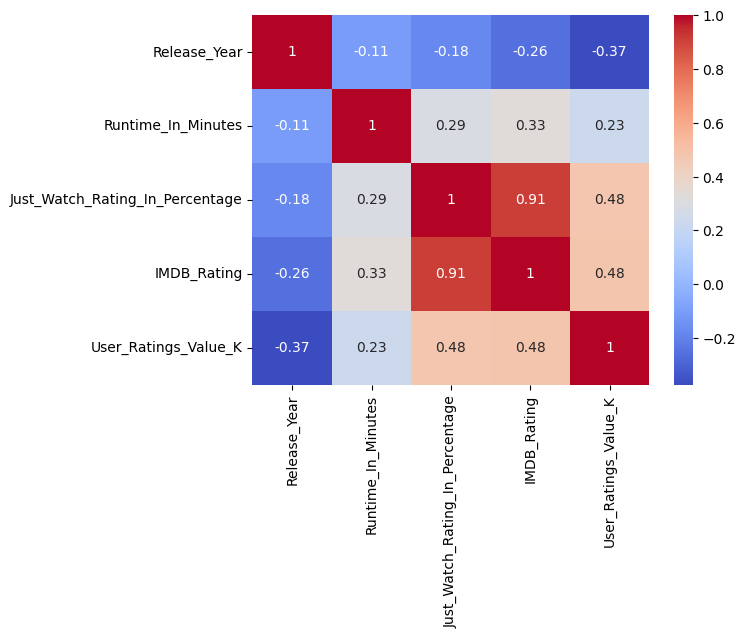

In [ ]:

sns.heatmap(action_adventure_movies.corr(),cmap='coolwarm',annot=True)

In [ ]:
action_adventure_movies
action_adventure_correlation_matrix = action_adventure_movies.corr()
action_adventure_correlation_table = action_adventure_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
action_adventure_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
action_adventure_correlation_table['Correlation Type'] = action_adventure_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
action_adventure_correlation_table['Correlation Strength'] = action_adventure_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


action_adventure_correlation_table


<ipython-input-1327-0cbd4e029e31>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  action_adventure_correlation_matrix = action_adventure_movies.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.911388,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.911388,Positive,Strong
7,User_Ratings_Value_K,IMDB_Rating,0.480041,Positive,Weak
8,IMDB_Rating,User_Ratings_Value_K,0.480041,Positive,Weak
9,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.475859,Positive,Weak


# Crime Movies Analysis

In [ ]:
crime_movies.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
3071,A Call to Spy,Movie,Lydia Dean Pilcher,2019,2016-2020,Crime,123,120-125,74.0,70-80,6.6,6.6-7.0,8.0,1-50
3080,A Cop Movie,Movie,Alonso Ruizpalacios,2021,2021-2025,Crime,107,105-110,78.0,70-80,7.0,7.1-7.5,2.0,1-50
3103,A Man of Action,Movie,Javier Ruiz Caldera,2022,2021-2025,Crime,111,110-115,72.0,70-80,6.3,6.1-6.5,2.0,1-50
3126,Above Suspicion,Movie,Phillip Noyce,2019,2016-2020,Crime,105,105-110,65.0,60-70,5.7,5.6-6.0,7.0,1-50
3158,AKA,Movie,Morgan S. Dalibert,2023,2021-2025,Crime,122,120-125,78.0,70-80,6.6,6.6-7.0,8.0,1-50


# 194 crime movies

In [ ]:
crime_movies.shape


(194, 14)

In [ ]:
crime_movies.Release_Year_Range.value_counts()


2021-2025    107
2016-2020     51
2011-2015     12
2001-2005      8
1996-2000      6
2006-2010      5
1991-1995      3
nan            1
1986-1990      1
Name: Release_Year_Range, dtype: int64

In [ ]:
crime_movies.JustWatch_Range.value_counts()


70-80     87
60-70     63
80-90     25
50-60     11
90-100     3
40-50      2
30-40      2
10-20      1
Name: JustWatch_Range, dtype: int64

In [ ]:
crime_movies.IMDB_Range.value_counts()


6.1-6.5    42
6.6-7.0    38
7.1-7.5    34
5.6-6.0    33
7.6-8.0    13
4.6-5.0    11
5.1-5.5    10
8.1-8.5     4
4.1-4.5     3
8.6-9.0     2
2.0-2.5     1
nan         1
3.6-4.0     1
3.1-3.5     1
Name: IMDB_Range, dtype: int64

In [ ]:
crime_movies.UserRatings_Range.value_counts()


1-50       108
51-100      25
nan         15
101-150     14
201-250     10
151-200      5
251-300      5
451-500      3
351-400      3
401-450      2
651-700      1
701-750      1
551-600      1
301-350      1
Name: UserRatings_Range, dtype: int64

In [ ]:
crime_movies.Runtime_Range.value_counts()


95-100     22
115-120    21
90-95      20
100-105    20
110-115    18
105-110    18
85-90      14
120-125     9
125-130     9
145-150     7
130-135     7
80-85       5
135-140     4
150-155     4
155-160     3
140-145     2
170-175     2
75-80       2
50-55       1
185-190     1
160-165     1
70-75       1
65-70       1
205-210     1
40-45       1
190-195     0
210-215     0
195-200     0
240-245     0
235-240     0
225-230     0
220-225     0
215-220     0
180-185     0
200-205     0
230-235     0
0-5         0
175-180     0
165-170     0
5-10        0
60-65       0
55-60       0
45-50       0
35-40       0
30-35       0
25-30       0
20-25       0
15-20       0
10-15       0
245-250     0
Name: Runtime_Range, dtype: int64

# **Crime Movies Summary Statistics**


Release Year:
Count: There are 194 crime movies in the dataset.

Mean: The average release year for crime movies is approximately 2017.0.

Standard Deviation: The release years of crime movies vary by approximately 8.2 years.

Minimum: The earliest release year for a crime movie is 1964.

Maximum: The latest release year for a crime movie is 2023.
25th Percentile: 25% of the crime movies were released in or before the year 2016.

50th Percentile (Median): 50% of the crime movies were released in or before the year 2020.

75th Percentile: 75% of the crime movies were released in or before the year 2022.
****

Runtime in Minutes:
Mean: The average runtime of crime movies is approximately 110.4 minutes.

Standard Deviation: The runtime of crime movies varies by approximately 22.6 minutes.

Minimum: The shortest runtime for a crime movie is 40 minutes.

Maximum: The longest runtime for a crime movie is 209 minutes.

25th Percentile: 25% of the crime movies have a runtime of 95 minutes or less.

50th Percentile (Median): 50% of the crime movies have a runtime of 107 minutes or less.

75th Percentile: 75% of the crime movies have a runtime of 121 minutes or less.
****

Just Watch Rating in Percentage:

Mean: The average Just Watch rating for crime movies is approximately 70.6%.

Standard Deviation: The Just Watch ratings for crime movies vary by approximately 9.6%.

Minimum: The lowest Just Watch rating for a crime movie is 17%.

Maximum: The highest Just Watch rating for a crime movie is 92%.

25th Percentile: 25% of the crime movies have a Just Watch rating of 66% or lower.

50th Percentile (Median): 50% of the crime movies have a Just Watch rating of 71% or lower.

75th Percentile: 75% of the crime movies have a Just Watch rating of 77% or lower.
****

IMDb Rating:

Mean: The average IMDb rating for crime movies is approximately 6.31.

Standard Deviation: The IMDb ratings for crime movies vary by approximately 1.06.

Minimum: The lowest IMDb rating for a crime movie is 0.

Maximum: The highest IMDb rating for a crime movie is 8.5.

25th Percentile: 25% of the crime movies have an IMDb rating of 5.7 or lower.

50th Percentile (Median): 50% of the crime movies have an IMDb rating of 6.4 or lower.

75th Percentile: 75% of the crime movies have an IMDb rating of 7.0 or lower.

****

User Ratings Value (K):

Mean: The average user ratings value for crime movies is approximately 92.6 thousand.

Standard Deviation: The user ratings values for crime movies vary by approximately 171.4 thousand.

Minimum: The lowest user ratings value for a crime movie is 0 thousand.

Maximum: The highest user ratings value for a crime movie is 1000 thousand.

25th Percentile: 25% of the crime movies have a user ratings value of 4 thousand or lower.

50th Percentile (Median): 50% of the crime movies have a user ratings value of 19.5 thousand or lower.

75th Percentile: 75% of the crime movies have a user ratings value of 103 thousand or lower.

In [ ]:
crime_movies.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,194.000000,194.000000,194.000000,194.000000,194.000000
mean,2017.010309,110.360825,70.634021,6.306186,92.608247
std,8.197048,22.611467,9.588696,1.061265,171.419043
min,1964.000000,40.000000,17.000000,0.000000,0.000000
25%,2016.000000,95.000000,66.000000,5.700000,4.000000
50%,2020.000000,107.000000,71.000000,6.400000,19.500000
75%,2022.000000,121.000000,77.000000,7.000000,103.000000
max,2023.000000,209.000000,92.000000,8.500000,1000.000000


# **Crime Movies Correlation**

Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately -0.184. This indicates a weak negative correlation, suggesting a slight tendency for crime movies released in later years to have slightly shorter runtimes, but the correlation is not strong.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.286. This indicates a weak negative correlation, suggesting a slight tendency for crime movies released in later years to have lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.310. This indicates a weak negative correlation, suggesting a slight tendency for crime movies released in later years to have lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.498. This suggests a moderate negative correlation, indicating a tendency for crime movies released in later years to have lower user ratings values (in thousands).

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.409. This indicates a moderate positive correlation, suggesting a tendency for crime movies with longer runtimes to have higher Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.442. This indicates a moderate positive correlation, suggesting a tendency for crime movies with longer runtimes to have higher IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.395. This indicates a weak positive correlation, suggesting a slight tendency for crime movies with longer runtimes to have slightly higher user ratings values (in thousands).

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.900. This indicates a strong positive correlation, suggesting a strong tendency for crime movies with higher Just Watch rating percentages to also have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.497. This suggests a moderate positive correlation, indicating a tendency for crime movies with higher Just Watch rating percentages to have higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.477. This suggests a moderate positive correlation, indicating a tendency for crime movies with higher IMDB ratings to have higher user ratings values (in thousands).

In [ ]:
crime_movies.corr()


<ipython-input-1336-ace0e771d7fe>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  crime_movies.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,-0.184075,-0.285523,-0.309962,-0.497936
Runtime_In_Minutes,-0.184075,1.000000,0.409309,0.442194,0.395346
Just_Watch_Rating_In_Percentage,-0.285523,0.409309,1.000000,0.900022,0.497307
IMDB_Rating,-0.309962,0.442194,0.900022,1.000000,0.476580
User_Ratings_Value_K,-0.497936,0.395346,0.497307,0.476580,1.000000


<ipython-input-1337-7191817f1bad>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(crime_movies.corr(),cmap='coolwarm',annot=True)


<Axes: >

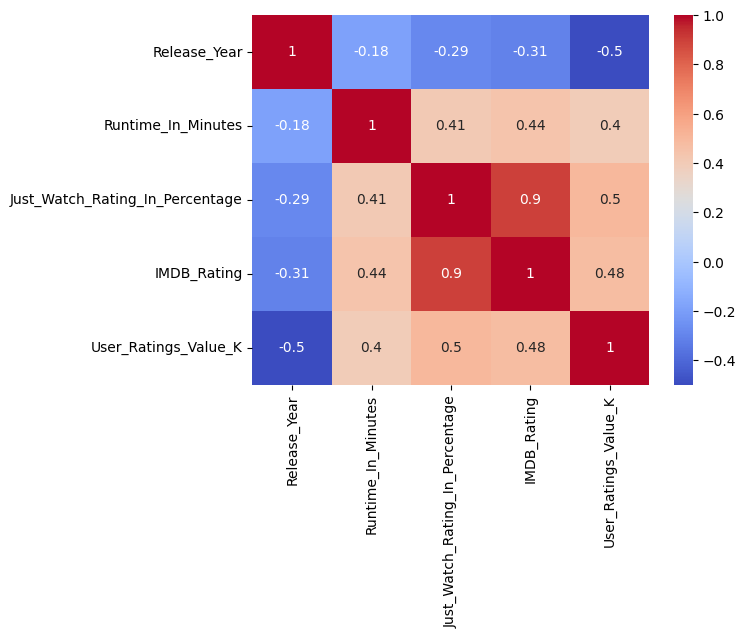

In [ ]:

sns.heatmap(crime_movies.corr(),cmap='coolwarm',annot=True)

In [ ]:
crime_movies
crime_correlation_matrix = crime_movies.corr()
crime_correlation_table = crime_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
crime_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
crime_correlation_table['Correlation Type'] = crime_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
crime_correlation_table['Correlation Strength'] = crime_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


crime_correlation_table


<ipython-input-1338-70da587e39e4>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  crime_correlation_matrix = crime_movies.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.900022,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.900022,Positive,Strong
7,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.497307,Positive,Weak
8,Just_Watch_Rating_In_Percentage,User_Ratings_Value_K,0.497307,Positive,Weak
9,IMDB_Rating,User_Ratings_Value_K,0.476580,Positive,Weak


# Romance Movies Analysis

In [ ]:
romance_movies.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
3046,365 Days,Movie,Tomasz Mandes,2020,2021-2025,Romance,114,110-115,59.0,50-60,3.3,3.1-3.5,93.0,51-100
3049,365 Days: This Day,Movie,Tomasz Mandes,2022,2021-2025,Romance,111,110-115,51.0,50-60,2.6,2.6-3.0,22.0,1-50
3065,A Beautiful Life,Movie,Mehdi Avaz,2023,2021-2025,Romance,98,95-100,44.0,40-50,0.0,nan,0.0,nan
3075,A Castle for Christmas,Movie,Mary Lambert,2021,2021-2025,Romance,98,95-100,64.0,60-70,5.5,5.6-6.0,14.0,1-50
3088,A Fortunate Man,Movie,Bille August,2018,2016-2020,Romance,162,160-165,76.0,70-80,7.2,7.1-7.5,6.0,1-50


# 160 Romance Movies

In [ ]:
romance_movies.shape


(160, 14)

In [ ]:
romance_movies.Release_Year_Range.value_counts()


2021-2025    76
2016-2020    43
2011-2015    18
2006-2010     7
2001-2005     4
1991-1995     3
nan           3
1986-1990     3
1996-2000     2
1975-1980     1
Name: Release_Year_Range, dtype: int64

In [ ]:
romance_movies.JustWatch_Range.value_counts()


70-80    70
60-70    47
80-90    25
50-60    13
30-40     3
40-50     2
Name: JustWatch_Range, dtype: int64

In [ ]:
romance_movies.IMDB_Range.value_counts()


6.6-7.0    31
7.1-7.5    29
5.6-6.0    28
6.1-6.5    27
5.1-5.5    10
7.6-8.0     9
4.6-5.0     7
4.1-4.5     6
nan         4
8.1-8.5     4
2.6-3.0     2
3.6-4.0     2
3.1-3.5     1
Name: IMDB_Range, dtype: int64

In [ ]:
romance_movies.UserRatings_Range.value_counts()


1-50       91
51-100     21
nan        13
151-200    12
101-150     7
301-350     5
251-300     4
201-250     2
651-700     2
401-450     1
601-650     1
551-600     1
Name: UserRatings_Range, dtype: int64

In [ ]:
romance_movies.Runtime_Range.value_counts()


95-100     26
110-115    20
105-110    17
90-95      17
115-120    16
100-105    15
85-90       9
130-135     7
120-125     6
80-85       5
125-130     5
135-140     4
160-165     3
155-160     3
165-170     2
70-75       1
75-80       1
170-175     1
150-155     1
140-145     1
235-240     0
175-180     0
240-245     0
180-185     0
195-200     0
230-235     0
190-195     0
220-225     0
215-220     0
210-215     0
205-210     0
200-205     0
185-190     0
225-230     0
0-5         0
145-150     0
5-10        0
65-70       0
60-65       0
55-60       0
50-55       0
45-50       0
40-45       0
35-40       0
30-35       0
25-30       0
20-25       0
15-20       0
10-15       0
245-250     0
Name: Runtime_Range, dtype: int64

#**Romance Movies Summary Statistics**

Release Year:
Count: There are 160 romance movies in the dataset.
Mean: The average release year for romance movies is approximately 2015.5.
Standard Deviation: The release years of romance movies vary by approximately 11.2 years.
Minimum: The earliest release year for a romance movie is 1954.
Maximum: The latest release year for a romance movie is 2023.
25th Percentile: 25% of the romance movies were released in or before the year 2014.
50th Percentile (Median): 50% of the romance movies were released in or before the year 2019.
75th Percentile: 75% of the romance movies were released in or before the year 2022.


Runtime in Minutes:
Mean: The average runtime of romance movies is approximately 109.4 minutes.
Standard Deviation: The runtime of romance movies varies by approximately 19.3 minutes.
Minimum: The shortest runtime for a romance movie is 74 minutes.
Maximum: The longest runtime for a romance movie is 172 minutes.
25th Percentile: 25% of the romance movies have a runtime of 96 minutes or less.
50th Percentile (Median): 50% of the romance movies have a runtime of 106.5 minutes or less.
75th Percentile: 75% of the romance movies have a runtime of 117.25 minutes or less.


Just Watch Rating in Percentage:
Mean: The average Just Watch rating for romance movies is approximately 70.4%.
Standard Deviation: The Just Watch ratings for romance movies vary by approximately 10.0%.
Minimum: The lowest Just Watch rating for a romance movie is 30%.
Maximum: The highest Just Watch rating for a romance movie is 88%.
25th Percentile: 25% of the romance movies have a Just Watch rating of 66% or lower.
50th Percentile (Median): 50% of the romance movies have a Just Watch rating of 72% or lower.
75th Percentile: 75% of the romance movies have a Just Watch rating of 77.25% or lower.


IMDb Rating:
Mean: The average IMDb rating for romance movies is approximately 6.05.
Standard Deviation: The IMDb ratings for romance movies vary by approximately 1.42.
Minimum: The lowest IMDb rating for a romance movie is 0.
Maximum: The highest IMDb rating for a romance movie is 8.1.
25th Percentile: 25% of the romance movies have an IMDb rating of 5.6 or lower.
50th Percentile (Median): 50% of the romance movies have an IMDb rating of 6.3 or lower.
75th Percentile: 75% of the romance movies have an IMDb rating of 7.0 or lower.


User Ratings Value (K):
Mean: The average user ratings value for romance movies is approximately 75.55 thousand.
Standard Deviation: The user ratings values for romance movies vary by approximately 122.71 thousand.
Minimum: The lowest user ratings value for a romance movie is 0 thousand.
Maximum: The highest user ratings value for a romance movie is 668 thousand.
25th Percentile: 25% of the romance movies have a user ratings value of 7 thousand or lower.
50th Percentile (Median): 50% of the romance movies have a user ratings value of 25 thousand or lower.
75th Percentile: 75% of the romance movies have a user ratings value of 83 thousand or lower.

In [ ]:
romance_movies.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,160.000000,160.000000,160.000000,160.000000,160.000000
mean,2015.506250,109.406250,70.437500,6.051250,75.550000
std,11.247919,19.307279,10.030574,1.419717,122.712211
min,1954.000000,74.000000,30.000000,0.000000,0.000000
25%,2014.000000,96.000000,66.000000,5.600000,7.000000
50%,2019.000000,106.500000,72.000000,6.300000,25.000000
75%,2022.000000,117.250000,77.250000,7.000000,83.000000
max,2023.000000,172.000000,88.000000,8.100000,668.000000


#**Romance Movies Correlation**

Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately -0.186. This indicates a weak negative correlation, suggesting a slight tendency for romance movies released in later years to have slightly shorter runtimes, but the correlation is not strong.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.340. This indicates a moderate negative correlation, suggesting a tendency for romance movies released in later years to have lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.374. This indicates a moderate negative correlation, suggesting a tendency for romance movies released in later years to have lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.380. This suggests a moderate negative correlation, indicating a tendency for romance movies released in later years to have lower user ratings values (in thousands).

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.287. This indicates a weak positive correlation, suggesting a slight tendency for romance movies with longer runtimes to have slightly higher Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.257. This indicates a weak positive correlation, suggesting a slight tendency for romance movies with longer runtimes to have slightly higher IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.311. This indicates a weak positive correlation, suggesting a slight tendency for romance movies with longer runtimes to have slightly higher user ratings values (in thousands).

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.894. This indicates a strong positive correlation, suggesting a strong tendency for romance movies with higher Just Watch rating percentages to also have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.462. This suggests a moderate positive correlation, indicating a tendency for romance movies with higher Just Watch rating percentages to have higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.434. This suggests a moderate positive correlation, indicating a tendency for romance movies with higher IMDB ratings to have higher user ratings values (in thousands).

In [ ]:
romance_movies.corr()


<ipython-input-1347-1cae9b282050>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  romance_movies.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,-0.185665,-0.340012,-0.373940,-0.380243
Runtime_In_Minutes,-0.185665,1.000000,0.286680,0.256995,0.310572
Just_Watch_Rating_In_Percentage,-0.340012,0.286680,1.000000,0.894032,0.461898
IMDB_Rating,-0.373940,0.256995,0.894032,1.000000,0.433863
User_Ratings_Value_K,-0.380243,0.310572,0.461898,0.433863,1.000000


<ipython-input-1348-bcf0618638fb>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(romance_movies.corr(),cmap='coolwarm',annot=True)


<Axes: >

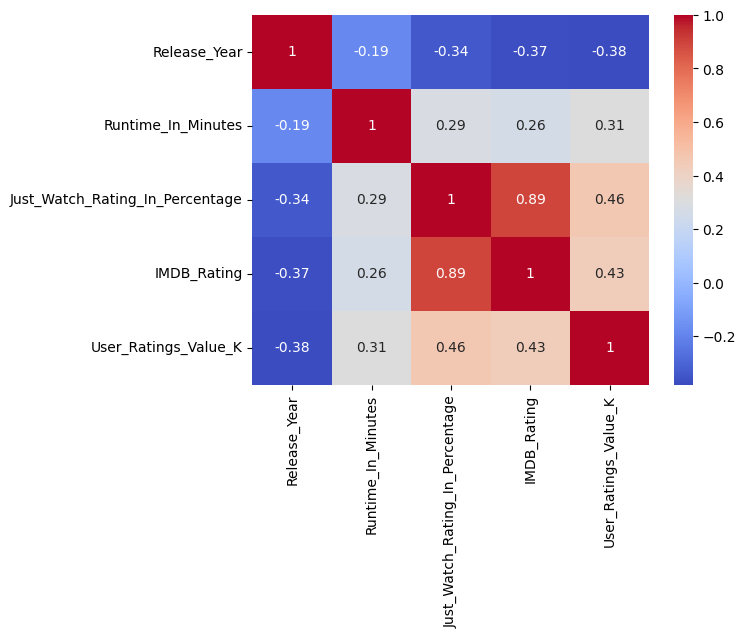

In [ ]:
sns.heatmap(romance_movies.corr(),cmap='coolwarm',annot=True)


In [ ]:
romance_movies
romance_correlation_matrix = romance_movies.corr()
romance_correlation_table = romance_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
romance_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
romance_correlation_table['Correlation Type'] = romance_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
romance_correlation_table['Correlation Strength'] = romance_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


romance_correlation_table


<ipython-input-1349-16fd0e47f2c6>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  romance_correlation_matrix = romance_movies.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.894032,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.894032,Positive,Strong
7,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.461898,Positive,Weak
8,Just_Watch_Rating_In_Percentage,User_Ratings_Value_K,0.461898,Positive,Weak
9,IMDB_Rating,User_Ratings_Value_K,0.433863,Positive,Weak


# Documentary Movies Analysis

In [ ]:
documentary_movies.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
3043,14 Peaks: Nothing Is Impossible,Movie,Torquil Jones,2021,2021-2025,Documentary,101,100-105,82.0,80-90,7.7,7.6-8.0,27.0,1-50
3082,A Cop Movie,Movie,Alonso Ruizpalacios,2021,2021-2025,Documentary,107,105-110,78.0,70-80,7.0,7.1-7.5,2.0,1-50
3114,A Tale of Two Kitchens,Movie,Trisha Ziff,2019,2016-2020,Documentary,29,25-30,69.0,60-70,6.5,6.6-7.0,0.0,nan
3118,A Trip to Infinity,Movie,Drew Takahashi,2022,2021-2025,Documentary,79,75-80,79.0,70-80,7.0,7.1-7.5,3.0,1-50
3155,Airport '77,Movie,Jerry Jameson,1977,1975-1980,Documentary,120,120-125,64.0,60-70,5.8,5.6-6.0,11.0,1-50


# 136 Documentary Movies

In [ ]:
documentary_movies.shape


(136, 14)

In [ ]:
documentary_movies.Release_Year_Range.value_counts()


2021-2025    85
2016-2020    46
2011-2015     2
1975-1980     1
2006-2010     1
1996-2000     1
Name: Release_Year_Range, dtype: int64

In [ ]:
documentary_movies.JustWatch_Range.value_counts()


70-80    69
80-90    27
60-70    24
30-40     7
40-50     5
50-60     4
Name: JustWatch_Range, dtype: int64

In [ ]:
documentary_movies.IMDB_Range.value_counts()


7.1-7.5    38
6.6-7.0    28
6.1-6.5    21
7.6-8.0    17
nan        10
5.6-6.0     8
8.1-8.5     7
5.1-5.5     3
4.6-5.0     3
2.6-3.0     1
Name: IMDB_Range, dtype: int64

In [ ]:
documentary_movies.UserRatings_Range.value_counts()


1-50       102
nan         29
51-100       4
101-150      1
Name: UserRatings_Range, dtype: int64

In [ ]:
documentary_movies.Runtime_Range.value_counts()


95-100     19
85-90      16
90-95      14
60-65      11
100-105    10
80-85      10
70-75       7
105-110     7
115-120     6
65-70       6
110-115     5
40-45       4
75-80       4
120-125     3
25-30       3
55-60       3
135-140     2
140-145     1
125-130     1
15-20       1
35-40       1
20-25       1
10-15       1
215-220     0
190-195     0
195-200     0
200-205     0
205-210     0
210-215     0
180-185     0
230-235     0
220-225     0
225-230     0
240-245     0
235-240     0
185-190     0
0-5         0
175-180     0
170-175     0
165-170     0
160-165     0
155-160     0
150-155     0
145-150     0
130-135     0
5-10        0
50-55       0
45-50       0
30-35       0
245-250     0
Name: Runtime_Range, dtype: int64

#**Documentary Movies Summary Statistics**

Release Year:
Count: There are 136 documentary movies in the dataset.
Mean: The average release year for documentary movies is approximately 2019.6.
Standard Deviation: The release years of documentary movies vary by approximately 4.8 years.
Minimum: The earliest release year for a documentary movie is 1977.
Maximum: The latest release year for a documentary movie is 2023.
25th Percentile: 25% of the documentary movies were released in or before the year 2018.
50th Percentile (Median): 50% of the documentary movies were released in or before the year 2021.
75th Percentile: 75% of the documentary movies were released in or before the year 2022.


Runtime in Minutes:
Mean: The average runtime of documentary movies is approximately 85.7 minutes.
Standard Deviation: The runtime of documentary movies varies by approximately 24.3 minutes.
Minimum: The shortest runtime for a documentary movie is 10 minutes.
Maximum: The longest runtime for a documentary movie is 142 minutes.
25th Percentile: 25% of the documentary movies have a runtime of 72 minutes or less.
50th Percentile (Median): 50% of the documentary movies have a runtime of 89.5 minutes or less.
75th Percentile: 75% of the documentary movies have a runtime of 100 minutes or less.


Just Watch Rating in Percentage:
Mean: The average Just Watch rating for documentary movies is approximately 71.5%.
Standard Deviation: The Just Watch ratings for documentary movies vary by approximately 11.7%.
Minimum: The lowest Just Watch rating for a documentary movie is 35%.
Maximum: The highest Just Watch rating for a documentary movie is 88%.
25th Percentile: 25% of the documentary movies have a Just Watch rating of 69% or lower.
50th Percentile (Median): 50% of the documentary movies have a Just Watch rating of 74% or lower.
75th Percentile: 75% of the documentary movies have a Just Watch rating of 79% or lower.


IMDb Rating:
Mean: The average IMDb rating for documentary movies is approximately 6.32.
Standard Deviation: The IMDb ratings for documentary movies vary by approximately 1.96.
Minimum: The lowest IMDb rating for a documentary movie is 0.
Maximum: The highest IMDb rating for a documentary movie is 8.4.
25th Percentile: 25% of the documentary movies have an IMDb rating of 6.2 or lower.
50th Percentile (Median): 50% of the documentary movies have an IMDb rating of 6.85 or lower.
75th Percentile: 75% of the documentary movies have an IMDb rating of 7.325 or lower.


User Ratings Value (K):
Mean: The average user ratings value for documentary movies is approximately 7.42 thousand.
Standard Deviation: The user ratings values for documentary movies vary by approximately 14.53 thousand.
Minimum: The lowest user ratings value for a documentary movie is 0 thousand.
Maximum: The highest user ratings value for a documentary movie is 100 thousand.
25th Percentile: 25% of the documentary movies have a user ratings value of 1 thousand or lower.
50th Percentile (Median): 50% of the documentary movies have a user ratings value of 2 thousand or lower.
75th Percentile: 75% of the documentary movies have a user ratings value of 7 thousand or lower.

In [ ]:
documentary_movies.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,136.000000,136.000000,136.000000,136.000000,136.000000
mean,2019.647059,85.720588,71.529412,6.322794,7.419118
std,4.838931,24.252588,11.654242,1.957321,14.530456
min,1977.000000,10.000000,35.000000,0.000000,0.000000
25%,2018.000000,72.000000,69.000000,6.200000,1.000000
50%,2021.000000,89.500000,74.000000,6.850000,2.000000
75%,2022.000000,100.000000,79.000000,7.325000,7.000000
max,2023.000000,142.000000,88.000000,8.400000,100.000000


#**Documentary Movies Correlation**

Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately -0.116. This indicates a weak negative correlation, suggesting a slight tendency for documentary movies released in later years to have slightly shorter runtimes, but the correlation is not strong.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately 0.044. This indicates a weak positive correlation, suggesting a slight tendency for documentary movies released in later years to have slightly higher Just Watch rating percentages, but the correlation is not significant.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately 0.026. This indicates a weak positive correlation, suggesting a slight tendency for documentary movies released in later years to have slightly higher IMDB ratings, but the correlation is not significant.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.247. This suggests a weak negative correlation, indicating a tendency for documentary movies released in later years to have slightly lower user ratings values (in thousands), but the correlation is not strong.

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.552. This indicates a moderate positive correlation, suggesting a tendency for documentary movies with longer runtimes to have higher Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.562. This indicates a moderate positive correlation, suggesting a tendency for documentary movies with longer runtimes to have higher IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.334. This indicates a weak positive correlation, suggesting a slight tendency for documentary movies with longer runtimes to have slightly higher user ratings values (in thousands).

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.939. This indicates a strong positive correlation, suggesting a strong tendency for documentary movies with higher Just Watch rating percentages to also have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.217. This indicates a weak positive correlation, suggesting a slight tendency for documentary movies with higher Just Watch rating percentages to have slightly higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.179. This indicates a weak positive correlation, suggesting a slight tendency for documentary movies with higher IMDB ratings to have slightly higher user ratings values (in thousands).

In [ ]:
documentary_movies.corr()


<ipython-input-1358-d67f865e5d44>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  documentary_movies.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,-0.115912,0.043531,0.025882,-0.247351
Runtime_In_Minutes,-0.115912,1.000000,0.552088,0.562017,0.334045
Just_Watch_Rating_In_Percentage,0.043531,0.552088,1.000000,0.939263,0.217392
IMDB_Rating,0.025882,0.562017,0.939263,1.000000,0.178956
User_Ratings_Value_K,-0.247351,0.334045,0.217392,0.178956,1.000000


<ipython-input-1359-0a0293647ff9>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(documentary_movies.corr(),cmap='coolwarm',annot=True)


<Axes: >

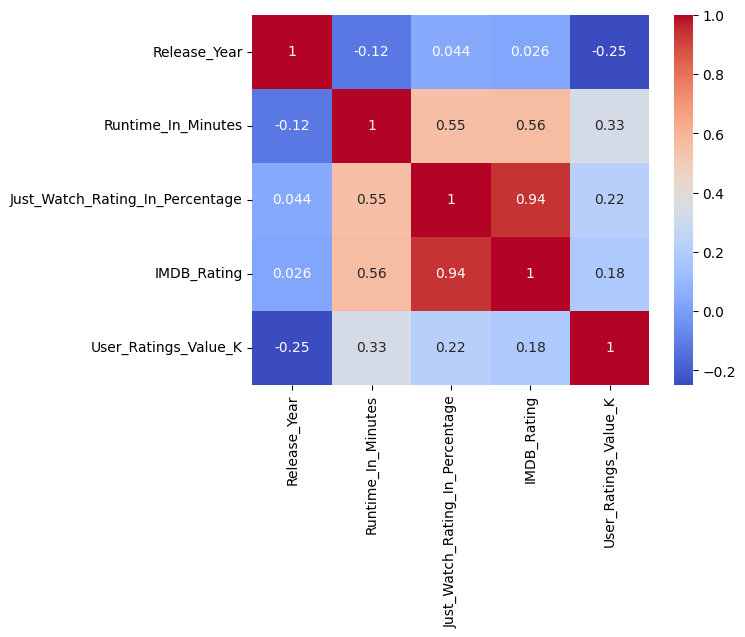

In [ ]:

sns.heatmap(documentary_movies.corr(),cmap='coolwarm',annot=True)


In [ ]:

documentary_correlation_matrix = documentary_movies.corr()
documentary_correlation_table = documentary_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
documentary_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
documentary_correlation_table['Correlation Type'] = documentary_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
documentary_correlation_table['Correlation Strength'] = documentary_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


documentary_correlation_table


<ipython-input-1360-591d02fbe177>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  documentary_correlation_matrix = documentary_movies.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.939263,Positive,Strong
6,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.939263,Positive,Strong
7,IMDB_Rating,Runtime_In_Minutes,0.562017,Positive,Strong
8,Runtime_In_Minutes,IMDB_Rating,0.562017,Positive,Strong
9,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,0.552088,Positive,Strong


#Fantasy Movies Analysis

In [ ]:
fantasy_movies.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
3057,47 Ronin,Movie,Carl Rinsch,2013,2011-2015,Fantasy,119,115-120,69.0,60-70,6.2,6.1-6.5,165.0,151-200
3069,A Boy Called Christmas,Movie,Gil Kenan,2021,2021-2025,Fantasy,106,105-110,78.0,70-80,6.7,6.6-7.0,24.0,1-50
3086,A Fall from Grace,Movie,Tyler Perry,2020,2021-2025,Fantasy,120,120-125,71.0,70-80,5.9,5.6-6.0,16.0,1-50
3106,A Not So Merry Christmas,Movie,Mark Alazraki,2022,2021-2025,Fantasy,99,95-100,65.0,60-70,4.8,4.6-5.0,0.0,nan
3110,A Shaun the Sheep Movie: Farmageddon,Movie,Will Becher,2019,2016-2020,Fantasy,86,85-90,75.0,70-80,6.8,6.6-7.0,14.0,1-50


# 118 Fantasy Movies

In [ ]:
fantasy_movies.shape


(118, 14)

In [ ]:
fantasy_movies.Release_Year_Range.value_counts()


2021-2025    55
2016-2020    27
2011-2015    15
2001-2005     9
2006-2010     4
1996-2000     3
1991-1995     3
1981-1985     1
1975-1980     1
Name: Release_Year_Range, dtype: int64

In [ ]:
fantasy_movies.JustWatch_Range.value_counts()


70-80     58
60-70     33
80-90     16
50-60      7
90-100     3
30-40      1
Name: JustWatch_Range, dtype: int64

In [ ]:
fantasy_movies.IMDB_Range.value_counts()


6.6-7.0    27
6.1-6.5    24
5.6-6.0    20
7.1-7.5    16
5.1-5.5    12
4.6-5.0     6
8.1-8.5     5
4.1-4.5     3
7.6-8.0     3
8.6-9.0     1
2.6-3.0     1
Name: IMDB_Range, dtype: int64

In [ ]:
fantasy_movies.UserRatings_Range.value_counts()


1-50       53
51-100     20
151-200    13
101-150     8
nan         7
201-250     4
651-700     3
401-450     2
251-300     2
551-600     2
601-650     2
751-800     1
801-850     1
Name: UserRatings_Range, dtype: int64

In [ ]:
fantasy_movies.Runtime_Range.value_counts()


100-105    19
90-95      18
95-100     17
105-110    12
110-115    11
115-120    10
85-90       8
120-125     5
125-130     4
80-85       3
145-150     2
140-145     2
130-135     2
160-165     1
70-75       1
165-170     1
45-50       1
135-140     1
235-240     0
170-175     0
175-180     0
180-185     0
240-245     0
205-210     0
230-235     0
200-205     0
220-225     0
215-220     0
210-215     0
185-190     0
190-195     0
195-200     0
225-230     0
0-5         0
155-160     0
150-155     0
5-10        0
75-80       0
65-70       0
60-65       0
55-60       0
50-55       0
40-45       0
35-40       0
30-35       0
25-30       0
20-25       0
15-20       0
10-15       0
245-250     0
Name: Runtime_Range, dtype: int64

#**Fantasy Movies Summary Statistics**

Release Year:
Count: There are 118 fantasy movies in the dataset.
Mean: The average release year for fantasy movies is approximately 2015.3.
Standard Deviation: The release years of fantasy movies vary by approximately 8.9 years.
Minimum: The earliest release year for a fantasy movie is 1975.
Maximum: The latest release year for a fantasy movie is 2023.
25th Percentile: 25% of the fantasy movies were released in or before the year 2012.3.
50th Percentile (Median): 50% of the fantasy movies were released in or before the year 2019.
75th Percentile: 75% of the fantasy movies were released in or before the year 2021.8.


Runtime in Minutes:
Mean: The average runtime of fantasy movies is approximately 105.1 minutes.
Standard Deviation: The runtime of fantasy movies varies by approximately 17.2 minutes.
Minimum: The shortest runtime for a fantasy movie is 45 minutes.
Maximum: The longest runtime for a fantasy movie is 166 minutes.
25th Percentile: 25% of the fantasy movies have a runtime of 94 minutes or less.
50th Percentile (Median): 50% of the fantasy movies have a runtime of 103 minutes or less.
75th Percentile: 75% of the fantasy movies have a runtime of 113 minutes or less.


Just Watch Rating in Percentage:
Mean: The average Just Watch rating for fantasy movies is approximately 72.1%.
Standard Deviation: The Just Watch ratings for fantasy movies vary by approximately 8.6%.
Minimum: The lowest Just Watch rating for a fantasy movie is 34%.
Maximum: The highest Just Watch rating for a fantasy movie is 98%.
25th Percentile: 25% of the fantasy movies have a Just Watch rating of 67.3% or lower.
50th Percentile (Median): 50% of the fantasy movies have a Just Watch rating of 72.5% or lower.
75th Percentile: 75% of the fantasy movies have a Just Watch rating of 77% or lower.


IMDb Rating:
Mean: The average IMDb rating for fantasy movies is approximately 6.27.
Standard Deviation: The IMDb ratings for fantasy movies vary by approximately 0.94.
Minimum: The lowest IMDb rating for a fantasy movie is 2.8.
Maximum: The highest IMDb rating for a fantasy movie is 8.5.
25th Percentile: 25% of the fantasy movies have an IMDb rating of 5.7 or lower.
50th Percentile (Median): 50% of the fantasy movies have an IMDb rating of 6.35 or lower.
75th Percentile: 75% of the fantasy movies have an IMDb rating of 6.8 or lower.


User Ratings Value (K):
Mean: The average user ratings value for fantasy movies is approximately 115.1 thousand.
Standard Deviation: The user ratings values for fantasy movies vary by approximately 179.8 thousand.
Minimum: The lowest user ratings value for a fantasy movie is 0 thousand.
Maximum: The highest user ratings value for a fantasy movie is 839 thousand.
25th Percentile: 25% of the fantasy movies have a user ratings value of 7 thousand or lower.
50th Percentile (Median): 50% of the fantasy movies have a user ratings value of 45.5 thousand or lower.
75th Percentile: 75% of the fantasy movies have a user ratings value of 148.3 thousand or lower.

In [ ]:
fantasy_movies.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,118.000000,118.000000,118.000000,118.000000,118.000000
mean,2015.279661,105.135593,72.076271,6.266949,115.093220
std,8.857741,17.154858,8.646087,0.940000,179.823179
min,1975.000000,45.000000,34.000000,2.800000,0.000000
25%,2012.250000,94.000000,67.250000,5.700000,7.000000
50%,2019.000000,103.000000,72.500000,6.350000,45.500000
75%,2021.750000,113.000000,77.000000,6.800000,148.250000
max,2023.000000,166.000000,98.000000,8.500000,839.000000


#**Fantasy Movies Correlation**

Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately -0.067. This indicates a very weak negative correlation, suggesting a minimal tendency for fantasy movies released in later years to have slightly shorter runtimes, but the correlation is not significant.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.165. This indicates a weak negative correlation, suggesting a slight tendency for fantasy movies released in later years to have slightly lower Just Watch rating percentages, but the correlation is not strong.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.291. This indicates a weak negative correlation, suggesting a slight tendency for fantasy movies released in later years to have slightly lower IMDB ratings, but the correlation is not significant.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.554. This suggests a moderate negative correlation, indicating a tendency for fantasy movies released in later years to have slightly lower user ratings values (in thousands), but the correlation is not strong.

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.070. This indicates a very weak positive correlation, suggesting a minimal tendency for fantasy movies with longer runtimes to have slightly higher Just Watch rating percentages, but the correlation is not significant.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.048. This indicates a very weak positive correlation, suggesting a minimal tendency for fantasy movies with longer runtimes to have slightly higher IMDB ratings, but the correlation is not significant.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.240. This indicates a weak positive correlation, suggesting a slight tendency for fantasy movies with longer runtimes to have slightly higher user ratings values (in thousands).

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.945. This indicates a strong positive correlation, suggesting a significant tendency for fantasy movies with higher Just Watch rating percentages to also have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.353. This indicates a weak positive correlation, suggesting a slight tendency for fantasy movies with higher Just Watch rating percentages to have slightly higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.460. This indicates a moderate positive correlation, suggesting a tendency for fantasy movies with higher IMDB ratings to have slightly higher user ratings values (in thousands).


In [ ]:
fantasy_movies.corr()


<ipython-input-1369-2b841d69189d>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  fantasy_movies.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,-0.067355,-0.164559,-0.291025,-0.554371
Runtime_In_Minutes,-0.067355,1.000000,0.070174,0.047612,0.240097
Just_Watch_Rating_In_Percentage,-0.164559,0.070174,1.000000,0.944790,0.352988
IMDB_Rating,-0.291025,0.047612,0.944790,1.000000,0.460014
User_Ratings_Value_K,-0.554371,0.240097,0.352988,0.460014,1.000000


<ipython-input-1370-7570074874b2>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(fantasy_movies.corr(),cmap='coolwarm',annot=True)


<Axes: >

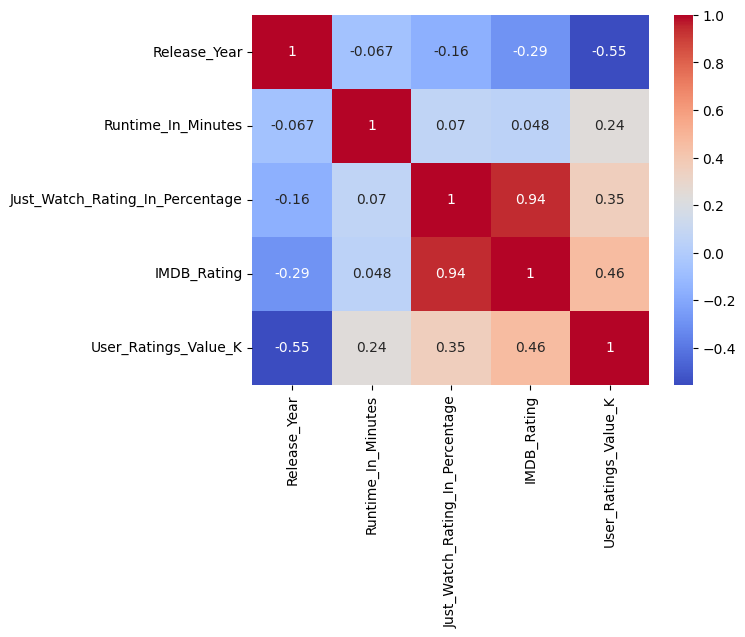

In [ ]:

sns.heatmap(fantasy_movies.corr(),cmap='coolwarm',annot=True)

In [ ]:

fantasy_correlation_matrix = fantasy_movies.corr()
fantasy_correlation_table = fantasy_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
fantasy_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
fantasy_correlation_table['Correlation Type'] = fantasy_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
fantasy_correlation_table['Correlation Strength'] = fantasy_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


fantasy_correlation_table


<ipython-input-1371-a282312cb712>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  fantasy_correlation_matrix = fantasy_movies.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.944790,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.944790,Positive,Strong
7,User_Ratings_Value_K,IMDB_Rating,0.460014,Positive,Weak
8,IMDB_Rating,User_Ratings_Value_K,0.460014,Positive,Weak
9,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.352988,Positive,Weak


#Horror Movies Analysis

In [ ]:
horror_movies.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
3053,47 Meters Down: Uncaged,Movie,Johannes Roberts,2019,2016-2020,Horror,89,85-90,61.0,60-70,5.0,5.1-5.5,28.0,1-50
3078,A Classic Horror Story,Movie,Paolo Strippoli,2021,2021-2025,Horror,95,95-100,36.0,30-40,0.0,nan,0.0,nan
3141,Aftermath,Movie,Peter Winther,2021,2021-2025,Horror,114,110-115,65.0,60-70,5.3,5.1-5.5,17.0,1-50
3206,Andhaghaaram,Movie,V. Vignarajan,2020,2021-2025,Horror,171,170-175,81.0,80-90,7.5,7.6-8.0,3.0,1-50
3232,Apollo 10½: A Space Age Childhood,Movie,Richard Linklater,2022,2021-2025,Horror,98,95-100,78.0,70-80,7.2,7.1-7.5,10.0,1-50


# 112 Horror Movies

In [ ]:
horror_movies.shape


(112, 14)

In [ ]:
horror_movies.Release_Year_Range.value_counts()


2021-2025    64
2016-2020    26
2011-2015     8
2006-2010     5
2001-2005     4
1996-2000     3
nan           2
Name: Release_Year_Range, dtype: int64

In [ ]:
horror_movies.JustWatch_Range.value_counts()


60-70     45
70-80     36
50-60     19
80-90      7
30-40      3
40-50      1
90-100     1
Name: JustWatch_Range, dtype: int64

In [ ]:
horror_movies.IMDB_Range.value_counts()


5.1-5.5    21
6.1-6.5    21
5.6-6.0    17
4.6-5.0    16
7.1-7.5    13
6.6-7.0    12
7.6-8.0     4
nan         3
4.1-4.5     3
2.6-3.0     1
8.6-9.0     1
Name: IMDB_Range, dtype: int64

In [ ]:
horror_movies.UserRatings_Range.value_counts()


1-50       62
nan        13
51-100     11
101-150     9
251-300     4
201-250     4
151-200     3
351-400     2
651-700     2
301-350     1
551-600     1
Name: UserRatings_Range, dtype: int64

In [ ]:
horror_movies.Runtime_Range.value_counts()


100-105    19
95-100     18
85-90      17
105-110    14
90-95      13
110-115    10
115-120     6
125-130     4
80-85       4
145-150     2
120-125     2
135-140     1
170-175     1
70-75       1
165-170     0
175-180     0
180-185     0
155-160     0
185-190     0
190-195     0
195-200     0
200-205     0
205-210     0
210-215     0
215-220     0
220-225     0
225-230     0
230-235     0
235-240     0
240-245     0
160-165     0
0-5         0
150-155     0
140-145     0
10-15       0
15-20       0
20-25       0
25-30       0
30-35       0
35-40       0
40-45       0
45-50       0
50-55       0
55-60       0
60-65       0
65-70       0
75-80       0
5-10        0
130-135     0
245-250     0
Name: Runtime_Range, dtype: int64

#**Horror Movies Summary Statistics**

Release Year:
Count: There are 112 horror movies in the dataset.
Mean: The average release year for horror movies is approximately 2016.8.
Standard Deviation: The release years of horror movies vary by approximately 9.5 years.
Minimum: The earliest release year for a horror movie is 1960.
Maximum: The latest release year for a horror movie is 2023.
25th Percentile: 25% of the horror movies were released in or before the year 2016.
50th Percentile (Median): 50% of the horror movies were released in or before the year 2020.
75th Percentile: 75% of the horror movies were released in or before the year 2022.
****

Runtime in Minutes:
Mean: The average runtime of horror movies is approximately 102.0 minutes.
Standard Deviation: The runtime of horror movies varies by approximately 14.7 minutes.
Minimum: The shortest runtime for a horror movie is 71 minutes.
Maximum: The longest runtime for a horror movie is 171 minutes.
25th Percentile: 25% of the horror movies have a runtime of 92 minutes or less.
50th Percentile (Median): 50% of the horror movies have a runtime of 101 minutes or less.
75th Percentile: 75% of the horror movies have a runtime of 109 minutes or less.

****

Just Watch Rating in Percentage:
Mean: The average Just Watch rating for horror movies is approximately 66.8%.
Standard Deviation: The Just Watch ratings for horror movies vary by approximately 9.6%.
Minimum: The lowest Just Watch rating for a horror movie is 34%.
Maximum: The highest Just Watch rating for a horror movie is 92%.
25th Percentile: 25% of the horror movies have a Just Watch rating of 61.8% or lower.
50th Percentile (Median): 50% of the horror movies have a Just Watch rating of 67.5% or lower.
75th Percentile: 75% of the horror movies have a Just Watch rating of 73% or lower.

****

IMDb Rating:
Mean: The average IMDb rating for horror movies is approximately 5.7.
Standard Deviation: The IMDb ratings for horror movies vary by approximately 1.3.
Minimum: The lowest IMDb rating for a horror movie is 0.0.
Maximum: The highest IMDb rating for a horror movie is 8.5.
25th Percentile: 25% of the horror movies have an IMDb rating of 5.2 or lower.
50th Percentile (Median): 50% of the horror movies have an IMDb rating of 5.8 or lower.
75th Percentile: 75% of the horror movies have an IMDb rating of 6.5 or lower.

****

User Ratings Value (K):
Mean: The average user ratings value for horror movies is approximately 73.7 thousand.
Standard Deviation: The user ratings values for horror movies vary by approximately 129.4 thousand.
Minimum: The lowest user ratings value for a horror movie is 0 thousand.
Maximum: The highest user ratings value for a horror movie is 688 thousand.
25th Percentile: 25% of the horror movies have a user ratings value of 4.75 thousand or lower.
50th Percentile (Median): 50% of the horror movies have a user ratings value of 17.5 thousand or lower.
75th Percentile: 75% of the horror movies have a user ratings value of 83.8 thousand or lower.

In [ ]:
horror_movies.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,112.000000,112.000000,112.000000,112.000000,112.000000
mean,2016.776786,102.035714,66.794643,5.708929,73.660714
std,9.489406,14.722006,9.587096,1.333191,129.446469
min,1960.000000,71.000000,34.000000,0.000000,0.000000
25%,2016.000000,92.000000,61.750000,5.175000,4.750000
50%,2020.000000,101.000000,67.500000,5.800000,17.500000
75%,2022.000000,109.000000,73.000000,6.500000,83.750000
max,2023.000000,171.000000,92.000000,8.500000,688.000000


#**Horror Movies Correlation**


Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately -0.116. This indicates a weak negative correlation, suggesting a slight tendency for horror movies released in later years to have slightly shorter runtimes, but the correlation is not strong.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.373. This indicates a moderate negative correlation, suggesting a tendency for horror movies released in later years to have slightly lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.353. This indicates a moderate negative correlation, suggesting a tendency for horror movies released in later years to have slightly lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.611. This suggests a strong negative correlation, indicating a tendency for horror movies released in later years to have lower user ratings values (in thousands).

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.253. This indicates a weak positive correlation, suggesting a slight tendency for horror movies with longer runtimes to have slightly higher Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.176. This indicates a weak positive correlation, suggesting a slight tendency for horror movies with longer runtimes to have slightly higher IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.143. This indicates a weak positive correlation, suggesting a slight tendency for horror movies with longer runtimes to have slightly higher user ratings values (in thousands).

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.932. This indicates a strong positive correlation, suggesting a significant tendency for horror movies with higher Just Watch rating percentages to also have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.499. This indicates a moderate positive correlation, suggesting a tendency for horror movies with higher Just Watch rating percentages to have higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.453. This indicates a moderate positive correlation, suggesting a tendency for horror movies with higher IMDB ratings to have higher user ratings values (in thousands).

In [ ]:
horror_movies.corr()


<ipython-input-1380-30f674c943d6>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  horror_movies.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,-0.116212,-0.372749,-0.352975,-0.611104
Runtime_In_Minutes,-0.116212,1.000000,0.253010,0.175920,0.142929
Just_Watch_Rating_In_Percentage,-0.372749,0.253010,1.000000,0.932029,0.499019
IMDB_Rating,-0.352975,0.175920,0.932029,1.000000,0.452878
User_Ratings_Value_K,-0.611104,0.142929,0.499019,0.452878,1.000000


<ipython-input-1381-d98118f00aa5>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(horror_movies.corr(),cmap='coolwarm',annot=True)


<Axes: >

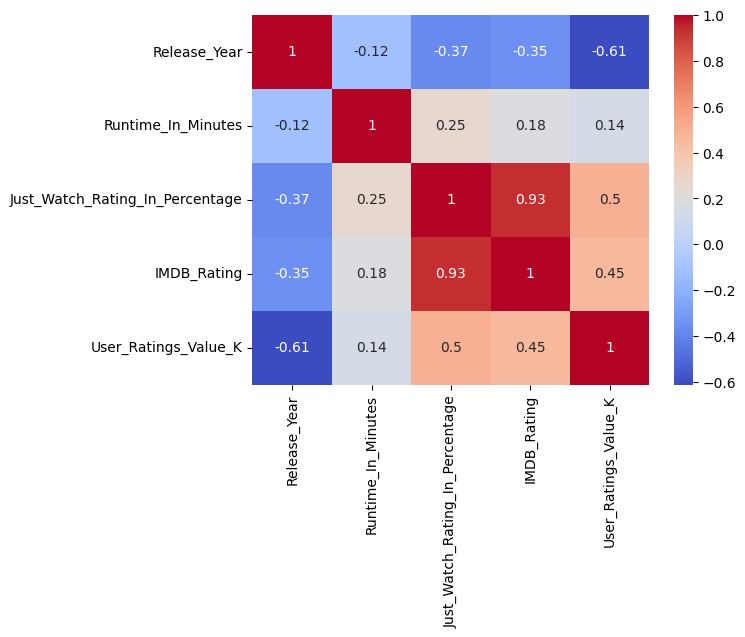

In [ ]:

sns.heatmap(horror_movies.corr(),cmap='coolwarm',annot=True)

In [ ]:

horror_correlation_matrix = horror_movies.corr()
horror_correlation_table = horror_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
horror_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
horror_correlation_table['Correlation Type'] = horror_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
horror_correlation_table['Correlation Strength'] = horror_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


horror_correlation_table


<ipython-input-1382-94fcb5a2e23a>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  horror_correlation_matrix = horror_movies.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.932029,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.932029,Positive,Strong
7,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.499019,Positive,Weak
8,Just_Watch_Rating_In_Percentage,User_Ratings_Value_K,0.499019,Positive,Weak
9,IMDB_Rating,User_Ratings_Value_K,0.452878,Positive,Weak


#Kids and Family Movies Analysis

In [ ]:
kids_family_movies.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
3068,A Boy Called Christmas,Movie,Gil Kenan,2021,2021-2025,Kids & Family,106,105-110,78.0,70-80,6.7,6.6-7.0,24.0,1-50
3074,A Castle for Christmas,Movie,Mary Lambert,2021,2021-2025,Kids & Family,98,95-100,64.0,60-70,5.5,5.6-6.0,14.0,1-50
3097,A League of Their Own,Movie,Penny Marshall,1992,1991-1995,Kids & Family,128,125-130,79.0,70-80,7.3,7.1-7.5,115.0,101-150
3113,A Shaun the Sheep Movie: Farmageddon,Movie,Will Becher,2019,2016-2020,Kids & Family,86,85-90,75.0,70-80,6.8,6.6-7.0,14.0,1-50
3123,A Whisker Away,Movie,Junichi Sato,2020,2021-2025,Kids & Family,104,100-105,81.0,80-90,6.7,6.6-7.0,11.0,1-50


# 94 Kids and Family Movies

In [ ]:
kids_family_movies.shape


(94, 14)

In [ ]:
kids_family_movies.Release_Year_Range.value_counts()


2021-2025    49
2016-2020    25
2011-2015     9
2001-2005     5
1991-1995     2
2006-2010     2
1996-2000     1
1986-1990     1
Name: Release_Year_Range, dtype: int64

In [ ]:
kids_family_movies.JustWatch_Range.value_counts()


70-80     47
60-70     27
80-90     14
50-60      5
90-100     1
Name: JustWatch_Range, dtype: int64

In [ ]:
kids_family_movies.IMDB_Range.value_counts()


6.6-7.0    24
5.6-6.0    19
7.1-7.5    19
6.1-6.5    18
5.1-5.5     6
7.6-8.0     2
8.1-8.5     2
4.6-5.0     2
4.1-4.5     1
3.1-3.5     1
Name: IMDB_Range, dtype: int64

In [ ]:
kids_family_movies.UserRatings_Range.value_counts()


1-50       55
51-100     15
151-200    10
101-150     6
nan         3
251-300     2
201-250     2
751-800     1
Name: UserRatings_Range, dtype: int64

In [ ]:
kids_family_movies.Runtime_Range.value_counts()


95-100     22
85-90      12
100-105    11
110-115    10
105-110    10
90-95       9
115-120     5
80-85       3
70-75       3
65-70       2
125-130     2
55-60       1
120-125     1
140-145     1
155-160     1
45-50       1
195-200     0
170-175     0
175-180     0
205-210     0
180-185     0
185-190     0
190-195     0
240-245     0
165-170     0
235-240     0
200-205     0
225-230     0
220-225     0
215-220     0
210-215     0
230-235     0
0-5         0
160-165     0
40-45       0
10-15       0
15-20       0
20-25       0
25-30       0
30-35       0
35-40       0
50-55       0
150-155     0
60-65       0
75-80       0
5-10        0
130-135     0
135-140     0
145-150     0
245-250     0
Name: Runtime_Range, dtype: int64

#**Kids and Family Movies Summary Statistics**

Release Year:
Count: There are 94 kids and family movies in the dataset.
Mean: The average release year for kids and family movies is approximately 2016.9.
Standard Deviation: The release years of kids and family movies vary by approximately 7.6 years.
Minimum: The earliest release year for a kids and family movie is 1988.
Maximum: The latest release year for a kids and family movie is 2023.
25th Percentile: 25% of the kids and family movies were released in or before the year 2015.2.
50th Percentile (Median): 50% of the kids and family movies were released in or before the year 2020.
75th Percentile: 75% of the kids and family movies were released in or before the year 2022.

****
Runtime in Minutes:
Mean: The average runtime of kids and family movies is approximately 98.5 minutes.
Standard Deviation: The runtime of kids and family movies varies by approximately 15.9 minutes.
Minimum: The shortest runtime for a kids and family movie is 45 minutes.
Maximum: The longest runtime for a kids and family movie is 157 minutes.
25th Percentile: 25% of the kids and family movies have a runtime of 90 minutes or less.
50th Percentile (Median): 50% of the kids and family movies have a runtime of 97.5 minutes or less.
75th Percentile: 75% of the kids and family movies have a runtime of 106.8 minutes or less.

****
Just Watch Rating in Percentage:
Mean: The average Just Watch rating for kids and family movies is approximately 72.9%.
Standard Deviation: The Just Watch ratings for kids and family movies vary by approximately 7.4%.
Minimum: The lowest Just Watch rating for a kids and family movie is 54%.
Maximum: The highest Just Watch rating for a kids and family movie is 90%.
25th Percentile: 25% of the kids and family movies have a Just Watch rating of 68% or lower.
50th Percentile (Median): 50% of the kids and family movies have a Just Watch rating of 74% or lower.
75th Percentile: 75% of the kids and family movies have a Just Watch rating of 78% or lower.

****

IMDb Rating:
Mean: The average IMDb rating for kids and family movies is approximately 6.3.
Standard Deviation: The IMDb ratings for kids and family movies vary by approximately 0.9.
Minimum: The lowest IMDb rating for a kids and family movie is 3.1.
Maximum: The highest IMDb rating for a kids and family movie is 8.2.
25th Percentile: 25% of the kids and family movies have an IMDb rating of 5.7 or lower.
50th Percentile (Median): 50% of the kids and family movies have an IMDb rating of 6.4 or lower.
75th Percentile: 75% of the kids and family movies have an IMDb rating of 6.9 or lower.

****

User Ratings Value (K):
Mean: The average user ratings value for kids and family movies is approximately 64.7 thousand.
Standard Deviation: The user ratings values for kids and family movies vary by approximately 100.5 thousand.
Minimum: The lowest user ratings value for a kids and family movie is 0 thousand.
Maximum: The highest user ratings value for a kids and family movie is 760 thousand.
25th Percentile: 25% of the kids and family movies have a user ratings value of 6 thousand or lower.
50th Percentile (Median): 50% of the kids and family movies have a user ratings value of 23 thousand or lower.
75th Percentile: 75% of the kids and family movies have a user ratings value of 92.5 thousand or lower.

In [ ]:
kids_family_movies.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,94.000000,94.000000,94.000000,94.000000,94.000000
mean,2016.914894,98.531915,72.936170,6.327660,64.691489
std,7.564290,15.855329,7.391958,0.851994,100.481104
min,1988.000000,45.000000,54.000000,3.100000,0.000000
25%,2015.250000,90.000000,68.000000,5.700000,6.000000
50%,2020.000000,97.500000,74.000000,6.450000,23.000000
75%,2022.000000,106.750000,78.000000,6.875000,92.500000
max,2023.000000,157.000000,90.000000,8.200000,760.000000


#**Kids and Family Movies Correlation**


Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately 0.027. This indicates a very weak positive correlation, suggesting a slight tendency for kids and family movies released in later years to have slightly longer runtimes, but the correlation is not significant.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.022. This indicates a very weak negative correlation, suggesting no significant relationship between the release year and the Just Watch rating percentage for kids and family movies.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.158. This indicates a weak negative correlation, suggesting a slight tendency for kids and family movies released in later years to have slightly lower IMDB ratings, but the correlation is not significant.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.502. This suggests a moderate negative correlation, indicating a tendency for kids and family movies released in later years to have lower user ratings values (in thousands).

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.108. This indicates a weak positive correlation, suggesting a slight tendency for kids and family movies with longer runtimes to have slightly higher Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.082. This indicates a weak positive correlation, suggesting a slight tendency for kids and family movies with longer runtimes to have slightly higher IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.119. This indicates a weak positive correlation, suggesting a slight tendency for kids and family movies with longer runtimes to have slightly higher user ratings values (in thousands).

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.938. This indicates a strong positive correlation, suggesting a strong tendency for kids and family movies with higher Just Watch rating percentages to also have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.313. This indicates a weak positive correlation, suggesting a slight tendency for kids and family movies with higher Just Watch rating percentages to have slightly higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.393. This indicates a moderate positive correlation, suggesting a tendency for kids and family movies with higher IMDB ratings to have higher user ratings values (in thousands).

In [ ]:
kids_family_movies.corr()


<ipython-input-1391-67b14891ef3b>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  kids_family_movies.corr()
/usr/local/lib/python3.10/dist-packages/IPython/core/displayhook.py:275: UserWarning: Output cache limit (currently 1000 entries) hit.
Flushing oldest 200 entries.
  warn('Output cache limit (currently {sz} entries) hit.\n'


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,0.026740,-0.021636,-0.157966,-0.502381
Runtime_In_Minutes,0.026740,1.000000,0.108001,0.082478,0.119134
Just_Watch_Rating_In_Percentage,-0.021636,0.108001,1.000000,0.938469,0.313440
IMDB_Rating,-0.157966,0.082478,0.938469,1.000000,0.393310
User_Ratings_Value_K,-0.502381,0.119134,0.313440,0.393310,1.000000


<ipython-input-1392-096b72d3d4e1>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(kids_family_movies.corr(),cmap='coolwarm',annot=True)


<Axes: >

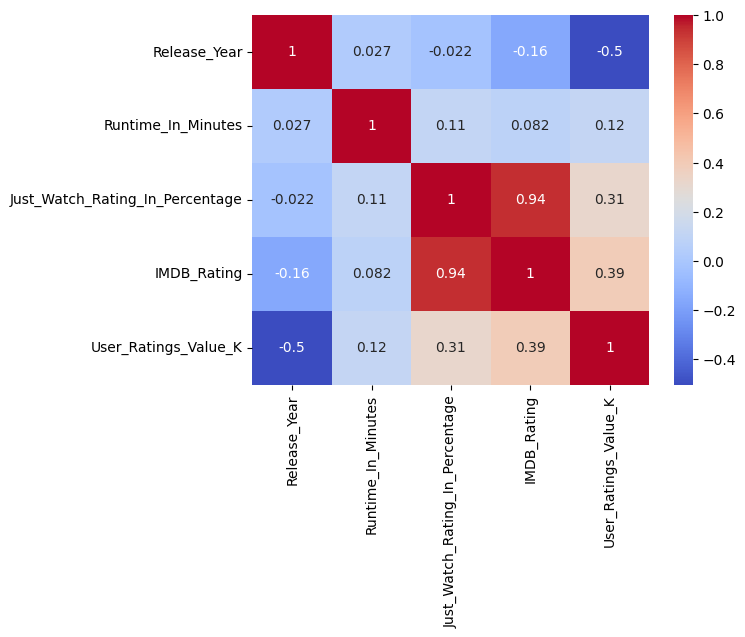

In [ ]:
sns.heatmap(kids_family_movies.corr(),cmap='coolwarm',annot=True)


In [ ]:

kids_family_correlation_matrix = kids_family_movies.corr()
kids_family_correlation_table = kids_family_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
kids_family_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
kids_family_correlation_table['Correlation Type'] = kids_family_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
kids_family_correlation_table['Correlation Strength'] = kids_family_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


kids_family_correlation_table


<ipython-input-1393-82c37e940b8a>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  kids_family_correlation_matrix = kids_family_movies.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.938469,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.938469,Positive,Strong
7,User_Ratings_Value_K,IMDB_Rating,0.393310,Positive,Weak
8,IMDB_Rating,User_Ratings_Value_K,0.393310,Positive,Weak
9,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.313440,Positive,Weak


#Science Fiction Movies Analysis

In [ ]:
science_fiction_movies.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
3035,11:11,Movie,Karim Abouzeid,2015,2016-2020,Science-Fiction,60,60-65,43.0,40-50,6.7,6.6-7.0,0.0,nan
3111,A Shaun the Sheep Movie: Farmageddon,Movie,Will Becher,2019,2016-2020,Science-Fiction,86,85-90,75.0,70-80,6.8,6.6-7.0,14.0,1-50
3131,After Earth,Movie,M. Night Shyamalan,2013,2011-2015,Science-Fiction,100,100-105,57.0,50-60,4.8,4.6-5.0,205.0,201-250
3182,America: The Motion Picture,Movie,Matt Thompson,2021,2021-2025,Science-Fiction,98,95-100,64.0,60-70,5.6,5.6-6.0,6.0,1-50
3221,Animal World,Movie,Yan Han,2018,2016-2020,Science-Fiction,125,125-130,74.0,70-80,6.4,6.1-6.5,4.0,1-50


# 83 Science Fiction Movies

In [ ]:
science_fiction_movies.shape


(83, 14)

In [ ]:
science_fiction_movies.Release_Year_Range.value_counts()


2021-2025    35
2016-2020    27
2011-2015     8
2001-2005     5
1996-2000     3
2006-2010     3
1981-1985     1
1991-1995     1
Name: Release_Year_Range, dtype: int64

In [ ]:
science_fiction_movies.JustWatch_Range.value_counts()


70-80     37
60-70     25
80-90     11
50-60      4
90-100     3
40-50      2
30-40      1
Name: JustWatch_Range, dtype: int64

In [ ]:
science_fiction_movies.IMDB_Range.value_counts()


7.1-7.5    19
5.6-6.0    18
6.1-6.5    15
6.6-7.0    14
4.6-5.0     6
5.1-5.5     4
8.6-9.0     2
2.6-3.0     2
7.6-8.0     2
8.1-8.5     1
Name: IMDB_Range, dtype: int64

In [ ]:
science_fiction_movies.UserRatings_Range.value_counts()


1-50       41
101-150     8
51-100      7
201-250     6
151-200     6
nan         4
251-300     2
551-600     2
651-700     2
301-350     2
351-400     1
801-850     1
601-650     1
Name: UserRatings_Range, dtype: int64

In [ ]:
science_fiction_movies.Runtime_Range.value_counts()


100-105    12
85-90       9
110-115     9
95-100      9
115-120     8
105-110     8
125-130     5
120-125     5
90-95       5
135-140     4
80-85       3
55-60       1
70-75       1
145-150     1
45-50       1
130-135     1
60-65       1
235-240     0
175-180     0
180-185     0
185-190     0
240-245     0
190-195     0
225-230     0
230-235     0
220-225     0
215-220     0
210-215     0
205-210     0
165-170     0
195-200     0
200-205     0
170-175     0
0-5         0
160-165     0
155-160     0
150-155     0
140-145     0
5-10        0
75-80       0
65-70       0
50-55       0
40-45       0
35-40       0
30-35       0
25-30       0
20-25       0
15-20       0
10-15       0
245-250     0
Name: Runtime_Range, dtype: int64

#**Science Fiction Movies Summary Statistics**

Release Year:
Count: There are 83 science fiction movies in the dataset.
Mean: The average release year for science fiction movies is approximately 2016.0.
Standard Deviation: The release years of science fiction movies vary by approximately 7.9 years.
Minimum: The earliest release year for a science fiction movie is 1984.
Maximum: The latest release year for a science fiction movie is 2023.
25th Percentile: 25% of the science fiction movies were released in or before the year 2014.5.
50th Percentile (Median): 50% of the science fiction movies were released in or before the year 2019.
75th Percentile: 75% of the science fiction movies were released in or before the year 2021.

****
Runtime in Minutes:
Mean: The average runtime of science fiction movies is approximately 104.8 minutes.
Standard Deviation: The runtime of science fiction movies varies by approximately 18.2 minutes.
Minimum: The shortest runtime for a science fiction movie is 45 minutes.
Maximum: The longest runtime for a science fiction movie is 148 minutes.
25th Percentile: 25% of the science fiction movies have a runtime of 94.5 minutes or less.
50th Percentile (Median): 50% of the science fiction movies have a runtime of 104 minutes or less.
75th Percentile: 75% of the science fiction movies have a runtime of 116.5 minutes or less.
****

Just Watch Rating in Percentage:
Mean: The average Just Watch rating for science fiction movies is approximately 71.2%.
Standard Deviation: The Just Watch ratings for science fiction movies vary by approximately 10.0%.
Minimum: The lowest Just Watch rating for a science fiction movie is 35%.
Maximum: The highest Just Watch rating for a science fiction movie is 98%.
25th Percentile: 25% of the science fiction movies have a Just Watch rating of 65.5% or lower.
50th Percentile (Median): 50% of the science fiction movies have a Just Watch rating of 72% or lower.
75th Percentile: 75% of the science fiction movies have a Just Watch rating of 78% or lower.

****
IMDb Rating:
Mean: The average IMDb rating for science fiction movies is approximately 6.3.
Standard Deviation: The IMDb ratings for science fiction movies vary by approximately 1.0.
Minimum: The lowest IMDb rating for a science fiction movie is 2.5.
Maximum: The highest IMDb rating for a science fiction movie is 8.6.
25th Percentile: 25% of the science fiction movies have an IMDb rating of 5.7 or lower.
50th Percentile (Median): 50% of the science fiction movies have an IMDb rating of 6.3 or lower.
75th Percentile: 75% of the science fiction movies have an IMDb rating of 7.0 or lower.

****
User Ratings Value (K):
Mean: The average user ratings value for science fiction movies is approximately 133.7 thousand.
Standard Deviation: The user ratings values for science fiction movies vary by approximately 201.7 thousand.
Minimum: The lowest user ratings value for a science fiction movie is 0 thousand.
Maximum: The highest user ratings value for a science fiction movie is 1000 thousand.
25th Percentile: 25% of the science fiction movies have a user ratings value of 8.5 thousand or lower.
50th Percentile (Median): 50% of the science fiction movies have a user ratings value of 44 thousand or lower.
75th Percentile: 75% of the science fiction movies have a user ratings value of 180.5 thousand or lower.

In [ ]:
science_fiction_movies.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,83.000000,83.000000,83.000000,83.000000,83.000000
mean,2016.012048,104.759036,71.216867,6.279518,133.698795
std,7.948760,18.179720,10.047507,1.033318,201.741548
min,1984.000000,45.000000,35.000000,2.500000,0.000000
25%,2014.500000,94.500000,65.500000,5.700000,8.500000
50%,2019.000000,104.000000,72.000000,6.300000,44.000000
75%,2021.000000,116.500000,78.000000,7.000000,180.500000
max,2023.000000,148.000000,98.000000,8.600000,1000.000000


#**Science Fiction Movies Correlation**


Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately -0.276. This indicates a moderate negative correlation, suggesting a tendency for science fiction movies released in later years to have slightly shorter runtimes.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.283. This indicates a moderate negative correlation, suggesting a tendency for science fiction movies released in later years to have slightly lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.399. This indicates a moderate negative correlation, suggesting a tendency for science fiction movies released in later years to have slightly lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.599. This indicates a strong negative correlation, indicating a tendency for science fiction movies released in later years to have lower user ratings values (in thousands).

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.224. This indicates a weak positive correlation, suggesting a slight tendency for science fiction movies with longer runtimes to have slightly higher Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.121. This indicates a weak positive correlation, suggesting a slight tendency for science fiction movies with longer runtimes to have slightly higher IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.454. This indicates a moderate positive correlation, suggesting a tendency for science fiction movies with longer runtimes to have higher user ratings values (in thousands).

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.896. This indicates a strong positive correlation, suggesting a strong tendency for science fiction movies with higher Just Watch rating percentages to also have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.376. This indicates a weak positive correlation, suggesting a slight tendency for science fiction movies with higher Just Watch rating percentages to have slightly higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.420. This indicates a moderate positive correlation, suggesting a tendency for science fiction movies with higher IMDB ratings to have higher user ratings values (in thousands).

In [ ]:
science_fiction_movies.corr()


<ipython-input-1402-6de09371ae42>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  science_fiction_movies.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,-0.276447,-0.282674,-0.398773,-0.599253
Runtime_In_Minutes,-0.276447,1.000000,0.224015,0.121196,0.453579
Just_Watch_Rating_In_Percentage,-0.282674,0.224015,1.000000,0.895839,0.375687
IMDB_Rating,-0.398773,0.121196,0.895839,1.000000,0.420206
User_Ratings_Value_K,-0.599253,0.453579,0.375687,0.420206,1.000000


<ipython-input-1403-1ad1f1b4ca29>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(science_fiction_movies.corr(),cmap='coolwarm',annot=True)


<Axes: >

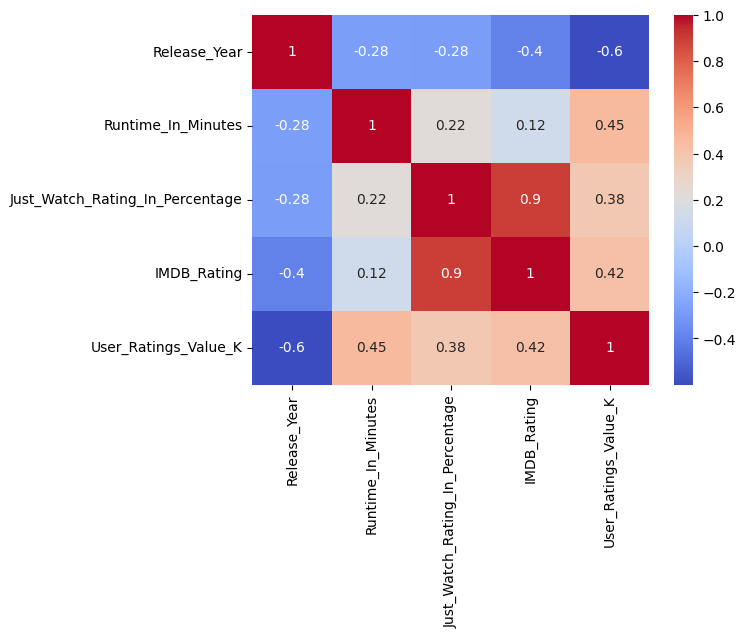

In [ ]:
sns.heatmap(science_fiction_movies.corr(),cmap='coolwarm',annot=True)


In [ ]:
science_fiction_movies
science_fiction_correlation_matrix = science_fiction_movies.corr()
science_fiction_correlation_table = science_fiction_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
science_fiction_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
science_fiction_correlation_table['Correlation Type'] = science_fiction_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
science_fiction_correlation_table['Correlation Strength'] = science_fiction_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


science_fiction_correlation_table


<ipython-input-1404-6d3e2ad613a4>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  science_fiction_correlation_matrix = science_fiction_movies.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.895839,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.895839,Positive,Strong
7,User_Ratings_Value_K,Runtime_In_Minutes,0.453579,Positive,Weak
8,Runtime_In_Minutes,User_Ratings_Value_K,0.453579,Positive,Weak
9,User_Ratings_Value_K,IMDB_Rating,0.420206,Positive,Weak


#Made in Europe Movies Analysis

In [ ]:
europe_movies.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
3047,365 Days,Movie,Tomasz Mandes,2020,2021-2025,Made in Europe,114,110-115,59.0,50-60,3.3,3.1-3.5,93.0,51-100
3052,4 latas,Movie,Gerardo Olivares,2019,2016-2020,Made in Europe,104,100-105,64.0,60-70,5.9,5.6-6.0,3.0,1-50
3089,A Fortunate Man,Movie,Bille August,2018,2016-2020,Made in Europe,162,160-165,76.0,70-80,7.2,7.1-7.5,6.0,1-50
3168,All Good,Movie,Elena Hazanova,2018,2016-2020,Made in Europe,93,90-95,68.0,60-70,6.5,6.6-7.0,1.0,1-50
3189,American Gangster,Movie,Ridley Scott,2007,2006-2010,Made in Europe,157,155-160,84.0,80-90,7.8,7.6-8.0,415.0,401-450


#**78 Made in Europe Movies**

In [ ]:
europe_movies.shape


(78, 14)

In [ ]:
europe_movies.Release_Year_Range.value_counts()


2016-2020    41
2011-2015    12
2006-2010     9
2001-2005     6
2021-2025     5
1996-2000     3
1991-1995     1
nan           1
Name: Release_Year_Range, dtype: int64

In [ ]:
europe_movies.JustWatch_Range.value_counts()


70-80     33
60-70     21
80-90     12
50-60      9
90-100     2
30-40      1
Name: JustWatch_Range, dtype: int64

In [ ]:
europe_movies.IMDB_Range.value_counts()


7.1-7.5    19
6.1-6.5    15
6.6-7.0    12
5.6-6.0     9
7.6-8.0     7
5.1-5.5     6
4.6-5.0     4
8.1-8.5     3
3.1-3.5     1
8.6-9.0     1
nan         1
Name: IMDB_Range, dtype: int64

In [ ]:
europe_movies.UserRatings_Range.value_counts()


1-50       32
51-100     11
151-200     7
101-150     7
nan         6
251-300     4
201-250     3
401-450     2
601-650     2
351-400     2
451-500     1
501-550     1
Name: UserRatings_Range, dtype: int64

In [ ]:
europe_movies.Runtime_Range.value_counts()


95-100     17
100-105    14
110-115    10
115-120     6
105-110     6
90-95       6
120-125     5
135-140     3
85-90       3
130-135     2
80-85       2
125-130     1
155-160     1
145-150     1
160-165     1
180-185     0
185-190     0
190-195     0
195-200     0
200-205     0
205-210     0
210-215     0
215-220     0
220-225     0
225-230     0
170-175     0
230-235     0
235-240     0
165-170     0
240-245     0
175-180     0
0-5         0
150-155     0
140-145     0
10-15       0
15-20       0
20-25       0
25-30       0
30-35       0
35-40       0
40-45       0
45-50       0
50-55       0
55-60       0
60-65       0
65-70       0
70-75       0
75-80       0
5-10        0
245-250     0
Name: Runtime_Range, dtype: int64

#**Made in Europe Movies Summary Statistics**


Release Year:
Count: There are 78 movies in the dataset that are made in Europe.
Mean: The average release year for movies made in Europe is approximately 2012.7.
Standard Deviation: The release years of movies made in Europe vary by approximately 8.7 years.
Minimum: The earliest release year for a movie made in Europe is 1963.
Maximum: The latest release year for a movie made in Europe is 2021.
25th Percentile: 25% of the movies made in Europe were released in or before the year 2009.3.
50th Percentile (Median): 50% of the movies made in Europe were released in or before the year 2016.
75th Percentile: 75% of the movies made in Europe were released in or before the year 2018.

****

Runtime in Minutes:
Mean: The average runtime of movies made in Europe is approximately 107.6 minutes.
Standard Deviation: The runtime of movies made in Europe varies by approximately 16 minutes.
Minimum: The shortest runtime for a movie made in Europe is 83 minutes.
Maximum: The longest runtime for a movie made in Europe is 162 minutes.
25th Percentile: 25% of the movies made in Europe have a runtime of 96.3 minutes or less.
50th Percentile (Median): 50% of the movies made in Europe have a runtime of 104 minutes or less.
75th Percentile: 75% of the movies made in Europe have a runtime of 114.8 minutes or less.

****

Just Watch Rating in Percentage:
Mean: The average Just Watch rating for movies made in Europe is approximately 71.8%.
Standard Deviation: The Just Watch ratings for movies made in Europe vary by approximately 9.6%.
Minimum: The lowest Just Watch rating for a movie made in Europe is 39%.
Maximum: The highest Just Watch rating for a movie made in Europe is 92%.
25th Percentile: 25% of the movies made in Europe have a Just Watch rating of 65.5% or lower.
50th Percentile (Median): 50% of the movies made in Europe have a Just Watch rating of 73% or lower.
75th Percentile: 75% of the movies made in Europe have a Just Watch rating of 78% or lower.

****

IMDb Rating:
Mean: The average IMDb rating for movies made in Europe is approximately 6.4.
Standard Deviation: The IMDb ratings for movies made in Europe vary by approximately 1.2.
Minimum: The lowest IMDb rating for a movie made in Europe is 0 (possibly unrated).
Maximum: The highest IMDb rating for a movie made in Europe is 8.5.
25th Percentile: 25% of the movies made in Europe have an IMDb rating of 5.9 or lower.
50th Percentile (Median): 50% of the movies made in Europe have an IMDb rating of 6.55 or lower.
75th Percentile: 75% of the movies made in Europe have an IMDb rating of 7.2 or lower.

****

User Ratings Value (K):
Mean: The average user ratings value for movies made in Europe is approximately 126.9 thousand.
Standard Deviation: The user ratings values for movies made in Europe vary by approximately 178.2 thousand.
Minimum: The lowest user ratings value for a movie made in Europe is 0 thousand.
Maximum: The highest user ratings value for a movie made in Europe is 1000 thousand.
25th Percentile: 25% of the movies made in Europe have a user ratings value of 8 thousand or lower.
50th Percentile (Median): 50% of the movies made in Europe have a user ratings value of 62 thousand or lower.
75th Percentile: 75% of the movies made in Europe have a user ratings value of 165.5 thousand or lower.

In [ ]:
europe_movies.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,78.000000,78.000000,78.000000,78.000000,78.000000
mean,2012.730769,107.602564,71.794872,6.441026,126.948718
std,8.721779,15.953943,9.602974,1.192230,178.177636
min,1963.000000,83.000000,39.000000,0.000000,0.000000
25%,2009.250000,96.250000,65.500000,5.900000,8.000000
50%,2016.000000,104.000000,73.000000,6.550000,62.000000
75%,2018.000000,114.750000,78.000000,7.200000,165.500000
max,2021.000000,162.000000,92.000000,8.500000,1000.000000


#**Made in Europe Movies Correlation**

Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately -0.200. This indicates a weak negative correlation, suggesting a slight tendency for movies made in Europe released in later years to have slightly shorter runtimes.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.349. This indicates a moderate negative correlation, suggesting a tendency for movies made in Europe released in later years to have slightly lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.323. This indicates a moderate negative correlation, suggesting a tendency for movies made in Europe released in later years to have slightly lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.428. This indicates a moderate negative correlation, suggesting a tendency for movies made in Europe released in later years to have lower user ratings values (in thousands).

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.408. This indicates a moderate positive correlation, suggesting a tendency for movies made in Europe with longer runtimes to have higher Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.339. This indicates a weak positive correlation, suggesting a slight tendency for movies made in Europe with longer runtimes to have slightly higher IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.337. This indicates a weak positive correlation, suggesting a slight tendency for movies made in Europe with longer runtimes to have slightly higher user ratings values (in thousands).

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.924. This indicates a strong positive correlation, suggesting a strong tendency for movies made in Europe with higher Just Watch rating percentages to also have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.561. This indicates a moderate positive correlation, suggesting a tendency for movies made in Europe with higher Just Watch rating percentages to have higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.482. This indicates a moderate positive correlation, suggesting a tendency for movies made in Europe with higher IMDB ratings to have higher user ratings values (in thousands).

In [ ]:
europe_movies.corr()


<ipython-input-1413-64ee2f2c389e>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  europe_movies.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,-0.199579,-0.348622,-0.323151,-0.428323
Runtime_In_Minutes,-0.199579,1.000000,0.408046,0.338777,0.336657
Just_Watch_Rating_In_Percentage,-0.348622,0.408046,1.000000,0.924325,0.560822
IMDB_Rating,-0.323151,0.338777,0.924325,1.000000,0.482231
User_Ratings_Value_K,-0.428323,0.336657,0.560822,0.482231,1.000000


<ipython-input-1414-99c502ff007a>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(europe_movies.corr(),cmap='coolwarm',annot=True)


<Axes: >

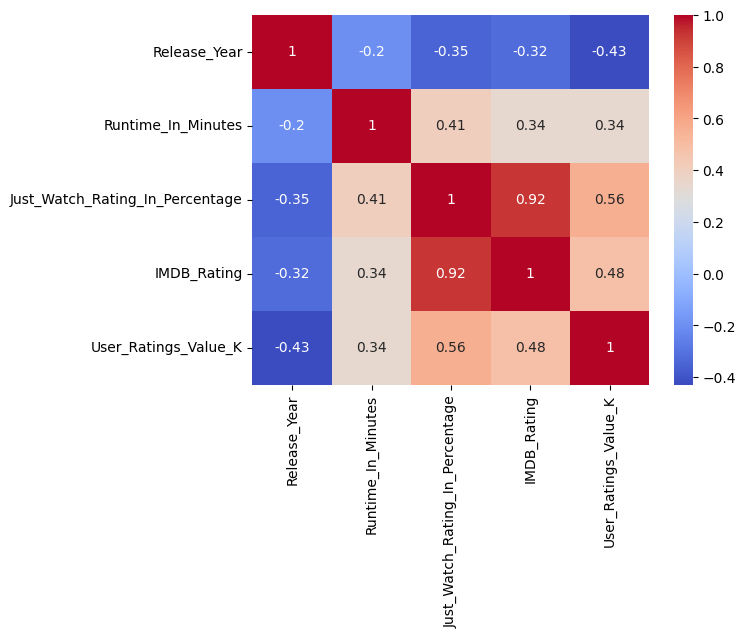

In [ ]:

sns.heatmap(europe_movies.corr(),cmap='coolwarm',annot=True)

In [ ]:

europe_correlation_matrix = europe_movies.corr()
europe_correlation_table = europe_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
europe_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
europe_correlation_table['Correlation Type'] = europe_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
europe_correlation_table['Correlation Strength'] = europe_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


europe_correlation_table


<ipython-input-1415-e792b832d699>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  europe_correlation_matrix = europe_movies.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.924325,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.924325,Positive,Strong
7,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.560822,Positive,Strong
8,Just_Watch_Rating_In_Percentage,User_Ratings_Value_K,0.560822,Positive,Strong
9,IMDB_Rating,User_Ratings_Value_K,0.482231,Positive,Weak


#Animation Movies Analysis

In [ ]:
animation_movies.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
3112,A Shaun the Sheep Movie: Farmageddon,Movie,Will Becher,2019,2016-2020,Animation,86,85-90,75.0,70-80,6.8,6.6-7.0,14.0,1-50
3122,A Whisker Away,Movie,Junichi Sato,2020,2021-2025,Animation,104,100-105,81.0,80-90,6.7,6.6-7.0,11.0,1-50
3184,America: The Motion Picture,Movie,Matt Thompson,2021,2021-2025,Animation,98,95-100,64.0,60-70,5.6,5.6-6.0,6.0,1-50
3212,Animal Crackers,Movie,Tony Bancroft,2017,2016-2020,Animation,105,105-110,67.0,60-70,5.8,5.6-6.0,3.0,1-50
3227,Apollo 10½: A Space Age Childhood,Movie,Richard Linklater,2022,2021-2025,Animation,98,95-100,78.0,70-80,7.2,7.1-7.5,10.0,1-50


#60 Animation Movies

In [ ]:
animation_movies.shape


(60, 14)

In [ ]:
animation_movies.Release_Year_Range.value_counts()


2021-2025    25
2016-2020    21
2011-2015     9
2001-2005     2
1996-2000     1
2006-2010     1
1986-1990     1
Name: Release_Year_Range, dtype: int64

In [ ]:
animation_movies.JustWatch_Range.value_counts()


70-80     30
80-90     14
60-70      9
90-100     3
30-40      2
50-60      2
Name: JustWatch_Range, dtype: int64

In [ ]:
animation_movies.IMDB_Range.value_counts()


6.6-7.0    17
7.1-7.5    12
6.1-6.5    12
5.6-6.0     5
7.6-8.0     4
5.1-5.5     3
8.1-8.5     3
nan         2
8.6-9.0     1
3.1-3.5     1
Name: IMDB_Range, dtype: int64

In [ ]:
animation_movies.UserRatings_Range.value_counts()


1-50       32
51-100      9
151-200     7
101-150     5
nan         4
251-300     1
751-800     1
201-250     1
Name: UserRatings_Range, dtype: int64

In [ ]:
animation_movies.Runtime_Range.value_counts()


95-100     16
90-95       9
85-90       7
100-105     7
105-110     5
115-120     3
80-85       3
70-75       3
110-115     3
65-70       1
0-5         1
40-45       1
45-50       1
190-195     0
185-190     0
180-185     0
175-180     0
170-175     0
165-170     0
195-200     0
155-160     0
200-205     0
205-210     0
210-215     0
215-220     0
220-225     0
225-230     0
230-235     0
235-240     0
240-245     0
160-165     0
125-130     0
150-155     0
145-150     0
10-15       0
15-20       0
20-25       0
25-30       0
30-35       0
35-40       0
50-55       0
55-60       0
60-65       0
75-80       0
120-125     0
5-10        0
130-135     0
135-140     0
140-145     0
245-250     0
Name: Runtime_Range, dtype: int64

#**Animation Movies Summary Statistics**


Release Year:
Count: There are 60 animation movies in the dataset.
Mean: The average release year for animation movies is approximately 2016.8.
Standard Deviation: The release years of animation movies vary by approximately 6.8 years.
Minimum: The earliest release year for an animation movie is 1988.
Maximum: The latest release year for an animation movie is 2023.
25th Percentile: 25% of the animation movies were released in or before the year 2015.
50th Percentile (Median): 50% of the animation movies were released in or before the year 2019.
75th Percentile: 75% of the animation movies were released in or before the year 2022.
****

Runtime in Minutes:
Mean: The average runtime of animation movies is approximately 92.3 minutes.
Standard Deviation: The runtime of animation movies varies by approximately 18.4 minutes.
Minimum: The shortest runtime for an animation movie is 3 minutes.
Maximum: The longest runtime for an animation movie is 119 minutes.
25th Percentile: 25% of the animation movies have a runtime of 87 minutes or less.
50th Percentile (Median): 50% of the animation movies have a runtime of 95 minutes or less.
75th Percentile: 75% of the animation movies have a runtime of 101.5 minutes or less.

****
Just Watch Rating in Percentage:
Mean: The average Just Watch rating for animation movies is approximately 74.6%.
Standard Deviation: The Just Watch ratings for animation movies vary by approximately 10.3%.
Minimum: The lowest Just Watch rating for an animation movie is 37%.
Maximum: The highest Just Watch rating for an animation movie is 98%.
25th Percentile: 25% of the animation movies have a Just Watch rating of 71% or lower.
50th Percentile (Median): 50% of the animation movies have a Just Watch rating of 75% or lower.
75th Percentile: 75% of the animation movies have a Just Watch rating of 80.3% or lower.
****

IMDb Rating:
Mean: The average IMDb rating for animation movies is approximately 6.4.
Standard Deviation: The IMDb ratings for animation movies vary by approximately 1.5.
Minimum: The lowest IMDb rating for an animation movie is 0 (possibly unrated).
Maximum: The highest IMDb rating for an animation movie is 8.5.
25th Percentile: 25% of the animation movies have an IMDb rating of 6.3 or lower.
50th Percentile (Median): 50% of the animation movies have an IMDb rating of 6.6 or lower.
75th Percentile: 75% of the animation movies have an IMDb rating of 7.1 or lower.

****
User Ratings Value (K):
Mean: The average user ratings value for animation movies is approximately 70 thousand.
Standard Deviation: The user ratings values for animation movies vary by approximately 114.4 thousand.
Minimum: The lowest user ratings value for an animation movie is 0 thousand.
Maximum: The highest user ratings value for an animation movie is 760 thousand.
25th Percentile: 25% of the animation movies have a user ratings value of 5.8 thousand or lower.
50th Percentile (Median): 50% of the animation movies have a user ratings value of 20 thousand or lower.
75th Percentile: 75% of the animation movies have a user ratings value of 100 thousand or lower.

In [ ]:
animation_movies.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,60.000000,60.000000,60.000000,60.000000,60.000000
mean,2016.833333,92.250000,74.550000,6.416667,69.950000
std,6.750183,18.393648,10.312778,1.473859,114.371596
min,1988.000000,3.000000,37.000000,0.000000,0.000000
25%,2015.000000,87.000000,71.000000,6.300000,5.750000
50%,2019.000000,95.000000,75.000000,6.600000,20.000000
75%,2022.000000,101.500000,80.250000,7.125000,100.000000
max,2023.000000,119.000000,98.000000,8.500000,760.000000


#**Animation Movies Correlation**


Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately 0.284. This indicates a moderate positive correlation, suggesting a tendency for animation movies released in later years to have slightly longer runtimes.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately 0.013. This indicates a very weak positive correlation, suggesting no significant relationship between the release year and Just Watch rating percentages for animation movies.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.076. This indicates a very weak negative correlation, suggesting no significant relationship between the release year and IMDB ratings for animation movies.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.430. This indicates a moderate negative correlation, suggesting a tendency for animation movies released in later years to have slightly lower user ratings values (in thousands).

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.591. This indicates a strong positive correlation, suggesting a tendency for animation movies with longer runtimes to have higher Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.634. This indicates a strong positive correlation, suggesting a tendency for animation movies with longer runtimes to have higher IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.059. This indicates a very weak positive correlation, suggesting no significant relationship between the runtime and user ratings values (in thousands) for animation movies.

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.944. This indicates a strong positive correlation, suggesting a strong tendency for animation movies with higher Just Watch rating percentages to also have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.244. This indicates a weak positive correlation, suggesting a slight tendency for animation movies with higher Just Watch rating percentages to have slightly higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.278. This indicates a weak positive correlation, suggesting a slight tendency for animation movies with higher IMDB ratings to have slightly higher user ratings values (in thousands).

In [ ]:
animation_movies.corr()


<ipython-input-1424-35ce39e78837>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  animation_movies.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,0.283600,0.013026,-0.075528,-0.430178
Runtime_In_Minutes,0.283600,1.000000,0.590952,0.633929,0.059409
Just_Watch_Rating_In_Percentage,0.013026,0.590952,1.000000,0.943771,0.244154
IMDB_Rating,-0.075528,0.633929,0.943771,1.000000,0.277850
User_Ratings_Value_K,-0.430178,0.059409,0.244154,0.277850,1.000000


<ipython-input-1425-3aebcb09fd6e>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(animation_movies.corr(),cmap='coolwarm',annot=True)


<Axes: >

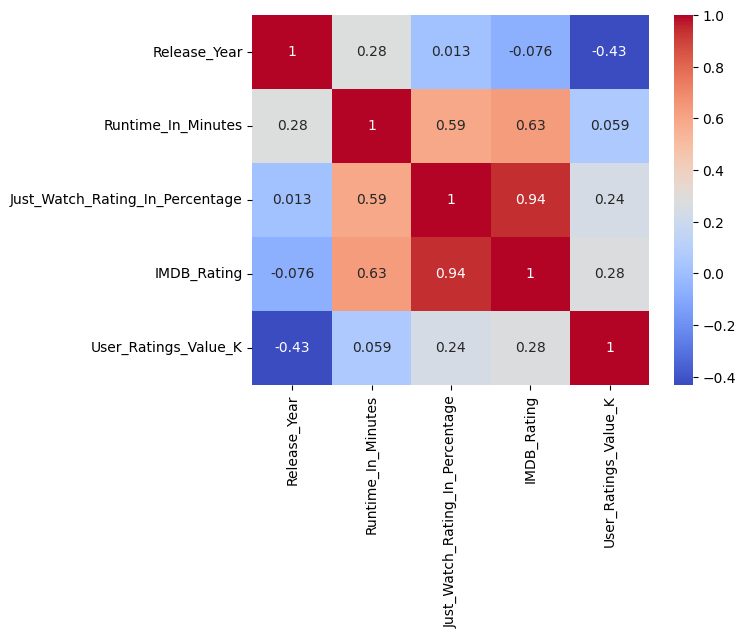

In [ ]:

sns.heatmap(animation_movies.corr(),cmap='coolwarm',annot=True)

In [ ]:

animation_correlation_matrix = animation_movies.corr()
animation_correlation_table = animation_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
animation_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
animation_correlation_table['Correlation Type'] = animation_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
animation_correlation_table['Correlation Strength'] = animation_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


animation_correlation_table


<ipython-input-1426-4280235cf645>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  animation_correlation_matrix = animation_movies.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.943771,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.943771,Positive,Strong
7,IMDB_Rating,Runtime_In_Minutes,0.633929,Positive,Strong
8,Runtime_In_Minutes,IMDB_Rating,0.633929,Positive,Strong
9,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,0.590952,Positive,Strong


# History Movies Analysis

In [ ]:
history_movies.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
3040,12 Strong,Movie,Nicolai Fuglsig,2018,2016-2020,History,130,130-135,71.0,70-80,6.5,6.6-7.0,86.0,51-100
3058,47 Ronin,Movie,Carl Rinsch,2013,2011-2015,History,119,115-120,69.0,60-70,6.2,6.1-6.5,165.0,151-200
3062,83,Movie,Kabir Khan,2021,2021-2025,History,163,160-165,79.0,70-80,7.5,7.6-8.0,39.0,1-50
3102,A Man of Action,Movie,Javier Ruiz Caldera,2022,2021-2025,History,111,110-115,72.0,70-80,6.3,6.1-6.5,2.0,1-50
3145,Against the Ice,Movie,Peter Flinth,2022,2021-2025,History,102,100-105,74.0,70-80,6.5,6.6-7.0,25.0,1-50


# 51 History Movies

In [ ]:
history_movies.shape


(51, 14)

In [ ]:
history_movies.Release_Year_Range.value_counts()


2021-2025    27
2016-2020    15
2006-2010     5
2011-2015     2
2001-2005     1
1996-2000     1
Name: Release_Year_Range, dtype: int64

In [ ]:
history_movies.JustWatch_Range.value_counts()


70-80    31
80-90    16
60-70     4
Name: JustWatch_Range, dtype: int64

In [ ]:
history_movies.IMDB_Range.value_counts()


7.1-7.5    18
6.6-7.0    16
7.6-8.0     8
6.1-6.5     5
8.1-8.5     2
5.6-6.0     1
5.1-5.5     1
Name: IMDB_Range, dtype: int64

In [ ]:
history_movies.UserRatings_Range.value_counts()


1-50       33
51-100      5
151-200     3
101-150     3
201-250     2
401-450     2
601-650     1
301-350     1
nan         1
Name: UserRatings_Range, dtype: int64

In [ ]:
history_movies.Runtime_Range.value_counts()


105-110    9
110-115    8
95-100     7
120-125    4
115-120    4
135-140    3
100-105    3
140-145    2
130-135    2
125-130    1
75-80      1
155-160    1
145-150    1
85-90      1
160-165    1
70-75      1
65-70      1
205-210    1
175-180    0
240-245    0
170-175    0
235-240    0
230-235    0
225-230    0
220-225    0
215-220    0
165-170    0
210-215    0
200-205    0
195-200    0
190-195    0
180-185    0
185-190    0
0-5        0
150-155    0
5-10       0
90-95      0
80-85      0
60-65      0
55-60      0
50-55      0
45-50      0
40-45      0
35-40      0
30-35      0
25-30      0
20-25      0
15-20      0
10-15      0
245-250    0
Name: Runtime_Range, dtype: int64

#**History Movies Summary Statistics**

Release Year:
Count: There are 51 history movies in the dataset.
Mean: The average release year for history movies is approximately 2017.8.
Standard Deviation: The release years of history movies vary by approximately 6.0 years.
Minimum: The earliest release year for a history movie is 1997.
Maximum: The latest release year for a history movie is 2023.
25th Percentile: 25% of the history movies were released in or before the year 2017.
50th Percentile (Median): 50% of the history movies were released in or before the year 2020.
75th Percentile: 75% of the history movies were released in or before the year 2022.

****
Runtime in Minutes:
Mean: The average runtime of history movies is approximately 115.2 minutes.
Standard Deviation: The runtime of history movies varies by approximately 23.4 minutes.
Minimum: The shortest runtime for a history movie is 69 minutes.
Maximum: The longest runtime for a history movie is 209 minutes.
25th Percentile: 25% of the history movies have a runtime of 103 minutes or less.
50th Percentile (Median): 50% of the history movies have a runtime of 111 minutes or less.
75th Percentile: 75% of the history movies have a runtime of 123.5 minutes or less.

****
Just Watch Rating in Percentage:
Mean: The average Just Watch rating for history movies is approximately 77.0%.
Standard Deviation: The Just Watch ratings for history movies vary by approximately 5.5%.
Minimum: The lowest Just Watch rating for a history movie is 62%.
Maximum: The highest Just Watch rating for a history movie is 88%.
25th Percentile: 25% of the history movies have a Just Watch rating of 74% or lower.
50th Percentile (Median): 50% of the history movies have a Just Watch rating of 78% or lower.
75th Percentile: 75% of the history movies have a Just Watch rating of 81% or lower.

****
IMDb Rating:
Mean: The average IMDb rating for history movies is approximately 7.0.
Standard Deviation: The IMDb ratings for history movies vary by approximately 0.6.
Minimum: The lowest IMDb rating for a history movie is 5.4.
Maximum: The highest IMDb rating for a history movie is 8.3.
25th Percentile: 25% of the history movies have an IMDb rating of 6.7 or lower.
50th Percentile (Median): 50% of the history movies have an IMDb rating of 7.0.
75th Percentile: 75% of the history movies have an IMDb rating of 7.4 or lower.

****
User Ratings Value (K):
Mean: The average user ratings value for history movies is approximately 78.1 thousand.
Standard Deviation: The user ratings values for history movies vary by approximately 126.4 thousand.
Minimum: The lowest user ratings value for a history movie is 0 thousand.
Maximum: The highest user ratings value for a history movie is 619 thousand.
25th Percentile: 25% of the history movies have a user ratings value of 7 thousand or lower.
50th Percentile (Median): 50% of the history movies have a user ratings value of 25 thousand or lower.
75th Percentile: 75% of the history movies have a user ratings value of 81 thousand or lower.

In [ ]:
history_movies.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,51.000000,51.000000,51.000000,51.000000,51.000000
mean,2017.843137,115.156863,77.019608,7.000000,78.098039
std,5.997908,23.351550,5.493597,0.573411,126.364434
min,1997.000000,69.000000,62.000000,5.400000,0.000000
25%,2017.000000,103.000000,74.000000,6.700000,7.000000
50%,2020.000000,111.000000,78.000000,7.000000,25.000000
75%,2022.000000,123.500000,81.000000,7.400000,81.000000
max,2023.000000,209.000000,88.000000,8.300000,619.000000


#**History Movies Correlation**


Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately -0.195. This indicates a weak negative correlation, suggesting a slight tendency for history movies released in later years to have slightly shorter runtimes.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.142. This indicates a weak negative correlation, suggesting a slight tendency for history movies released in later years to have slightly lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.231. This indicates a weak negative correlation, suggesting a slight tendency for history movies released in later years to have slightly lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.492. This indicates a moderate negative correlation, suggesting a tendency for history movies released in later years to have slightly lower user ratings values (in thousands).

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.324. This indicates a moderate positive correlation, suggesting a tendency for history movies with longer runtimes to have higher Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.363. This indicates a moderate positive correlation, suggesting a tendency for history movies with longer runtimes to have higher IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.472. This indicates a moderate positive correlation, suggesting a tendency for history movies with longer runtimes to have higher user ratings values (in thousands).

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.905. This indicates a strong positive correlation, suggesting a strong tendency for history movies with higher Just Watch rating percentages to also have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.386. This indicates a weak positive correlation, suggesting a slight tendency for history movies with higher Just Watch rating percentages to have slightly higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.432. This indicates a weak positive correlation, suggesting a slight tendency for history movies with higher IMDB ratings to have slightly higher user ratings values (in thousands).

In [ ]:
history_movies.corr()


<ipython-input-1435-0fe12f4381ec>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  history_movies.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,-0.195308,-0.141938,-0.231445,-0.491982
Runtime_In_Minutes,-0.195308,1.000000,0.323632,0.362508,0.471696
Just_Watch_Rating_In_Percentage,-0.141938,0.323632,1.000000,0.905372,0.386200
IMDB_Rating,-0.231445,0.362508,0.905372,1.000000,0.431666
User_Ratings_Value_K,-0.491982,0.471696,0.386200,0.431666,1.000000


<ipython-input-1436-82cd3b1a4b04>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(history_movies.corr(),cmap='coolwarm',annot=True)


<Axes: >

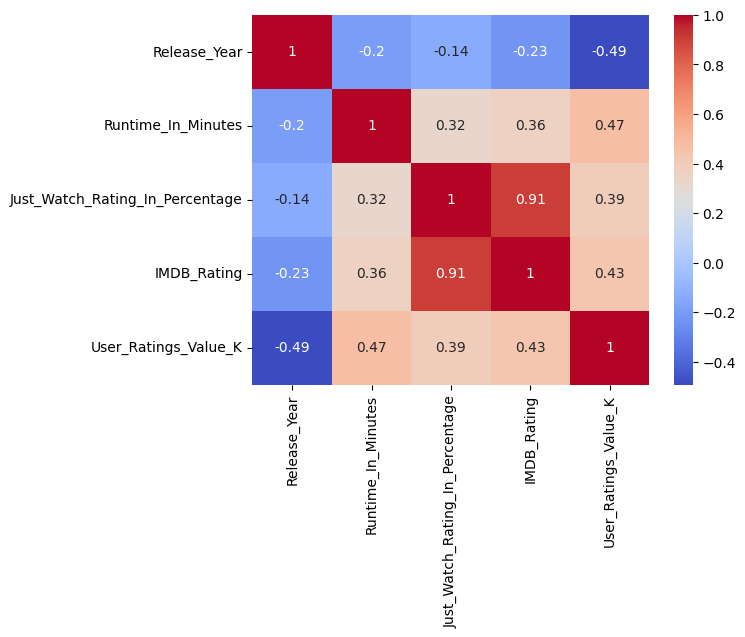

In [ ]:

sns.heatmap(history_movies.corr(),cmap='coolwarm',annot=True)

In [ ]:

history_correlation_matrix = history_movies.corr()
history_correlation_table = history_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
history_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
history_correlation_table['Correlation Type'] = history_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
history_correlation_table['Correlation Strength'] = history_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


history_correlation_table


<ipython-input-1437-ff2076bbb453>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  history_correlation_matrix = history_movies.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.905372,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.905372,Positive,Strong
7,User_Ratings_Value_K,Runtime_In_Minutes,0.471696,Positive,Weak
8,Runtime_In_Minutes,User_Ratings_Value_K,0.471696,Positive,Weak
9,User_Ratings_Value_K,IMDB_Rating,0.431666,Positive,Weak


# Sports Movies Analysis

In [ ]:
sport_movies.head()

,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
3044,14 Peaks: Nothing Is Impossible,Movie,Torquil Jones,2021,2021-2025,Sport,101,100-105,82.0,80-90,7.7,7.6-8.0,27.0,1-50
3063,83,Movie,Kabir Khan,2021,2021-2025,Sport,163,160-165,79.0,70-80,7.5,7.6-8.0,39.0,1-50
3096,A League of Their Own,Movie,Penny Marshall,1992,1991-1995,Sport,128,125-130,79.0,70-80,7.3,7.1-7.5,115.0,101-150
3178,Amateur,Movie,Ryan Koo,2018,2016-2020,Sport,96,95-100,68.0,60-70,5.9,5.6-6.0,4.0,1-50
3209,Anek,Movie,Anubhav Sinha,2022,2021-2025,Sport,146,145-150,69.0,60-70,6.5,6.6-7.0,22.0,1-50


#42 Sport Movies

In [ ]:
sport_movies.shape


(42, 14)

In [ ]:
sport_movies.Release_Year_Range.value_counts()


2021-2025    23
2016-2020     5
1975-1980     3
1991-1995     2
2001-2005     2
2006-2010     2
2011-2015     2
1996-2000     1
1981-1985     1
1986-1990     1
Name: Release_Year_Range, dtype: int64

In [ ]:
sport_movies.JustWatch_Range.value_counts()


70-80    17
80-90    15
60-70     9
50-60     1
Name: JustWatch_Range, dtype: int64

In [ ]:
sport_movies.IMDB_Range.value_counts()


7.1-7.5    13
7.6-8.0     7
6.6-7.0     7
5.6-6.0     6
6.1-6.5     4
8.1-8.5     3
5.1-5.5     1
3.1-3.5     1
Name: IMDB_Range, dtype: int64

In [ ]:
sport_movies.UserRatings_Range.value_counts()


1-50       27
201-250     4
101-150     3
51-100      3
251-300     1
nan         1
551-600     1
451-500     1
151-200     1
Name: UserRatings_Range, dtype: int64

In [ ]:
sport_movies.Runtime_Range.value_counts()


95-100     6
115-120    5
100-105    5
105-110    4
120-125    3
125-130    2
75-80      2
145-150    2
135-140    2
130-135    2
110-115    2
65-70      2
90-95      1
85-90      1
160-165    1
70-75      1
25-30      1
195-200    0
200-205    0
205-210    0
210-215    0
215-220    0
220-225    0
225-230    0
165-170    0
185-190    0
230-235    0
235-240    0
180-185    0
240-245    0
175-180    0
170-175    0
190-195    0
0-5        0
155-160    0
150-155    0
140-145    0
5-10       0
80-85      0
60-65      0
55-60      0
50-55      0
45-50      0
40-45      0
35-40      0
30-35      0
20-25      0
15-20      0
10-15      0
245-250    0
Name: Runtime_Range, dtype: int64

# **Sport Movies Summary Statistics**

Release Year:
Count: There are 42 sports movies in the dataset.
Mean: The average release year for sports movies is approximately 2011.8.
Standard Deviation: The release years of sports movies vary by approximately 14.7 years.
Minimum: The earliest release year for a sports movie is 1976.
Maximum: The latest release year for a sports movie is 2023.
25th Percentile: 25% of the sports movies were released in or before the year 2005.2.
50th Percentile (Median): 50% of the sports movies were released in or before the year 2020.
75th Percentile: 75% of the sports movies were released in or before the year 2022.

****

Runtime in Minutes:
Mean: The average runtime of sports movies is approximately 107.8 minutes.
Standard Deviation: The runtime of sports movies varies by approximately 24.9 minutes.
Minimum: The shortest runtime for a sports movie is 27 minutes.
Maximum: The longest runtime for a sports movie is 163 minutes.
25th Percentile: 25% of the sports movies have a runtime of 96.2 minutes or less.
50th Percentile (Median): 50% of the sports movies have a runtime of 106 minutes or less.
75th Percentile: 75% of the sports movies have a runtime of 122.8 minutes or less.

****

Just Watch Rating in Percentage:
Mean: The average Just Watch rating for sports movies is approximately 75.9%.
Standard Deviation: The Just Watch ratings for sports movies vary by approximately 7.3%.
Minimum: The lowest Just Watch rating for a sports movie is 54%.
Maximum: The highest Just Watch rating for a sports movie is 88%.
25th Percentile: 25% of the sports movies have a Just Watch rating of 71.3% or lower.
50th Percentile (Median): 50% of the sports movies have a Just Watch rating of 78% or lower.
75th Percentile: 75% of the sports movies have a Just Watch rating of 80.8% or lower.

****

IMDb Rating:
Mean: The average IMDb rating for sports movies is approximately 6.8.
Standard Deviation: The IMDb ratings for sports movies vary by approximately 0.9.
Minimum: The lowest IMDb rating for a sports movie is 3.1.
Maximum: The highest IMDb rating for a sports movie is 8.1.
25th Percentile: 25% of the sports movies have an IMDb rating of 6.2 or lower.
50th Percentile (Median): 50% of the sports movies have an IMDb rating of 7.2 or lower.
75th Percentile: 75% of the sports movies have an IMDb rating of 7.4 or lower.

****

User Ratings Value (K):
Mean: The average user ratings value for sports movies is approximately 80.3 thousand.
Standard Deviation: The user ratings values for sports movies vary by approximately 131.0 thousand.
Minimum: The lowest user ratings value for a sports movie is 0 thousand.
Maximum: The highest user ratings value for a sports movie is 599 thousand.
25th Percentile: 25% of the sports movies have a user ratings value of 4.5 thousand or lower.
50th Percentile (Median): 50% of the sports movies have a user ratings value of 23 thousand or lower.
75th Percentile: 75% of the sports movies have a user ratings value of 102.5 thousand or lower.

In [ ]:
sport_movies.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,42.000000,42.000000,42.000000,42.000000,42.000000
mean,2011.833333,107.785714,75.928571,6.835714,80.309524
std,14.710071,24.866017,7.336487,0.951461,131.031273
min,1976.000000,27.000000,54.000000,3.100000,0.000000
25%,2005.250000,96.250000,71.250000,6.225000,4.500000
50%,2020.000000,106.000000,78.000000,7.150000,23.000000
75%,2022.000000,122.750000,80.750000,7.400000,102.500000
max,2023.000000,163.000000,88.000000,8.100000,599.000000


#**Sport Movies Correlation**


Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately -0.168. This indicates a weak negative correlation, suggesting a slight tendency for sport movies released in later years to have slightly shorter runtimes.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.032. This indicates a weak negative correlation, suggesting a slight tendency for sport movies released in later years to have slightly lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.071. This indicates a weak negative correlation, suggesting a slight tendency for sport movies released in later years to have slightly lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.605. This indicates a moderate negative correlation, suggesting a tendency for sport movies released in later years to have slightly lower user ratings values (in thousands).

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.170. This indicates a weak positive correlation, suggesting a slight tendency for sport movies with longer runtimes to have higher Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.194. This indicates a weak positive correlation, suggesting a slight tendency for sport movies with longer runtimes to have higher IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.280. This indicates a weak positive correlation, suggesting a slight tendency for sport movies with longer runtimes to have slightly higher user ratings values (in thousands).

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.953. This indicates a strong positive correlation, suggesting a strong tendency for sport movies with higher Just Watch rating percentages to also have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.347. This indicates a weak positive correlation, suggesting a slight tendency for sport movies with higher Just Watch rating percentages to have slightly higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.315. This indicates a weak positive correlation, suggesting a slight tendency for sport movies with higher IMDB ratings to have slightly higher user ratings values (in thousands).


In [ ]:
sport_movies.corr()


<ipython-input-1446-84e49c273747>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sport_movies.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,-0.168000,-0.031527,-0.071013,-0.604870
Runtime_In_Minutes,-0.168000,1.000000,0.169709,0.194038,0.279845
Just_Watch_Rating_In_Percentage,-0.031527,0.169709,1.000000,0.953219,0.346832
IMDB_Rating,-0.071013,0.194038,0.953219,1.000000,0.315021
User_Ratings_Value_K,-0.604870,0.279845,0.346832,0.315021,1.000000


<ipython-input-1447-c84f4a1a0f48>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(sport_movies.corr(),cmap='coolwarm',annot=True)


<Axes: >

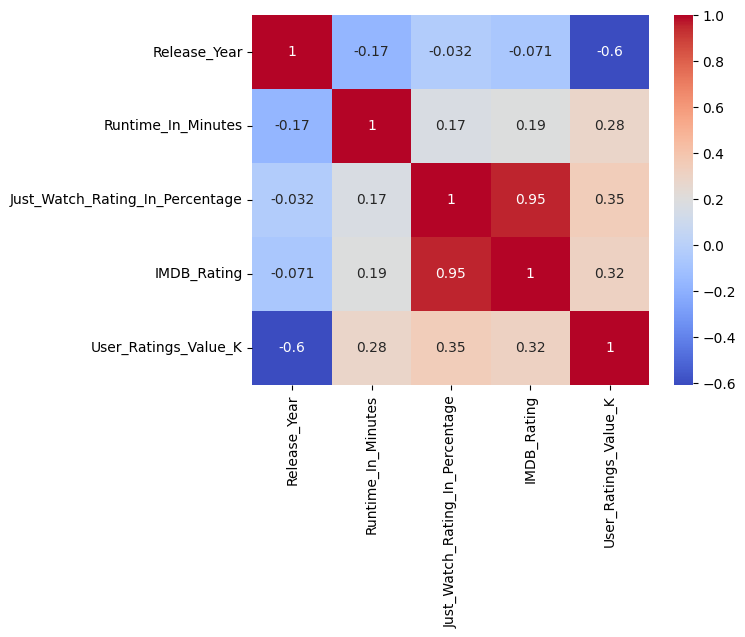

In [ ]:

sns.heatmap(sport_movies.corr(),cmap='coolwarm',annot=True)


In [ ]:
sport_movies
sport_correlation_matrix = sport_movies.corr()
sport_correlation_table = sport_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
sport_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
sport_correlation_table['Correlation Type'] = sport_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
sport_correlation_table['Correlation Strength'] = sport_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


sport_correlation_table


<ipython-input-1448-4ad251e7d78e>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sport_correlation_matrix = sport_movies.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.953219,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.953219,Positive,Strong
7,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.346832,Positive,Weak
8,Just_Watch_Rating_In_Percentage,User_Ratings_Value_K,0.346832,Positive,Weak
9,IMDB_Rating,User_Ratings_Value_K,0.315021,Positive,Weak


# Musical Movies Analysis

In [ ]:
musical_movies.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
3037,11:11,Movie,Karim Abouzeid,2015,2016-2020,Music & Musical,60,60-65,43.0,40-50,6.7,6.6-7.0,0.0,nan
3064,A Beautiful Life,Movie,Mehdi Avaz,2023,2021-2025,Music & Musical,98,95-100,44.0,40-50,0.0,nan,0.0,nan
3129,Adam Sandler: 100% Fresh,Movie,Steven Brill,2018,2016-2020,Music & Musical,73,70-75,80.0,80-90,7.5,7.6-8.0,5.0,1-50
3302,Begin Again,Movie,John Carney,2013,2011-2015,Music & Musical,104,100-105,80.0,80-90,7.4,7.1-7.5,161.0,151-200
3365,Bo Burnham: Inside,Movie,Bo Burnham,2021,2021-2025,Music & Musical,87,85-90,91.0,90-100,8.7,8.6-9.0,44.0,1-50


# 41 Musical Movies

In [ ]:
musical_movies.shape


(41, 14)

In [ ]:
musical_movies.Release_Year_Range.value_counts()


2016-2020    20
2021-2025    18
2011-2015     2
2006-2010     1
Name: Release_Year_Range, dtype: int64

In [ ]:
musical_movies.JustWatch_Range.value_counts()


70-80     20
80-90     12
60-70      5
40-50      2
90-100     1
30-40      1
Name: JustWatch_Range, dtype: int64

In [ ]:
musical_movies.IMDB_Range.value_counts()


6.6-7.0    10
7.1-7.5    10
7.6-8.0     7
6.1-6.5     6
5.6-6.0     4
nan         2
8.6-9.0     1
8.1-8.5     1
Name: IMDB_Range, dtype: int64

In [ ]:
musical_movies.UserRatings_Range.value_counts()


1-50       28
51-100      5
nan         4
151-200     1
101-150     1
601-650     1
301-350     1
Name: UserRatings_Range, dtype: int64

In [ ]:
musical_movies.Runtime_Range.value_counts()


90-95      7
85-90      6
115-120    5
95-100     4
110-115    3
100-105    3
125-130    2
120-125    2
60-65      2
70-75      1
145-150    1
140-145    1
135-140    1
80-85      1
65-70      1
40-45      1
225-230    0
175-180    0
240-245    0
235-240    0
230-235    0
180-185    0
185-190    0
220-225    0
195-200    0
215-220    0
190-195    0
210-215    0
205-210    0
200-205    0
165-170    0
170-175    0
0-5        0
160-165    0
45-50      0
10-15      0
15-20      0
20-25      0
25-30      0
30-35      0
35-40      0
50-55      0
155-160    0
55-60      0
75-80      0
105-110    0
5-10       0
130-135    0
150-155    0
245-250    0
Name: Runtime_Range, dtype: int64

#**Musical Movies Summary Statistics**

Release Year:
Count: There are 41 musical movies in the dataset.
Mean: The average release year for musical movies is approximately 2018.7.
Standard Deviation: The release years of musical movies vary by approximately 3.4 years.
Minimum: The earliest release year for a musical movie is 2007.
Maximum: The latest release year for a musical movie is 2023.
25th Percentile: 25% of the musical movies were released in or before the year 2016.
50th Percentile (Median): 50% of the musical movies were released in or before the year 2019.
75th Percentile: 75% of the musical movies were released in or before the year 2021.

****
Runtime in Minutes:
Mean: The average runtime of musical movies is approximately 99.6 minutes.
Standard Deviation: The runtime of musical movies varies by approximately 22.4 minutes.
Minimum: The shortest runtime for a musical movie is 40 minutes.
Maximum: The longest runtime for a musical movie is 146 minutes.
25th Percentile: 25% of the musical movies have a runtime of 89 minutes or less.
50th Percentile (Median): 50% of the musical movies have a runtime of 96 minutes or less.
75th Percentile: 75% of the musical movies have a runtime of 115 minutes or less.

****
Just Watch Rating in Percentage:
Mean: The average Just Watch rating for musical movies is approximately 74.2%.
Standard Deviation: The Just Watch ratings for musical movies vary by approximately 11.2%.
Minimum: The lowest Just Watch rating for a musical movie is 37%.
Maximum: The highest Just Watch rating for a musical movie is 91%.
25th Percentile: 25% of the musical movies have a Just Watch rating of 71% or lower.
50th Percentile (Median): 50% of the musical movies have a Just Watch rating of 75% or lower.
75th Percentile: 75% of the musical movies have a Just Watch rating of 80% or lower.

****
IMDb Rating:
Mean: The average IMDb rating for musical movies is approximately 6.6.
Standard Deviation: The IMDb ratings for musical movies vary by approximately 1.7.
Minimum: The lowest IMDb rating for a musical movie is 0.
Maximum: The highest IMDb rating for a musical movie is 8.7.
25th Percentile: 25% of the musical movies have an IMDb rating of 6.4 or lower.
50th Percentile (Median): 50% of the musical movies have an IMDb rating of 6.7 or lower.
75th Percentile: 75% of the musical movies have an IMDb rating of 7.4 or lower.

****
User Ratings Value (K):
Mean: The average user ratings value for musical movies is approximately 45.2 thousand.
Standard Deviation: The user ratings values for musical movies vary by approximately 109.1 thousand.
Minimum: The lowest user ratings value for a musical movie is 0 thousand.
Maximum: The highest user ratings value for a musical movie is 616 thousand.
25th Percentile: 25% of the musical movies have a user ratings value of 1 thousand or lower.
50th Percentile (Median): 50% of the musical movies have a user ratings value of 5 thousand or lower.
75th Percentile: 75% of the musical movies have a user ratings value of 42 thousand or lower.

In [ ]:
musical_movies.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,41.000000,41.000000,41.000000,41.000000,41.000000
mean,2018.658537,99.585366,74.195122,6.568293,45.170732
std,3.395657,22.394168,11.180831,1.650824,109.115055
min,2007.000000,40.000000,37.000000,0.000000,0.000000
25%,2016.000000,89.000000,71.000000,6.400000,1.000000
50%,2019.000000,96.000000,75.000000,6.700000,5.000000
75%,2021.000000,115.000000,80.000000,7.400000,42.000000
max,2023.000000,146.000000,91.000000,8.700000,616.000000


# **Musical Movies Correlation**


Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately 0.047. This indicates a very weak positive correlation, suggesting no significant relationship between the release year and the runtime of musical movies.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately 0.134. This indicates a weak positive correlation, suggesting a slight tendency for musical movies released in later years to have slightly higher Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.049. This indicates a very weak negative correlation, suggesting no significant relationship between the release year and the IMDB ratings of musical movies.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.348. This indicates a moderate negative correlation, suggesting a tendency for musical movies released in later years to have slightly lower user ratings values (in thousands).

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.481. This indicates a moderate positive correlation, suggesting a tendency for musical movies with longer runtimes to have higher Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.356. This indicates a moderate positive correlation, suggesting a tendency for musical movies with longer runtimes to have higher IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.265. This indicates a weak positive correlation, suggesting a slight tendency for musical movies with longer runtimes to have slightly higher user ratings values (in thousands).

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.843. This indicates a strong positive correlation, suggesting a strong tendency for musical movies with higher Just Watch rating percentages to also have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.240. This indicates a weak positive correlation, suggesting a slight tendency for musical movies with higher Just Watch rating percentages to have slightly higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.180. This indicates a weak positive correlation, suggesting a slight tendency for musical movies with higher IMDB ratings to have slightly higher user ratings values (in thousands).

In [ ]:
musical_movies.corr()


<ipython-input-1457-00cc92475be2>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  musical_movies.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,0.047406,0.134153,-0.049254,-0.348405
Runtime_In_Minutes,0.047406,1.000000,0.481190,0.355746,0.265137
Just_Watch_Rating_In_Percentage,0.134153,0.481190,1.000000,0.842816,0.239809
IMDB_Rating,-0.049254,0.355746,0.842816,1.000000,0.180137
User_Ratings_Value_K,-0.348405,0.265137,0.239809,0.180137,1.000000


<ipython-input-1458-53e851dbda53>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(musical_movies.corr(),cmap='coolwarm',annot=True)


<Axes: >

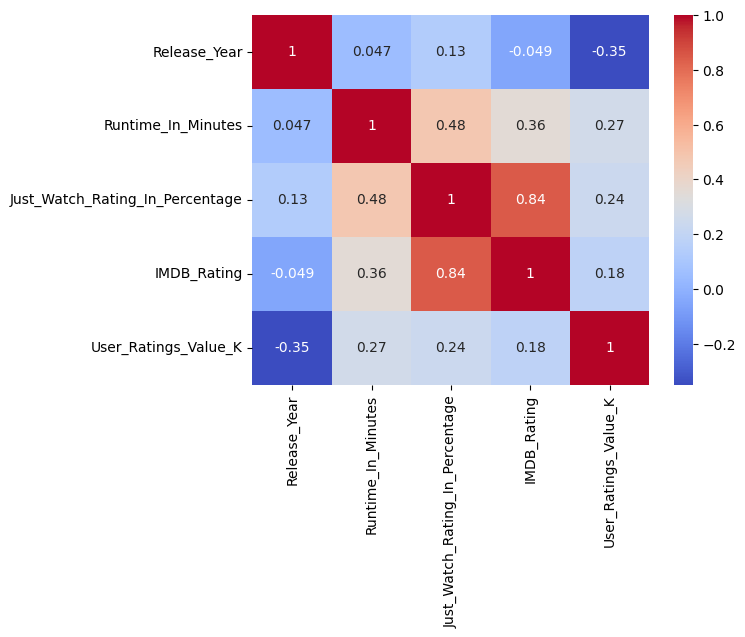

In [ ]:

sns.heatmap(musical_movies.corr(),cmap='coolwarm',annot=True)


In [ ]:

musical_correlation_matrix = musical_movies.corr()
musical_correlation_table = musical_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
musical_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
musical_correlation_table['Correlation Type'] = musical_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
musical_correlation_table['Correlation Strength'] = musical_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


musical_correlation_table


<ipython-input-1459-edf443be701d>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  musical_correlation_matrix = musical_movies.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.842816,Positive,Strong
6,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.842816,Positive,Strong
7,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,0.481190,Positive,Weak
8,Just_Watch_Rating_In_Percentage,Runtime_In_Minutes,0.481190,Positive,Weak
9,IMDB_Rating,Runtime_In_Minutes,0.355746,Positive,Weak


# War and Military Movies Analysis

In [ ]:
war_military_movies.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
3041,12 Strong,Movie,Nicolai Fuglsig,2018,2016-2020,War & Military,130,130-135,71.0,70-80,6.5,6.6-7.0,86.0,51-100
3070,A Call to Spy,Movie,Lydia Dean Pilcher,2019,2016-2020,War & Military,123,120-125,74.0,70-80,6.6,6.6-7.0,8.0,1-50
3170,All Quiet on the Western Front,Movie,Edward Berger,2022,2021-2025,War & Military,147,145-150,87.0,80-90,7.8,7.6-8.0,204.0,201-250
3183,America: The Motion Picture,Movie,Matt Thompson,2021,2021-2025,War & Military,98,95-100,64.0,60-70,5.6,5.6-6.0,6.0,1-50
3241,Army of the Dead,Movie,Zack Snyder,2021,2021-2025,War & Military,148,145-150,68.0,60-70,5.7,5.6-6.0,178.0,151-200


#39 War and Military Movies

In [ ]:
war_military_movies.shape


(39, 14)

In [ ]:
war_military_movies.Release_Year_Range.value_counts()


2016-2020    14
2021-2025    13
2011-2015     4
2006-2010     3
2001-2005     2
1986-1990     1
1991-1995     1
1996-2000     1
Name: Release_Year_Range, dtype: int64

In [ ]:
war_military_movies.JustWatch_Range.value_counts()


70-80    20
80-90    12
60-70     6
40-50     1
Name: JustWatch_Range, dtype: int64

In [ ]:
war_military_movies.IMDB_Range.value_counts()


6.6-7.0    13
7.1-7.5    12
7.6-8.0     5
5.6-6.0     5
8.1-8.5     2
6.1-6.5     1
5.1-5.5     1
Name: IMDB_Range, dtype: int64

In [ ]:
war_military_movies.UserRatings_Range.value_counts()


1-50       17
151-200     6
nan         4
101-150     4
201-250     3
51-100      2
401-450     1
601-650     1
301-350     1
Name: UserRatings_Range, dtype: int64

In [ ]:
war_military_movies.Runtime_Range.value_counts()


120-125    7
110-115    6
105-110    5
95-100     4
90-95      2
145-150    2
155-160    2
140-145    2
135-140    2
130-135    2
100-105    2
125-130    1
25-30      1
15-20      1
170-175    0
175-180    0
165-170    0
185-190    0
180-185    0
190-195    0
195-200    0
200-205    0
205-210    0
210-215    0
215-220    0
220-225    0
225-230    0
230-235    0
235-240    0
240-245    0
160-165    0
0-5        0
150-155    0
5-10       0
10-15      0
20-25      0
30-35      0
35-40      0
40-45      0
45-50      0
50-55      0
55-60      0
60-65      0
65-70      0
70-75      0
75-80      0
80-85      0
85-90      0
115-120    0
245-250    0
Name: Runtime_Range, dtype: int64

#**War and Military Movies Summary Statistics**

Release Year:
Count: There are 39 war and military movies in the dataset.
Mean: The average release year for war and military movies is approximately 2014.9.
Standard Deviation: The release years of war and military movies vary by approximately 8.4 years.
Minimum: The earliest release year for a war and military movie is 1989.
Maximum: The latest release year for a war and military movie is 2023.
25th Percentile: 25% of the war and military movies were released in or before the year 2013.5.
50th Percentile (Median): 50% of the war and military movies were released in or before the year 2017.
75th Percentile: 75% of the war and military movies were released in or before the year 2021.

****

Runtime in Minutes:
Mean: The average runtime of war and military movies is approximately 113.9 minutes.
Standard Deviation: The runtime of war and military movies varies by approximately 28.1 minutes.
Minimum: The shortest runtime for a war and military movie is 17 minutes.
Maximum: The longest runtime for a war and military movie is 158 minutes.
25th Percentile: 25% of the war and military movies have a runtime of 103.5 minutes or less.
50th Percentile (Median): 50% of the war and military movies have a runtime of 114 minutes or less.
75th Percentile: 75% of the war and military movies have a runtime of 129 minutes or less.

****

Just Watch Rating in Percentage:
Mean: The average Just Watch rating for war and military movies is approximately 75.1%.
Standard Deviation: The Just Watch ratings for war and military movies vary by approximately 7.7%.
Minimum: The lowest Just Watch rating for a war and military movie is 49%.
Maximum: The highest Just Watch rating for a war and military movie is 88%.
25th Percentile: 25% of the war and military movies have a Just Watch rating of 71% or lower.
50th Percentile (Median): 50% of the war and military movies have a Just Watch rating of 75% or lower.
75th Percentile: 75% of the war and military movies have a Just Watch rating of 80.5% or lower.

****

IMDb Rating:
Mean: The average IMDb rating for war and military movies is approximately 6.8.
Standard Deviation: The IMDb ratings for war and military movies vary by approximately 0.7.
Minimum: The lowest IMDb rating for a war and military movie is 5.4.
Maximum: The highest IMDb rating for a war and military movie is 8.3.
25th Percentile: 25% of the war and military movies have an IMDb rating of 6.55 or lower.
50th Percentile (Median): 50% of the war and military movies have an IMDb rating of 6.9 or lower.
75th Percentile: 75% of the war and military movies have an IMDb rating of 7.25 or lower.

****

User Ratings Value (K):
Mean: The average user ratings value for war and military movies is approximately 104.4 thousand.
Standard Deviation: The user ratings values for war and military movies vary by approximately 131.5 thousand.
Minimum: The lowest user ratings value for a war and military movie is 0 thousand.
Maximum: The highest user ratings value for a war and military movie is 619 thousand.
25th Percentile: 25% of the war and military movies have a user ratings value of 9.5 thousand or lower.
50th Percentile (Median): 50% of the war and military movies have a user ratings value of 41 thousand or lower.
75th Percentile: 75% of the war and military movies have a user ratings value of 174.5 thousand or lower.

In [ ]:
war_military_movies.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,39.000000,39.000000,39.000000,39.000000,39.000000
mean,2014.923077,113.923077,75.102564,6.835897,104.358974
std,8.442950,28.090441,7.738471,0.697170,131.546367
min,1989.000000,17.000000,49.000000,5.400000,0.000000
25%,2013.500000,103.500000,71.000000,6.550000,9.500000
50%,2017.000000,114.000000,75.000000,6.900000,41.000000
75%,2021.000000,129.000000,80.500000,7.250000,174.500000
max,2023.000000,158.000000,88.000000,8.300000,619.000000


# **War and Miliatry Movies Correlation**


Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately -0.245. This indicates a weak negative correlation, suggesting a slight tendency for war and military movies released in later years to have slightly shorter runtimes.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.280. This indicates a weak negative correlation, suggesting a slight tendency for war and military movies released in later years to have slightly lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.405. This indicates a moderate negative correlation, suggesting a tendency for war and military movies released in later years to have slightly lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.356. This indicates a moderate negative correlation, suggesting a tendency for war and military movies released in later years to have slightly lower user ratings values (in thousands).

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.421. This indicates a moderate positive correlation, suggesting a tendency for war and military movies with longer runtimes to have higher Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.033. This indicates a very weak positive correlation, suggesting no significant relationship between the runtime and IMDB ratings of war and military movies.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.391. This indicates a moderate positive correlation, suggesting a tendency for war and military movies with longer runtimes to have higher user ratings values (in thousands).

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.762. This indicates a strong positive correlation, suggesting a strong tendency for war and military movies with higher Just Watch rating percentages to also have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.401. This indicates a moderate positive correlation, suggesting a tendency for war and military movies with higher Just Watch rating percentages to have higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.416. This indicates a moderate positive correlation, suggesting a tendency for war and military movies with higher IMDB ratings to have higher user ratings values (in thousands).

In [ ]:
war_military_movies.corr()


<ipython-input-1468-8ed869c832f0>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  war_military_movies.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,-0.244802,-0.279808,-0.405019,-0.356147
Runtime_In_Minutes,-0.244802,1.000000,0.420844,0.032932,0.390728
Just_Watch_Rating_In_Percentage,-0.279808,0.420844,1.000000,0.762185,0.401253
IMDB_Rating,-0.405019,0.032932,0.762185,1.000000,0.416443
User_Ratings_Value_K,-0.356147,0.390728,0.401253,0.416443,1.000000


<ipython-input-1469-7d6339b61f3a>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(war_military_movies.corr(),cmap='coolwarm',annot=True)


<Axes: >

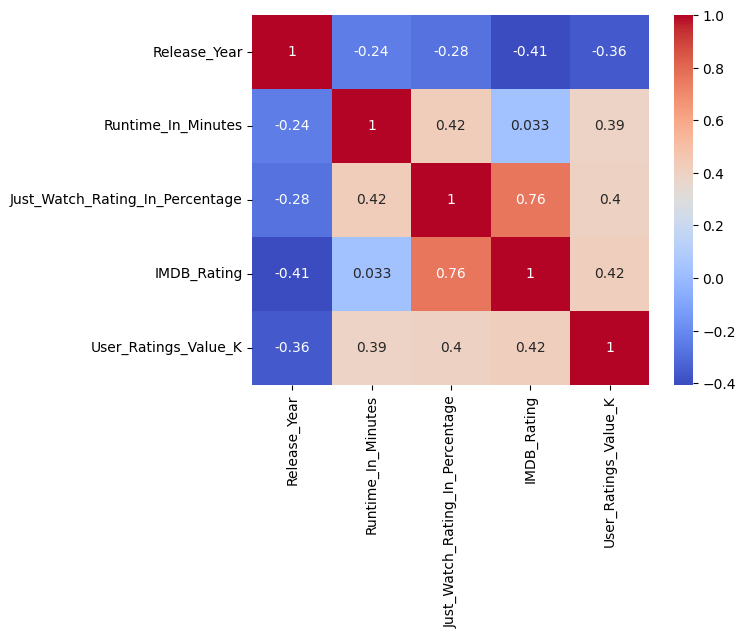

In [ ]:

sns.heatmap(war_military_movies.corr(),cmap='coolwarm',annot=True)


In [ ]:

war_military_correlation_matrix = war_military_movies.corr()
war_military_correlation_table = war_military_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
war_military_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
war_military_correlation_table['Correlation Type'] = war_military_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
war_military_correlation_table['Correlation Strength'] = war_military_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


war_military_correlation_table


<ipython-input-1470-0bee3daaf941>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  war_military_correlation_matrix = war_military_movies.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.762185,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.762185,Positive,Strong
7,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,0.420844,Positive,Weak
8,Just_Watch_Rating_In_Percentage,Runtime_In_Minutes,0.420844,Positive,Weak
9,User_Ratings_Value_K,IMDB_Rating,0.416443,Positive,Weak


# Western Movies Analysis

In [ ]:
western_movies.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
3360,Blood & Gold,Movie,Peter Thorwarth,2023,2021-2025,Western,100,100-105,77.0,70-80,6.5,6.6-7.0,7.0,1-50
3503,Concrete Cowboy,Movie,Ricky Staub,2020,2021-2025,Western,111,110-115,69.0,60-70,6.3,6.1-6.5,9.0,1-50
3624,El Camino Christmas,Movie,David E. Talbert,2017,2016-2020,Western,89,85-90,63.0,60-70,5.7,5.6-6.0,9.0,1-50
4003,Jarhead,Movie,Sam Mendes,2005,2006-2010,Western,123,120-125,75.0,70-80,7.0,7.1-7.5,196.0,151-200
4106,Lawless,Movie,John Hillcoat,2012,2011-2015,Western,116,115-120,78.0,70-80,7.2,7.1-7.5,247.0,201-250


# 15 Western Movies

In [ ]:
western_movies.shape


(15, 14)

In [ ]:
western_movies.Release_Year_Range.value_counts()


2021-2025    6
2016-2020    4
2011-2015    3
2006-2010    1
1991-1995    1
Name: Release_Year_Range, dtype: int64

In [ ]:
western_movies.JustWatch_Range.value_counts()


70-80    7
60-70    6
80-90    2
Name: JustWatch_Range, dtype: int64

In [ ]:
western_movies.IMDB_Range.value_counts()


6.6-7.0    4
6.1-6.5    4
7.1-7.5    3
7.6-8.0    2
5.6-6.0    1
4.6-5.0    1
Name: IMDB_Range, dtype: int64

In [ ]:
western_movies.UserRatings_Range.value_counts()


1-50       5
151-200    5
201-250    1
51-100     1
551-600    1
101-150    1
nan        1
Name: UserRatings_Range, dtype: int64

In [ ]:
western_movies.Runtime_Range.value_counts()


130-135    2
110-115    2
100-105    2
125-130    1
135-140    1
120-125    1
115-120    1
105-110    1
95-100     1
90-95      1
185-190    1
85-90      1
170-175    0
160-165    0
165-170    0
175-180    0
150-155    0
180-185    0
190-195    0
195-200    0
200-205    0
205-210    0
210-215    0
215-220    0
220-225    0
225-230    0
230-235    0
235-240    0
240-245    0
155-160    0
0-5        0
145-150    0
45-50      0
10-15      0
15-20      0
20-25      0
25-30      0
30-35      0
35-40      0
40-45      0
50-55      0
140-145    0
55-60      0
60-65      0
65-70      0
70-75      0
75-80      0
80-85      0
5-10       0
245-250    0
Name: Runtime_Range, dtype: int64

#**Western Movies Summary Statistics**


Release Year:
Count: There are 15 western movies in the dataset.
Mean: The average release year for western movies is approximately 2015.4.
Standard Deviation: The release years of western movies vary by approximately 7.8 years.
Minimum: The earliest release year for a western movie is 1994.
Maximum: The latest release year for a western movie is 2023.
25th Percentile: 25% of the western movies were released in or before the year 2012.5.
50th Percentile (Median): 50% of the western movies were released in or before the year 2017.
75th Percentile: 75% of the western movies were released in or before the year 2021.
****

Runtime in Minutes:
Mean: The average runtime of western movies is approximately 117.8 minutes.
Standard Deviation: The runtime of western movies varies by approximately 24.8 minutes.
Minimum: The shortest runtime for a western movie is 89 minutes.
Maximum: The longest runtime for a western movie is 188 minutes.
25th Percentile: 25% of the western movies have a runtime of 101 minutes or less.
50th Percentile (Median): 50% of the western movies have a runtime of 111 minutes or less.
75th Percentile: 75% of the western movies have a runtime of 129 minutes or less.
****

Just Watch Rating in Percentage:
Mean: The average Just Watch rating for western movies is approximately 73.1%.
Standard Deviation: The Just Watch ratings for western movies vary by approximately 6.5%.
Minimum: The lowest Just Watch rating for a western movie is 63%.
Maximum: The highest Just Watch rating for a western movie is 85%.
25th Percentile: 25% of the western movies have a Just Watch rating of 68% or lower.
50th Percentile (Median): 50% of the western movies have a Just Watch rating of 74% or lower.
75th Percentile: 75% of the western movies have a Just Watch rating of 77.5% or lower.
****

IMDb Rating:
Mean: The average IMDb rating for western movies is approximately 6.6.
Standard Deviation: The IMDb ratings for western movies vary by approximately 0.8.
Minimum: The lowest IMDb rating for a western movie is 4.6.
Maximum: The highest IMDb rating for a western movie is 7.8.
25th Percentile: 25% of the western movies have an IMDb rating of 6.3 or lower.
50th Percentile (Median): 50% of the western movies have an IMDb rating of 6.6 or lower.
75th Percentile: 75% of the western movies have an IMDb rating of 7.1 or lower.
****

User Ratings Value (K):
Mean: The average user ratings value for western movies is approximately 129.7 thousand.
Standard Deviation: The user ratings values for western movies vary by approximately 150.5 thousand.
Minimum: The lowest user ratings value for a western movie is 0 thousand.
Maximum: The highest user ratings value for a western movie is 570 thousand.
25th Percentile: 25% of the western movies have a user ratings value of 8 thousand or lower.
50th Percentile (Median): 50% of the western movies have a user ratings value of 142 thousand or lower.
75th Percentile: 75% of the western movies have a user ratings value of 182 thousand or lower.

In [ ]:
western_movies.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,15.000000,15.000000,15.000000,15.000000,15.000000
mean,2015.400000,117.800000,73.133333,6.566667,129.733333
std,7.762547,24.811288,6.512260,0.789816,150.537829
min,1994.000000,89.000000,63.000000,4.600000,0.000000
25%,2012.500000,101.000000,68.000000,6.300000,8.000000
50%,2017.000000,111.000000,74.000000,6.600000,142.000000
75%,2021.000000,129.000000,77.500000,7.100000,182.000000
max,2023.000000,188.000000,85.000000,7.800000,570.000000


# **Western Movies Correlation**


Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately -0.165. This indicates a weak negative correlation, suggesting a slight tendency for Western movies released in later years to have slightly shorter runtimes.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.419. This indicates a moderate negative correlation, suggesting a tendency for Western movies released in later years to have slightly lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.489. This indicates a moderate negative correlation, suggesting a tendency for Western movies released in later years to have slightly lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.367. This indicates a weak negative correlation, suggesting a slight tendency for Western movies released in later years to have slightly lower user ratings values (in thousands).

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.745. This indicates a strong positive correlation, suggesting a strong tendency for Western movies with longer runtimes to have higher Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.686. This indicates a moderate positive correlation, suggesting a tendency for Western movies with longer runtimes to have higher IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.791. This indicates a strong positive correlation, suggesting a strong tendency for Western movies with longer runtimes to have higher user ratings values (in thousands).

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.908. This indicates a strong positive correlation, suggesting a strong tendency for Western movies with higher Just Watch rating percentages to also have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.749. This indicates a moderate positive correlation, suggesting a tendency for Western movies with higher Just Watch rating percentages to have higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.729. This indicates a moderate positive correlation, suggesting a tendency for Western movies with higher IMDB ratings to have higher user ratings values (in thousands).

In [ ]:
western_movies.corr()


<ipython-input-1479-f3cf8669672a>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  western_movies.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,-0.165333,-0.419372,-0.489318,-0.366838
Runtime_In_Minutes,-0.165333,1.000000,0.745065,0.685623,0.791447
Just_Watch_Rating_In_Percentage,-0.419372,0.745065,1.000000,0.907759,0.748830
IMDB_Rating,-0.489318,0.685623,0.907759,1.000000,0.729121
User_Ratings_Value_K,-0.366838,0.791447,0.748830,0.729121,1.000000


<ipython-input-1480-f0590128b666>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(western_movies.corr(),cmap='coolwarm',annot=True)


<Axes: >

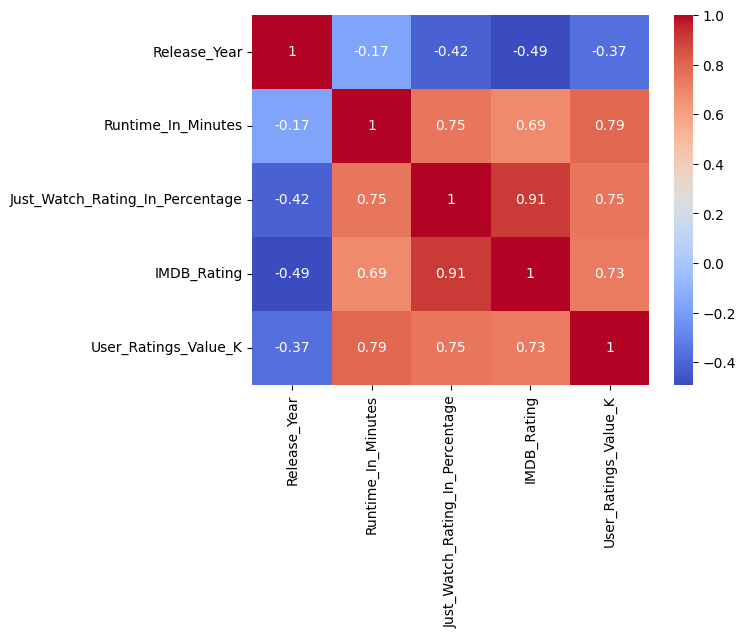

In [ ]:

sns.heatmap(western_movies.corr(),cmap='coolwarm',annot=True)


In [ ]:

western_correlation_matrix = western_movies.corr()
western_correlation_table = western_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
western_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
western_correlation_table['Correlation Type'] = western_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
western_correlation_table['Correlation Strength'] = western_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


western_correlation_table


<ipython-input-1481-bfcc61848197>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  western_correlation_matrix = western_movies.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.907759,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.907759,Positive,Strong
7,User_Ratings_Value_K,Runtime_In_Minutes,0.791447,Positive,Strong
8,Runtime_In_Minutes,User_Ratings_Value_K,0.791447,Positive,Strong
9,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.748830,Positive,Strong


# Reality Tv Movies Analysis

In [ ]:
reality_tv_movies.head()

,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
3305,Bert Kreischer: Razzle Dazzle,Movie,Jeff Tomsic,2023,2021-2025,Reality TV,61,60-65,80.0,80-90,7.0,7.1-7.5,1.0,1-50
3366,Bo Burnham: Inside,Movie,Bo Burnham,2021,2021-2025,Reality TV,87,85-90,91.0,90-100,8.7,8.6-9.0,44.0,1-50
3468,Chris Rock: Selective Outrage,Movie,Joel Gallen,2023,2021-2025,Reality TV,69,65-70,73.0,70-80,6.8,6.6-7.0,10.0,1-50
4006,Jenny Slate: Stage Fright,Movie,Gillian Robespierre,2019,2016-2020,Reality TV,66,65-70,65.0,60-70,5.8,5.6-6.0,1.0,1-50
4155,Longest Third Date,Movie,Brent Hodge,2023,2021-2025,Reality TV,76,75-80,70.0,70-80,6.4,6.1-6.5,0.0,nan


# 6 Reality TV Movies

In [ ]:
reality_tv_movies.shape

(6, 14)

In [ ]:
reality_tv_movies.Release_Year_Range.value_counts()

2021-2025    5
2016-2020    1
Name: Release_Year_Range, dtype: int64

In [ ]:
reality_tv_movies.JustWatch_Range.value_counts()

70-80     2
60-70     2
80-90     1
90-100    1
Name: JustWatch_Range, dtype: int64

In [ ]:
reality_tv_movies.IMDB_Range.value_counts()

6.1-6.5    2
7.1-7.5    1
8.6-9.0    1
6.6-7.0    1
5.6-6.0    1
Name: IMDB_Range, dtype: int64

In [ ]:
reality_tv_movies.UserRatings_Range.value_counts()

1-50    4
nan     2
Name: UserRatings_Range, dtype: int64

In [ ]:
reality_tv_movies.Runtime_Range.value_counts()

65-70      2
60-65      2
85-90      1
75-80      1
190-195    0
145-150    0
150-155    0
155-160    0
160-165    0
165-170    0
170-175    0
175-180    0
180-185    0
185-190    0
0-5        0
135-140    0
195-200    0
200-205    0
205-210    0
210-215    0
215-220    0
220-225    0
225-230    0
230-235    0
235-240    0
240-245    0
140-145    0
125-130    0
130-135    0
5-10       0
10-15      0
15-20      0
20-25      0
25-30      0
30-35      0
35-40      0
40-45      0
45-50      0
50-55      0
55-60      0
70-75      0
80-85      0
90-95      0
95-100     0
100-105    0
105-110    0
110-115    0
115-120    0
120-125    0
245-250    0
Name: Runtime_Range, dtype: int64

# **Reality TV Movies Summary Statistics**


Release Year: The dataset contains a total of 6 reality TV movies. The average release year is approximately 2021.8, indicating that the shows in the dataset are relatively recent. The standard deviation of 1.6 suggests a limited range of years, and the minimum and maximum release years of 2019 and 2023, respectively, reinforce this trend. The majority of reality TV movies (75%) were released in or before 2023, indicating a concentration of recent releases.

Runtime in Minutes: The average runtime for reality TV movies is approximately 69.8 minutes. The standard deviation of 10.2 suggests some variability in the lengths of these movies. The shortest movie has a runtime of 60 minutes, while the longest runs for 87 minutes. The 25th percentile indicates that 25% of the movies have a runtime of 62.3 minutes or less, and the 75th percentile indicates that 75% have a runtime of 74.3 minutes or less.

Just Watch Rating: The average Just Watch rating for reality TV movies is approximately 73.8%. The standard deviation of 10.2% indicates some variability in the audience ratings. The minimum rating is 64%, while the maximum is 91%. The 25th percentile suggests that 25% of the movies have a Just Watch rating of 66.3% or lower, and the 75th percentile indicates that 75% have a rating of 78.3% or lower.

IMDb Rating: The average IMDb rating for reality TV movies is approximately 6.9 out of 10, indicating a generally positive reception by viewers. The standard deviation of 1.0 suggests some variability in the ratings. The minimum IMDb rating is 5.8, while the maximum is 8.7. The 25th percentile suggests that 25% of the movies have an IMDb rating of 6.4 or lower, and the 75th percentile indicates that 75% have a rating of 6.95 or lower.

User Ratings Value: The average user ratings value for reality TV movies is approximately 9.3 thousand. The standard deviation of 17.4 thousand indicates a wide range of values. The minimum user ratings value is 0 thousand, while the maximum is 44 thousand. The 25th percentile suggests that 25% of the movies have a user ratings value of 0.25 thousand or lower, and the 75th percentile indicates that 75% have a value of 7.75 thousand or lower.


In [ ]:
reality_tv_movies.describe()

,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,6.000000,6.000000,6.000000,6.00000,6.000000
mean,2021.833333,69.833333,73.833333,6.85000,9.333333
std,1.602082,10.225784,10.225784,0.99549,17.408810
min,2019.000000,60.000000,64.000000,5.80000,0.000000
25%,2021.250000,62.250000,66.250000,6.40000,0.250000
50%,2022.500000,67.500000,71.500000,6.60000,1.000000
75%,2023.000000,74.250000,78.250000,6.95000,7.750000
max,2023.000000,87.000000,91.000000,8.70000,44.000000


#Reality TV Movies Correlation



Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately -0.112. This indicates a weak negative correlation, suggesting that in general, movies released in later years tend to have slightly shorter runtimes.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately 0.132. This suggests a weak positive correlation, indicating that movies released in later years may have slightly higher Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately 0.119. This indicates a weak positive correlation, suggesting that movies released in later years may have slightly higher IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.191. This indicates a weak negative correlation, suggesting that movies released in later years may have slightly lower user ratings values (in thousands).

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.665. This indicates a strong positive correlation, suggesting that movies with longer runtimes tend to have higher Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.710. This indicates a strong positive correlation, suggesting that movies with longer runtimes tend to have higher IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.825. This indicates a strong positive correlation, suggesting that movies with longer runtimes tend to have higher user ratings values (in thousands).

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.946. This indicates a strong positive correlation, suggesting that movies with higher Just Watch rating percentages tend to have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.836. This indicates a strong positive correlation, suggesting that movies with higher Just Watch rating percentages tend to have higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.923. This indicates a strong positive correlation, suggesting that movies with higher IMDB ratings tend to have higher user ratings values (in thousands).

In [ ]:
reality_tv_movies.corr()

<ipython-input-1490-929f43f2bd59>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  reality_tv_movies.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,-0.111908,0.132255,0.119133,-0.191225
Runtime_In_Minutes,-0.111908,1.000000,0.665285,0.710240,0.825007
Just_Watch_Rating_In_Percentage,0.132255,0.665285,1.000000,0.946004,0.836242
IMDB_Rating,0.119133,0.710240,0.946004,1.000000,0.923239
User_Ratings_Value_K,-0.191225,0.825007,0.836242,0.923239,1.000000


<ipython-input-1491-ad79c87baac7>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(reality_tv_movies.corr(),cmap='coolwarm',annot=True)


<Axes: >

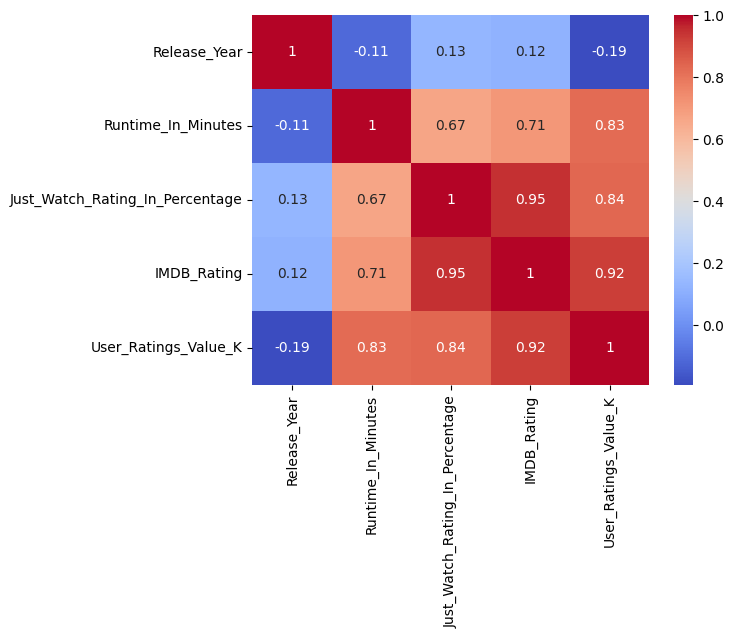

In [ ]:

sns.heatmap(reality_tv_movies.corr(),cmap='coolwarm',annot=True)


In [ ]:
reality_tv_correlation_matrix = reality_tv_movies.corr()
reality_tv_correlation_table = reality_tv_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
reality_tv_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
reality_tv_correlation_table['Correlation Type'] = reality_tv_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
reality_tv_correlation_table['Correlation Strength'] = reality_tv_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


reality_tv_correlation_table


<ipython-input-1492-3de720557c80>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  reality_tv_correlation_matrix = reality_tv_movies.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.946004,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.946004,Positive,Strong
7,User_Ratings_Value_K,IMDB_Rating,0.923239,Positive,Strong
8,IMDB_Rating,User_Ratings_Value_K,0.923239,Positive,Strong
9,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.836242,Positive,Strong


##**Tv Shows Genre Analysis**

In [ ]:
tvshows = df[df['Category'] == 'TV-Show']
tvshows

,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
0,#blackAF,TV-Show,Kenya Barris,2020,2021-2025,Comedy,37,35-40,38.0,30-40,0.0,nan,0.0,nan
1,(Un)Well,TV-Show,No Value,2020,2021-2025,Reality TV,52,50-55,69.0,60-70,6.4,6.1-6.5,1.0,1-50
2,(Un)Well,TV-Show,No Value,2020,2021-2025,Documentary,52,50-55,69.0,60-70,6.4,6.1-6.5,1.0,1-50
3,13 Reasons Why,TV-Show,Dylan Minnette,2017,2016-2020,Drama,58,55-60,84.0,80-90,7.5,7.6-8.0,302.0,301-350
4,13 Reasons Why,TV-Show,Dylan Minnette,2017,2016-2020,Mystery & Thriller,58,55-60,84.0,80-90,7.5,7.6-8.0,302.0,301-350
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3028,Zoey 101,TV-Show,Jamie Lynn Spears,2005,2006-2010,Drama,25,25-30,80.0,80-90,6.2,6.1-6.5,16.0,1-50
3029,Zoey 101,TV-Show,Jamie Lynn Spears,2005,2006-2010,Kids & Family,25,25-30,80.0,80-90,6.2,6.1-6.5,16.0,1-50
3030,Zoey 101,TV-Show,Jamie Lynn Spears,2005,2006-2010,Romance,25,25-30,80.0,80-90,6.2,6.1-6.5,16.0,1-50
3031,로보카폴리 쏭쏭뮤지엄,TV-Show,Jun-Young Um,2020,2021-2025,No Value,9,5-10,4.0,0-10,0.0,nan,0.0,nan


In [ ]:
tvshows.shape

(3033, 14)

#1030 TV Shows

In [ ]:
len(tvshows.Title.value_counts())

1030

In [ ]:
tvshows.isnull().sum()

Title                              0
Category                           0
Director                           0
Release_Year                       0
Release_Year_Range                 0
Genre                              0
Runtime_In_Minutes                 0
Runtime_Range                      0
Just_Watch_Rating_In_Percentage    0
JustWatch_Range                    0
IMDB_Rating                        0
IMDB_Range                         0
User_Ratings_Value_K               0
UserRatings_Range                  0
dtype: int64

#TV Shows Genre Counts

In [ ]:
tv_genre_counts = tvshows['Genre'].value_counts()
tv_genre_counts

Drama                 595
Comedy                317
Crime                 269
Mystery & Thriller    265
Action & Adventure    226
Science-Fiction       224
Documentary           206
Fantasy               168
Animation             140
Romance               125
Reality TV            111
Kids & Family          95
Horror                 79
History                73
War & Military         37
Sport                  35
Made in Europe         29
Music & Musical        27
Western                10
No Value                2
Name: Genre, dtype: int64

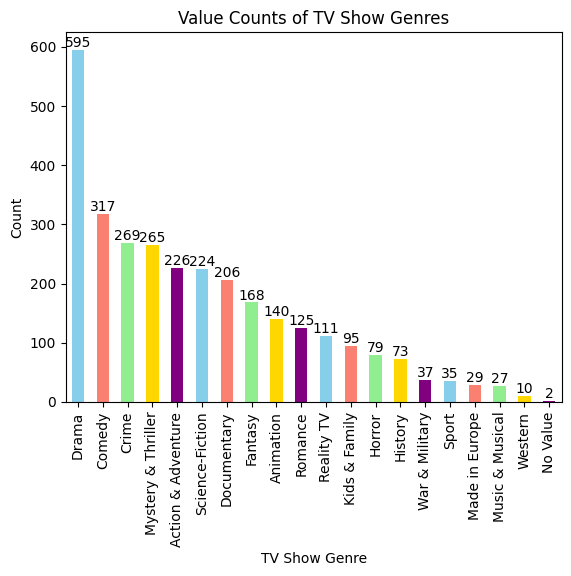

In [ ]:
import matplotlib.pyplot as plt

# Get the value counts
tv_genre_counts = tvshows['Genre'].value_counts()

# Define colors for the bars
colors = ['skyblue', 'salmon', 'lightgreen', 'gold', 'purple']

# Plotting the data
fig, ax = plt.subplots()
bar_plot = tv_genre_counts.plot(kind='bar', ax=ax, color=colors)

# Set labels and title
ax.set_xlabel('TV Show Genre')
ax.set_ylabel('Count')
ax.set_title('Value Counts of TV Show Genres')

# Add bar labels
for i, v in enumerate(tv_genre_counts):
    ax.text(i, v, str(v), ha='center', va='bottom')

# Show the plot
plt.show()


#**Netflix TV Shows by Genre**


Drama dominates: The Drama genre has the highest number of TV shows, with 595 entries. This indicates a strong presence of dramatic content on Netflix, catering to viewers' interest in captivating storytelling.

Comedy is popular: Comedy genre follows closely behind Drama, with 317 TV shows. This suggests that Netflix recognizes the popularity of comedy content and provides a diverse range of comedic shows to entertain its subscribers.

Crime and Mystery & Thriller genres are well-represented: With 269 TV shows in the Crime genre and 265 TV shows in the Mystery & Thriller genre, Netflix offers a significant selection of crime-themed and suspenseful content. This indicates the popularity of crime dramas and thrillers among viewers.

Kids & Family content: Netflix provides 95 TV shows in the Kids & Family genre, indicating a focus on offering age-appropriate and family-friendly programming. This suggests that Netflix recognizes the importance of catering to younger audiences and providing content that can be enjoyed by the whole family.

Wide variety of genres: The dataset includes TV shows from various genres, such as Action & Adventure, Animation, Documentary, Fantasy, History, Horror, Made in Europe, Music & Musical, Reality TV, Romance, Science-Fiction, Sport, War & Military, and Western. This demonstrates the diversity of content available on Netflix, catering to different interests and preferences of viewers.

Niche genres: Although some genres have a lower count, such as Made in Europe, Music & Musical, and Western, Netflix still provides options for viewers interested in these niche genres. This indicates Netflix's efforts to cater to a wide range of audience tastes and preferences.

Limited entries with "No Value" genre: The dataset includes only 2 TV shows that have not been assigned a genre. This suggests that Netflix has a well-defined categorization system in place for its TV shows, ensuring most content is properly classified.

In [ ]:
pd.crosstab(tvshows['Genre'], tvshows['Category'])



Category,TV-Show
Genre,
Action & Adventure,226
Animation,140
Comedy,317
Crime,269
Documentary,206
Drama,595
Fantasy,168
History,73
Horror,79


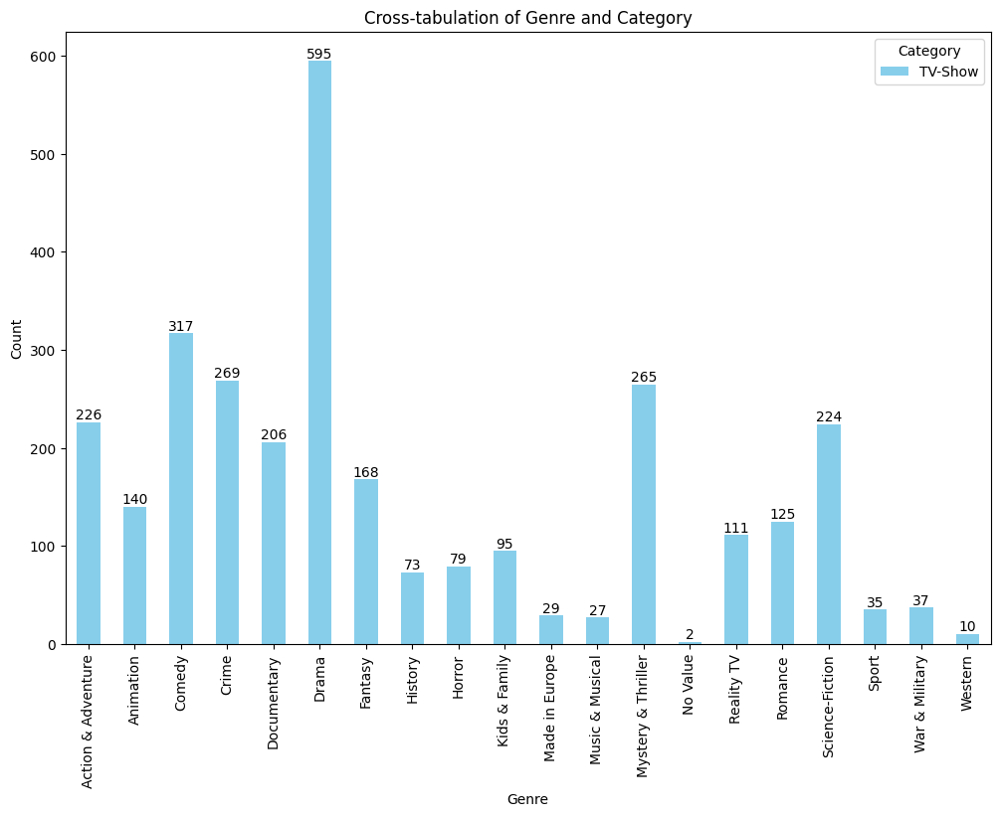

In [ ]:
import matplotlib.pyplot as plt

# Create the cross-tabulation dataframe
crosstab_data = pd.crosstab(tvshows['Genre'], tvshows['Category'])

# Define the colors for each category
colors = ['skyblue', 'salmon', 'lightgreen', 'orange']

# Plotting the data
fig, ax = plt.subplots(figsize=(12, 8))
crosstab_data.plot(kind='bar', stacked=True, ax=ax, color=colors)

# Set labels and title
ax.set_xlabel('Genre')
ax.set_ylabel('Count')
ax.set_title('Cross-tabulation of Genre and Category')

# Add legend
ax.legend(title='Category')

# Add bar labels
for container in ax.containers:
    ax.bar_label(container, label_type='edge')

# Show the plot
plt.show()


#**Distribution of TV Shows by Genre and Release Year Range**

The data represents the count of TV shows in each genre across different release year ranges.

Among the release year ranges, the most recent range of 2021-2025 has the highest count of TV shows across most genres, indicating a higher production rate in recent years.

Genres such as Action & Adventure, Animation, Comedy, Drama, and Mystery & Thriller have a substantial number of TV shows across multiple release year ranges, suggesting their popularity and consistent production.

Certain genres like Crime, Documentary, Fantasy, and Science-Fiction show an increasing count of TV shows in more recent release year ranges, indicating a growing interest in these genres over time.

Genres like History, Horror, Made in Europe, Music & Musical, Romance, Sport, War & Military, and Western have a relatively lower count of TV shows overall, with varying patterns across the release year ranges.


In [ ]:
pd.crosstab(tvshows['Genre'], tvshows['Release_Year_Range']).iloc[:, :-1]



Release_Year_Range,1981-1985,1986-1990,1991-1995,1996-2000,2001-2005,2006-2010,2011-2015,2016-2020,2021-2025
Genre,,,,,,,,,
Action & Adventure,1,0,2,5,9,3,21,66,119
Animation,1,0,5,5,9,5,13,39,63
Comedy,1,1,4,5,14,6,25,107,153
Crime,0,0,0,0,6,2,13,82,166
Documentary,0,0,1,0,1,3,3,50,148
Drama,1,0,1,3,12,11,40,191,336
Fantasy,1,0,3,4,8,4,14,54,80
History,0,0,0,0,0,0,4,19,50
Horror,0,0,0,0,0,2,7,30,40


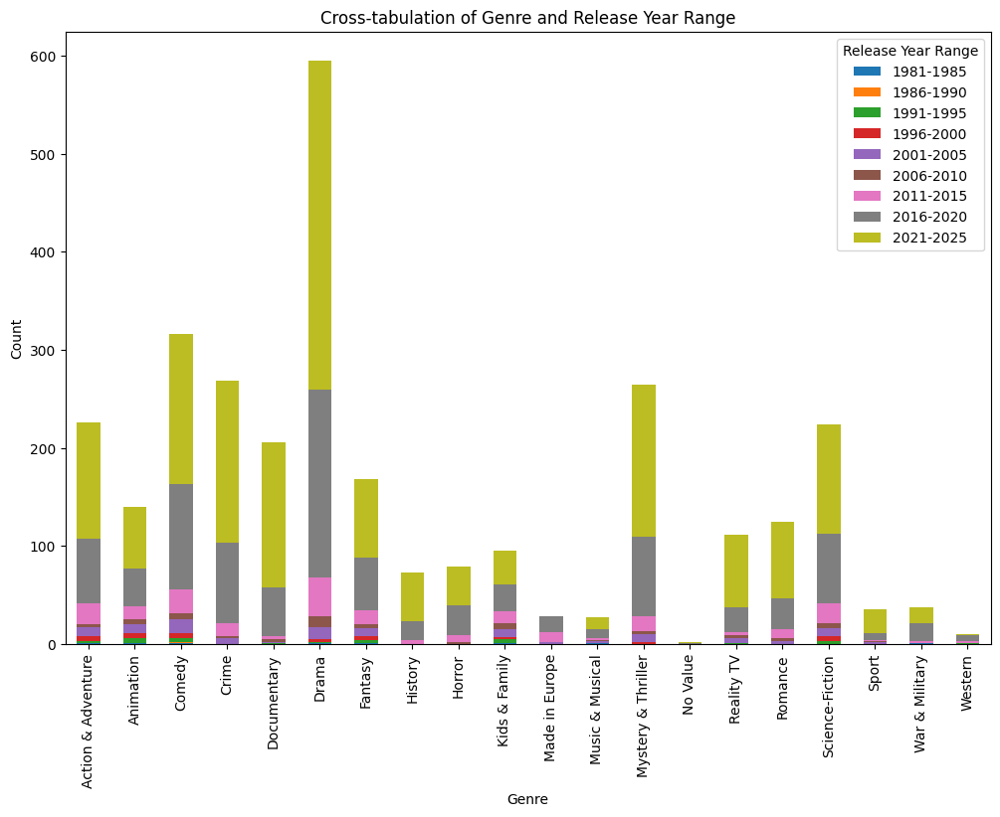

In [ ]:
import matplotlib.pyplot as plt

# Create the cross-tabulation dataframe
crosstab_data = pd.crosstab(tvshows['Genre'], tvshows['Release_Year_Range']).iloc[:, :-1]

# Plotting the data
fig, ax = plt.subplots(figsize=(12, 8))
crosstab_data.plot(kind='bar', stacked=True, ax=ax)

# Set labels and title
ax.set_xlabel('Genre')
ax.set_ylabel('Count')
ax.set_title('Cross-tabulation of Genre and Release Year Range')

# Add legend
ax.legend(title='Release Year Range')

# Show the plot
plt.show()


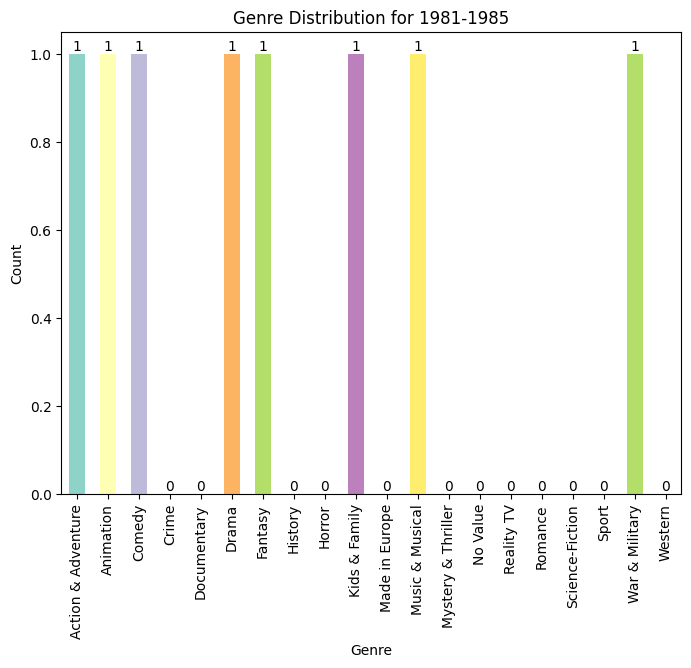

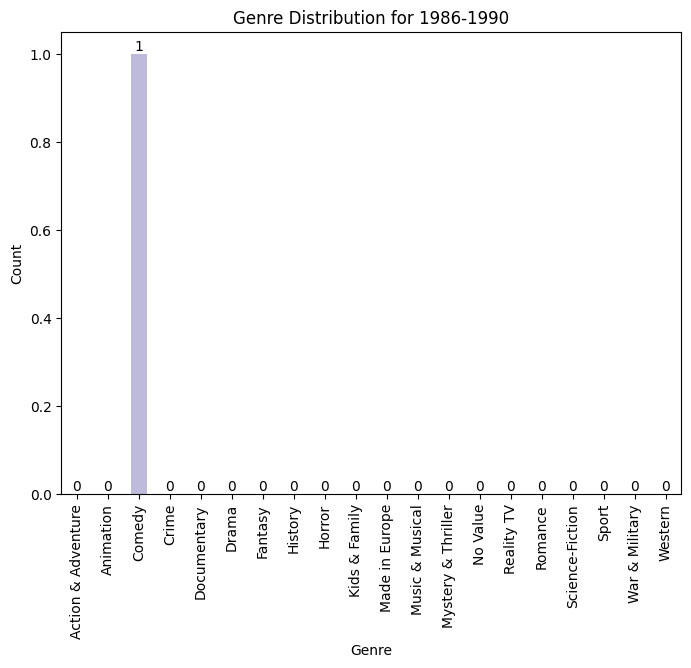

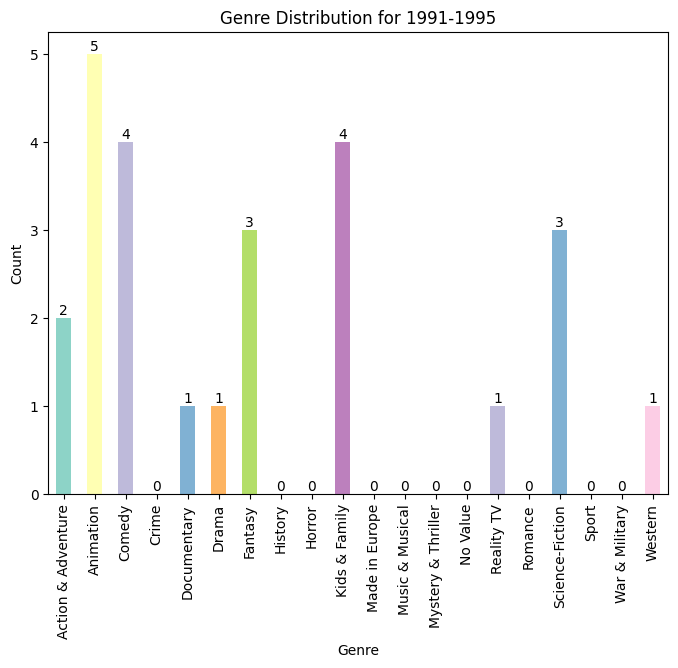

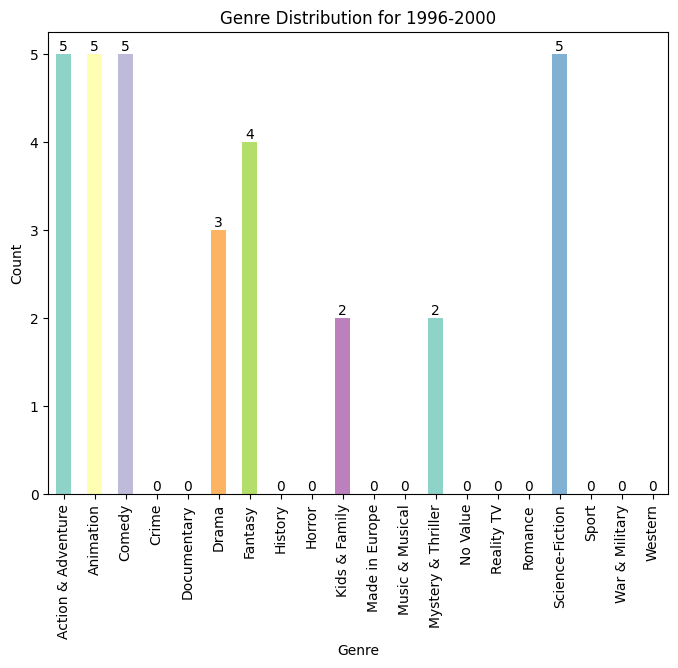

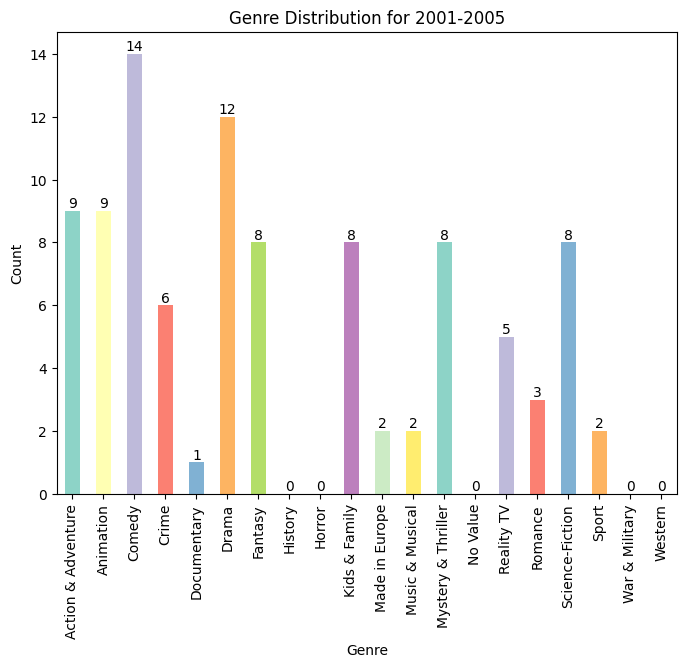

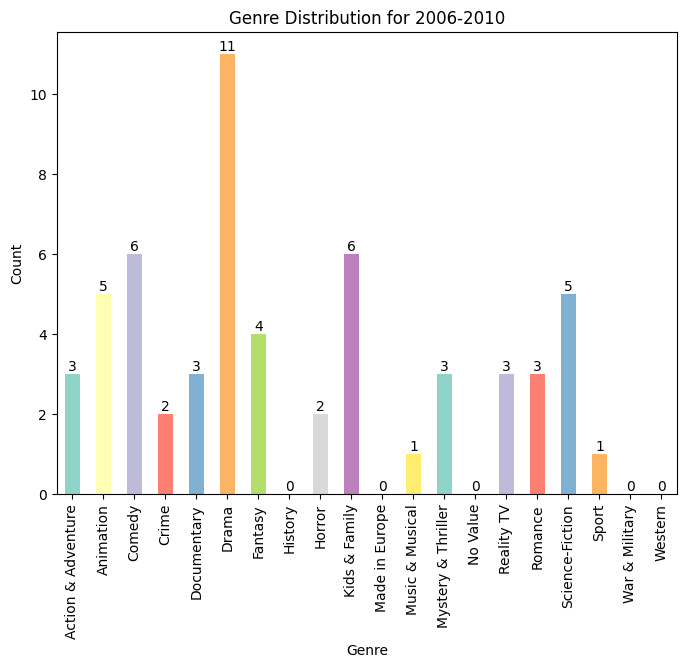

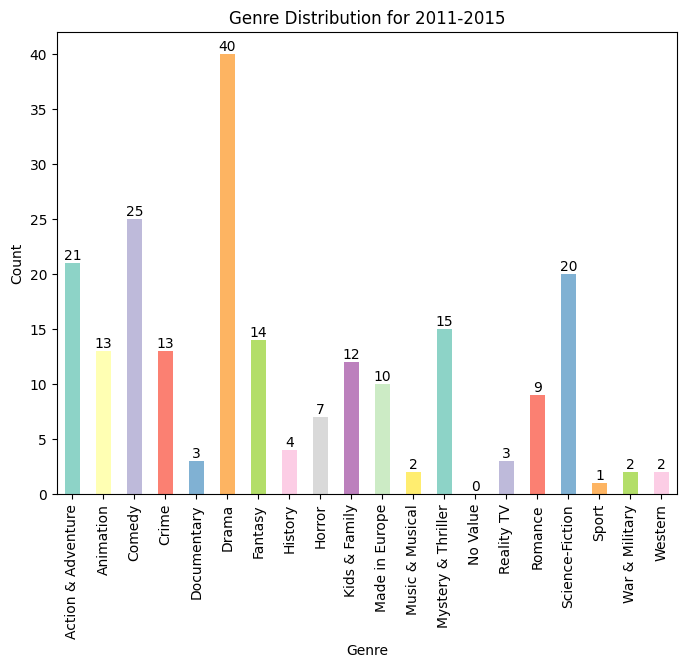

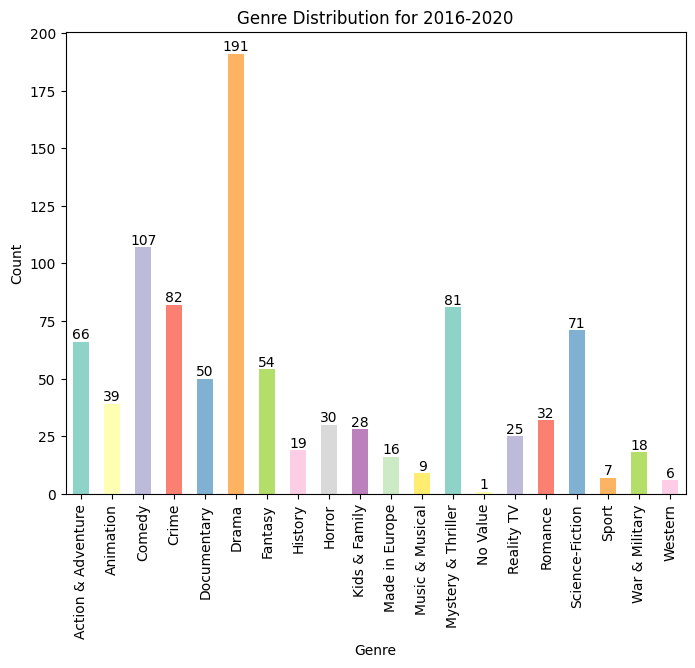

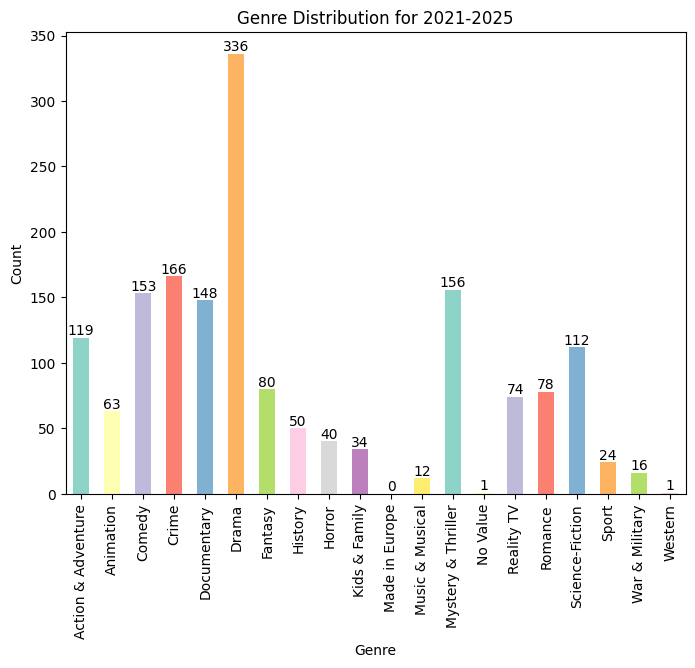

In [ ]:
import matplotlib.pyplot as plt

# Create the cross-tabulation dataframe
crosstab_data = pd.crosstab(tvshows['Genre'], tvshows['Release_Year_Range']).iloc[:, :-1]

# Get the unique release year ranges
release_year_ranges = crosstab_data.columns

# Define a color palette for the bars
color_palette = plt.get_cmap('Set3')

# Iterate over each release year range and create a separate plot
for year_range in release_year_ranges:
    # Select the data for the current year range
    data = crosstab_data[year_range]

    # Plotting the data
    fig, ax = plt.subplots(figsize=(8, 6))
    data.plot(kind='bar', ax=ax, color=color_palette.colors)

    # Set labels and title
    ax.set_xlabel('Genre')
    ax.set_ylabel('Count')
    ax.set_title(f'Genre Distribution for {year_range}')

    # Add bar labels
    for i, v in enumerate(data):
        ax.text(i, v, str(v), ha='center', va='bottom')

    # Show the plot
    plt.show()


#**Netflix TV Shows by Genre and Runtime**

Runtime Distribution: The dataset provides a comprehensive overview of the runtime distribution of TV shows across various genres on Netflix. The runtimes range from as short as 5 minutes to as long as 135 minutes, indicating a wide variety of episode lengths available to viewers.

Genre Popularity: The dataset reveals the popularity of different genres among Netflix TV shows. Drama is the most prevalent genre, with a significant number of shows falling into this category. Other popular genres include Comedy, Crime, Documentary, and Action & Adventure.

Genre-Specific Runtimes: Each genre has its own typical runtime characteristics. For example, Comedy and Drama series tend to have longer runtimes, often ranging from 20 to 45 minutes, allowing for in-depth storytelling and character development. On the other hand, Kids & Family shows and Animation series often have shorter runtimes, catering to the attention spans of younger viewers.

Diverse Content: Netflix offers a diverse range of TV shows, covering a wide spectrum of genres including Action & Adventure, Animation, Comedy, Crime, Documentary, Drama, Fantasy, History, Horror, Kids & Family, Made in Europe, Music & Musical, Mystery & Thriller, Reality TV, Romance, Science-Fiction, Sport, War & Military, and Western. This demonstrates the platform's commitment to providing content for various interests and age groups.

Genre Preferences: The dataset allows us to observe the preferences of Netflix viewers when it comes to TV show genres. Drama, Comedy, Crime, and Documentary genres have a higher representation in terms of the number of shows, suggesting a strong viewership and demand for these genres.

Varied Runtimes within Genres: While each genre may have a typical range of runtimes, there is still considerable variability within genres. For instance, within the Drama genre, the runtimes range from as short as 5 minutes to as long as 75 minutes, indicating diverse storytelling approaches within the same genre.

Targeted Content for Kids & Family: The dataset highlights a specific category for Kids & Family shows, indicating Netflix's focus on providing age-appropriate content for young viewers and their families. These shows typically have shorter runtimes, catering to the preferences and attention spans of children.

Genre Diversity within Runtimes: The dataset shows that different genres can have episodes with similar runtimes. For example, both Action & Adventure and Science-Fiction genres have a significant number of shows with runtimes in the 20-30 minute range, suggesting overlap in content and themes.

In [ ]:
pd.crosstab(tvshows['Runtime_Range'], tvshows['Genre']).drop('No Value', axis=1)


Genre,Action & Adventure,Animation,Comedy,Crime,Documentary,Drama,Fantasy,History,Horror,Kids & Family,Made in Europe,Music & Musical,Mystery & Thriller,Reality TV,Romance,Science-Fiction,Sport,War & Military,Western
Runtime_Range,,,,,,,,,,,,,,,,,,,
0-5,0,0,0,1,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0
5-10,0,4,2,0,0,0,1,0,0,4,1,0,0,0,0,0,0,0,0
10-15,5,6,8,1,0,3,3,0,2,5,0,1,2,0,0,4,0,1,0
15-20,8,10,13,1,0,6,5,0,0,6,1,2,0,2,2,4,0,0,0
20-25,50,58,71,11,9,45,46,1,7,40,2,6,23,7,15,51,1,0,2
25-30,37,49,85,16,18,53,34,4,12,22,2,2,18,8,15,36,1,2,0
30-35,5,6,40,9,12,32,4,2,4,2,2,2,8,13,9,8,6,0,1
35-40,3,0,14,5,12,23,3,2,1,2,0,2,9,14,9,7,2,0,1
40-45,37,2,25,50,38,108,18,13,13,3,1,3,48,25,16,32,5,9,1


<ipython-input-1505-8536cc32db28>:8: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_palette = plt.cm.get_cmap('tab20')


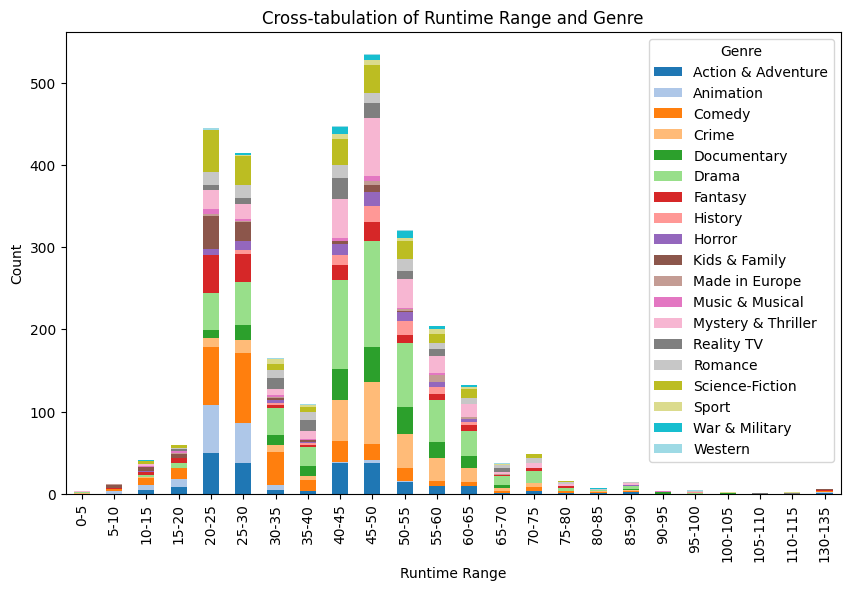

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Create the cross-tabulation dataframe and drop the 'No Value' column
crosstab_data = pd.crosstab(tvshows['Runtime_Range'], tvshows['Genre']).drop('No Value', axis=1)

# Define a color palette
color_palette = plt.cm.get_cmap('tab20')
colors = color_palette(np.linspace(0, 1, len(crosstab_data.columns)))

# Plotting the data
fig, ax = plt.subplots(figsize=(10, 6))
crosstab_data.plot(kind='bar', stacked=True, ax=ax, color=colors)

# Set labels and title
ax.set_xlabel('Runtime Range')
ax.set_ylabel('Count')
ax.set_title('Cross-tabulation of Runtime Range and Genre')


# Add a legend
ax.legend(title='Genre', bbox_to_anchor=(1, 1))

# Show the plot
plt.show()


<ipython-input-1506-52d3144bdaad>:11: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_palette = plt.cm.get_cmap('tab20')


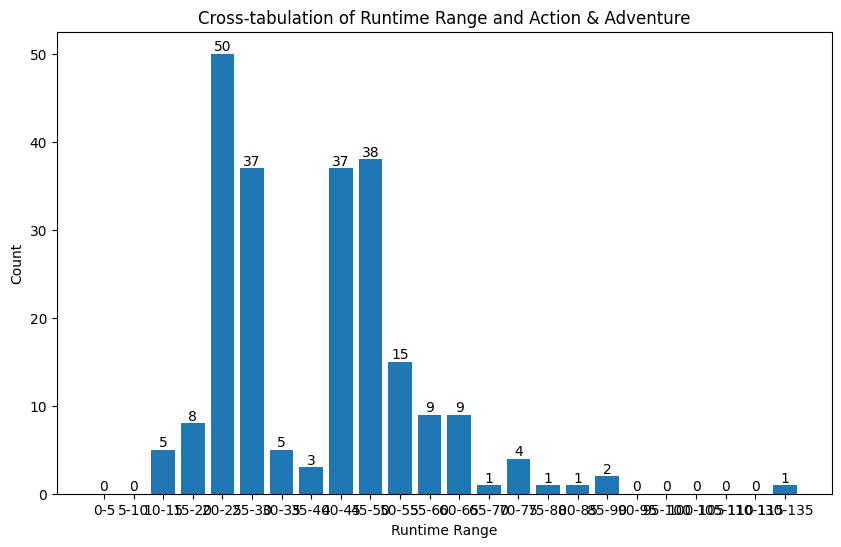

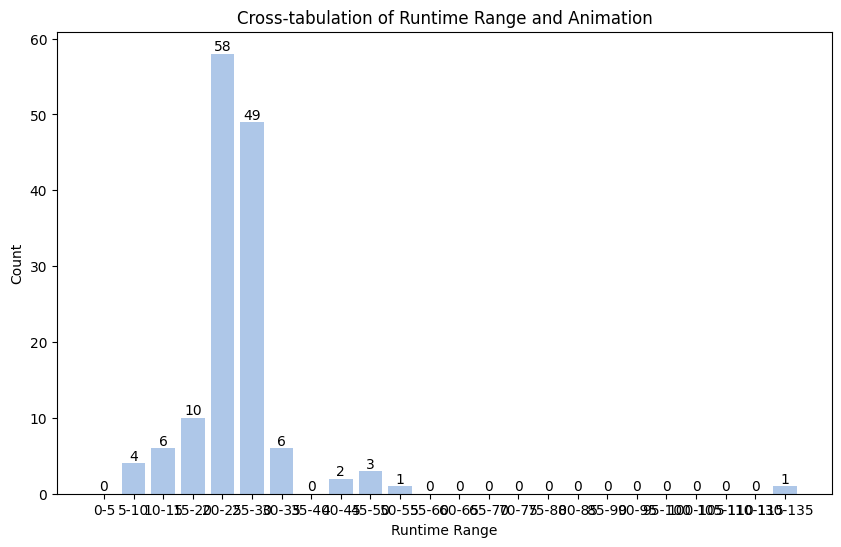

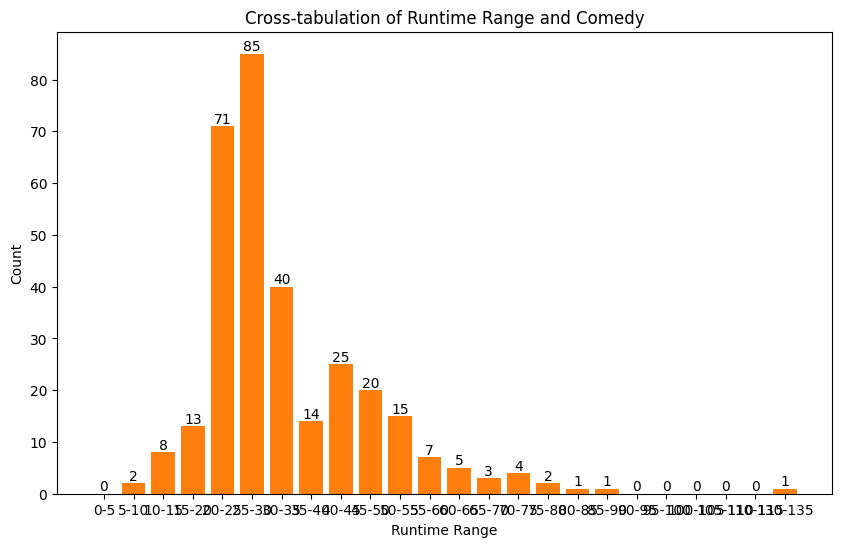

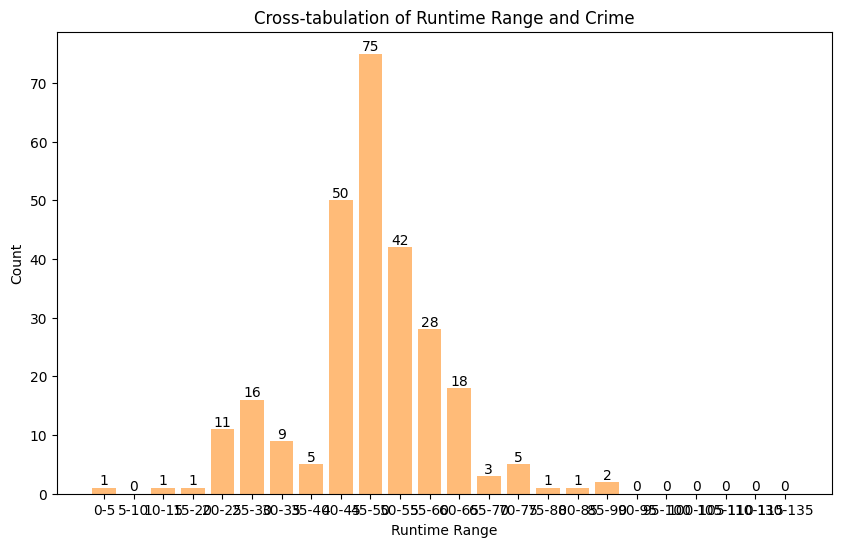

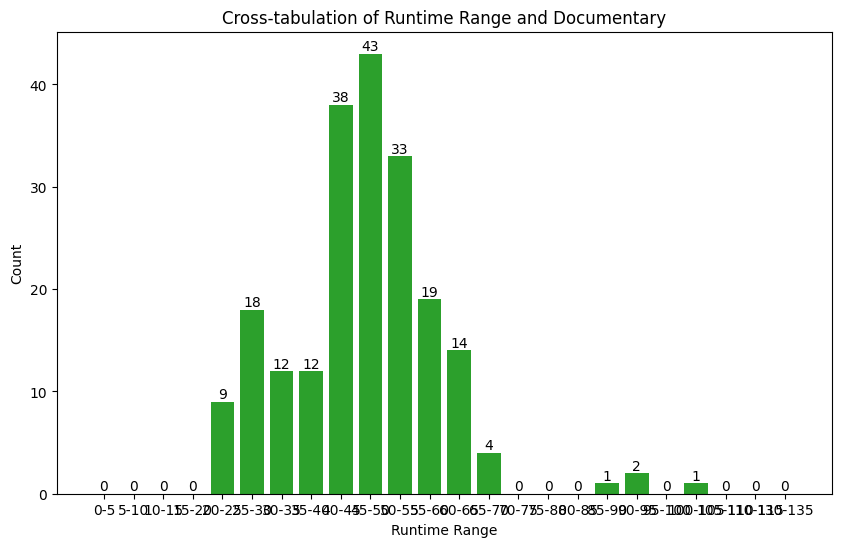

...

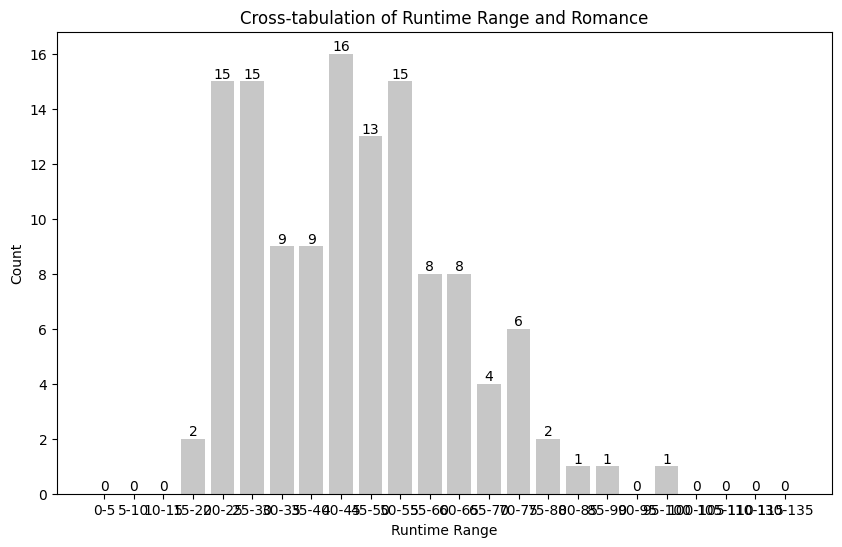

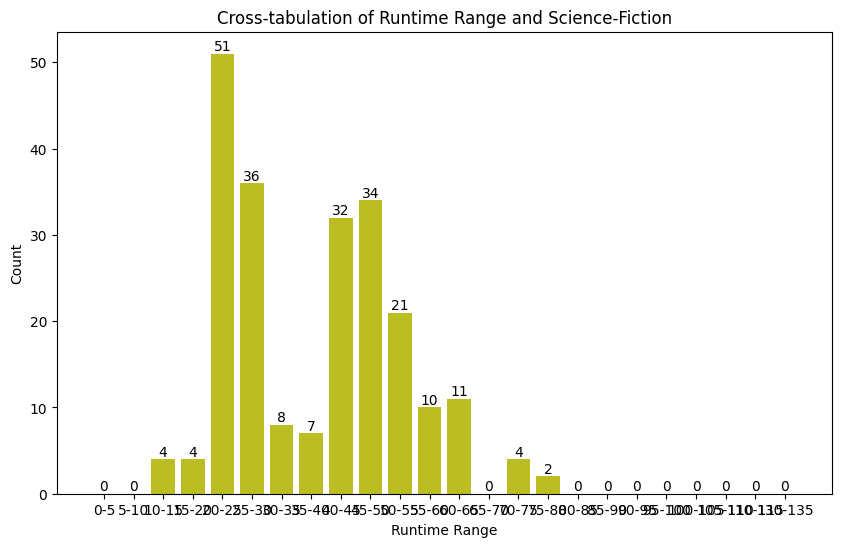

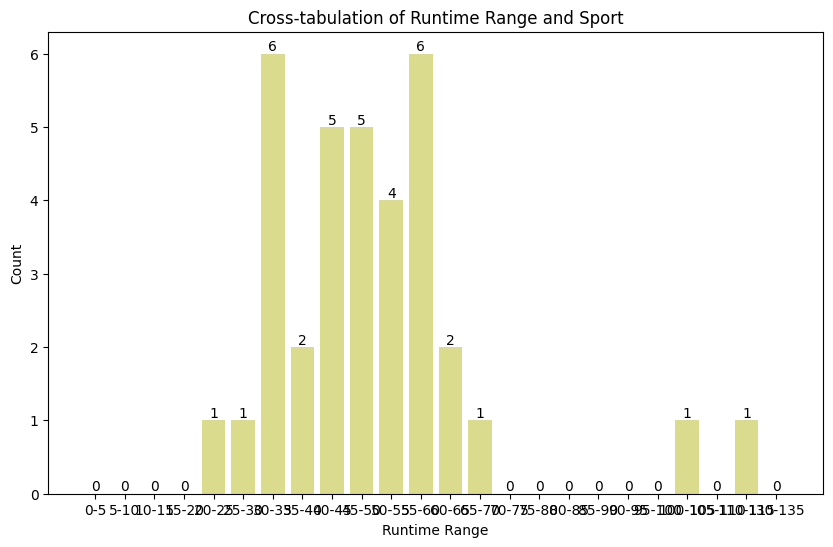

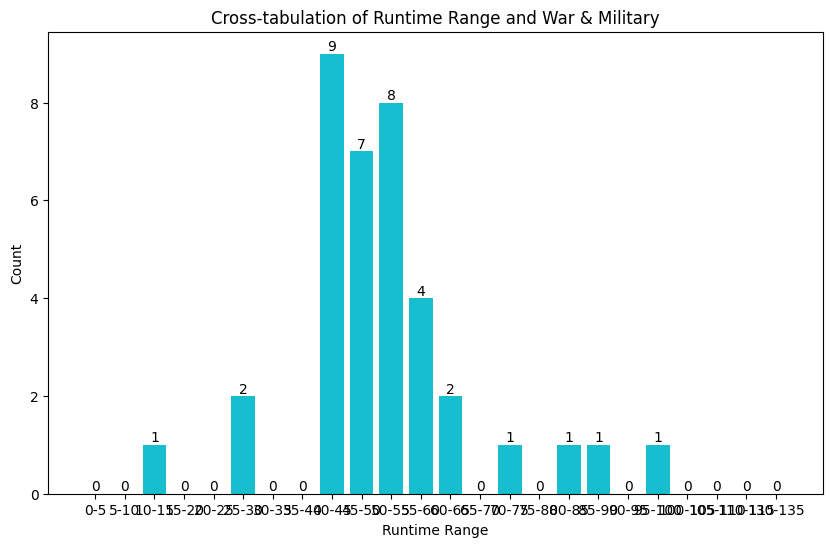

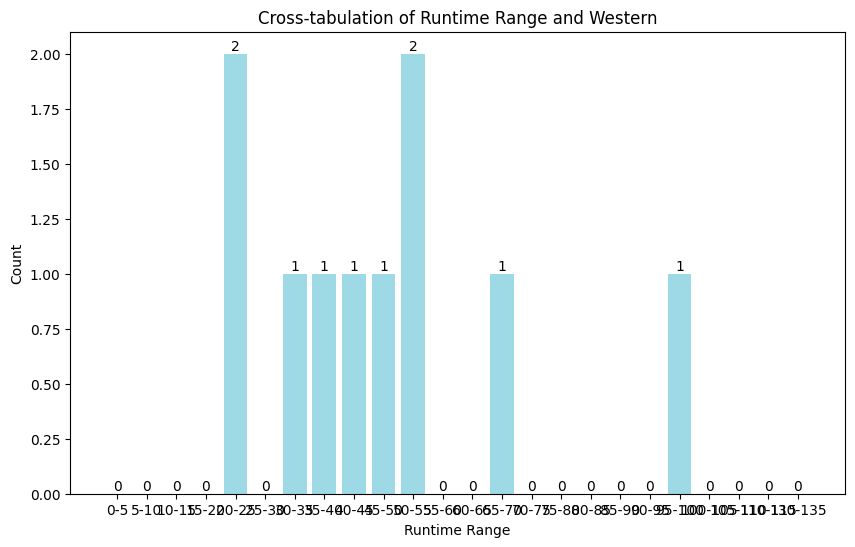

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Create the cross-tabulation dataframe and drop the 'No Value' column
crosstab_data = pd.crosstab(tvshows['Runtime_Range'], tvshows['Genre'])

# Get the list of genres
genres = crosstab_data.columns

# Define a color palette
color_palette = plt.cm.get_cmap('tab20')
colors = color_palette(np.linspace(0, 1, len(genres)))

# Iterate over the genres and create individual plots
for i, genre in enumerate(genres):
    # Create a new figure and axis for each plot
    fig, ax = plt.subplots(figsize=(10, 6))

    # Get the data for the current genre
    data = crosstab_data[genre]

    # Set the color for the current genre
    color = colors[i]

    # Plot the data
    bars = ax.bar(data.index, data, color=color)

    # Add bar labels
    for bar in bars:
        height = bar.get_height()
        ax.text(bar.get_x() + bar.get_width() / 2, height,
                f'{height}', ha='center', va='bottom')

    # Set labels and title
    ax.set_xlabel('Runtime Range')
    ax.set_ylabel('Count')
    ax.set_title(f'Cross-tabulation of Runtime Range and {genre}')

    # Show the plot
    plt.show()


#**Netflix TV Shows by Genre and IMDB Rating Range**

IMDB Rating Distribution: The dataset provides insights into the distribution of IMDB ratings for TV shows on Netflix across different genres. The ratings range from as low as 2.6 to as high as 10.0, reflecting a diverse range of viewer opinions and preferences.

Genre-Specific Ratings: Each genre has its own distribution of IMDB ratings. Some genres, such as Comedy, Drama, and Action & Adventure, have a wider range of ratings, indicating a diverse reception from viewers. Other genres, like Reality TV and Kids & Family, tend to have ratings clustered in specific ranges.

Popular Genres: The dataset shows that Comedy, Drama, and Action & Adventure genres have a higher number of shows in various IMDB rating ranges, indicating their popularity among viewers. These genres have a consistent presence across different rating ranges, suggesting a broad appeal.

Genre Ratings in the Middle Range: Drama, Comedy, and Action & Adventure genres have a significant number of shows in the 6.6-7.5 IMDB rating range, indicating a generally positive reception from viewers. This suggests that these genres have consistently delivered enjoyable and well-received content.

Documentary Ratings: The dataset reveals that Documentary shows tend to have higher ratings in the 7.1-8.0 and 8.1-8.5 IMDB rating ranges. This suggests that viewers appreciate the informative and educational nature of documentary content, resulting in positive ratings.

Genre Ratings in the Higher Range: Drama, Comedy, and Action & Adventure genres also have a notable presence in the 7.6-8.5 IMDB rating range, indicating a strong viewer response and favorable reviews for these shows.

Lower-Rated Genres: Some genres, such as Made in Europe and Sport, have a smaller number of shows and are less represented in higher IMDB rating ranges. This may suggest a narrower appeal or a specific niche audience for these genres.

Limited Ratings for Certain Genres: Genres like War & Military and Western have a limited number of shows, which may contribute to their lower representation in higher IMDB rating ranges. This suggests a relatively smaller audience for these genres or a specific taste required to appreciate them.

In [ ]:
pd.crosstab(tvshows['Genre'], tvshows['IMDB_Range']).iloc[:, :-1].drop('No Value', axis=0)



IMDB_Range,2.6-3.0,3.6-4.0,4.1-4.5,4.6-5.0,5.1-5.5,5.6-6.0,6.1-6.5,6.6-7.0,7.1-7.5,7.6-8.0,8.1-8.5,8.6-9.0,9.1-9.5,9.6-10.0
Genre,,,,,,,,,,,,,,
Action & Adventure,0,1,1,3,6,15,25,40,36,42,32,12,4,0
Animation,0,0,0,2,2,10,16,20,26,21,19,16,4,0
Comedy,1,1,0,4,6,19,27,50,58,66,49,25,2,0
Crime,0,0,0,2,3,14,26,57,66,47,32,18,0,1
Documentary,2,0,0,4,3,4,22,40,59,32,22,9,2,0
Drama,0,2,1,6,15,37,56,90,110,124,80,46,2,1
Fantasy,0,1,0,2,4,13,12,23,34,32,27,16,4,0
History,1,0,0,0,1,3,4,9,29,14,4,7,1,0
Horror,0,2,1,2,2,7,8,12,16,8,16,5,0,0


<ipython-input-1508-bf8ed5ff89b8>:7: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_palette = plt.cm.get_cmap('tab20')


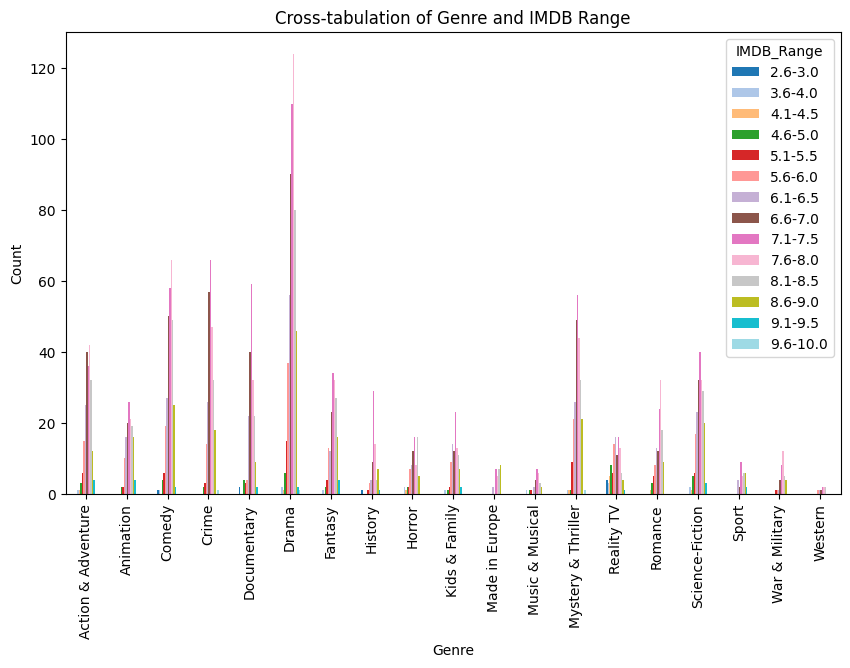

In [ ]:
import matplotlib.pyplot as plt

# Create the cross-tabulation dataframe and drop the 'No Value' row
crosstab_data = pd.crosstab(tvshows['Genre'], tvshows['IMDB_Range']).iloc[:, :-1].drop('No Value', axis=0)

# Define a color palette
color_palette = plt.cm.get_cmap('tab20')
colors = color_palette(np.linspace(0, 1, len(crosstab_data.columns)))

# Plotting the data
fig, ax = plt.subplots(figsize=(10, 6))
crosstab_data.plot(kind='bar', ax=ax, color=colors)

# Set labels and title
ax.set_xlabel('Genre')
ax.set_ylabel('Count')
ax.set_title('Cross-tabulation of Genre and IMDB Range')

# Show the plot
plt.show()


<ipython-input-1509-e71f4e4cc162>:7: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_palette = plt.cm.get_cmap('tab20')


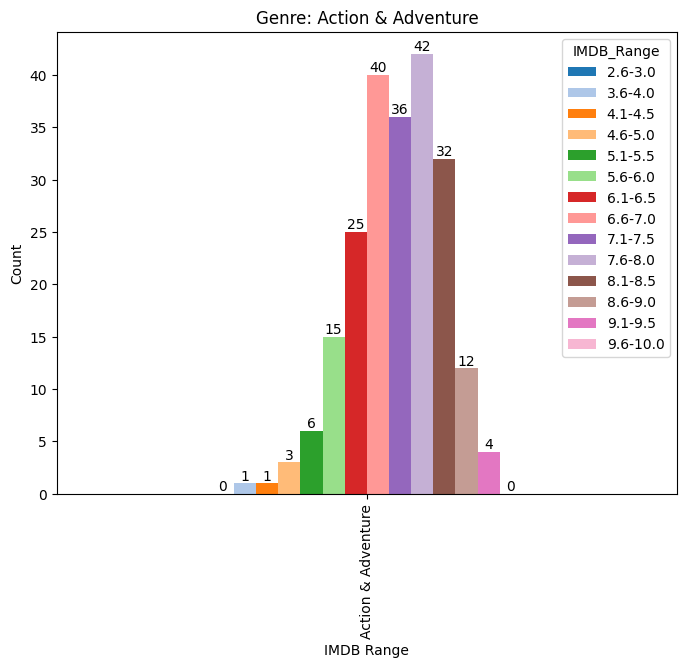

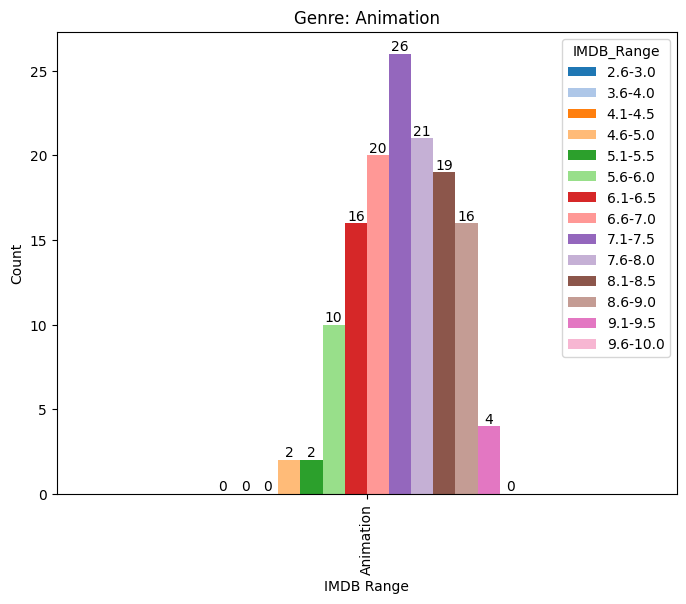

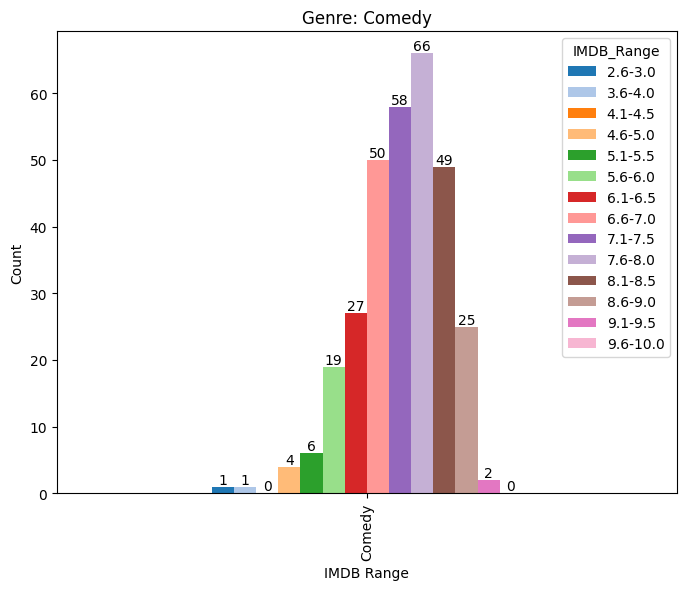

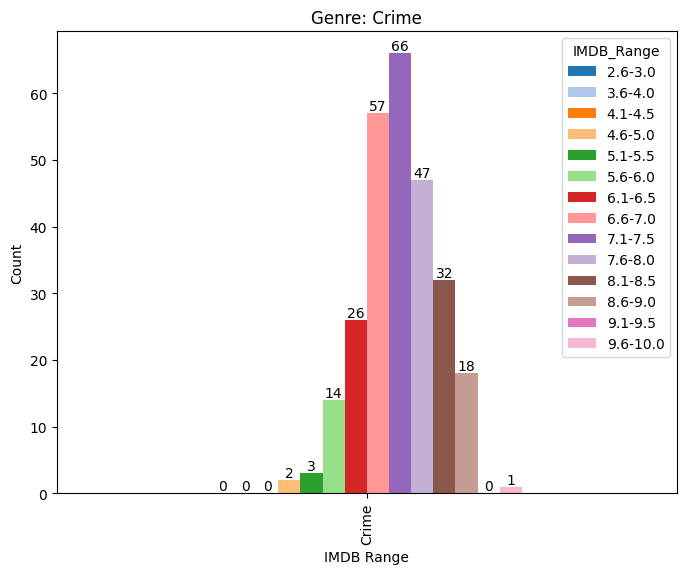

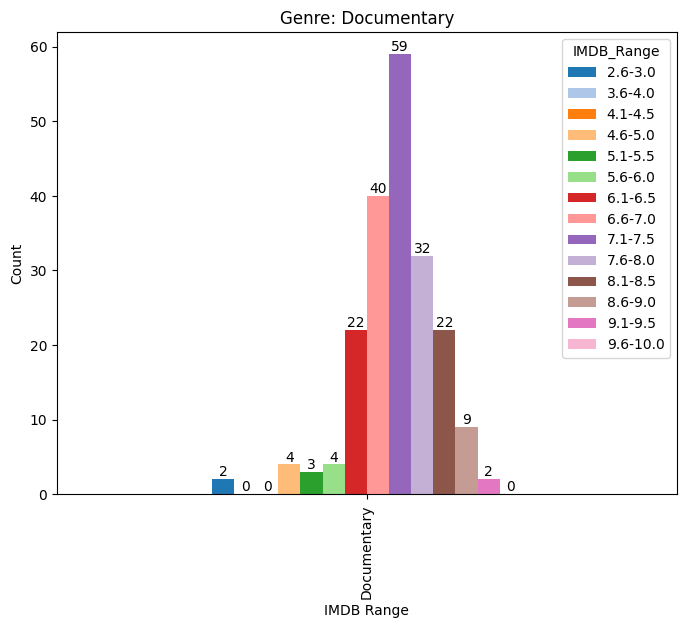

...

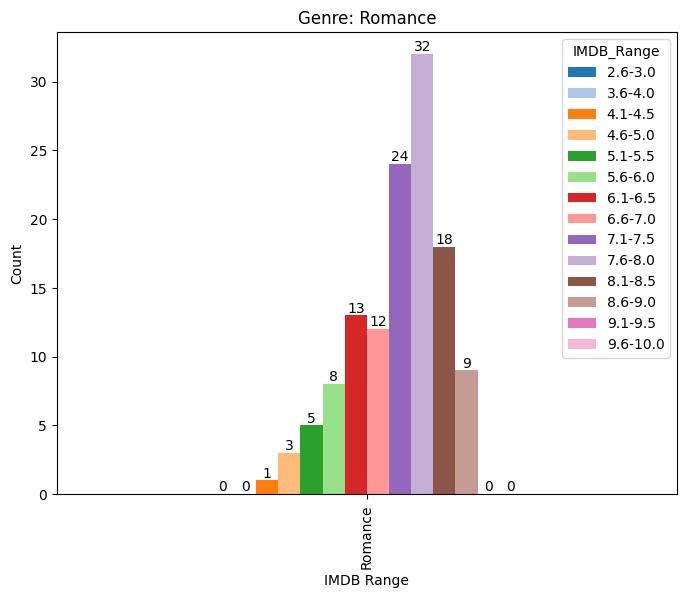

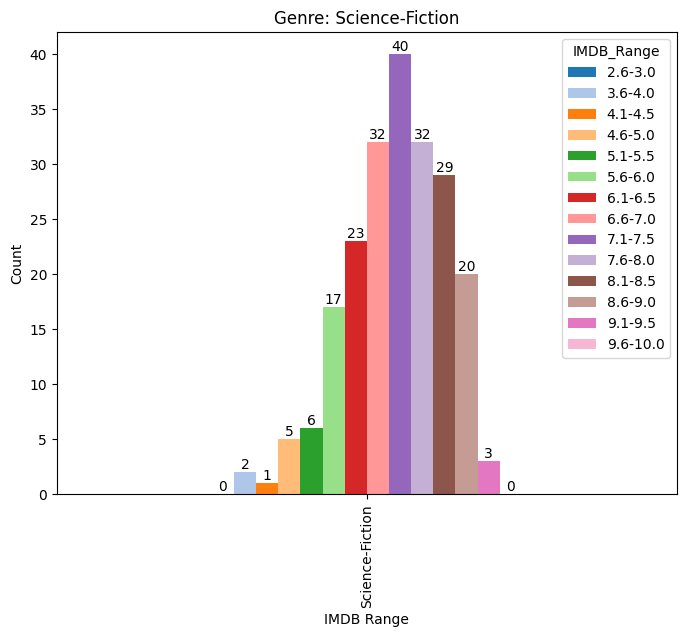

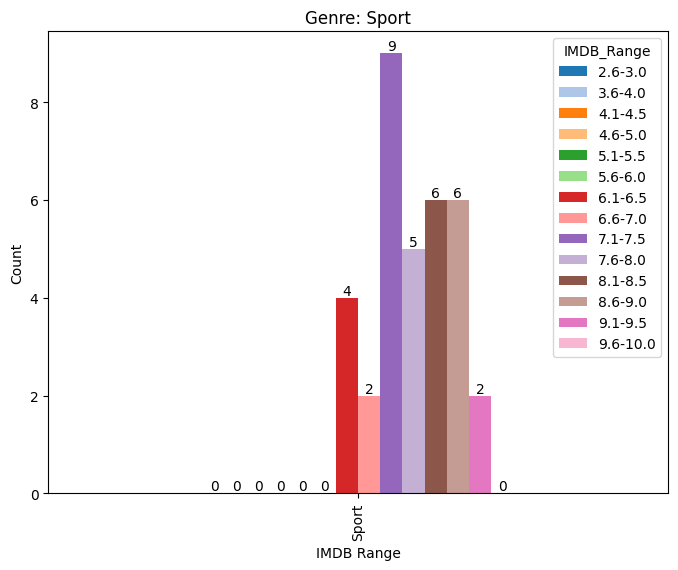

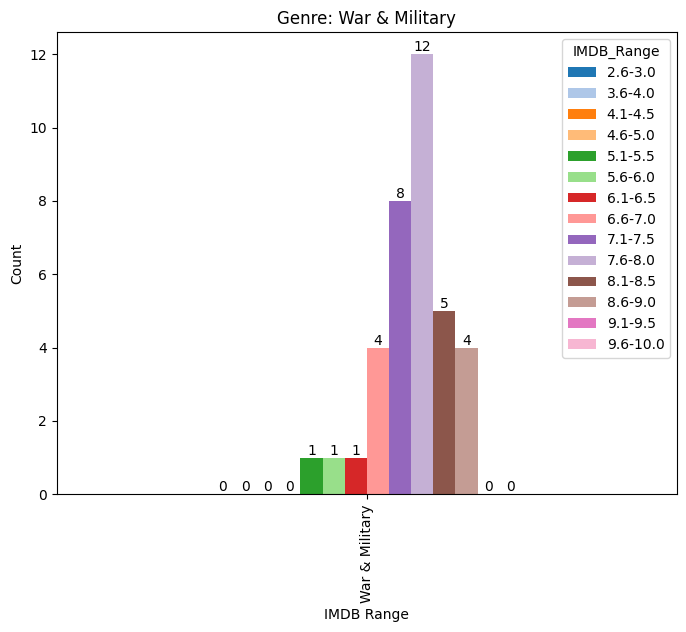

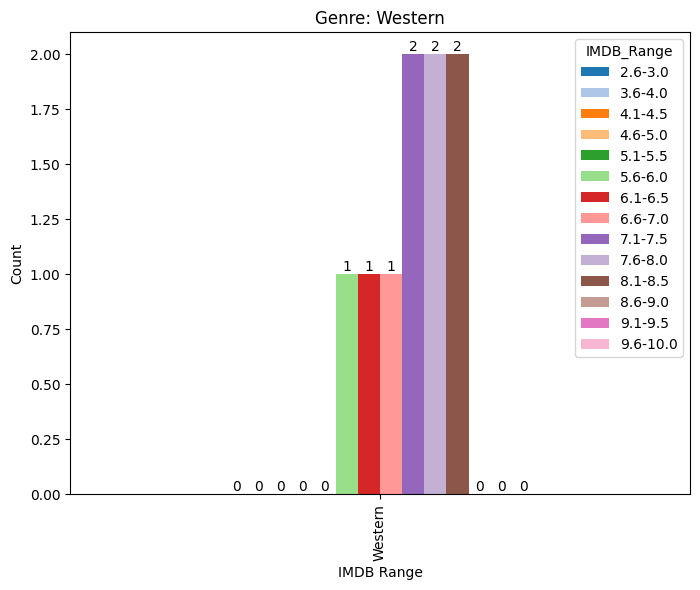

In [ ]:
import matplotlib.pyplot as plt

# Create the cross-tabulation dataframe and drop the 'No Value' row
crosstab_data = pd.crosstab(tvshows['Genre'], tvshows['IMDB_Range']).iloc[:, :-1].drop('No Value', axis=0)

# Define a color palette
color_palette = plt.cm.get_cmap('tab20')

# Iterate through each genre and create individual plots
for genre in crosstab_data.index:
    # Plotting the data for each genre
    fig, ax = plt.subplots(figsize=(8, 6))
    genre_data = crosstab_data.loc[[genre]]
    genre_data.plot(kind='bar', ax=ax, color=color_palette(np.arange(len(genre_data.columns))))

    # Set labels and title for each plot
    ax.set_xlabel('IMDB Range')
    ax.set_ylabel('Count')
    ax.set_title(f'Genre: {genre}')

    # Add bar labels
    for p in ax.patches:
        ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2, p.get_height()),
                    ha='center', va='bottom')

    # Show each plot
    plt.show()


#**Netflix TV Shows by Genre and JustWatch Popularity Range**

JustWatch Popularity Distribution: The dataset provides insights into the popularity distribution of TV shows on Netflix, categorized into different ranges on JustWatch. The popularity ranges include 0-10, 10-20, 20-30, and so on up to 90-100, indicating the relative popularity of shows within each genre.

Genre-Specific Popularity: Each genre has its own distribution of JustWatch popularity. Some genres, such as Drama, Comedy, and Action & Adventure, have a wider range of popularity, with shows falling into various popularity ranges. Other genres, like Made in Europe and Sport, may have a more limited range of popularity.

Popular Genres: The dataset shows that Drama, Comedy, and Action & Adventure genres have a higher number of shows in the higher JustWatch popularity ranges, indicating their popularity among viewers. These genres consistently have shows in the 70-80, 80-90, and 90-100 popularity ranges.

Drama Dominance: Drama genre has the highest number of shows in the dataset and has a significant presence in the higher JustWatch popularity ranges. This suggests a strong viewer interest in drama shows and their widespread popularity.

Comedy and Action & Adventure: These genres also have a notable presence in the higher JustWatch popularity ranges, indicating a strong viewer response and popularity for shows in these genres.

Documentary Popularity: Documentary shows tend to have a presence in the mid to higher JustWatch popularity ranges. This suggests that viewers appreciate and actively seek out documentary content, resulting in a relatively higher popularity rating on JustWatch.

Lower-Popularity Genres: Some genres, such as Sport and Made in Europe, have a smaller number of shows and are less represented in higher JustWatch popularity ranges. This may suggest a narrower appeal or a specific niche audience for these genres.

Limited Popularity for Certain Genres: Genres like War & Military and Western have a limited number of shows and are less represented in higher JustWatch popularity ranges. This suggests a relatively smaller audience for these genres or a specific taste required to appreciate them.

In [ ]:
pd.crosstab(tvshows['Genre'], tvshows['JustWatch_Range']).iloc[:, :-1].drop('No Value', axis=0)



JustWatch_Range,0-10,10-20,20-30,30-40,40-50,50-60,60-70,70-80,80-90,90-100
Genre,,,,,,,,,,
Action & Adventure,1,0,0,4,9,2,15,74,88,33
Animation,1,0,0,3,3,2,9,37,53,32
Comedy,1,0,0,5,7,8,29,90,137,40
Crime,1,0,0,8,3,2,14,126,91,23
Documentary,0,0,1,10,5,4,24,92,66,4
Drama,2,2,3,10,16,7,39,194,242,79
Fantasy,0,0,0,2,0,3,9,46,67,41
History,0,0,0,1,1,1,2,30,30,8
Horror,0,0,0,0,0,2,8,25,27,17


<ipython-input-1511-9f1283dd7b5d>:7: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_palette = plt.cm.get_cmap('tab20')


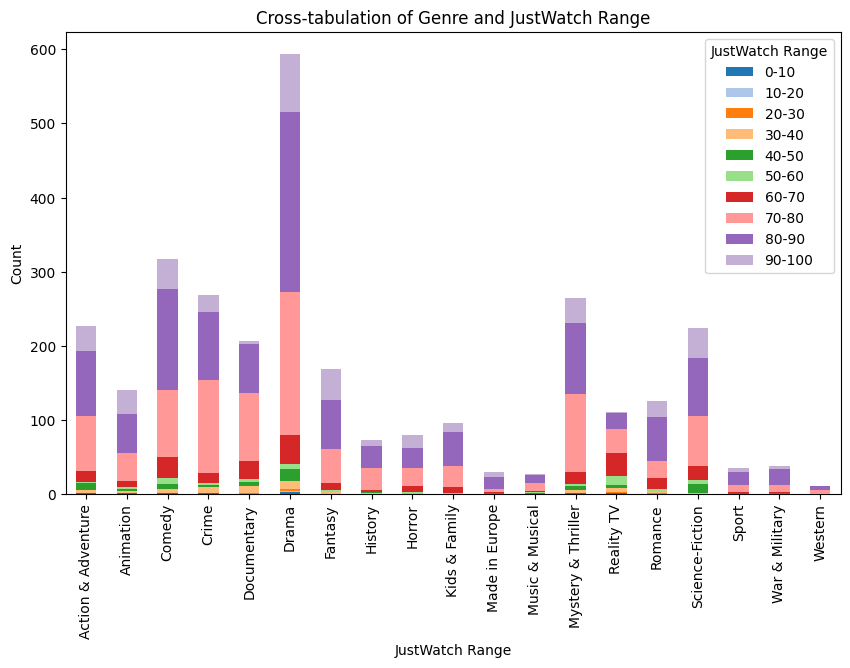

In [ ]:
import matplotlib.pyplot as plt

# Create the cross-tabulation dataframe and drop the 'No Value' row
crosstab_data = pd.crosstab(tvshows['Genre'], tvshows['JustWatch_Range']).iloc[:, :-1].drop('No Value', axis=0)

# Define a color palette
color_palette = plt.cm.get_cmap('tab20')

# Plotting the data
fig, ax = plt.subplots(figsize=(10, 6))
crosstab_data.plot(kind='bar', stacked=True, ax=ax, color=color_palette(np.arange(len(crosstab_data.columns))))

# Set labels and title
ax.set_xlabel('JustWatch Range')
ax.set_ylabel('Count')
ax.set_title('Cross-tabulation of Genre and JustWatch Range')

# Add legend
ax.legend(title='JustWatch Range', bbox_to_anchor=(1, 1))

# Show the plot
plt.show()


<ipython-input-1512-d791455b1cb5>:7: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_palette = plt.cm.get_cmap('tab20')


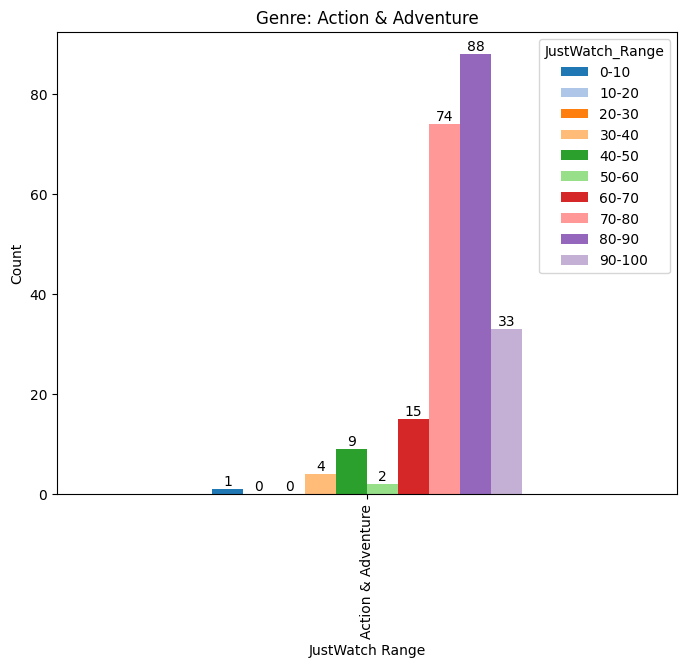

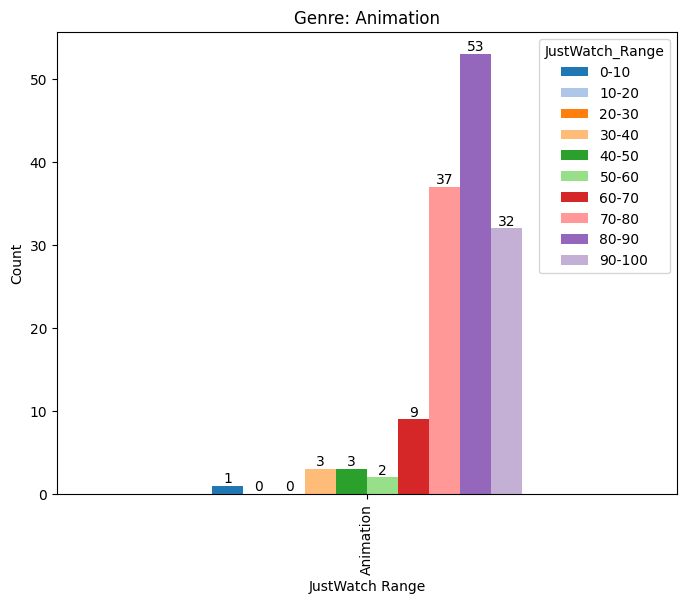

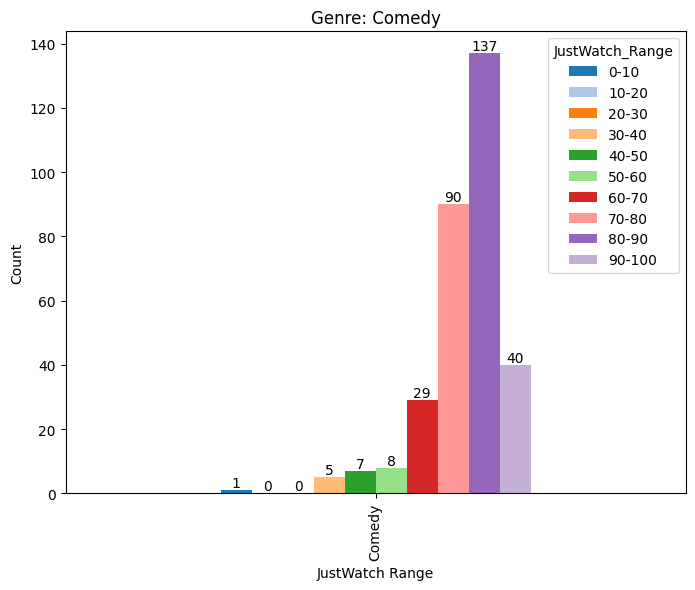

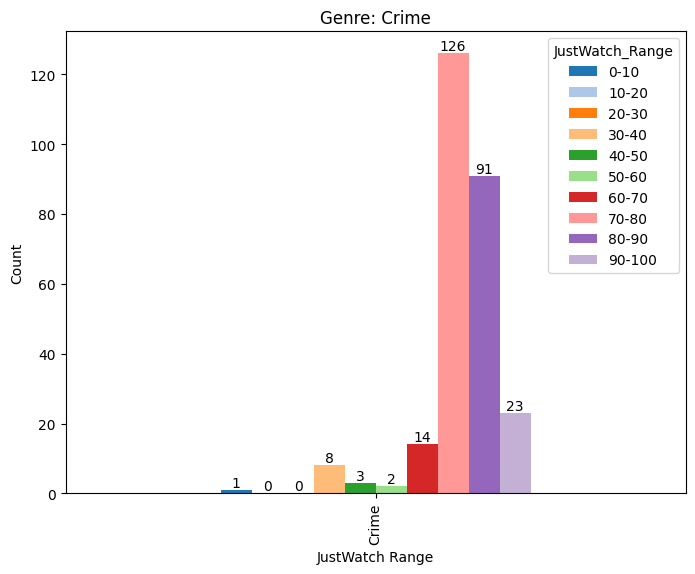

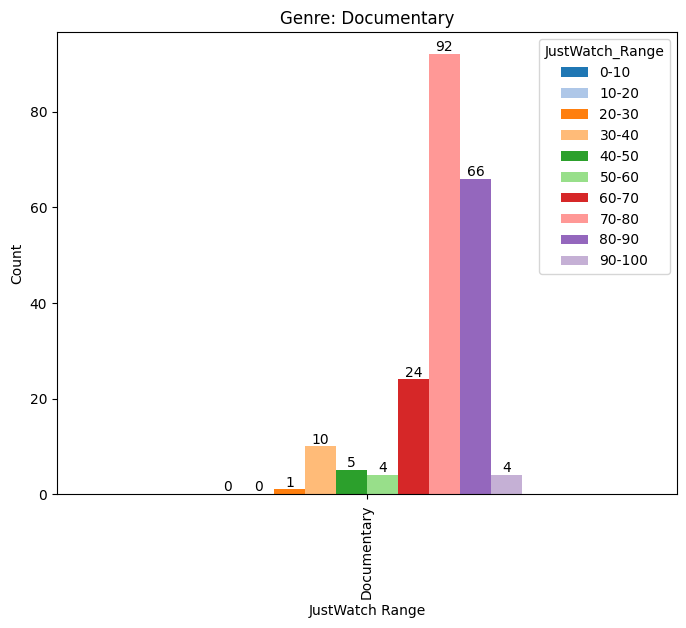

...

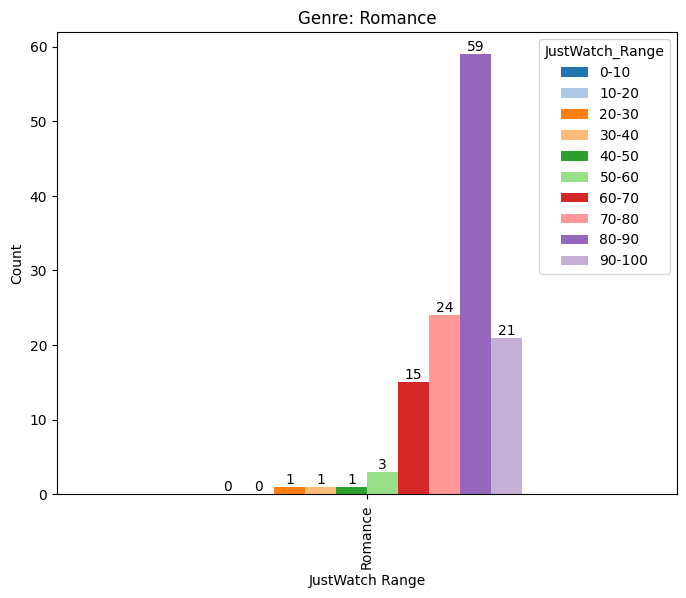

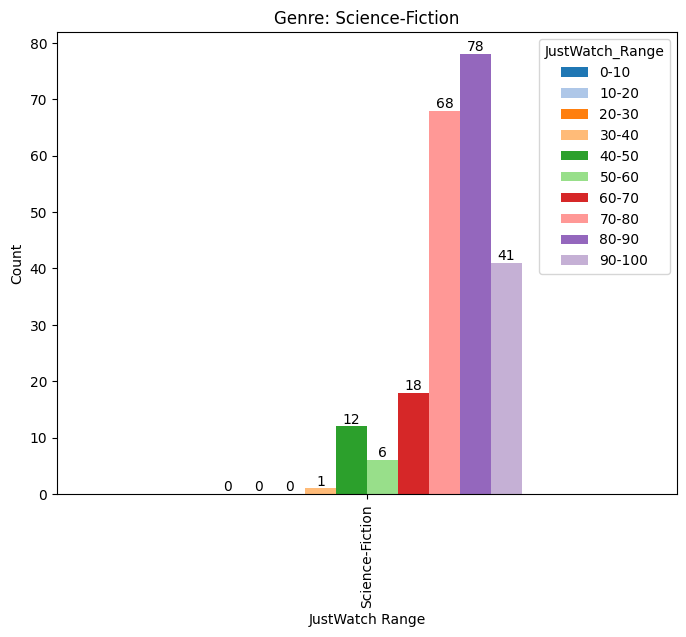

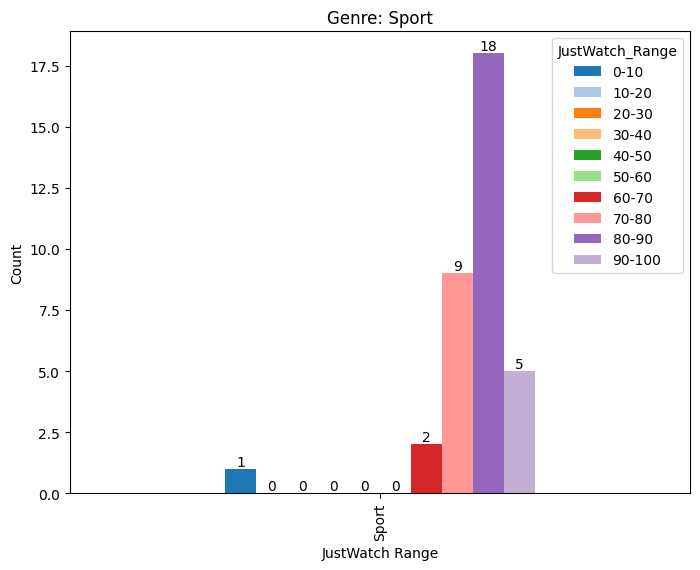

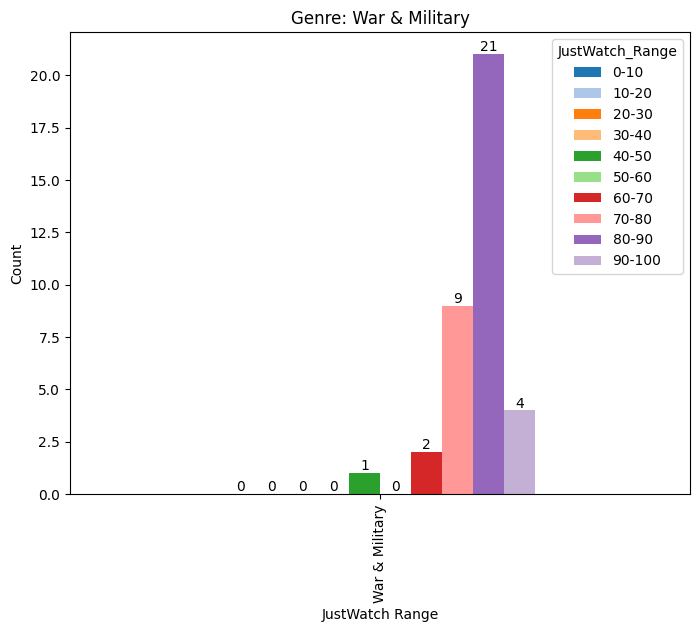

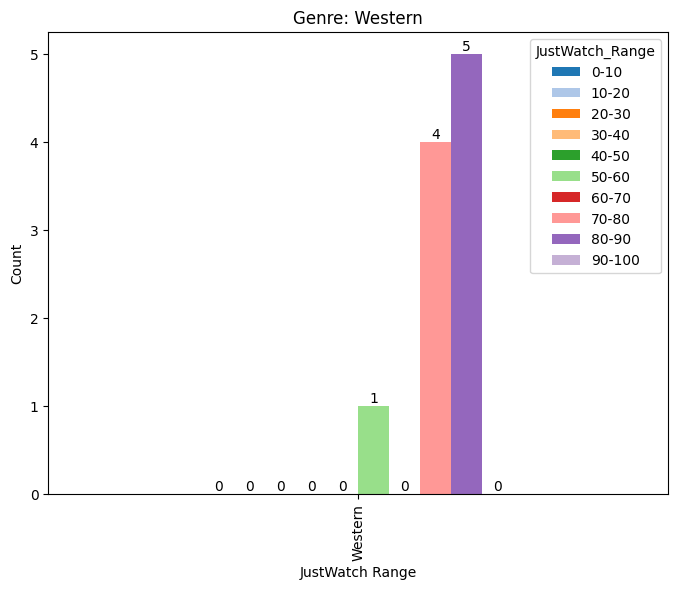

In [ ]:
import matplotlib.pyplot as plt

# Create the cross-tabulation dataframe and drop the 'No Value' row
crosstab_data = pd.crosstab(tvshows['Genre'], tvshows['JustWatch_Range']).iloc[:, :-1].drop('No Value', axis=0)

# Define a color palette
color_palette = plt.cm.get_cmap('tab20')

# Iterate through each genre and create individual plots
for genre in crosstab_data.index:
    # Plotting the data for each genre
    fig, ax = plt.subplots(figsize=(8, 6))
    genre_data = crosstab_data.loc[[genre]]
    genre_data.plot(kind='bar', ax=ax, color=color_palette(np.arange(len(genre_data.columns))))

    # Set labels and title for each plot
    ax.set_xlabel('JustWatch Range')
    ax.set_ylabel('Count')
    ax.set_title(f'Genre: {genre}')

    # Add bar labels
    for p in ax.patches:
        ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2, p.get_height()),
                    ha='center', va='bottom')

    # Show each plot
    plt.show()


**Netflix TV Shows by Genre and User Ratings Range**

User Ratings Distribution: The dataset provides insights into the distribution of user ratings for TV shows on Netflix, categorized into different ranges. The user ratings ranges include 1-50, 51-100, 101-150, and so on up to 551-600, indicating the range of user ratings received by shows within each genre.

Genre-Specific User Ratings: Each genre has its own distribution of user ratings. Some genres, such as Drama, Comedy, and Crime, have a wider range of user ratings, with shows falling into various ranges. Other genres, like Made in Europe and Music & Musical, may have a more limited range of user ratings.

Highly Rated Genres: The dataset shows that Drama, Comedy, and Crime genres have a higher number of shows in the higher user ratings ranges, indicating positive reception among users. These genres consistently have shows in the 201-250, 251-300, and 301-350 user ratings ranges.

Drama Dominance: Drama genre has the highest number of shows in the dataset and has a significant presence in the higher user ratings ranges. This suggests a strong user appreciation for drama shows and their overall positive reception.

Comedy and Crime: These genres also have a notable presence in the higher user ratings ranges, indicating positive user feedback and enjoyment for shows in these genres.

Lower User Ratings for Certain Genres: Some genres, such as Western and Made in Europe, have a smaller number of shows and are less represented in higher user ratings ranges. This may suggest a narrower appeal or a specific audience preference for these genres.

User Ratings Consistency: Genres like Animation, Documentary, and Kids & Family have relatively consistent user ratings across different ranges, with fewer extreme ratings.

User Ratings Range: The dataset includes a range of user ratings, from 1-50 to 551-600. This suggests that user opinions and ratings vary widely, highlighting the diverse preferences and tastes of Netflix viewers.

In [ ]:
pd.crosstab(tvshows['Genre'], tvshows['UserRatings_Range']).iloc[:, :-1].drop('No Value', axis=0)

UserRatings_Range,1-50,101-150,151-200,201-250,251-300,301-350,351-400,401-450,451-500,501-550,51-100,551-600
Genre,,,,,,,,,,,,
Action & Adventure,144,13,6,1,2,1,1,1,2,2,17,0
Animation,89,7,2,1,0,2,0,0,0,0,7,0
Comedy,208,12,5,1,4,4,0,0,0,0,20,0
Crime,189,7,2,1,3,5,0,3,1,0,14,3
Documentary,147,1,0,0,0,0,0,0,0,0,4,0
Drama,382,27,10,3,8,6,1,3,4,3,49,4
Fantasy,110,11,4,1,1,4,0,0,1,2,13,0
History,60,4,1,1,0,0,0,0,0,0,5,0
Horror,51,6,1,0,1,1,0,0,1,2,8,0


<ipython-input-1514-452673e05af9>:7: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_palette = plt.cm.get_cmap('tab20')


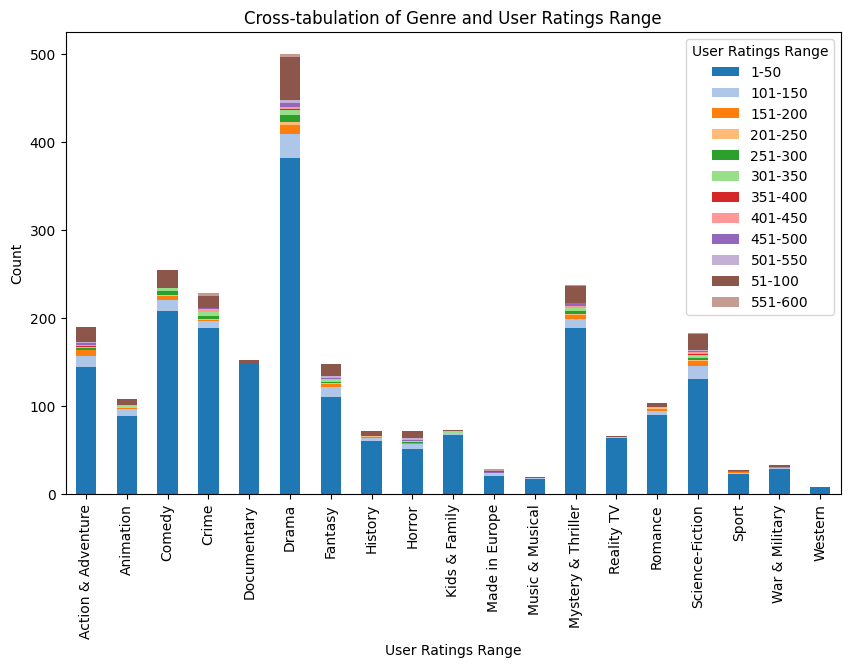

In [ ]:
import matplotlib.pyplot as plt

# Create the cross-tabulation dataframe and drop the 'No Value' row
crosstab_data = pd.crosstab(tvshows['Genre'], tvshows['UserRatings_Range']).iloc[:, :-1].drop('No Value', axis=0)

# Define a color palette
color_palette = plt.cm.get_cmap('tab20')

# Plotting the data
fig, ax = plt.subplots(figsize=(10, 6))
crosstab_data.plot(kind='bar', stacked=True, ax=ax, color=color_palette(np.arange(len(crosstab_data.columns))))

# Set labels and title
ax.set_xlabel('User Ratings Range')
ax.set_ylabel('Count')
ax.set_title('Cross-tabulation of Genre and User Ratings Range')

# Add legend
ax.legend(title='User Ratings Range', bbox_to_anchor=(1, 1))

# Show the plot
plt.show()


<ipython-input-1515-6808f0c6d371>:7: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_palette = plt.cm.get_cmap('tab20')


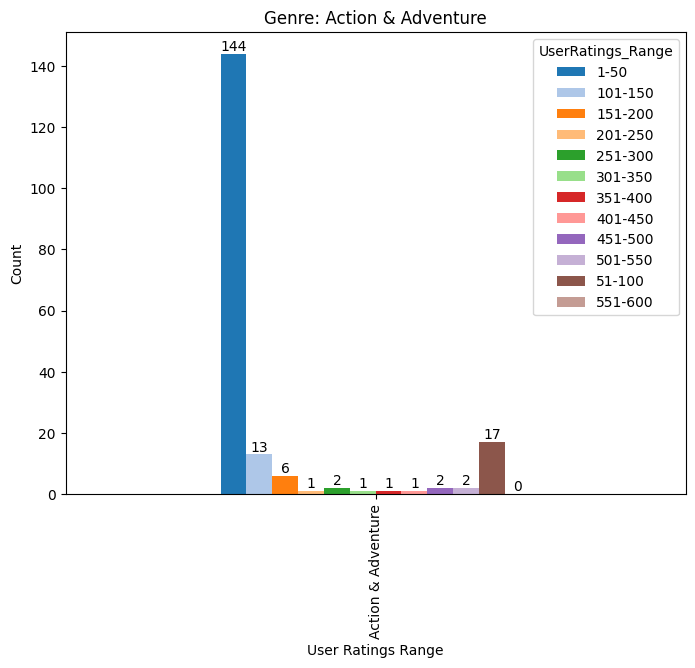

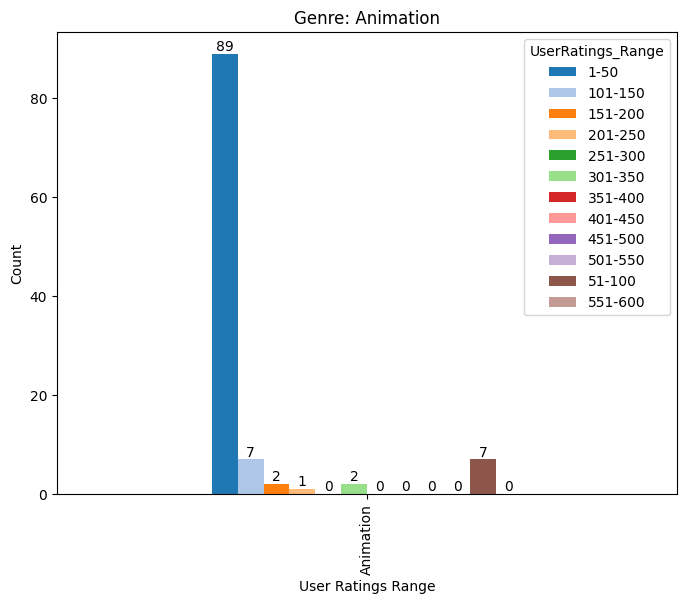

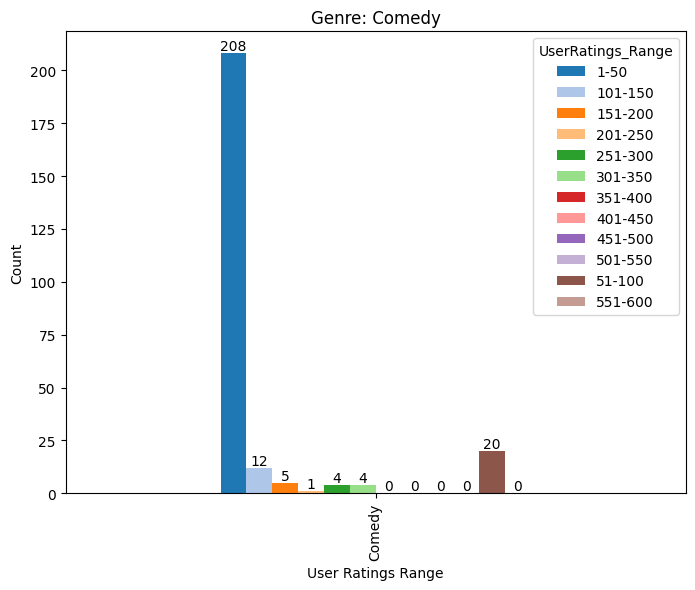

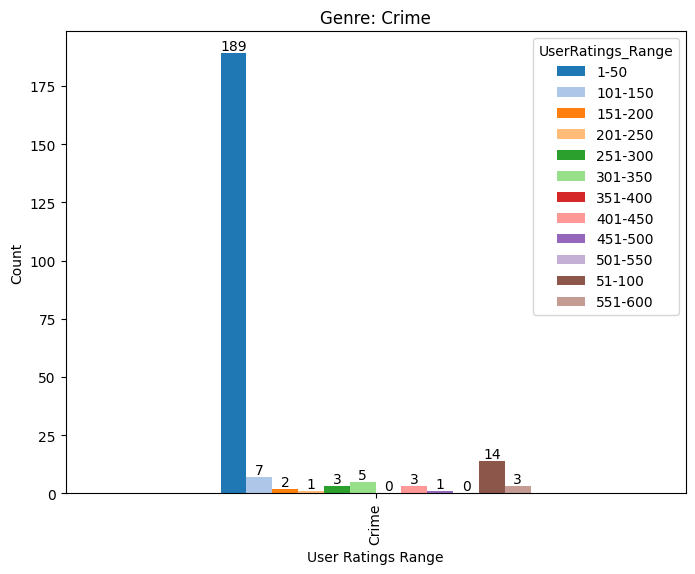

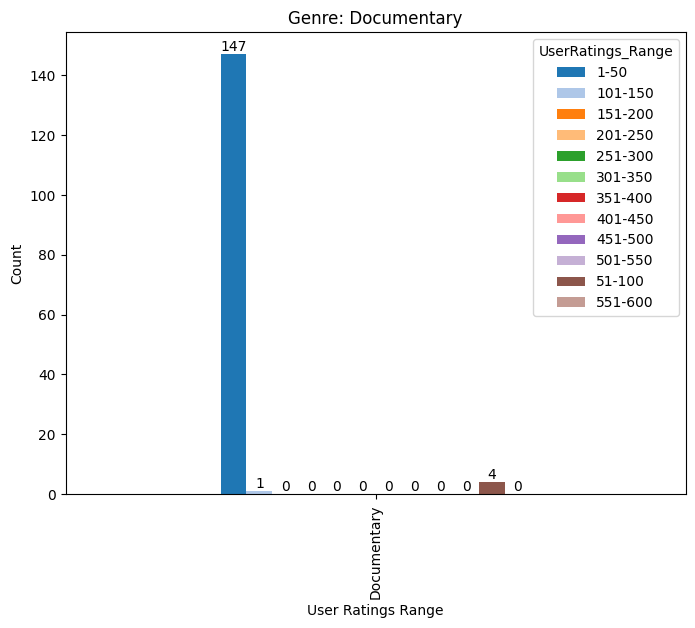

...

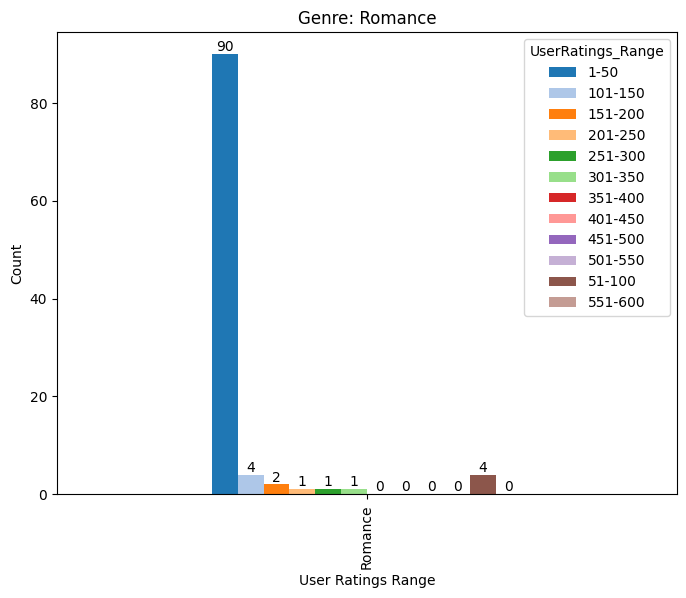

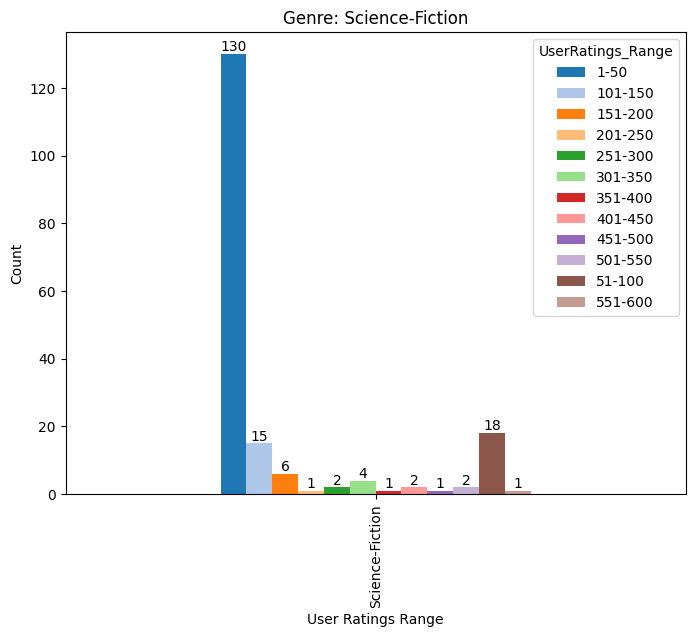

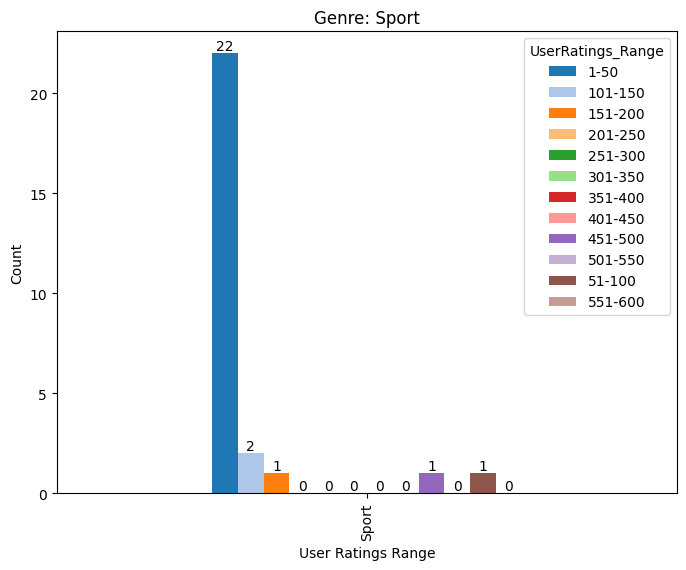

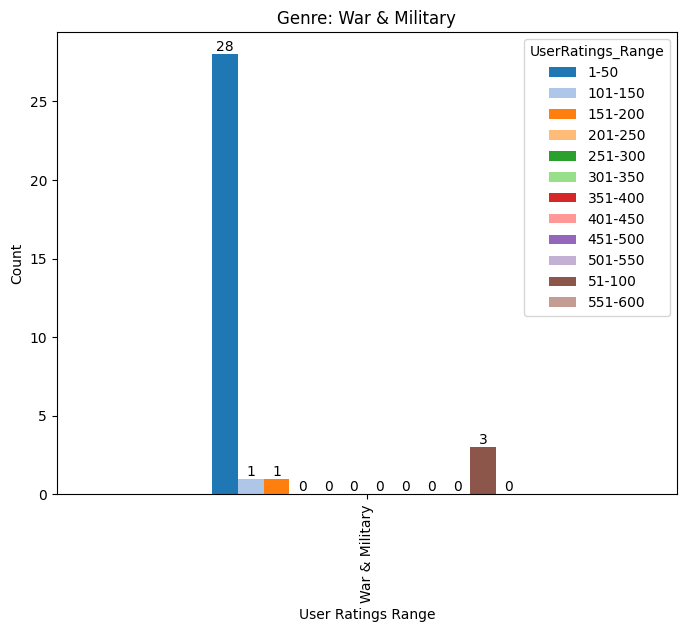

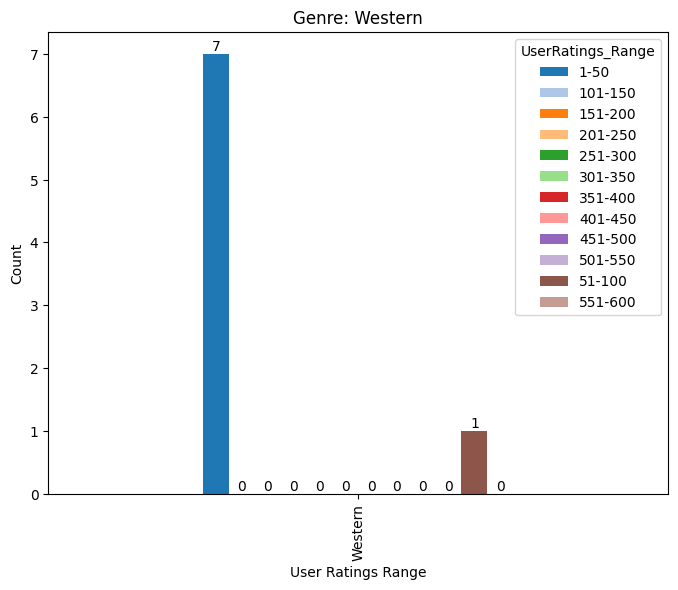

In [ ]:
import matplotlib.pyplot as plt

# Create the cross-tabulation dataframe and drop the 'No Value' row
crosstab_data = pd.crosstab(tvshows['Genre'], tvshows['UserRatings_Range']).iloc[:, :-1].drop('No Value', axis=0)

# Define a color palette
color_palette = plt.cm.get_cmap('tab20')

# Iterate through each genre and create individual plots
for genre in crosstab_data.index:
    # Plotting the data for each genre
    fig, ax = plt.subplots(figsize=(8, 6))
    genre_data = crosstab_data.loc[[genre]]
    genre_data.plot(kind='bar', ax=ax, color=color_palette(np.arange(len(genre_data.columns))))

    # Set labels and title for each plot
    ax.set_xlabel('User Ratings Range')
    ax.set_ylabel('Count')
    ax.set_title(f'Genre: {genre}')

    # Add bar labels
    for p in ax.patches:
        ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2, p.get_height()),
                    ha='center', va='bottom')

    # Show each plot
    plt.show()


# TV Shows Genre Datasets

drama_tvshows: Subset of TV shows with the genre 'Drama'

comedy_tvshows: Subset of TV shows with the genre 'Comedy'

crime_tvshows: Subset of TV shows with the genre 'Crime'

mystery_thriller_tvshows: Subset of TV shows with the genre 'Mystery & Thriller'

action_adventure_tvshows: Subset of TV shows with the genre 'Action & Adventure'

science_fiction_tvshows: Subset of TV shows with the genre 'Science-Fiction'

documentary_tvshows: Subset of TV shows with the genre 'Documentary'

fantasy_tvshows: Subset of TV shows with the genre 'Fantasy'

animation_tvshows: Subset of TV shows with the genre 'Animation'

romance_tvshows: Subset of TV shows with the genre 'Romance'

reality_tv_tvshows: Subset of TV shows with the genre 'Reality TV'

kids_family_tvshows: Subset of TV shows with the genre 'Kids & Family'

horror_tvshows: Subset of TV shows with the genre 'Horror'

history_tvshows: Subset of TV shows with the genre 'History'

war_military_tvshows: Subset of TV shows with the genre 'War & Military'

sport_tvshows: Subset of TV shows with the genre 'Sport'

europe_tvshows: Subset of TV shows with the genre 'Made in Europe'

musical_tvshows: Subset of TV shows with the genre 'Music & Musical'

western_tvshows: Subset of TV shows with the genre 'Western'




In [ ]:
drama_tvshows = tvshows[tvshows['Genre'] == 'Drama']
comedy_tvshows = tvshows[tvshows['Genre'] == 'Comedy']
crime_tvshows = tvshows[tvshows['Genre'] == 'Crime']
mystery_thriller_tvshows = tvshows[tvshows['Genre'] == 'Mystery & Thriller']
action_adventure_tvshows = tvshows[tvshows['Genre'] == 'Action & Adventure']
science_fiction_tvshows = tvshows[tvshows['Genre'] == 'Science-Fiction']
documentary_tvshows = tvshows[tvshows['Genre'] == 'Documentary']
fantasy_tvshows = tvshows[tvshows['Genre'] == 'Fantasy']
animation_tvshows = tvshows[tvshows['Genre'] == 'Animation']
romance_tvshows = tvshows[tvshows['Genre'] == 'Romance']
reality_tv_tvshows = tvshows[tvshows['Genre'] == 'Reality TV']
kids_family_tvshows = tvshows[tvshows['Genre'] == 'Kids & Family']
horror_tvshows = tvshows[tvshows['Genre'] == 'Horror']
history_tvshows = tvshows[tvshows['Genre'] == 'History']
war_military_tvshows = tvshows[tvshows['Genre'] == 'War & Military']
sport_tvshows = tvshows[tvshows['Genre'] == 'Sport']
europe_tvshows = tvshows[tvshows['Genre'] == 'Made in Europe']
musical_tvshows = tvshows[tvshows['Genre'] == 'Music & Musical']
western_tvshows = tvshows[tvshows['Genre'] == 'Western']

# Drama TV Shows Analysis

In [ ]:
drama_tvshows.head()

,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
3,13 Reasons Why,TV-Show,Dylan Minnette,2017,2016-2020,Drama,58,55-60,84.0,80-90,7.5,7.6-8.0,302.0,301-350
5,1899,TV-Show,Emily Beecham,2022,2021-2025,Drama,53,50-55,83.0,80-90,7.3,7.1-7.5,97.0,51-100
17,42 Days of Darkness,TV-Show,Claudia di Girólamo,2022,2021-2025,Drama,46,45-50,70.0,70-80,6.5,6.6-7.0,1.0,1-50
20,45 RPM,TV-Show,Guiomar Puerta,2019,2016-2020,Drama,57,55-60,76.0,70-80,7.2,7.1-7.5,0.0,nan
29,A Girl and an Astronaut,TV-Show,Bartosz Prokopowicz,2023,2021-2025,Drama,47,45-50,63.0,60-70,4.8,4.6-5.0,1.0,1-50


#595 Drama TV Shows

In [ ]:
drama_tvshows.shape

(595, 14)

In [ ]:
drama_tvshows.Release_Year_Range.value_counts()

2021-2025    336
2016-2020    191
2011-2015     40
2001-2005     12
2006-2010     11
1996-2000      3
1991-1995      1
1981-1985      1
Name: Release_Year_Range, dtype: int64

In [ ]:
drama_tvshows.JustWatch_Range.value_counts()

80-90     242
70-80     194
90-100     79
60-70      39
40-50      16
30-40      10
50-60       7
20-30       3
0-10        2
10-20       2
nan         1
Name: JustWatch_Range, dtype: int64

In [ ]:
drama_tvshows.IMDB_Range.value_counts()

7.6-8.0     124
7.1-7.5     110
6.6-7.0      90
8.1-8.5      80
6.1-6.5      56
8.6-9.0      46
5.6-6.0      37
nan          25
5.1-5.5      15
4.6-5.0       6
9.1-9.5       2
3.6-4.0       2
9.6-10.0      1
4.1-4.5       1
Name: IMDB_Range, dtype: int64

In [ ]:
drama_tvshows.UserRatings_Range.value_counts()

1-50       382
nan         95
51-100      49
101-150     27
151-200     10
251-300      8
301-350      6
551-600      4
451-500      4
201-250      3
401-450      3
501-550      3
351-400      1
Name: UserRatings_Range, dtype: int64

In [ ]:
drama_tvshows.Runtime_Range.value_counts()

45-50      129
40-45      108
50-55       78
25-30       53
55-60       51
20-25       45
30-35       32
60-65       30
35-40       23
70-75       15
65-70       11
15-20        6
75-80        3
85-90        3
10-15        3
80-85        2
95-100       1
130-135      1
0-5          1
240-245      0
235-240      0
230-235      0
225-230      0
220-225      0
215-220      0
210-215      0
170-175      0
205-210      0
200-205      0
195-200      0
190-195      0
185-190      0
180-185      0
175-180      0
125-130      0
165-170      0
160-165      0
155-160      0
150-155      0
145-150      0
140-145      0
135-140      0
5-10         0
120-125      0
115-120      0
110-115      0
105-110      0
100-105      0
90-95        0
245-250      0
Name: Runtime_Range, dtype: int64

# **Drama TV Shows Summary Statistics**

Release Year:

Count: There are 595 drama TV shows in the dataset.
Mean: The average release year for drama TV shows is approximately 2018.7, indicating a relatively recent set of shows.
Standard Deviation: The release years of drama TV shows have a standard deviation of approximately 4.8, suggesting a moderate range of years.
Minimum: The earliest release year for a drama TV show in the dataset is 1984.
Maximum: The latest release year for a drama TV show in the dataset is 2023, indicating recent releases.
25th Percentile: 25% of the drama TV shows were released in or before the year 2018, indicating a distribution of shows from recent years.
50th Percentile (Median): 50% of the drama TV shows were released in or before the year 2020, providing the median release year.
75th Percentile: 75% of the drama TV shows were released in or before the year 2022, indicating a concentration of recent releases.

****

Runtime in Minutes:

Mean: The average runtime of drama TV shows is approximately 44.6 minutes, suggesting a typical duration for these shows.
Standard Deviation: The runtime of drama TV shows varies by approximately 13.9 minutes, indicating some variability in the show lengths.
Minimum: The shortest runtime for a drama TV show in the dataset is 2 minutes, possibly indicating short-form or episodic content.
Maximum: The longest runtime for a drama TV show in the dataset is 131 minutes, suggesting some shows may have extended episodes or special formats.
25th Percentile: 25% of the drama TV shows have a runtime of 38 minutes or less.
50th Percentile (Median): 50% of the drama TV shows have a runtime of 45 minutes or less, providing the median runtime.
75th Percentile: 75% of the drama TV shows have a runtime of 52 minutes or less.
****

Just Watch Rating in Percentage:

Mean: The average Just Watch rating for drama TV shows is approximately 78.1%, indicating a generally positive reception by viewers.
Standard Deviation: The Just Watch ratings for drama TV shows vary by approximately 13.4%, suggesting some variability in audience ratings.
Minimum: The lowest Just Watch rating for a drama TV show in the dataset is 6%.
Maximum: The highest Just Watch rating for a drama TV show in the dataset is 100%, indicating highly acclaimed shows.
25th Percentile: 25% of the drama TV shows have a Just Watch rating of 74% or lower.
50th Percentile (Median): 50% of the drama TV shows have a Just Watch rating of 80% or lower, providing the median rating.
75th Percentile: 75% of the drama TV shows have a Just Watch rating of 86% or lower.

****
IMDb Rating:

Mean: The average IMDb rating for drama TV shows is approximately 6.9 out of 10, suggesting a generally positive reception by viewers.
Standard Deviation: The IMDb ratings for drama TV shows have a standard deviation of approximately 1.7, indicating some variability in the ratings.
Minimum: The lowest IMDb rating for a drama TV show in the dataset is 0.
Maximum: The highest IMDb rating for a drama TV show in the dataset is 9.5.
25th Percentile: 25% of the drama TV shows have an IMDb rating of 6.5 or lower.
50th Percentile (Median): 50% of the drama TV shows have an IMDb rating of 7.3 or lower, providing the median rating.
75th Percentile: 75% of the drama TV shows have an IMDb rating of 7.9 or lower.
****

User Ratings Value (K):

Mean: The average user ratings value for drama TV shows is approximately 51 thousand, indicating a moderate level of user engagement.
Standard Deviation: The user ratings values for drama TV shows have a wide standard deviation of approximately 127 thousand, suggesting a large range of user ratings.
Minimum: The lowest user ratings value for a drama TV show in the dataset is 0 thousand.
Maximum: The highest user ratings value for a drama TV show in the dataset is 1000 thousand, indicating highly popular shows.
25th Percentile: 25% of the drama TV shows have a user ratings value of 2 thousand or lower.
50th Percentile (Median): 50% of the drama TV shows have a user ratings value of 9 thousand or lower, providing the median value.
75th Percentile: 75% of the drama TV shows have a user ratings value of 39 thousand or lower.

In [ ]:
drama_tvshows.describe()

,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,595.000000,595.000000,595.000000,595.000000,595.000000
mean,2018.729412,44.647059,78.058824,6.905882,51.023529
std,4.804150,13.861501,13.429887,1.712850,126.975856
min,1984.000000,2.000000,6.000000,0.000000,0.000000
25%,2018.000000,38.000000,74.000000,6.500000,2.000000
50%,2020.000000,45.000000,80.000000,7.300000,9.000000
75%,2022.000000,52.000000,86.000000,7.900000,39.000000
max,2023.000000,131.000000,100.000000,9.500000,1000.000000


# Drama TV Shows Correlation


Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately 0.237. This indicates a weak positive correlation, suggesting that drama TV shows released in later years tend to have slightly longer runtimes.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.251. This suggests a weak negative correlation, indicating that drama TV shows released in later years may have slightly lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.253. This indicates a weak negative correlation, suggesting that drama TV shows released in later years may have slightly lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.277. This indicates a weak negative correlation, suggesting that drama TV shows released in later years may have slightly lower user ratings values (in thousands).

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.072. This indicates a weak positive correlation, suggesting that drama TV shows with longer runtimes may have slightly higher Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.034. This indicates a very weak positive correlation, suggesting that the runtime of drama TV shows has minimal influence on their IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.103. This indicates a weak positive correlation, suggesting that drama TV shows with longer runtimes may have slightly higher user ratings values (in thousands).

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.844. This indicates a strong positive correlation, suggesting that drama TV shows with higher Just Watch rating percentages tend to have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.302. This indicates a weak positive correlation, suggesting that drama TV shows with higher Just Watch rating percentages may have slightly higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.275. This indicates a weak positive correlation, suggesting that drama TV shows with higher IMDB ratings may have slightly higher user ratings values (in thousands).

In [ ]:
drama_tvshows.corr()

<ipython-input-1525-fb35451efbe5>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  drama_tvshows.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,0.237414,-0.250924,-0.253023,-0.277288
Runtime_In_Minutes,0.237414,1.000000,0.072187,0.033789,0.102925
Just_Watch_Rating_In_Percentage,-0.250924,0.072187,1.000000,0.844298,0.301806
IMDB_Rating,-0.253023,0.033789,0.844298,1.000000,0.275118
User_Ratings_Value_K,-0.277288,0.102925,0.301806,0.275118,1.000000


<ipython-input-1526-734f681e7ae2>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(drama_tvshows.corr(),cmap='coolwarm',annot=True)


<Axes: >

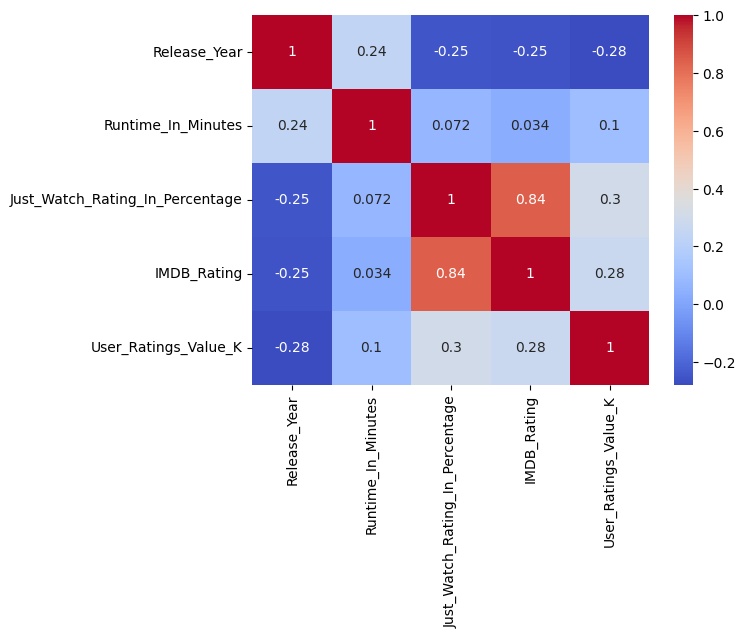

In [ ]:

sns.heatmap(drama_tvshows.corr(),cmap='coolwarm',annot=True)

In [ ]:


drama_tvshows_correlation_matrix = drama_tvshows.corr()
drama_tvshows_correlation_table = drama_tvshows_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
drama_tvshows_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
drama_tvshows_correlation_table['Correlation Type'] = drama_tvshows_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
drama_tvshows_correlation_table['Correlation Strength'] = drama_tvshows_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


drama_tvshows_correlation_table


<ipython-input-1527-ca9bbd9c62d3>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  drama_tvshows_correlation_matrix = drama_tvshows.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.844298,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.844298,Positive,Strong
7,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.301806,Positive,Weak
8,Just_Watch_Rating_In_Percentage,User_Ratings_Value_K,0.301806,Positive,Weak
9,IMDB_Rating,User_Ratings_Value_K,0.275118,Positive,Weak


# Comedy TV Shows Analysis

In [ ]:
comedy_tvshows.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
0,#blackAF,TV-Show,Kenya Barris,2020,2021-2025,Comedy,37,35-40,38.0,30-40,0.0,nan,0.0,nan
11,3Below: Tales of Arcadia,TV-Show,Tatiana Maslany,2018,2016-2020,Comedy,22,20-25,82.0,80-90,7.7,7.6-8.0,6.0,1-50
33,A Korean Odyssey,TV-Show,Park Hong-kyun,2017,2016-2020,Comedy,75,75-80,88.0,80-90,8.0,8.1-8.5,5.0,1-50
42,A Series of Unfortunate Events,TV-Show,Neil Patrick Harris,2017,2016-2020,Comedy,47,45-50,84.0,80-90,7.8,7.6-8.0,63.0,51-100
47,A Storm for Christmas,TV-Show,Per-Olav Sørensen,2022,2021-2025,Comedy,34,30-35,76.0,70-80,7.1,7.1-7.5,3.0,1-50


#317 Comedy TV Shows

In [ ]:
comedy_tvshows.shape


(317, 14)

In [ ]:
comedy_tvshows.Release_Year_Range.value_counts()


2021-2025    153
2016-2020    107
2011-2015     25
2001-2005     14
2006-2010      6
1996-2000      5
1991-1995      4
nan            1
1986-1990      1
1981-1985      1
Name: Release_Year_Range, dtype: int64

In [ ]:
comedy_tvshows.JustWatch_Range.value_counts()


80-90     137
70-80      90
90-100     40
60-70      29
50-60       8
40-50       7
30-40       5
0-10        1
Name: JustWatch_Range, dtype: int64

In [ ]:
comedy_tvshows.IMDB_Range.value_counts()


7.6-8.0    66
7.1-7.5    58
6.6-7.0    50
8.1-8.5    49
6.1-6.5    27
8.6-9.0    25
5.6-6.0    19
nan         9
5.1-5.5     6
4.6-5.0     4
9.1-9.5     2
3.6-4.0     1
2.6-3.0     1
Name: IMDB_Range, dtype: int64

In [ ]:
comedy_tvshows.UserRatings_Range.value_counts()


1-50       208
nan         63
51-100      20
101-150     12
151-200      5
301-350      4
251-300      4
201-250      1
Name: UserRatings_Range, dtype: int64

In [ ]:
comedy_tvshows.Runtime_Range.value_counts()


25-30      85
20-25      71
30-35      40
40-45      25
45-50      20
50-55      15
35-40      14
15-20      13
10-15       8
55-60       7
60-65       5
70-75       4
65-70       3
5-10        2
75-80       2
80-85       1
85-90       1
130-135     1
180-185     0
185-190     0
190-195     0
195-200     0
200-205     0
205-210     0
0-5         0
210-215     0
215-220     0
220-225     0
225-230     0
230-235     0
235-240     0
240-245     0
170-175     0
175-180     0
125-130     0
165-170     0
160-165     0
155-160     0
150-155     0
145-150     0
140-145     0
135-140     0
120-125     0
115-120     0
110-115     0
105-110     0
100-105     0
95-100      0
90-95       0
245-250     0
Name: Runtime_Range, dtype: int64

#**Comedy TV Shows Summary Statistics**

Release Year:

Count: There are 317 comedy TV shows in the dataset.
Mean: The average release year for comedy TV shows is approximately 2017.1, indicating a relatively recent set of shows.
Standard Deviation: The release years of comedy TV shows have a standard deviation of approximately 7.2, suggesting a moderate range of years.
Minimum: The earliest release year for a comedy TV show in the dataset is 1969.
Maximum: The latest release year for a comedy TV show in the dataset is 2023, indicating recent releases.
25th Percentile: 25% of the comedy TV shows were released in or before the year 2016, indicating a distribution of shows from recent years.
50th Percentile (Median): 50% of the comedy TV shows were released in or before the year 2019, providing the median release year.
75th Percentile: 75% of the comedy TV shows were released in or before the year 2022, indicating a concentration of recent releases.
****

Runtime in Minutes:

Mean: The average runtime of comedy TV shows is approximately 32.8 minutes, suggesting a relatively short duration for these shows.
Standard Deviation: The runtime of comedy TV shows varies by approximately 14.6 minutes, indicating some variability in the episode lengths.
Minimum: The shortest runtime for a comedy TV show in the dataset is 7 minutes, possibly indicating short-form or episodic content.
Maximum: The longest runtime for a comedy TV show in the dataset is 131 minutes, suggesting some shows may have extended episodes.
25th Percentile: 25% of the comedy TV shows have an episode runtime of 24 minutes or less.
50th Percentile (Median): 50% of the comedy TV shows have an episode runtime of 28 minutes or less, providing the median runtime.
75th Percentile: 75% of the comedy TV shows have an episode runtime of 41 minutes or less.
****

Just Watch Rating in Percentage:

Mean: The average Just Watch rating for comedy TV shows is approximately 78.3%, indicating a generally positive reception by viewers.
Standard Deviation: The Just Watch ratings for comedy TV shows vary by approximately 12.2%, suggesting some variability in audience ratings.
Minimum: The lowest Just Watch rating for a comedy TV show in the dataset is 7%.
Maximum: The highest Just Watch rating for a comedy TV show in the dataset is 98%, indicating highly acclaimed shows.
25th Percentile: 25% of the comedy TV shows have a Just Watch rating of 73% or lower.
50th Percentile (Median): 50% of the comedy TV shows have a Just Watch rating of 81% or lower, providing the median rating.
75th Percentile: 75% of the comedy TV shows have a Just Watch rating of 86% or lower.
****

IMDb Rating:

Mean: The average IMDb rating for comedy TV shows is approximately 7.0 out of 10, suggesting a generally positive reception by viewers.
Standard Deviation: The IMDb ratings for comedy TV shows have a standard deviation of approximately 1.5, indicating some variability in the ratings.
Minimum: The lowest IMDb rating for a comedy TV show in the dataset is 0.
Maximum: The highest IMDb rating for a comedy TV show in the dataset is 9.3.
25th Percentile: 25% of the comedy TV shows have an IMDb rating of 6.6 or lower.
50th Percentile (Median): 50% of the comedy TV shows have an IMDb rating of 7.3 or lower, providing the median rating.
75th Percentile: 75% of the comedy TV shows have an IMDb rating of 7.9 or lower.
****

User Ratings Value (K):

Mean: The average user ratings value for comedy TV shows is approximately 27.2 thousand.
Standard Deviation: The user ratings values for comedy TV shows vary by approximately 55.7 thousand.
Minimum: The lowest user ratings value for a comedy TV show in the dataset is 0 thousand.
Maximum: The highest user ratings value for a comedy TV show in the dataset is 331 thousand.
25th Percentile: 25% of the comedy TV shows have a user ratings value of 1 thousand or lower.
50th Percentile (Median): 50% of the comedy TV shows have a user ratings value of 6 thousand or lower, providing the median value.
75th Percentile: 75% of the comedy TV shows have a user ratings value of 22 thousand or lower.

In [ ]:
comedy_tvshows.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,317.000000,317.000000,317.000000,317.000000,317.000000
mean,2017.116719,32.757098,78.274448,7.029022,27.205047
std,7.199833,14.588696,12.216808,1.539268,55.671552
min,1969.000000,7.000000,7.000000,0.000000,0.000000
25%,2016.000000,24.000000,73.000000,6.600000,1.000000
50%,2019.000000,28.000000,81.000000,7.300000,6.000000
75%,2022.000000,41.000000,86.000000,7.900000,22.000000
max,2023.000000,131.000000,98.000000,9.300000,331.000000


# **Comedy TV Shows Correlation**


Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately 0.174. This indicates a weak positive correlation, suggesting that comedy TV shows released in later years tend to have slightly longer runtimes.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.232. This suggests a weak negative correlation, indicating that comedy TV shows released in later years may have slightly lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.223. This indicates a weak negative correlation, suggesting that comedy TV shows released in later years may have slightly lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.298. This indicates a weak negative correlation, suggesting that comedy TV shows released in later years may have slightly lower user ratings values (in thousands).

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.128. This indicates a weak positive correlation, suggesting that comedy TV shows with longer runtimes may have slightly higher Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.109. This indicates a very weak positive correlation, suggesting that the runtime of comedy TV shows has minimal influence on their IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.054. This indicates a very weak positive correlation, suggesting that the runtime of comedy TV shows has minimal influence on their user ratings values (in thousands).

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.779. This indicates a strong positive correlation, suggesting that comedy TV shows with higher Just Watch rating percentages tend to have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.337. This indicates a weak positive correlation, suggesting that comedy TV shows with higher Just Watch rating percentages may have slightly higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.322. This indicates a weak positive correlation, suggesting that comedy TV shows with higher IMDB ratings may have slightly higher user ratings values (in thousands).

In [ ]:
comedy_tvshows.corr()


<ipython-input-1536-145320f32446>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  comedy_tvshows.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,0.173538,-0.231738,-0.222661,-0.298447
Runtime_In_Minutes,0.173538,1.000000,0.128430,0.108699,0.054350
Just_Watch_Rating_In_Percentage,-0.231738,0.128430,1.000000,0.778828,0.337400
IMDB_Rating,-0.222661,0.108699,0.778828,1.000000,0.321990
User_Ratings_Value_K,-0.298447,0.054350,0.337400,0.321990,1.000000


<ipython-input-1537-eb5b1dd64431>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(comedy_tvshows.corr(),cmap='coolwarm',annot=True)


<Axes: >

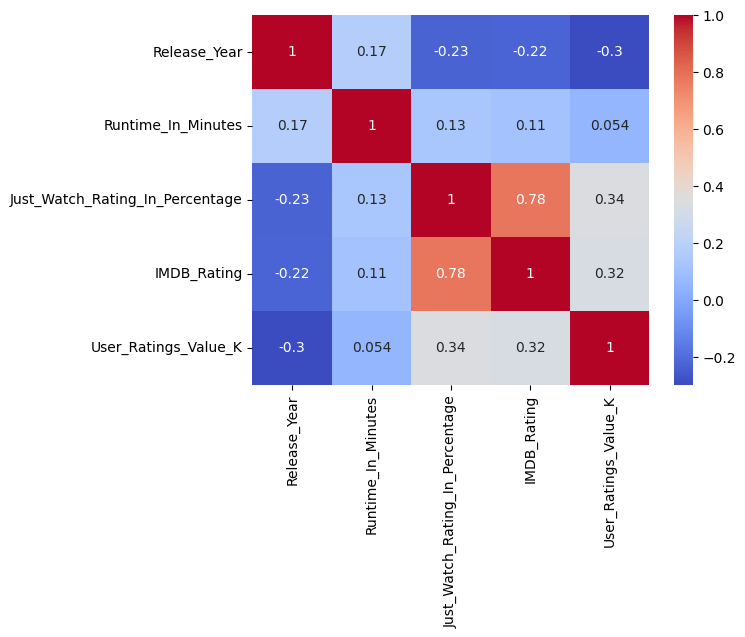

In [ ]:

sns.heatmap(comedy_tvshows.corr(),cmap='coolwarm',annot=True)


In [ ]:

comedy_tvshows_correlation_matrix = comedy_tvshows.corr()
comedy_tvshows_correlation_table = comedy_tvshows_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
comedy_tvshows_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
comedy_tvshows_correlation_table['Correlation Type'] = comedy_tvshows_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
comedy_tvshows_correlation_table['Correlation Strength'] = comedy_tvshows_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


comedy_tvshows_correlation_table


<ipython-input-1538-0a741cb776de>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  comedy_tvshows_correlation_matrix = comedy_tvshows.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.778828,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.778828,Positive,Strong
7,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.337400,Positive,Weak
8,Just_Watch_Rating_In_Percentage,User_Ratings_Value_K,0.337400,Positive,Weak
9,IMDB_Rating,User_Ratings_Value_K,0.321990,Positive,Weak


# Crime TV Shows Analysis

In [ ]:
crime_tvshows.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
18,42 Days of Darkness,TV-Show,Claudia di Girólamo,2022,2021-2025,Crime,46,45-50,70.0,70-80,6.5,6.6-7.0,1.0,1-50
25,800 Meters,TV-Show,Elías León Siminiani,2022,2021-2025,Crime,52,50-55,70.0,70-80,7.0,7.1-7.5,0.0,nan
31,A Kidnapping Scandal: The Florence Cassez Affair,TV-Show,Gerardo Naranjo,2022,2021-2025,Crime,58,55-60,74.0,70-80,7.0,7.1-7.5,0.0,nan
41,A Model Family,TV-Show,Kim Jin-woo,2022,2021-2025,Crime,45,45-50,78.0,70-80,6.6,6.6-7.0,1.0,1-50
49,Abla Fahita: Drama Queen,TV-Show,Khaled Marei,2021,2021-2025,Crime,25,25-30,72.0,70-80,6.6,6.6-7.0,0.0,nan


#269 Crime TV Shows

In [ ]:
crime_tvshows.shape

(269, 14)

In [ ]:
crime_tvshows.Release_Year_Range.value_counts()

2021-2025    166
2016-2020     82
2011-2015     13
2001-2005      6
2006-2010      2
Name: Release_Year_Range, dtype: int64

In [ ]:
crime_tvshows.JustWatch_Range.value_counts()

70-80     126
80-90      91
90-100     23
60-70      14
30-40       8
40-50       3
50-60       2
0-10        1
nan         1
Name: JustWatch_Range, dtype: int64

In [ ]:
crime_tvshows.IMDB_Range.value_counts()

7.1-7.5     66
6.6-7.0     57
7.6-8.0     47
8.1-8.5     32
6.1-6.5     26
8.6-9.0     18
5.6-6.0     14
nan          3
5.1-5.5      3
4.6-5.0      2
9.6-10.0     1
Name: IMDB_Range, dtype: int64

In [ ]:
crime_tvshows.UserRatings_Range.value_counts()

1-50       189
nan         41
51-100      14
101-150      7
301-350      5
401-450      3
551-600      3
251-300      3
151-200      2
451-500      1
201-250      1
Name: UserRatings_Range, dtype: int64

In [ ]:
crime_tvshows.Runtime_Range.value_counts()

45-50      75
40-45      50
50-55      42
55-60      28
60-65      18
25-30      16
20-25      11
30-35       9
70-75       5
35-40       5
65-70       3
85-90       2
0-5         1
75-80       1
80-85       1
15-20       1
10-15       1
205-210     0
175-180     0
180-185     0
185-190     0
190-195     0
195-200     0
200-205     0
210-215     0
165-170     0
215-220     0
220-225     0
225-230     0
230-235     0
235-240     0
240-245     0
170-175     0
125-130     0
160-165     0
155-160     0
150-155     0
145-150     0
140-145     0
135-140     0
130-135     0
5-10        0
120-125     0
115-120     0
110-115     0
105-110     0
100-105     0
95-100      0
90-95       0
245-250     0
Name: Runtime_Range, dtype: int64

#**Crime TV Shows Summary Statistics**

Release Year:

Count: There are 269 crime TV shows in the dataset.
Mean: The average release year for crime TV shows is approximately 2019.5, indicating a relatively recent set of shows.
Standard Deviation: The release years of crime TV shows have a standard deviation of approximately 3.9, suggesting a moderate range of years.
Minimum: The earliest release year for a crime TV show in the dataset is 2000.
Maximum: The latest release year for a crime TV show in the dataset is 2023, indicating recent releases.
25th Percentile: 25% of the crime TV shows were released in or before the year 2018, indicating a distribution of shows from recent years.
50th Percentile (Median): 50% of the crime TV shows were released in or before the year 2021, providing the median release year.
75th Percentile: 75% of the crime TV shows were released in or before the year 2022, indicating a concentration of recent releases.


Runtime in Minutes:

Mean: The average runtime of crime TV shows is approximately 46.8 minutes, suggesting a moderate duration for these shows.
Standard Deviation: The runtime of crime TV shows varies by approximately 11.8 minutes, indicating some variability in the episode lengths.
Minimum: The shortest runtime for a crime TV show in the dataset is 2 minutes, which could be an anomaly or a special format episode.
Maximum: The longest runtime for a crime TV show in the dataset is 85 minutes, suggesting some shows may have extended episodes or different episode structures.
25th Percentile: 25% of the crime TV shows have an episode runtime of 43 minutes or less.
50th Percentile (Median): 50% of the crime TV shows have an episode runtime of 47 minutes or less, providing the median runtime.
75th Percentile: 75% of the crime TV shows have an episode runtime of 53 minutes or less.


Just Watch Rating in Percentage:

Mean: The average Just Watch rating for crime TV shows is approximately 77.2%, indicating a generally positive reception by viewers.
Standard Deviation: The Just Watch ratings for crime TV shows vary by approximately 12.1%, suggesting some variability in audience ratings.
Minimum: The lowest Just Watch rating for a crime TV show in the dataset is 6%.
Maximum: The highest Just Watch rating for a crime TV show in the dataset is 100%, indicating highly acclaimed shows.
25th Percentile: 25% of the crime TV shows have a Just Watch rating of 73% or lower.
50th Percentile (Median): 50% of the crime TV shows have a Just Watch rating of 78% or lower, providing the median rating.
75th Percentile: 75% of the crime TV shows have a Just Watch rating of 85% or lower.


IMDb Rating:

Mean: The average IMDb rating for crime TV shows is approximately 7.1 out of 10, suggesting a generally positive reception by viewers.
Standard Deviation: The IMDb ratings for crime TV shows have a standard deviation of approximately 1.1, indicating some variability in the ratings.
Minimum: The lowest IMDb rating for a crime TV show in the dataset is 0.
Maximum: The highest IMDb rating for a crime TV show in the dataset is 9.5.
25th Percentile: 25% of the crime TV shows have an IMDb rating of 6.6 or lower.
50th Percentile (Median): 50% of the crime TV shows have an IMDb rating of 7.1 or lower, providing the median rating.
75th Percentile: 75% of the crime TV shows have an IMDb rating of 7.8 or lower.


User Ratings Value (K):

Mean: The average user ratings value for crime TV shows is approximately 42.4 thousand.
Standard Deviation: The user ratings values for crime TV shows vary by approximately 112.6 thousand.
Minimum: The lowest user ratings value for a crime TV show in the dataset is 0 thousand.
Maximum: The highest user ratings value for a crime TV show in the dataset is 1000 thousand, indicating potentially highly popular shows.
25th Percentile: 25% of the crime TV shows have a user ratings value of 1 thousand or lower.
50th Percentile (Median): 50% of the crime TV shows have a user ratings value of 5 thousand or lower, providing the median value.
75th Percentile: 75% of the crime TV shows have a user ratings value of 26 thousand or lower.

In [ ]:
crime_tvshows.describe()

,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,269.000000,269.000000,269.000000,269.000000,269.000000
mean,2019.468401,46.832714,77.182156,7.104461,42.375465
std,3.857045,11.811244,12.113899,1.118325,112.603370
min,2000.000000,2.000000,6.000000,0.000000,0.000000
25%,2018.000000,43.000000,73.000000,6.600000,1.000000
50%,2021.000000,47.000000,78.000000,7.100000,5.000000
75%,2022.000000,53.000000,85.000000,7.800000,26.000000
max,2023.000000,85.000000,100.000000,9.500000,1000.000000


#**Crime TV Shows Correlation**


Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately 0.168. This indicates a weak positive correlation, suggesting that crime TV shows released in later years tend to have slightly longer runtimes.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.368. This suggests a moderate negative correlation, indicating that crime TV shows released in later years may have slightly lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.380. This indicates a moderate negative correlation, suggesting that crime TV shows released in later years may have slightly lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.394. This indicates a moderate negative correlation, suggesting that crime TV shows released in later years may have slightly lower user ratings values (in thousands).

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.005. This indicates a very weak positive correlation, suggesting that the runtime of crime TV shows has minimal influence on their Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.021. This indicates a very weak positive correlation, suggesting that the runtime of crime TV shows has minimal influence on their IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.039. This indicates a very weak positive correlation, suggesting that the runtime of crime TV shows has minimal influence on their user ratings values (in thousands).

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.690. This indicates a strong positive correlation, suggesting that crime TV shows with higher Just Watch rating percentages tend to have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.328. This indicates a weak positive correlation, suggesting that crime TV shows with higher Just Watch rating percentages may have slightly higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.383. This indicates a moderate positive correlation, suggesting that crime TV shows with higher IMDB ratings may have slightly higher user ratings values (in thousands).

In [ ]:
crime_tvshows.corr()

<ipython-input-1547-5199861f0797>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  crime_tvshows.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,0.167995,-0.367510,-0.379725,-0.393776
Runtime_In_Minutes,0.167995,1.000000,0.005195,0.020820,0.039359
Just_Watch_Rating_In_Percentage,-0.367510,0.005195,1.000000,0.690143,0.327956
IMDB_Rating,-0.379725,0.020820,0.690143,1.000000,0.382614
User_Ratings_Value_K,-0.393776,0.039359,0.327956,0.382614,1.000000


<ipython-input-1548-bc6fa6776338>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(crime_tvshows.corr(),cmap='coolwarm',annot=True)


<Axes: >

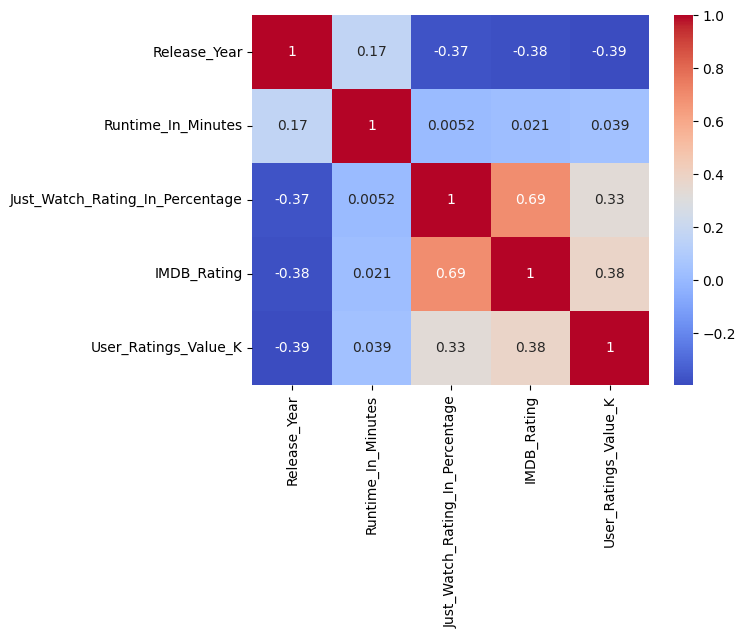

In [ ]:

sns.heatmap(crime_tvshows.corr(),cmap='coolwarm',annot=True)

In [ ]:

crime_tvshows_correlation_matrix = crime_tvshows.corr()
crime_tvshows_correlation_table = crime_tvshows_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
crime_tvshows_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
crime_tvshows_correlation_table['Correlation Type'] = crime_tvshows_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
crime_tvshows_correlation_table['Correlation Strength'] = crime_tvshows_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


crime_tvshows_correlation_table


<ipython-input-1549-28b43a89c959>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  crime_tvshows_correlation_matrix = crime_tvshows.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.690143,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.690143,Positive,Strong
7,User_Ratings_Value_K,IMDB_Rating,0.382614,Positive,Weak
8,IMDB_Rating,User_Ratings_Value_K,0.382614,Positive,Weak
9,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.327956,Positive,Weak


# Mystery Thriller TV Shows Analysis

In [ ]:
mystery_thriller_tvshows.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
4,13 Reasons Why,TV-Show,Dylan Minnette,2017,2016-2020,Mystery & Thriller,58,55-60,84.0,80-90,7.5,7.6-8.0,302.0,301-350
19,42 Days of Darkness,TV-Show,Claudia di Girólamo,2022,2021-2025,Mystery & Thriller,46,45-50,70.0,70-80,6.5,6.6-7.0,1.0,1-50
40,A Model Family,TV-Show,Kim Jin-woo,2022,2021-2025,Mystery & Thriller,45,45-50,78.0,70-80,6.6,6.6-7.0,1.0,1-50
77,Agent Elvis,TV-Show,Matthew McConaughey,2023,2021-2025,Mystery & Thriller,30,30-35,79.0,70-80,6.9,6.6-7.0,1.0,1-50
91,Alchemy of Souls,TV-Show,Lee Jae-wook,2022,2021-2025,Mystery & Thriller,79,75-80,96.0,90-100,8.8,8.6-9.0,11.0,1-50


# 265 Myster and Thriller TV Shows

In [ ]:
mystery_thriller_tvshows.shape


(265, 14)

In [ ]:
mystery_thriller_tvshows.Release_Year_Range.value_counts()


2021-2025    156
2016-2020     81
2011-2015     15
2001-2005      8
2006-2010      3
1996-2000      2
Name: Release_Year_Range, dtype: int64

In [ ]:
mystery_thriller_tvshows.JustWatch_Range.value_counts()


70-80     106
80-90      96
90-100     33
60-70      16
40-50       5
30-40       4
50-60       3
0-10        1
nan         1
Name: JustWatch_Range, dtype: int64

In [ ]:
mystery_thriller_tvshows.IMDB_Range.value_counts()


7.1-7.5     56
6.6-7.0     49
7.6-8.0     44
8.1-8.5     32
6.1-6.5     26
8.6-9.0     21
5.6-6.0     21
5.1-5.5      9
nan          3
9.6-10.0     1
3.6-4.0      1
4.1-4.5      1
4.6-5.0      1
Name: IMDB_Range, dtype: int64

In [ ]:
mystery_thriller_tvshows.UserRatings_Range.value_counts()


1-50       189
nan         28
51-100      19
101-150     10
151-200      4
251-300      4
301-350      3
401-450      3
451-500      3
551-600      1
201-250      1
Name: UserRatings_Range, dtype: int64

In [ ]:
mystery_thriller_tvshows.Runtime_Range.value_counts()


45-50      71
40-45      48
50-55      35
20-25      23
55-60      21
25-30      18
60-65      16
35-40       9
30-35       8
70-75       6
65-70       3
10-15       2
85-90       2
75-80       2
0-5         1
205-210     0
175-180     0
170-175     0
180-185     0
185-190     0
190-195     0
195-200     0
200-205     0
235-240     0
210-215     0
215-220     0
220-225     0
225-230     0
230-235     0
160-165     0
240-245     0
165-170     0
125-130     0
155-160     0
110-115     0
15-20       0
80-85       0
90-95       0
95-100      0
100-105     0
105-110     0
115-120     0
150-155     0
120-125     0
5-10        0
130-135     0
135-140     0
140-145     0
145-150     0
245-250     0
Name: Runtime_Range, dtype: int64

#**Mystery and Thriller TV Shows Summary Statistics**

Release Year:

Count: There are 265 mystery and thriller TV shows in the dataset.
Mean: The average release year for mystery and thriller TV shows is approximately 2018.9, indicating a relatively recent set of shows.
Standard Deviation: The release years of mystery and thriller TV shows have a standard deviation of approximately 4.8, suggesting a moderate range of years.
Minimum: The earliest release year for a mystery and thriller TV show in the dataset is 1995.
Maximum: The latest release year for a mystery and thriller TV show in the dataset is 2023, indicating recent releases.
25th Percentile: 25% of the mystery and thriller TV shows were released in or before the year 2018, indicating a distribution of shows from recent years.
50th Percentile (Median): 50% of the mystery and thriller TV shows were released in or before the year 2020, providing the median release year.
75th Percentile: 75% of the mystery and thriller TV shows were released in or before the year 2022, indicating a concentration of recent releases.

****
Runtime in Minutes:

Mean: The average runtime of mystery and thriller TV shows is approximately 45.1 minutes, suggesting a moderate duration for these shows.
Standard Deviation: The runtime of mystery and thriller TV shows varies by approximately 12.9 minutes, indicating some variability in the episode lengths.
Minimum: The shortest runtime for a mystery and thriller TV show in the dataset is 2 minutes, which could be an anomaly or a special format episode.
Maximum: The longest runtime for a mystery and thriller TV show in the dataset is 88 minutes, suggesting some shows may have extended episodes or different episode structures.
25th Percentile: 25% of the mystery and thriller TV shows have an episode runtime of 41 minutes or less.
50th Percentile (Median): 50% of the mystery and thriller TV shows have an episode runtime of 46 minutes or less, providing the median runtime.
75th Percentile: 75% of the mystery and thriller TV shows have an episode runtime of 52 minutes or less.

****
Just Watch Rating in Percentage:

Mean: The average Just Watch rating for mystery and thriller TV shows is approximately 78.4%, indicating a generally positive reception by viewers.
Standard Deviation: The Just Watch ratings for mystery and thriller TV shows vary by approximately 11.9%, suggesting some variability in audience ratings.
Minimum: The lowest Just Watch rating for a mystery and thriller TV show in the dataset is 6%.
Maximum: The highest Just Watch rating for a mystery and thriller TV show in the dataset is 100%, indicating highly acclaimed shows.
25th Percentile: 25% of the mystery and thriller TV shows have a Just Watch rating of 73% or lower.
50th Percentile (Median): 50% of the mystery and thriller TV shows have a Just Watch rating of 79% or lower, providing the median rating.
75th Percentile: 75% of the mystery and thriller TV shows have a Just Watch rating of 86% or lower.

****
IMDb Rating:

Mean: The average IMDb rating for mystery and thriller TV shows is approximately 7.0 out of 10, suggesting a generally positive reception by viewers.
Standard Deviation: The IMDb ratings for mystery and thriller TV shows have a standard deviation of approximately 1.2, indicating some variability in the ratings.
Minimum: The lowest IMDb rating for a mystery and thriller TV show in the dataset is 0.0 out of 10.
Maximum: The highest IMDb rating for a mystery and thriller TV show in the dataset is 9.5 out of 10, indicating highly acclaimed shows.
25th Percentile: 25% of the mystery and thriller TV shows have an IMDb rating of 6.5 or lower.
50th Percentile (Median): 50% of the mystery and thriller TV shows have an IMDb rating of 7.1 or lower, providing the median rating.
75th Percentile: 75% of the mystery and thriller TV shows have an IMDb rating of 7.8 or lower.

****
User Ratings Value (K):

Mean: The average user ratings value for mystery and thriller TV shows is approximately 60.9 thousand, indicating a moderate level of user engagement.
Standard Deviation: The user ratings values for mystery and thriller TV shows have a standard deviation of approximately 158.6 thousand, indicating a wide range of user engagement levels.
Minimum: The lowest user ratings value for a mystery and thriller TV show in the dataset is 0 thousand, which could be an anomaly or a less popular show.
Maximum: The highest user ratings value for a mystery and thriller TV show in the dataset is 1000 thousand, indicating potentially highly popular shows.
25th Percentile: 25% of the mystery and thriller TV shows have a user ratings value of 3 thousand or lower.
50th Percentile (Median): 50% of the mystery and thriller TV shows have a user ratings value of 10 thousand or lower, providing the median value.
75th Percentile: 75% of the mystery and thriller TV shows have a user ratings value of 40 thousand or lower.

In [ ]:
mystery_thriller_tvshows.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,265.000000,265.000000,265.000000,265.000000,265.000000
mean,2018.909434,45.086792,78.358491,7.032075,60.913208
std,4.766449,12.940570,11.940659,1.215676,158.551934
min,1995.000000,2.000000,6.000000,0.000000,0.000000
25%,2018.000000,41.000000,73.000000,6.500000,3.000000
50%,2020.000000,46.000000,79.000000,7.100000,10.000000
75%,2022.000000,52.000000,86.000000,7.800000,40.000000
max,2023.000000,88.000000,100.000000,9.500000,1000.000000


#**Mystery and Thriller TV Shows Correlation**


Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately 0.288. This indicates a weak positive correlation, suggesting that mystery and thriller TV shows released in later years tend to have slightly longer runtimes.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.337. This suggests a moderate negative correlation, indicating that mystery and thriller TV shows released in later years may have slightly lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.392. This indicates a moderate negative correlation, suggesting that mystery and thriller TV shows released in later years may have slightly lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.351. This indicates a moderate negative correlation, suggesting that mystery and thriller TV shows released in later years may have slightly lower user ratings values (in thousands).

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.001. This indicates a very weak positive correlation, suggesting that the runtime of mystery and thriller TV shows has minimal influence on their Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.014. This indicates a very weak positive correlation, suggesting that the runtime of mystery and thriller TV shows has minimal influence on their IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.105. This indicates a weak positive correlation, suggesting that mystery and thriller TV shows with longer runtimes may have slightly higher user ratings values (in thousands).

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.750. This indicates a strong positive correlation, suggesting that mystery and thriller TV shows with higher Just Watch rating percentages tend to have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.303. This indicates a weak positive correlation, suggesting that mystery and thriller TV shows with higher Just Watch rating percentages may have slightly higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.353. This indicates a moderate positive correlation, suggesting that mystery and thriller TV shows with higher IMDB ratings may have slightly higher user ratings values (in thousands).

In [ ]:
mystery_thriller_tvshows.corr()


<ipython-input-1558-a60c947fe206>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  mystery_thriller_tvshows.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,0.287901,-0.336988,-0.392375,-0.350765
Runtime_In_Minutes,0.287901,1.000000,0.001048,0.014004,0.104680
Just_Watch_Rating_In_Percentage,-0.336988,0.001048,1.000000,0.749867,0.302526
IMDB_Rating,-0.392375,0.014004,0.749867,1.000000,0.352738
User_Ratings_Value_K,-0.350765,0.104680,0.302526,0.352738,1.000000


<ipython-input-1559-016a37f85811>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(mystery_thriller_tvshows.corr(),cmap='coolwarm',annot=True)


<Axes: >

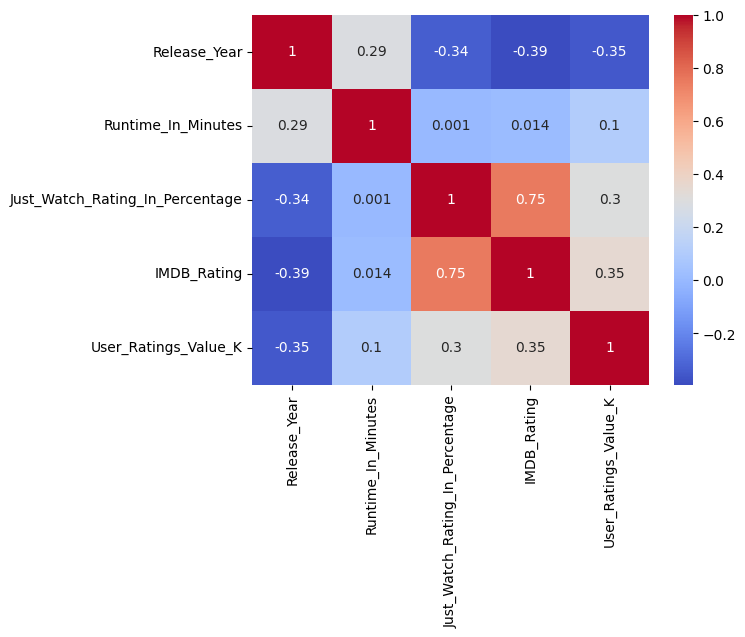

In [ ]:

sns.heatmap(mystery_thriller_tvshows.corr(),cmap='coolwarm',annot=True)

In [ ]:

mystery_thriller_tvshows_correlation_matrix = mystery_thriller_tvshows.corr()
mystery_thriller_tvshows_correlation_table = mystery_thriller_tvshows_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
mystery_thriller_tvshows_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
mystery_thriller_tvshows_correlation_table['Correlation Type'] = mystery_thriller_tvshows_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
mystery_thriller_tvshows_correlation_table['Correlation Strength'] = mystery_thriller_tvshows_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


mystery_thriller_tvshows_correlation_table


<ipython-input-1560-856f00679ded>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  mystery_thriller_tvshows_correlation_matrix = mystery_thriller_tvshows.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.749867,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.749867,Positive,Strong
7,User_Ratings_Value_K,IMDB_Rating,0.352738,Positive,Weak
8,IMDB_Rating,User_Ratings_Value_K,0.352738,Positive,Weak
9,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.302526,Positive,Weak


# Action and Adventure TV Shows Analysis

In [ ]:
action_adventure_tvshows.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
13,3Below: Tales of Arcadia,TV-Show,Tatiana Maslany,2018,2016-2020,Action & Adventure,22,20-25,82.0,80-90,7.7,7.6-8.0,6.0,1-50
44,A Series of Unfortunate Events,TV-Show,Neil Patrick Harris,2017,2016-2020,Action & Adventure,47,45-50,84.0,80-90,7.8,7.6-8.0,63.0,51-100
53,Adventures of Sonic the Hedgehog,TV-Show,Jaleel White,1993,1991-1995,Action & Adventure,22,20-25,71.0,70-80,6.3,6.1-6.5,4.0,1-50
69,Age of Samurai: Battle for Japan,TV-Show,Stephen Scott,2021,2021-2025,Action & Adventure,43,40-45,80.0,80-90,7.4,7.1-7.5,4.0,1-50
75,Agent Elvis,TV-Show,Matthew McConaughey,2023,2021-2025,Action & Adventure,30,30-35,79.0,70-80,6.9,6.6-7.0,1.0,1-50


#226 Action and Adventure TV Shows

In [ ]:
action_adventure_tvshows.shape


(226, 14)

In [ ]:
action_adventure_tvshows.Release_Year_Range.value_counts()


2021-2025    119
2016-2020     66
2011-2015     21
2001-2005      9
1996-2000      5
2006-2010      3
1991-1995      2
1981-1985      1
Name: Release_Year_Range, dtype: int64

In [ ]:
action_adventure_tvshows.JustWatch_Range.value_counts()


80-90     88
70-80     74
90-100    33
60-70     15
40-50      9
30-40      4
50-60      2
0-10       1
Name: JustWatch_Range, dtype: int64

In [ ]:
action_adventure_tvshows.IMDB_Range.value_counts()


7.6-8.0    42
6.6-7.0    40
7.1-7.5    36
8.1-8.5    32
6.1-6.5    25
5.6-6.0    15
8.6-9.0    12
nan         9
5.1-5.5     6
9.1-9.5     4
4.6-5.0     3
3.6-4.0     1
4.1-4.5     1
Name: IMDB_Range, dtype: int64

In [ ]:
action_adventure_tvshows.UserRatings_Range.value_counts()


1-50       144
nan         36
51-100      17
101-150     13
151-200      6
451-500      2
251-300      2
501-550      2
201-250      1
401-450      1
301-350      1
351-400      1
Name: UserRatings_Range, dtype: int64

In [ ]:
action_adventure_tvshows.Runtime_Range.value_counts()


20-25      50
45-50      38
25-30      37
40-45      37
50-55      15
60-65       9
55-60       9
15-20       8
10-15       5
30-35       5
70-75       4
35-40       3
85-90       2
75-80       1
130-135     1
80-85       1
65-70       1
180-185     0
185-190     0
190-195     0
195-200     0
200-205     0
210-215     0
205-210     0
0-5         0
215-220     0
220-225     0
225-230     0
230-235     0
235-240     0
240-245     0
170-175     0
175-180     0
125-130     0
165-170     0
160-165     0
155-160     0
150-155     0
145-150     0
140-145     0
135-140     0
5-10        0
120-125     0
115-120     0
110-115     0
105-110     0
100-105     0
95-100      0
90-95       0
245-250     0
Name: Runtime_Range, dtype: int64

# **Action and Adventure TV Shows**

Release Year:

Count: There are 226 action and adventure TV shows in the dataset.
Mean: The average release year for action and adventure TV shows is approximately 2017.5, indicating a relatively recent set of shows.
Standard Deviation: The release years of action and adventure TV shows have a standard deviation of approximately 6.5, suggesting a moderate range of years.
Minimum: The earliest release year for an action and adventure TV show in the dataset is 1984.
Maximum: The latest release year for an action and adventure TV show in the dataset is 2023, indicating recent releases.
25th Percentile: 25% of the action and adventure TV shows were released in or before the year 2017, indicating a distribution of shows from recent years.
50th Percentile (Median): 50% of the action and adventure TV shows were released in or before the year 2020, providing the median release year.
75th Percentile: 75% of the action and adventure TV shows were released in or before the year 2021, indicating a concentration of recent releases.
****
Runtime in Minutes:

Mean: The average runtime of action and adventure TV shows is approximately 38.1 minutes, suggesting a moderate duration for these shows.
Standard Deviation: The runtime of action and adventure TV shows varies by approximately 16.4 minutes, indicating some variability in the episode lengths.
Minimum: The shortest runtime for an action and adventure TV show in the dataset is 10 minutes, which could be an anomaly or a special format episode.
Maximum: The longest runtime for an action and adventure TV show in the dataset is 131 minutes, suggesting some shows may have extended episodes or different episode structures.
25th Percentile: 25% of the action and adventure TV shows have an episode runtime of 24 minutes or less.
50th Percentile (Median): 50% of the action and adventure TV shows have an episode runtime of 41 minutes or less, providing the median runtime.
75th Percentile: 75% of the action and adventure TV shows have an episode runtime of 48 minutes or less.
****
Just Watch Rating in Percentage:

Mean: The average Just Watch rating for action and adventure TV shows is approximately 78.4%, indicating a generally positive reception by viewers.
Standard Deviation: The Just Watch ratings for action and adventure TV shows vary by approximately 13.2%, suggesting some variability in audience ratings.
Minimum: The lowest Just Watch rating for an action and adventure TV show in the dataset is 6%.
Maximum: The highest Just Watch rating for an action and adventure TV show in the dataset is 98%, indicating highly acclaimed shows.
25th Percentile: 25% of the action and adventure TV shows have a Just Watch rating of 74% or lower.
50th Percentile (Median): 50% of the action and adventure TV shows have a Just Watch rating of 81% or lower, providing the median rating.
75th Percentile: 75% of the action and adventure TV shows have a Just Watch rating of 87% or lower.
****
IMDb Rating:

Mean: The average IMDb rating for action and adventure TV shows is approximately 6.8 out of 10, suggesting a generally positive reception by viewers.
Standard Deviation: The IMDb ratings for action and adventure TV shows have a standard deviation of approximately 1.7, indicating some variability in the ratings.
Minimum: The lowest IMDb rating for an action and adventure TV show in the dataset is 0, which could be an anomaly or a less popular show.
Maximum: The highest IMDb rating for an action and adventure TV show in the dataset is 9.3 out of 10, indicating highly acclaimed shows.
25th Percentile: 25% of the action and adventure TV shows have an IMDb rating of 6.4 or lower.
50th Percentile (Median): 50% of the action and adventure TV shows have an IMDb rating of 7.15 or lower, providing the median rating.
75th Percentile: 75% of the action and adventure TV shows have an IMDb rating of 7.8 or lower.
****
User Ratings Value (K):

Mean: The average user ratings value for action and adventure TV shows is approximately 51.2 thousand, indicating a moderate level of user engagement.
Standard Deviation: The user ratings values for action and adventure TV shows have a standard deviation of approximately 125.2 thousand, indicating a wide range of user engagement levels.
Minimum: The lowest user ratings value for an action and adventure TV show in the dataset is 0 thousand, which could be an anomaly or a less popular show.
Maximum: The highest user ratings value for an action and adventure TV show in the dataset is 1000 thousand, indicating potentially highly popular shows.
25th Percentile: 25% of the action and adventure TV shows have a user ratings value of 2 thousand or lower.
50th Percentile (Median): 50% of the action and adventure TV shows have a user ratings value of 10 thousand or lower, providing the median value.
75th Percentile: 75% of the action and adventure TV shows have a user ratings value of 40 thousand or lower.

In [ ]:
action_adventure_tvshows.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,226.000000,226.000000,226.000000,226.000000,226.000000
mean,2017.513274,38.088496,78.353982,6.841150,51.168142
std,6.495284,16.392441,13.209707,1.701643,125.200632
min,1984.000000,10.000000,6.000000,0.000000,0.000000
25%,2017.000000,24.000000,74.000000,6.400000,2.000000
50%,2020.000000,41.000000,81.000000,7.150000,10.000000
75%,2021.000000,48.000000,87.000000,7.800000,40.000000
max,2023.000000,131.000000,98.000000,9.300000,1000.000000


# **Action and Adventure TV Shows Correlation**


Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately 0.311. This indicates a moderate positive correlation, suggesting that action and adventure TV shows released in later years tend to have slightly longer runtimes.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.185. This suggests a weak negative correlation, indicating that action and adventure TV shows released in later years may have slightly lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.225. This indicates a weak negative correlation, suggesting that action and adventure TV shows released in later years may have slightly lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.168. This indicates a weak negative correlation, suggesting that action and adventure TV shows released in later years may have slightly lower user ratings values (in thousands).

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.042. This indicates a very weak positive correlation, suggesting that the runtime of action and adventure TV shows has minimal influence on their Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.094. This indicates a weak positive correlation, suggesting that action and adventure TV shows with longer runtimes may have slightly higher IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.139. This indicates a weak positive correlation, suggesting that action and adventure TV shows with longer runtimes may have slightly higher user ratings values (in thousands).

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.790. This indicates a strong positive correlation, suggesting that action and adventure TV shows with higher Just Watch rating percentages tend to have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.215. This indicates a weak positive correlation, suggesting that action and adventure TV shows with higher Just Watch rating percentages may have slightly higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.256. This indicates a weak positive correlation, suggesting that action and adventure TV shows with higher IMDB ratings may have slightly higher user ratings values (in thousands).

In [ ]:
action_adventure_tvshows.corr()


<ipython-input-1569-bb985565976f>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  action_adventure_tvshows.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,0.310760,-0.185290,-0.224571,-0.168219
Runtime_In_Minutes,0.310760,1.000000,0.041623,0.093764,0.139027
Just_Watch_Rating_In_Percentage,-0.185290,0.041623,1.000000,0.789685,0.215013
IMDB_Rating,-0.224571,0.093764,0.789685,1.000000,0.255701
User_Ratings_Value_K,-0.168219,0.139027,0.215013,0.255701,1.000000


<ipython-input-1570-b076141ab840>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(action_adventure_tvshows.corr(),cmap='coolwarm',annot=True)


<Axes: >

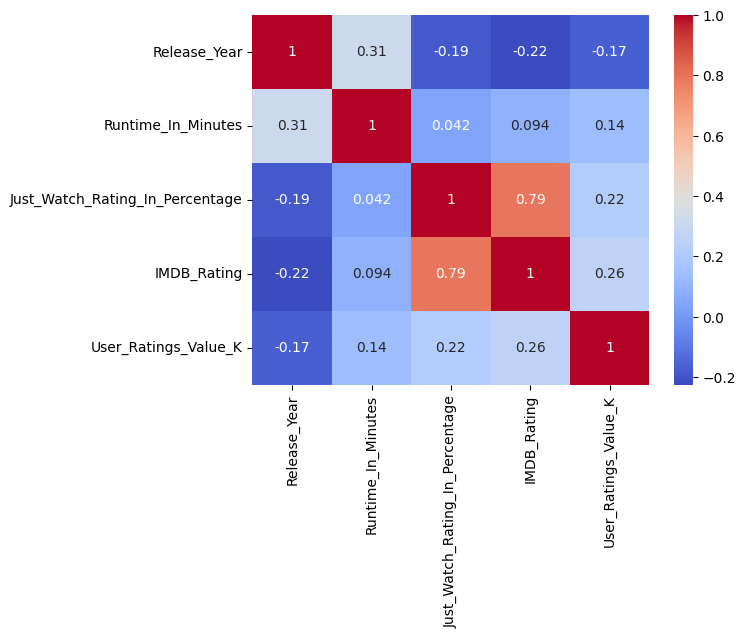

In [ ]:

sns.heatmap(action_adventure_tvshows.corr(),cmap='coolwarm',annot=True)

In [ ]:

action_adventure_tvshows_correlation_matrix = action_adventure_tvshows.corr()
action_adventure_tvshows_correlation_table = action_adventure_tvshows_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
action_adventure_tvshows_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
action_adventure_tvshows_correlation_table['Correlation Type'] = action_adventure_tvshows_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
action_adventure_tvshows_correlation_table['Correlation Strength'] = action_adventure_tvshows_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


action_adventure_tvshows_correlation_table


<ipython-input-1571-f5ef035d0f11>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  action_adventure_tvshows_correlation_matrix = action_adventure_tvshows.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.789685,Positive,Strong
6,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.789685,Positive,Strong
7,Release_Year,Runtime_In_Minutes,0.310760,Positive,Weak
8,Runtime_In_Minutes,Release_Year,0.310760,Positive,Weak
9,User_Ratings_Value_K,IMDB_Rating,0.255701,Positive,Weak


# Science Fiction TV Shows Analysis

In [ ]:
science_fiction_tvshows.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
7,1899,TV-Show,Emily Beecham,2022,2021-2025,Science-Fiction,53,50-55,83.0,80-90,7.3,7.1-7.5,97.0,51-100
12,3Below: Tales of Arcadia,TV-Show,Tatiana Maslany,2018,2016-2020,Science-Fiction,22,20-25,82.0,80-90,7.7,7.6-8.0,6.0,1-50
28,A Girl and an Astronaut,TV-Show,Bartosz Prokopowicz,2023,2021-2025,Science-Fiction,47,45-50,63.0,60-70,4.8,4.6-5.0,1.0,1-50
34,A Korean Odyssey,TV-Show,Park Hong-kyun,2017,2016-2020,Science-Fiction,75,75-80,88.0,80-90,8.0,8.1-8.5,5.0,1-50
52,Adventures of Sonic the Hedgehog,TV-Show,Jaleel White,1993,1991-1995,Science-Fiction,22,20-25,71.0,70-80,6.3,6.1-6.5,4.0,1-50


# 224 Science Fiction TV Shows

In [ ]:
science_fiction_tvshows.shape


(224, 14)

In [ ]:
science_fiction_tvshows.Release_Year_Range.value_counts()


2021-2025    112
2016-2020     71
2011-2015     20
2001-2005      8
2006-2010      5
1996-2000      5
1991-1995      3
Name: Release_Year_Range, dtype: int64

In [ ]:
science_fiction_tvshows.JustWatch_Range.value_counts()


80-90     78
70-80     68
90-100    41
60-70     18
40-50     12
50-60      6
30-40      1
Name: JustWatch_Range, dtype: int64

In [ ]:
science_fiction_tvshows.IMDB_Range.value_counts()


7.1-7.5    40
7.6-8.0    32
6.6-7.0    32
8.1-8.5    29
6.1-6.5    23
8.6-9.0    20
5.6-6.0    17
nan        14
5.1-5.5     6
4.6-5.0     5
9.1-9.5     3
3.6-4.0     2
4.1-4.5     1
Name: IMDB_Range, dtype: int64

In [ ]:
science_fiction_tvshows.UserRatings_Range.value_counts()


1-50       130
nan         41
51-100      18
101-150     15
151-200      6
301-350      4
401-450      2
251-300      2
501-550      2
201-250      1
551-600      1
451-500      1
351-400      1
Name: UserRatings_Range, dtype: int64

In [ ]:
science_fiction_tvshows.Runtime_Range.value_counts()


20-25      51
25-30      36
45-50      34
40-45      32
50-55      21
60-65      11
55-60      10
30-35       8
35-40       7
10-15       4
15-20       4
70-75       4
75-80       2
170-175     0
205-210     0
175-180     0
180-185     0
185-190     0
190-195     0
195-200     0
200-205     0
0-5         0
210-215     0
215-220     0
220-225     0
225-230     0
230-235     0
235-240     0
160-165     0
240-245     0
165-170     0
125-130     0
155-160     0
150-155     0
65-70       0
80-85       0
85-90       0
90-95       0
95-100      0
100-105     0
105-110     0
110-115     0
115-120     0
120-125     0
5-10        0
130-135     0
135-140     0
140-145     0
145-150     0
245-250     0
Name: Runtime_Range, dtype: int64

# **Science Fiction TV Shows Summary Statistics**

Release Year:

Count: There are 224 science fiction TV shows in the dataset.
Mean: The average release year for science fiction TV shows is approximately 2017.3, indicating a relatively recent set of shows.
Standard Deviation: The release years of science fiction TV shows have a standard deviation of approximately 6.3, suggesting a moderate range of years.
Minimum: The earliest release year for a science fiction TV show in the dataset is 1993.
Maximum: The latest release year for a science fiction TV show in the dataset is 2023, indicating recent releases.
25th Percentile: 25% of the science fiction TV shows were released in or before the year 2016, indicating a distribution of shows from recent years.
50th Percentile (Median): 50% of the science fiction TV shows were released in or before the year 2019.5, providing the median release year.
75th Percentile: 75% of the science fiction TV shows were released in or before the year 2021, indicating a concentration of recent releases.


Runtime in Minutes:

Mean: The average runtime of science fiction TV shows is approximately 37.8 minutes, suggesting a moderate duration for these shows.
Standard Deviation: The runtime of science fiction TV shows varies by approximately 14.4 minutes, indicating some variability in the episode lengths.
Minimum: The shortest runtime for a science fiction TV show in the dataset is 11 minutes, which could be an anomaly or a special format episode.
Maximum: The longest runtime for a science fiction TV show in the dataset is 79 minutes, suggesting some shows may have extended episodes or different episode structures.
25th Percentile: 25% of the science fiction TV shows have an episode runtime of 24 minutes or less.
50th Percentile (Median): 50% of the science fiction TV shows have an episode runtime of 41 minutes or less, providing the median runtime.
75th Percentile: 75% of the science fiction TV shows have an episode runtime of 47.3 minutes or less.


Just Watch Rating in Percentage:

Mean: The average Just Watch rating for science fiction TV shows is approximately 78.5%, indicating a generally positive reception by viewers.
Standard Deviation: The Just Watch ratings for science fiction TV shows vary by approximately 12.9%, suggesting some variability in audience ratings.
Minimum: The lowest Just Watch rating for a science fiction TV show in the dataset is 32%.
Maximum: The highest Just Watch rating for a science fiction TV show in the dataset is 98%, indicating highly acclaimed shows.
25th Percentile: 25% of the science fiction TV shows have a Just Watch rating of 73% or lower.
50th Percentile (Median): 50% of the science fiction TV shows have a Just Watch rating of 81% or lower, providing the median rating.
75th Percentile: 75% of the science fiction TV shows have a Just Watch rating of 87.3% or lower.


IMDb Rating:

Mean: The average IMDb rating for science fiction TV shows is approximately 6.7 out of 10, suggesting a generally positive reception by viewers.
Standard Deviation: The IMDb ratings for science fiction TV shows have a standard deviation of approximately 2.0, indicating some variability in the ratings.
Minimum: The lowest IMDb rating for a science fiction TV show in the dataset is 0, which could be an anomaly or a less popular show.
Maximum: The highest IMDb rating for a science fiction TV show in the dataset is 9.3 out of 10, indicating highly acclaimed shows.
25th Percentile: 25% of the science fiction TV shows have an IMDb rating of 6.2 or lower.
50th Percentile (Median): 50% of the science fiction TV shows have an IMDb rating of 7.1 or lower, providing the median rating.
75th Percentile: 75% of the science fiction TV shows have an IMDb rating of 7.8 or lower.


User Ratings Value (K):

Mean: The average user ratings value for science fiction TV shows is approximately 67.2 thousand, indicating a moderate level of user engagement.
Standard Deviation: The user ratings values for science fiction TV shows have a standard deviation of approximately 159.8 thousand, indicating a wide range of user engagement levels.
Minimum: The lowest user ratings value for a science fiction TV show in the dataset is 0 thousand, which could be an anomaly or a less popular show.
Maximum: The highest user ratings value for a science fiction TV show in the dataset is 1000 thousand, indicating potentially highly popular shows.
25th Percentile: 25% of the science fiction TV shows have a user ratings value of 2 thousand or lower.
50th Percentile (Median): 50% of the science fiction TV shows have a user ratings value of 11 thousand or lower, providing the median value.
75th Percentile: 75% of the science fiction TV shows have a user ratings value of 52 thousand or lower.

In [ ]:
science_fiction_tvshows.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,224.000000,224.000000,224.000000,224.000000,224.000000
mean,2017.339286,37.808036,78.464286,6.668750,67.214286
std,6.274803,14.353754,12.853733,2.021034,159.766923
min,1993.000000,11.000000,32.000000,0.000000,0.000000
25%,2016.000000,24.000000,73.000000,6.200000,2.000000
50%,2019.500000,41.000000,81.000000,7.100000,11.000000
75%,2021.000000,47.250000,87.250000,7.825000,52.000000
max,2023.000000,79.000000,98.000000,9.300000,1000.000000


# **Science Fiction TV Shows Correlation**

Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately 0.308. This indicates a moderate positive correlation, suggesting that science fiction TV shows released in later years tend to have slightly longer runtimes.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.263. This suggests a weak negative correlation, indicating that science fiction TV shows released in later years may have slightly lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.257. This indicates a weak negative correlation, suggesting that science fiction TV shows released in later years may have slightly lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.199. This indicates a weak negative correlation, suggesting that science fiction TV shows released in later years may have slightly lower user ratings values (in thousands).

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.069. This indicates a weak positive correlation, suggesting that science fiction TV shows with longer runtimes may have slightly higher Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.046. This indicates a very weak positive correlation, suggesting that the runtime of science fiction TV shows has minimal influence on their IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.246. This indicates a moderate positive correlation, suggesting that science fiction TV shows with longer runtimes may have slightly higher user ratings values (in thousands).

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.875. This indicates a strong positive correlation, suggesting that science fiction TV shows with higher Just Watch rating percentages tend to have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.361. This indicates a weak positive correlation, suggesting that science fiction TV shows with higher Just Watch rating percentages may have slightly higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.294. This indicates a weak positive correlation, suggesting that science fiction TV shows with higher IMDB ratings may have slightly higher user ratings values (in thousands).

In [ ]:
science_fiction_tvshows.corr()


<ipython-input-1580-452a0b46a656>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  science_fiction_tvshows.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,0.308320,-0.263332,-0.256834,-0.199466
Runtime_In_Minutes,0.308320,1.000000,0.068977,0.045997,0.246225
Just_Watch_Rating_In_Percentage,-0.263332,0.068977,1.000000,0.874642,0.360556
IMDB_Rating,-0.256834,0.045997,0.874642,1.000000,0.293539
User_Ratings_Value_K,-0.199466,0.246225,0.360556,0.293539,1.000000


<ipython-input-1581-8ba486adf6f1>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(science_fiction_tvshows.corr(),cmap='coolwarm',annot=True)


<Axes: >

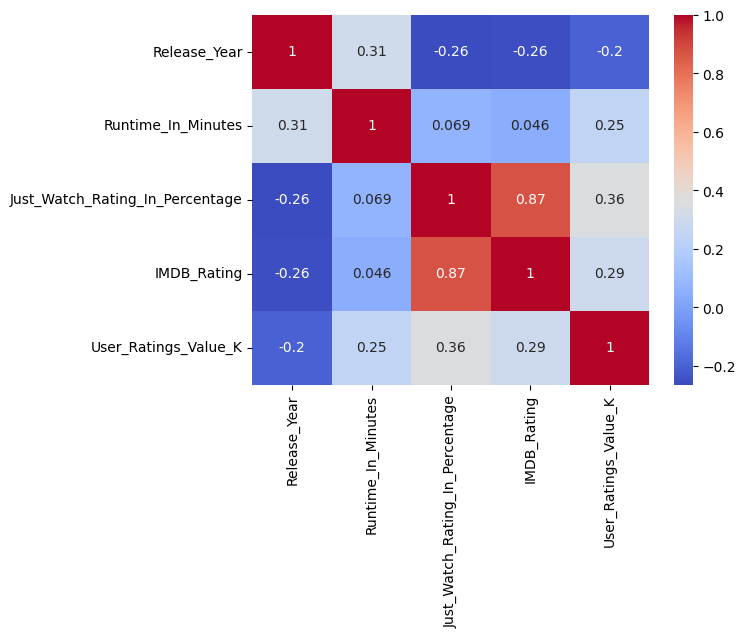

In [ ]:

sns.heatmap(science_fiction_tvshows.corr(),cmap='coolwarm',annot=True)

In [ ]:

science_fiction_tvshows_correlation_matrix = science_fiction_tvshows.corr()
science_fiction_tvshows_correlation_table = science_fiction_tvshows_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
science_fiction_tvshows_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
science_fiction_tvshows_correlation_table['Correlation Type'] = science_fiction_tvshows_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
science_fiction_tvshows_correlation_table['Correlation Strength'] = science_fiction_tvshows_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


science_fiction_tvshows_correlation_table


<ipython-input-1582-9ea34e0445cf>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  science_fiction_tvshows_correlation_matrix = science_fiction_tvshows.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.874642,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.874642,Positive,Strong
7,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.360556,Positive,Weak
8,Just_Watch_Rating_In_Percentage,User_Ratings_Value_K,0.360556,Positive,Weak
9,Release_Year,Runtime_In_Minutes,0.308320,Positive,Weak


# Documentary TV Shows Analysis

In [ ]:
documentary_tvshows.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
2,(Un)Well,TV-Show,No Value,2020,2021-2025,Documentary,52,50-55,69.0,60-70,6.4,6.1-6.5,1.0,1-50
23,72 Dangerous Animals: Asia,TV-Show,Bob Brisbane,2018,2016-2020,Documentary,47,45-50,68.0,60-70,6.6,6.6-7.0,0.0,nan
24,800 Meters,TV-Show,Elías León Siminiani,2022,2021-2025,Documentary,52,50-55,70.0,70-80,7.0,7.1-7.5,0.0,nan
32,A Kidnapping Scandal: The Florence Cassez Affair,TV-Show,Gerardo Naranjo,2022,2021-2025,Documentary,58,55-60,74.0,70-80,7.0,7.1-7.5,0.0,nan
51,Abstract: The Art of Design,TV-Show,No Value,2017,2016-2020,Documentary,45,45-50,88.0,80-90,8.4,8.1-8.5,5.0,1-50


# 206 Documentary TV Shows

In [ ]:
documentary_tvshows.shape


(206, 14)

In [ ]:
documentary_tvshows.Release_Year_Range.value_counts()


2021-2025    148
2016-2020     50
2011-2015      3
2006-2010      3
1991-1995      1
2001-2005      1
Name: Release_Year_Range, dtype: int64

In [ ]:
documentary_tvshows.JustWatch_Range.value_counts()


70-80     92
80-90     66
60-70     24
30-40     10
40-50      5
50-60      4
90-100     4
20-30      1
Name: JustWatch_Range, dtype: int64

In [ ]:
documentary_tvshows.IMDB_Range.value_counts()


7.1-7.5    59
6.6-7.0    40
7.6-8.0    32
6.1-6.5    22
8.1-8.5    22
8.6-9.0     9
nan         7
5.6-6.0     4
4.6-5.0     4
5.1-5.5     3
2.6-3.0     2
9.1-9.5     2
Name: IMDB_Range, dtype: int64

In [ ]:
documentary_tvshows.UserRatings_Range.value_counts()


1-50       147
nan         54
51-100       4
101-150      1
Name: UserRatings_Range, dtype: int64

In [ ]:
documentary_tvshows.Runtime_Range.value_counts()


45-50      43
40-45      38
50-55      33
55-60      19
25-30      18
60-65      14
30-35      12
35-40      12
20-25       9
65-70       4
90-95       2
100-105     1
85-90       1
190-195     0
195-200     0
0-5         0
185-190     0
180-185     0
205-210     0
175-180     0
170-175     0
200-205     0
225-230     0
210-215     0
215-220     0
220-225     0
160-165     0
230-235     0
235-240     0
240-245     0
165-170     0
125-130     0
155-160     0
150-155     0
10-15       0
15-20       0
70-75       0
75-80       0
80-85       0
95-100      0
105-110     0
110-115     0
115-120     0
120-125     0
5-10        0
130-135     0
135-140     0
140-145     0
145-150     0
245-250     0
Name: Runtime_Range, dtype: int64

# **Documentary TV shows Summary Statistics**

Release Year:

Count: There are 206 documentary TV shows in the dataset.
Mean: The average release year for documentary TV shows is approximately 2020, indicating a relatively recent set of shows.
Standard Deviation: The release years of documentary TV shows have a standard deviation of approximately 3.5, suggesting a moderate range of years.
Minimum: The earliest release year for a documentary TV show in the dataset is 1992.
Maximum: The latest release year for a documentary TV show in the dataset is 2023, indicating recent releases.
25th Percentile: 25% of the documentary TV shows were released in or before the year 2019, indicating a distribution of shows from recent years.
50th Percentile (Median): 50% of the documentary TV shows were released in or before the year 2021, providing the median release year.
75th Percentile: 75% of the documentary TV shows were released in or before the year 2022, indicating a concentration of recent releases.
****
Runtime in Minutes:

Mean: The average runtime of documentary TV shows is approximately 45.8 minutes, suggesting a moderate duration for these shows.
Standard Deviation: The runtime of documentary TV shows varies by approximately 12.6 minutes, indicating some variability in the episode lengths.
Minimum: The shortest runtime for a documentary TV show in the dataset is 20 minutes.
Maximum: The longest runtime for a documentary TV show in the dataset is 100 minutes, suggesting some shows may have extended episodes or different episode structures.
25th Percentile: 25% of the documentary TV shows have an episode runtime of 40 minutes or less.
50th Percentile (Median): 50% of the documentary TV shows have an episode runtime of 46 minutes or less, providing the median runtime.
75th Percentile: 75% of the documentary TV shows have an episode runtime of 52 minutes or less.
****
Just Watch Rating in Percentage:

Mean: The average Just Watch rating for documentary TV shows is approximately 73.4%, indicating a generally positive reception by viewers.
Standard Deviation: The Just Watch ratings for documentary TV shows vary by approximately 12.6%, suggesting some variability in audience ratings.
Minimum: The lowest Just Watch rating for a documentary TV show in the dataset is 27%.
Maximum: The highest Just Watch rating for a documentary TV show in the dataset is 97%, indicating highly acclaimed shows.
25th Percentile: 25% of the documentary TV shows have a Just Watch rating of 70.3% or lower.
50th Percentile (Median): 50% of the documentary TV shows have a Just Watch rating of 76% or lower, providing the median rating.
75th Percentile: 75% of the documentary TV shows have a Just Watch rating of 81% or lower.
****
IMDb Rating:

Mean: The average IMDb rating for documentary TV shows is approximately 6.9 out of 10, suggesting a generally positive reception by viewers.
Standard Deviation: The IMDb ratings for documentary TV shows have a standard deviation of approximately 1.6, indicating some variability in the ratings.
Minimum: The lowest IMDb rating for a documentary TV show in the dataset is 0, which could be an anomaly or a less popular show.
Maximum: The highest IMDb rating for a documentary TV show in the dataset is 9.3 out of 10, indicating highly acclaimed shows.
25th Percentile: 25% of the documentary TV shows have an IMDb rating of 6.6 or lower.
50th Percentile (Median): 50% of the documentary TV shows have an IMDb rating of 7.1 or lower, providing the median rating.
75th Percentile: 75% of the documentary TV shows have an IMDb rating of 7.6 or lower.
****
User Ratings Value (K):

Mean: The average user ratings value for documentary TV shows is approximately 6.2 thousand, indicating a moderate level of user engagement.
Standard Deviation: The user ratings values for documentary TV shows have a standard deviation of approximately 15.2 thousand, indicating a wide range of user engagement levels.
Minimum: The lowest user ratings value for a documentary TV show in the dataset is 0 thousand, which could be an anomaly or a less popular show.
Maximum: The highest user ratings value for a documentary TV show in the dataset is 134 thousand, indicating potentially highly popular shows.
25th Percentile: 25% of the documentary TV shows have a user ratings value of 0 or lower.
50th Percentile (Median): 50% of the documentary TV shows have a user ratings value of 2 thousand or lower, providing the median value.
75th Percentile: 75% of the documentary TV shows have a user ratings value of 6 thousand or lower.

In [ ]:
documentary_tvshows.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,206.000000,206.000000,206.000000,206.000000,206.000000
mean,2020.004854,45.825243,73.373786,6.877670,6.218447
std,3.483057,12.640953,12.647224,1.562545,15.230452
min,1992.000000,20.000000,27.000000,0.000000,0.000000
25%,2019.000000,40.000000,70.250000,6.600000,0.000000
50%,2021.000000,46.000000,76.000000,7.100000,2.000000
75%,2022.000000,52.000000,81.000000,7.600000,6.000000
max,2023.000000,100.000000,97.000000,9.300000,134.000000


#**Documentary TV Shows Correlation**


Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately 0.133. This indicates a very weak positive correlation, suggesting that documentary TV shows released in later years may have slightly longer runtimes.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.094. This suggests a very weak negative correlation, indicating that documentary TV shows released in later years may have slightly lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.020. This indicates a very weak negative correlation, suggesting that documentary TV shows released in later years may have slightly lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.088. This indicates a very weak negative correlation, suggesting that documentary TV shows released in later years may have slightly lower user ratings values (in thousands).

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.082. This indicates a weak positive correlation, suggesting that documentary TV shows with longer runtimes may have slightly higher Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.100. This indicates a weak positive correlation, suggesting that the runtime of documentary TV shows may have a slight influence on their IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.127. This indicates a weak positive correlation, suggesting that documentary TV shows with longer runtimes may have slightly higher user ratings values (in thousands).

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.705. This indicates a strong positive correlation, suggesting that documentary TV shows with higher Just Watch rating percentages tend to have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.175. This indicates a weak positive correlation, suggesting that documentary TV shows with higher Just Watch rating percentages may have slightly higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.130. This indicates a weak positive correlation, suggesting that documentary TV shows with higher IMDB ratings may have slightly higher user ratings values (in thousands).

In [ ]:
documentary_tvshows.corr()


<ipython-input-1591-dcf8aa8be244>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  documentary_tvshows.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,0.133412,-0.093614,-0.019699,-0.087837
Runtime_In_Minutes,0.133412,1.000000,0.082488,0.099995,0.126858
Just_Watch_Rating_In_Percentage,-0.093614,0.082488,1.000000,0.705330,0.174641
IMDB_Rating,-0.019699,0.099995,0.705330,1.000000,0.129627
User_Ratings_Value_K,-0.087837,0.126858,0.174641,0.129627,1.000000


<ipython-input-1592-fa18cc6df35b>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(documentary_tvshows.corr(),cmap='coolwarm',annot=True)


<Axes: >

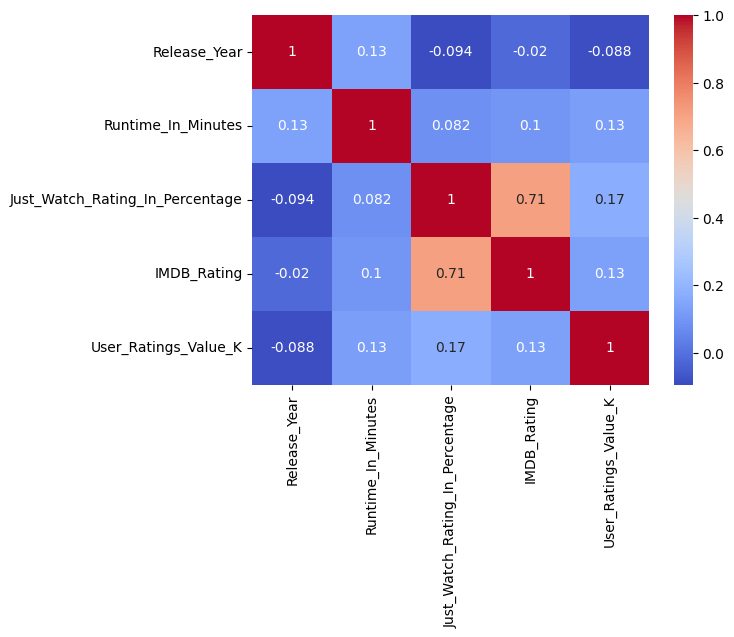

In [ ]:

sns.heatmap(documentary_tvshows.corr(),cmap='coolwarm',annot=True)

In [ ]:
documentary_tvshows
documentary_tvshows_correlation_matrix = documentary_tvshows.corr()
documentary_tvshows_correlation_table = documentary_tvshows_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
documentary_tvshows_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
documentary_tvshows_correlation_table['Correlation Type'] = documentary_tvshows_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
documentary_tvshows_correlation_table['Correlation Strength'] = documentary_tvshows_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


documentary_tvshows_correlation_table


<ipython-input-1593-a86fce735a54>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  documentary_tvshows_correlation_matrix = documentary_tvshows.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.705330,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.705330,Positive,Strong
7,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.174641,Positive,Weak
8,Just_Watch_Rating_In_Percentage,User_Ratings_Value_K,0.174641,Positive,Weak
9,Release_Year,Runtime_In_Minutes,0.133412,Positive,Weak


# Fantasy TV Shows Analysis

In [ ]:
fantasy_tvshows.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
16,3Below: Tales of Arcadia,TV-Show,Tatiana Maslany,2018,2016-2020,Fantasy,22,20-25,82.0,80-90,7.7,7.6-8.0,6.0,1-50
36,A Korean Odyssey,TV-Show,Park Hong-kyun,2017,2016-2020,Fantasy,75,75-80,88.0,80-90,8.0,8.1-8.5,5.0,1-50
58,Adventures of Sonic the Hedgehog,TV-Show,Jaleel White,1993,1991-1995,Fantasy,22,20-25,71.0,70-80,6.3,6.1-6.5,4.0,1-50
89,Alchemy of Souls,TV-Show,Lee Jae-wook,2022,2021-2025,Fantasy,79,75-80,96.0,90-100,8.8,8.6-9.0,11.0,1-50
96,Alice in Borderland,TV-Show,Kento Yamazaki,2020,2021-2025,Fantasy,55,55-60,88.0,80-90,7.7,7.6-8.0,84.0,51-100


#168 Fantasy TV Shows

In [ ]:
fantasy_tvshows.shape


(168, 14)

In [ ]:
fantasy_tvshows.Release_Year_Range.value_counts()


2021-2025    80
2016-2020    54
2011-2015    14
2001-2005     8
2006-2010     4
1996-2000     4
1991-1995     3
1981-1985     1
Name: Release_Year_Range, dtype: int64

In [ ]:
fantasy_tvshows.JustWatch_Range.value_counts()


80-90     67
70-80     46
90-100    41
60-70      9
50-60      3
30-40      2
Name: JustWatch_Range, dtype: int64

In [ ]:
fantasy_tvshows.IMDB_Range.value_counts()


7.1-7.5    34
7.6-8.0    32
8.1-8.5    27
6.6-7.0    23
8.6-9.0    16
5.6-6.0    13
6.1-6.5    12
9.1-9.5     4
5.1-5.5     4
4.6-5.0     2
3.6-4.0     1
Name: IMDB_Range, dtype: int64

In [ ]:
fantasy_tvshows.UserRatings_Range.value_counts()


1-50       110
nan         21
51-100      13
101-150     11
301-350      4
151-200      4
501-550      2
201-250      1
451-500      1
251-300      1
Name: UserRatings_Range, dtype: int64

In [ ]:
fantasy_tvshows.Runtime_Range.value_counts()


20-25      46
25-30      34
45-50      22
40-45      18
50-55       9
60-65       8
55-60       7
15-20       5
30-35       4
10-15       3
35-40       3
70-75       3
75-80       2
130-135     1
85-90       1
5-10        1
65-70       1
180-185     0
185-190     0
190-195     0
195-200     0
200-205     0
205-210     0
0-5         0
240-245     0
210-215     0
215-220     0
220-225     0
225-230     0
230-235     0
235-240     0
170-175     0
175-180     0
125-130     0
165-170     0
160-165     0
155-160     0
150-155     0
145-150     0
140-145     0
135-140     0
120-125     0
115-120     0
110-115     0
105-110     0
100-105     0
95-100      0
90-95       0
80-85       0
245-250     0
Name: Runtime_Range, dtype: int64

# **Fantasy TV Shows Summary Statistics**

Release Year:

Count: There are 168 fantasy TV shows in the dataset.
Mean: The average release year for fantasy TV shows is approximately 2016.8, indicating a relatively recent set of shows.
Standard Deviation: The release years of fantasy TV shows have a standard deviation of approximately 7.2, suggesting a moderate range of years.
Minimum: The earliest release year for a fantasy TV show in the dataset is 1984.
Maximum: The latest release year for a fantasy TV show in the dataset is 2023, indicating recent releases.
25th Percentile: 25% of the fantasy TV shows were released in or before the year 2016, indicating a distribution of shows from recent years.
50th Percentile (Median): 50% of the fantasy TV shows were released in or before the year 2019, providing the median release year.
75th Percentile: 75% of the fantasy TV shows were released in or before the year 2021, indicating a concentration of recent releases.


Runtime in Minutes:

Mean: The average runtime of fantasy TV shows is approximately 36.3 minutes, suggesting a relatively shorter duration for these shows.
Standard Deviation: The runtime of fantasy TV shows varies by approximately 17.2 minutes, indicating some variability in the episode lengths.
Minimum: The shortest runtime for a fantasy TV show in the dataset is 9 minutes.
Maximum: The longest runtime for a fantasy TV show in the dataset is 131 minutes, suggesting some shows may have extended episodes or different episode structures.
25th Percentile: 25% of the fantasy TV shows have an episode runtime of 24 minutes or less.
50th Percentile (Median): 50% of the fantasy TV shows have an episode runtime of 27 minutes or less, providing the median runtime.
75th Percentile: 75% of the fantasy TV shows have an episode runtime of 47 minutes or less.


Just Watch Rating in Percentage:

Mean: The average Just Watch rating for fantasy TV shows is approximately 82.0%, indicating a generally positive reception by viewers.
Standard Deviation: The Just Watch ratings for fantasy TV shows vary by approximately 10.2%, suggesting some variability in audience ratings.
Minimum: The lowest Just Watch rating for a fantasy TV show in the dataset is 35%.
Maximum: The highest Just Watch rating for a fantasy TV show in the dataset is 98%, indicating highly acclaimed shows.
25th Percentile: 25% of the fantasy TV shows have a Just Watch rating of 76% or lower.
50th Percentile (Median): 50% of the fantasy TV shows have a Just Watch rating of 84% or lower, providing the median rating.
75th Percentile: 75% of the fantasy TV shows have a Just Watch rating of 89% or lower.


IMDb Rating:

Mean: The average IMDb rating for fantasy TV shows is approximately 7.3 out of 10, indicating a generally positive reception by viewers.
Standard Deviation: The IMDb ratings for fantasy TV shows have a standard deviation of approximately 1.0, indicating some variability in the ratings.
Minimum: The lowest IMDb rating for a fantasy TV show in the dataset is 3.5, which could be an anomaly or a less popular show.
Maximum: The highest IMDb rating for a fantasy TV show in the dataset is 9.3 out of 10, indicating highly acclaimed shows.
25th Percentile: 25% of the fantasy TV shows have an IMDb rating of 6.6 or lower.
50th Percentile (Median): 50% of the fantasy TV shows have an IMDb rating of 7.4 or lower, providing the median rating.
75th Percentile: 75% of the fantasy TV shows have an IMDb rating of 8.1 or lower.


User Ratings Value (K):

Mean: The average user ratings value for fantasy TV shows is approximately 56.8 thousand, indicating a moderate level of user engagement.
Standard Deviation: The user ratings values for fantasy TV shows have a standard deviation of approximately 136.9 thousand, indicating a wide range of user engagement levels.
Minimum: The lowest user ratings value for a fantasy TV show in the dataset is 0 thousand, which could be an anomaly or a less popular show.
Maximum: The highest user ratings value for a fantasy TV show in the dataset is 1000 thousand, indicating potentially highly popular shows.
25th Percentile: 25% of the fantasy TV shows have a user ratings value of 2 thousand or lower.
50th Percentile (Median): 50% of the fantasy TV shows have a user ratings value of 11 thousand or lower, providing the median value.
75th Percentile: 75% of the fantasy TV shows have a user ratings value of 44.25 thousand or lower.

In [ ]:
fantasy_tvshows.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,168.000000,168.000000,168.000000,168.000000,168.000000
mean,2016.821429,36.291667,82.005952,7.276786,56.785714
std,7.207216,17.218342,10.194220,1.020859,136.928547
min,1984.000000,9.000000,35.000000,3.500000,0.000000
25%,2016.000000,24.000000,76.000000,6.575000,2.000000
50%,2019.000000,27.000000,84.000000,7.400000,11.000000
75%,2021.000000,47.000000,89.000000,8.100000,44.250000
max,2023.000000,131.000000,98.000000,9.300000,1000.000000


#**Fantasy TV Shows Correlation**

Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately 0.322. This indicates a moderate positive correlation, suggesting that fantasy TV shows released in later years tend to have slightly longer runtimes.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.191. This suggests a weak negative correlation, indicating that fantasy TV shows released in later years may have slightly lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.200. This indicates a weak negative correlation, suggesting that fantasy TV shows released in later years may have slightly lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.096. This indicates a very weak negative correlation, suggesting that fantasy TV shows released in later years may have slightly lower user ratings values (in thousands).

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.050. This indicates a very weak positive correlation, suggesting that the runtime of fantasy TV shows has minimal influence on their Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.090. This indicates a weak positive correlation, suggesting that fantasy TV shows with longer runtimes may have slightly higher IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.215. This indicates a moderate positive correlation, suggesting that fantasy TV shows with longer runtimes may have slightly higher user ratings values (in thousands).

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.735. This indicates a strong positive correlation, suggesting that fantasy TV shows with higher Just Watch rating percentages tend to have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.360. This indicates a weak positive correlation, suggesting that fantasy TV shows with higher Just Watch rating percentages may have slightly higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.374. This indicates a weak positive correlation, suggesting that fantasy TV shows with higher IMDB ratings may have slightly higher user ratings values (in thousands).

In [ ]:
fantasy_tvshows.corr()


<ipython-input-1602-3477442ce136>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  fantasy_tvshows.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,0.322415,-0.190779,-0.200451,-0.096212
Runtime_In_Minutes,0.322415,1.000000,0.049865,0.089676,0.214677
Just_Watch_Rating_In_Percentage,-0.190779,0.049865,1.000000,0.735307,0.360347
IMDB_Rating,-0.200451,0.089676,0.735307,1.000000,0.374021
User_Ratings_Value_K,-0.096212,0.214677,0.360347,0.374021,1.000000


<ipython-input-1603-9e6d4665a4ca>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(fantasy_tvshows.corr(),cmap='coolwarm',annot=True)


<Axes: >

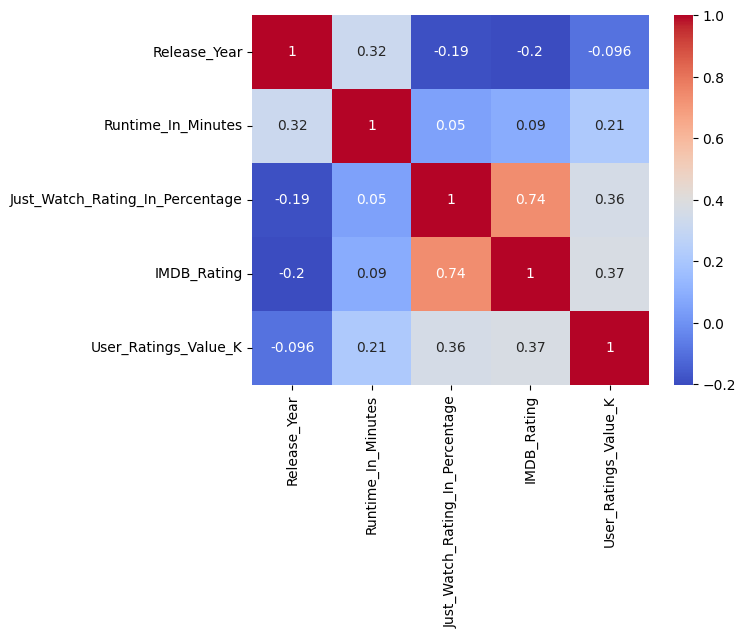

In [ ]:

sns.heatmap(fantasy_tvshows.corr(),cmap='coolwarm',annot=True)

In [ ]:

fantasy_tvshows_correlation_matrix = fantasy_tvshows.corr()
fantasy_tvshows_correlation_table = fantasy_tvshows_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
fantasy_tvshows_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
fantasy_tvshows_correlation_table['Correlation Type'] = fantasy_tvshows_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
fantasy_tvshows_correlation_table['Correlation Strength'] = fantasy_tvshows_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


fantasy_tvshows_correlation_table


<ipython-input-1604-5a761cb17a2f>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  fantasy_tvshows_correlation_matrix = fantasy_tvshows.corr()
/usr/local/lib/python3.10/dist-packages/IPython/core/displayhook.py:275: UserWarning: Output cache limit (currently 1000 entries) hit.
Flushing oldest 200 entries.
  warn('Output cache limit (currently {sz} entries) hit.\n'


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.735307,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.735307,Positive,Strong
7,User_Ratings_Value_K,IMDB_Rating,0.374021,Positive,Weak
8,IMDB_Rating,User_Ratings_Value_K,0.374021,Positive,Weak
9,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.360347,Positive,Weak


# Animation TV Shows Analysis

In [ ]:
animation_tvshows.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
14,3Below: Tales of Arcadia,TV-Show,Tatiana Maslany,2018,2016-2020,Animation,22,20-25,82.0,80-90,7.7,7.6-8.0,6.0,1-50
55,Adventures of Sonic the Hedgehog,TV-Show,Jaleel White,1993,1991-1995,Animation,22,20-25,71.0,70-80,6.3,6.1-6.5,4.0,1-50
73,Agent Elvis,TV-Show,Matthew McConaughey,2023,2021-2025,Animation,30,30-35,79.0,70-80,6.9,6.6-7.0,1.0,1-50
81,Aggretsuko,TV-Show,Kaolip,2018,2016-2020,Animation,17,15-20,83.0,80-90,8.0,8.1-8.5,6.0,1-50
99,Alien Worlds,TV-Show,Sophie Okonedo,2020,2021-2025,Animation,44,40-45,72.0,70-80,6.5,6.6-7.0,3.0,1-50


#140 Animation TV Shows

In [ ]:
animation_tvshows.shape


(140, 14)

In [ ]:
animation_tvshows.Release_Year_Range.value_counts()


2021-2025    63
2016-2020    39
2011-2015    13
2001-2005     9
1991-1995     5
2006-2010     5
1996-2000     5
1981-1985     1
Name: Release_Year_Range, dtype: int64

In [ ]:
animation_tvshows.JustWatch_Range.value_counts()


80-90     53
70-80     37
90-100    32
60-70      9
40-50      3
30-40      3
50-60      2
0-10       1
Name: JustWatch_Range, dtype: int64

In [ ]:
animation_tvshows.IMDB_Range.value_counts()


7.1-7.5    26
7.6-8.0    21
6.6-7.0    20
8.1-8.5    19
6.1-6.5    16
8.6-9.0    16
5.6-6.0    10
9.1-9.5     4
nan         4
4.6-5.0     2
5.1-5.5     2
Name: IMDB_Range, dtype: int64

In [ ]:
animation_tvshows.UserRatings_Range.value_counts()


1-50       89
nan        32
51-100      7
101-150     7
301-350     2
151-200     2
201-250     1
Name: UserRatings_Range, dtype: int64

In [ ]:
animation_tvshows.Runtime_Range.value_counts()


20-25      58
25-30      49
15-20      10
10-15       6
30-35       6
5-10        4
45-50       3
40-45       2
50-55       1
130-135     1
170-175     0
185-190     0
180-185     0
175-180     0
0-5         0
165-170     0
195-200     0
160-165     0
190-195     0
215-220     0
200-205     0
205-210     0
210-215     0
150-155     0
220-225     0
225-230     0
230-235     0
235-240     0
240-245     0
155-160     0
125-130     0
145-150     0
85-90       0
35-40       0
55-60       0
60-65       0
65-70       0
70-75       0
75-80       0
80-85       0
90-95       0
140-145     0
95-100      0
100-105     0
105-110     0
110-115     0
115-120     0
120-125     0
135-140     0
245-250     0
Name: Runtime_Range, dtype: int64

#**Animation TV Shows Summary Statistics**

Release Year:

Count: There are 140 animation TV shows in the dataset.
Mean: The average release year for animation TV shows is approximately 2015.7, indicating a mix of older and more recent shows.
Standard Deviation: The release years of animation TV shows have a standard deviation of approximately 8.5, suggesting some variability in the years of release.
Minimum: The earliest release year for an animation TV show in the dataset is 1984.
Maximum: The latest release year for an animation TV show in the dataset is 2023, indicating recent releases.
25th Percentile: 25% of the animation TV shows were released in or before the year 2013.5.
50th Percentile (Median): 50% of the animation TV shows were released in or before the year 2019, providing the median release year.
75th Percentile: 75% of the animation TV shows were released in or before the year 2021, indicating a concentration of recent releases.
****
Runtime in Minutes:

Mean: The average runtime of animation TV shows is approximately 24.8 minutes, indicating relatively shorter episode durations.
Standard Deviation: The runtime of animation TV shows varies by approximately 11.3 minutes, suggesting some variability in episode lengths.
Minimum: The shortest runtime for an animation TV show in the dataset is 5 minutes.
Maximum: The longest runtime for an animation TV show in the dataset is 131 minutes, suggesting some shows may have extended episodes or different episode structures.
25th Percentile: 25% of the animation TV shows have an episode runtime of 22 minutes or less.
50th Percentile (Median): 50% of the animation TV shows have an episode runtime of 24 minutes, providing the median runtime.
75th Percentile: 75% of the animation TV shows have an episode runtime of 26 minutes or less.
****
Just Watch Rating in Percentage:

Mean: The average Just Watch rating for animation TV shows is approximately 79.8%, indicating a generally positive reception by viewers.
Standard Deviation: The Just Watch ratings for animation TV shows vary by approximately 13.9%, suggesting some variability in audience ratings.
Minimum: The lowest Just Watch rating for an animation TV show in the dataset is 7%.
Maximum: The highest Just Watch rating for an animation TV show in the dataset is 98%, indicating highly acclaimed shows.
25th Percentile: 25% of the animation TV shows have a Just Watch rating of 75% or lower.
50th Percentile (Median): 50% of the animation TV shows have a Just Watch rating of 82%, providing the median rating.
75th Percentile: 75% of the animation TV shows have a Just Watch rating of 89% or lower.
****
IMDb Rating:

Mean: The average IMDb rating for animation TV shows is approximately 7.1 out of 10, indicating a generally positive reception by viewers.
Standard Deviation: The IMDb ratings for animation TV shows have a standard deviation of approximately 1.6, indicating some variability in the ratings.
Minimum: The lowest IMDb rating for an animation TV show in the dataset is 0, which could be an anomaly or a less popular show.
Maximum: The highest IMDb rating for an animation TV show in the dataset is 9.3 out of 10, indicating highly acclaimed shows.
25th Percentile: 25% of the animation TV shows have an IMDb rating of 6.5 or lower.
50th Percentile (Median): 50% of the animation TV shows have an IMDb rating of 7.3, providing the median rating.
75th Percentile: 75% of the animation TV shows have an IMDb rating of 8.0 or lower.
****
User Ratings Value (K):

Mean: The average user ratings value for animation TV shows is approximately 25.1 thousand, indicating a moderate level of user engagement.
Standard Deviation: The user ratings values for animation TV shows have a standard deviation of approximately 54.5 thousand, indicating a wide range of user engagement levels.
Minimum: The lowest user ratings value for an animation TV show in the dataset is 0 thousand, which could be an anomaly or a less popular show.
Maximum: The highest user ratings value for an animation TV show in the dataset is 343 thousand, indicating potentially highly popular shows.
25th Percentile: 25% of the animation TV shows have a user ratings value of 1 thousand or lower.
50th Percentile (Median): 50% of the animation TV shows have a user ratings value of 5 thousand or lower, providing the median value.
75th Percentile: 75% of the animation TV shows have a user ratings value of 20.25 thousand or lower.

In [ ]:
animation_tvshows.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,140.000000,140.000000,140.000000,140.000000,140.000000
mean,2015.671429,24.785714,79.807143,7.069286,25.128571
std,8.497518,11.286833,13.867252,1.577307,54.450273
min,1984.000000,5.000000,7.000000,0.000000,0.000000
25%,2013.500000,22.000000,75.000000,6.500000,1.000000
50%,2019.000000,24.000000,82.000000,7.300000,5.000000
75%,2021.000000,26.000000,89.000000,8.025000,20.250000
max,2023.000000,131.000000,98.000000,9.300000,343.000000


#**Animation TV Shows Correlation**


Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately 0.143. This suggests a weak positive correlation, indicating that animation TV shows released in later years may have slightly longer runtimes.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.175. This indicates a weak negative correlation, suggesting that animation TV shows released in later years may have slightly lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.228. This indicates a weak negative correlation, suggesting that animation TV shows released in later years may have slightly lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.269. This indicates a moderate negative correlation, suggesting that animation TV shows released in later years may have slightly lower user ratings values.

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.004. This suggests a very weak positive correlation, indicating that the runtime of animation TV shows has little to no influence on their Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.040. This suggests a very weak positive correlation, indicating that the runtime of animation TV shows has little to no influence on their IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.013. This suggests a very weak positive correlation, indicating that the runtime of animation TV shows has little to no influence on their user ratings values.

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.788. This indicates a strong positive correlation, suggesting that animation TV shows with higher Just Watch rating percentages tend to have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.322. This indicates a weak positive correlation, suggesting that animation TV shows with higher Just Watch rating percentages may have slightly higher user ratings values.

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.401. This suggests a moderate positive correlation, indicating that animation TV shows with higher IMDB ratings tend to have higher user ratings values.

In [ ]:
animation_tvshows.corr()


<ipython-input-1613-122360a40e3f>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  animation_tvshows.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,0.142755,-0.174724,-0.228450,-0.269242
Runtime_In_Minutes,0.142755,1.000000,0.004376,0.039553,0.012852
Just_Watch_Rating_In_Percentage,-0.174724,0.004376,1.000000,0.787667,0.321827
IMDB_Rating,-0.228450,0.039553,0.787667,1.000000,0.400801
User_Ratings_Value_K,-0.269242,0.012852,0.321827,0.400801,1.000000


<ipython-input-1614-c1a3f907a2b4>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(animation_tvshows.corr(),cmap='coolwarm',annot=True)


<Axes: >

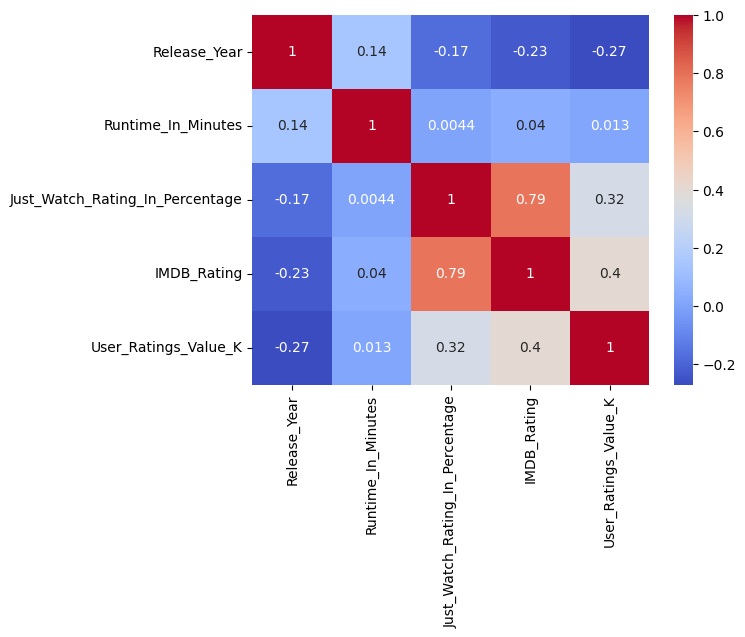

In [ ]:

sns.heatmap(animation_tvshows.corr(),cmap='coolwarm',annot=True)

In [ ]:

animation_tvshows_correlation_matrix = animation_tvshows.corr()
animation_tvshows_correlation_table = animation_tvshows_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
animation_tvshows_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
animation_tvshows_correlation_table['Correlation Type'] = animation_tvshows_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
animation_tvshows_correlation_table['Correlation Strength'] = animation_tvshows_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


animation_tvshows_correlation_table


<ipython-input-1615-1393faab769b>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  animation_tvshows_correlation_matrix = animation_tvshows.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.787667,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.787667,Positive,Strong
7,User_Ratings_Value_K,IMDB_Rating,0.400801,Positive,Weak
8,IMDB_Rating,User_Ratings_Value_K,0.400801,Positive,Weak
9,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.321827,Positive,Weak


# Romance TV Shows Analysis

In [ ]:
romance_tvshows.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
30,A Girl and an Astronaut,TV-Show,Bartosz Prokopowicz,2023,2021-2025,Romance,47,45-50,63.0,60-70,4.8,4.6-5.0,1.0,1-50
38,A Korean Odyssey,TV-Show,Park Hong-kyun,2017,2016-2020,Romance,75,75-80,88.0,80-90,8.0,8.1-8.5,5.0,1-50
80,Aggretsuko,TV-Show,Kaolip,2018,2016-2020,Romance,17,15-20,83.0,80-90,8.0,8.1-8.5,6.0,1-50
90,Alchemy of Souls,TV-Show,Lee Jae-wook,2022,2021-2025,Romance,79,75-80,96.0,90-100,8.8,8.6-9.0,11.0,1-50
133,An astrological guide for broken hearts,TV-Show,Lucrezia Bertini,2021,2021-2025,Romance,34,30-35,74.0,70-80,7.1,7.1-7.5,3.0,1-50


#125 Romance TV Shows

In [ ]:
romance_tvshows.shape


(125, 14)

In [ ]:
romance_tvshows.Release_Year_Range.value_counts()


2021-2025    78
2016-2020    32
2011-2015     9
2006-2010     3
2001-2005     3
Name: Release_Year_Range, dtype: int64

In [ ]:
romance_tvshows.JustWatch_Range.value_counts()


80-90     59
70-80     24
90-100    21
60-70     15
50-60      3
30-40      1
40-50      1
20-30      1
Name: JustWatch_Range, dtype: int64

In [ ]:
romance_tvshows.IMDB_Range.value_counts()


7.6-8.0    32
7.1-7.5    24
8.1-8.5    18
6.1-6.5    13
6.6-7.0    12
8.6-9.0     9
5.6-6.0     8
5.1-5.5     5
4.6-5.0     3
4.1-4.5     1
Name: IMDB_Range, dtype: int64

In [ ]:
romance_tvshows.UserRatings_Range.value_counts()


1-50       90
nan        22
51-100      4
101-150     4
151-200     2
301-350     1
201-250     1
251-300     1
Name: UserRatings_Range, dtype: int64

In [ ]:
romance_tvshows.Runtime_Range.value_counts()


40-45      16
20-25      15
25-30      15
50-55      15
45-50      13
30-35       9
35-40       9
60-65       8
55-60       8
70-75       6
65-70       4
75-80       2
15-20       2
95-100      1
85-90       1
80-85       1
180-185     0
210-215     0
185-190     0
175-180     0
190-195     0
195-200     0
200-205     0
205-210     0
0-5         0
215-220     0
220-225     0
225-230     0
230-235     0
235-240     0
165-170     0
240-245     0
170-175     0
125-130     0
160-165     0
155-160     0
150-155     0
145-150     0
140-145     0
135-140     0
130-135     0
5-10        0
120-125     0
115-120     0
110-115     0
105-110     0
100-105     0
90-95       0
10-15       0
245-250     0
Name: Runtime_Range, dtype: int64

#**Romance TV Shows Summary Statistics**

Release Year:

Count: There are 125 romance TV shows in the dataset.
Mean: The average release year for romance TV shows is approximately 2019.0, indicating a mix of recent and relatively older shows.
Standard Deviation: The release years of romance TV shows have a standard deviation of approximately 4.6, suggesting some variability in the years of release.
Minimum: The earliest release year for a romance TV show in the dataset is 2000.
Maximum: The latest release year for a romance TV show in the dataset is 2023, indicating recent releases.
25th Percentile: 25% of the romance TV shows were released in or before the year 2018.0.
50th Percentile (Median): 50% of the romance TV shows were released in or before the year 2020, providing the median release year.
75th Percentile: 75% of the romance TV shows were released in or before the year 2022, indicating a concentration of recent releases.

****
Runtime in Minutes:

Mean: The average runtime of romance TV shows is approximately 44.2 minutes, indicating a moderate duration for episodes.
Standard Deviation: The runtime of romance TV shows varies by approximately 16.7 minutes, suggesting some variability in episode lengths.
Minimum: The shortest runtime for a romance TV show in the dataset is 17 minutes.
Maximum: The longest runtime for a romance TV show in the dataset is 95 minutes.
25th Percentile: 25% of the romance TV shows have an episode runtime of 29 minutes or less.
50th Percentile (Median): 50% of the romance TV shows have an episode runtime of 44 minutes, providing the median runtime.
75th Percentile: 75% of the romance TV shows have an episode runtime of 54 minutes or less.

****
Just Watch Rating in Percentage:

Mean: The average Just Watch rating for romance TV shows is approximately 79.9%, indicating a generally positive reception by viewers.
Standard Deviation: The Just Watch ratings for romance TV shows vary by approximately 11.6%, suggesting some variability in audience ratings.
Minimum: The lowest Just Watch rating for a romance TV show in the dataset is 24%.
Maximum: The highest Just Watch rating for a romance TV show in the dataset is 96%, indicating highly acclaimed shows.
25th Percentile: 25% of the romance TV shows have a Just Watch rating of 74% or lower.
50th Percentile (Median): 50% of the romance TV shows have a Just Watch rating of 83%, providing the median rating.
75th Percentile: 75% of the romance TV shows have a Just Watch rating of 88% or lower.

****
IMDb Rating:

Mean: The average IMDb rating for romance TV shows is approximately 7.2 out of 10, indicating a generally positive reception by viewers.
Standard Deviation: The IMDb ratings for romance TV shows have a standard deviation of approximately 1.0, indicating some variability in the ratings.
Minimum: The lowest IMDb rating for a romance TV show in the dataset is 4.4 out of 10.
Maximum: The highest IMDb rating for a romance TV show in the dataset is 8.8 out of 10, indicating highly acclaimed shows.
25th Percentile: 25% of the romance TV shows have an IMDb rating of 6.5 or lower.
50th Percentile (Median): 50% of the romance TV shows have an IMDb rating of 7.4, providing the median rating.
75th Percentile: 75% of the romance TV shows have an IMDb rating of 7.9 or lower.

****
User Ratings Value (K):

Mean: The average user ratings value for romance TV shows is approximately 24.0 thousand, indicating a moderate level of user engagement.
Standard Deviation: The user ratings values for romance TV shows have a standard deviation of approximately 51.5 thousand, indicating a wide range of user engagement levels.
Minimum: The lowest user ratings value for a romance TV show in the dataset is 0 thousand, which could be an anomaly or a less popular show.
Maximum: The highest user ratings value for a romance TV show in the dataset is 322 thousand, indicating potentially highly popular shows.
25th Percentile: 25% of the romance TV shows have a user ratings value of 1 thousand or lower.
50th Percentile (Median): 50% of the romance TV shows have a user ratings value of 6 thousand or lower, providing the median value.
75th Percentile: 75% of the romance TV shows have a user ratings value of 20 thousand or lower.

In [ ]:
romance_tvshows.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,125.000000,125.000000,125.000000,125.000000,125.000000
mean,2019.024000,44.240000,79.888000,7.171200,24.024000
std,4.581632,16.684163,11.612852,1.017097,51.469606
min,2000.000000,17.000000,24.000000,4.400000,0.000000
25%,2018.000000,29.000000,74.000000,6.500000,1.000000
50%,2020.000000,44.000000,83.000000,7.400000,6.000000
75%,2022.000000,54.000000,88.000000,7.900000,20.000000
max,2023.000000,95.000000,96.000000,8.800000,322.000000


# **Romance TV Shows Correlation**


Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately 0.170. This suggests a weak positive correlation, indicating that there may be a slight tendency for romance TV shows released in later years to have longer runtimes.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.226. This indicates a weak negative correlation, suggesting that romance TV shows released in later years may have slightly lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.207. This indicates a weak negative correlation, suggesting that romance TV shows released in later years may have slightly lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.291. This indicates a moderate negative correlation, suggesting that romance TV shows released in later years may have slightly lower user ratings values.

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.126. This suggests a weak positive correlation, indicating that the runtime of romance TV shows has little to no influence on their Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.239. This suggests a weak positive correlation, indicating that the runtime of romance TV shows may have a slight positive influence on their IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately -0.021. This suggests a very weak negative correlation, indicating that the runtime of romance TV shows has little to no influence on their user ratings values.

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.786. This indicates a strong positive correlation, suggesting that romance TV shows with higher Just Watch rating percentages tend to have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.273. This indicates a weak positive correlation, suggesting that romance TV shows with higher Just Watch rating percentages may have slightly higher user ratings values.

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.190. This suggests a weak positive correlation, indicating that romance TV shows with higher IMDB ratings may have slightly higher user ratings values.

In [ ]:
romance_tvshows.corr()


<ipython-input-1624-9c4f8d04ce54>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  romance_tvshows.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,0.170307,-0.226095,-0.207003,-0.291237
Runtime_In_Minutes,0.170307,1.000000,0.126050,0.239313,-0.020837
Just_Watch_Rating_In_Percentage,-0.226095,0.126050,1.000000,0.785529,0.273104
IMDB_Rating,-0.207003,0.239313,0.785529,1.000000,0.190082
User_Ratings_Value_K,-0.291237,-0.020837,0.273104,0.190082,1.000000


<ipython-input-1625-7c5b9fbfca24>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(romance_tvshows.corr(),cmap='coolwarm',annot=True)


<Axes: >

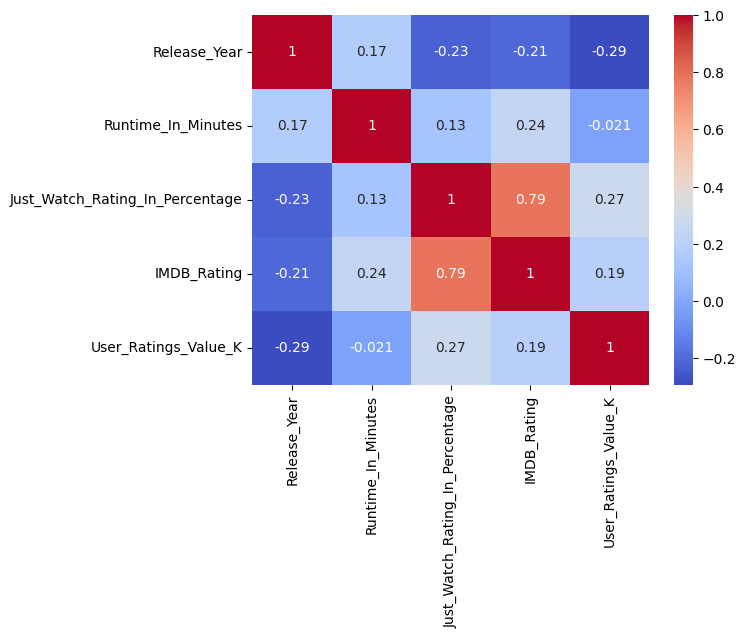

In [ ]:

sns.heatmap(romance_tvshows.corr(),cmap='coolwarm',annot=True)

In [ ]:

romance_tvshows_correlation_matrix = romance_tvshows.corr()
romance_tvshows_correlation_table = romance_tvshows_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
romance_tvshows_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
romance_tvshows_correlation_table['Correlation Type'] = romance_tvshows_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
romance_tvshows_correlation_table['Correlation Strength'] = romance_tvshows_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


romance_tvshows_correlation_table


<ipython-input-1626-705695b26fa0>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  romance_tvshows_correlation_matrix = romance_tvshows.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.785529,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.785529,Positive,Strong
7,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.273104,Positive,Weak
8,Just_Watch_Rating_In_Percentage,User_Ratings_Value_K,0.273104,Positive,Weak
9,Runtime_In_Minutes,IMDB_Rating,0.239313,Positive,Weak


# Reality TV Shows Analysis

In [ ]:
reality_tv_tvshows.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
1,(Un)Well,TV-Show,No Value,2020,2021-2025,Reality TV,52,50-55,69.0,60-70,6.4,6.1-6.5,1.0,1-50
9,28 Days Haunted,TV-Show,No Value,2022,2021-2025,Reality TV,34,30-35,63.0,60-70,3.5,3.6-4.0,2.0,1-50
22,60 Days In,TV-Show,Reginald Scandrett,2016,2016-2020,Reality TV,46,45-50,78.0,70-80,7.6,7.6-8.0,2.0,1-50
26,A Clean Sweep,TV-Show,장시원,2022,2021-2025,Reality TV,112,110-115,64.0,60-70,9.4,9.1-9.5,0.0,nan
113,Alone,TV-Show,No Value,2015,2016-2020,Reality TV,47,45-50,84.0,80-90,8.4,8.1-8.5,6.0,1-50


#111 Reality TV Shows

In [ ]:
reality_tv_tvshows.shape


(111, 14)

In [ ]:
reality_tv_tvshows.Release_Year_Range.value_counts()


2021-2025    74
2016-2020    25
2001-2005     5
2011-2015     3
2006-2010     3
1991-1995     1
Name: Release_Year_Range, dtype: int64

In [ ]:
reality_tv_tvshows.JustWatch_Range.value_counts()


70-80     33
60-70     31
80-90     21
50-60     12
30-40      6
40-50      4
90-100     2
20-30      1
0-10       1
Name: JustWatch_Range, dtype: int64

In [ ]:
reality_tv_tvshows.IMDB_Range.value_counts()


6.1-6.5    16
7.1-7.5    16
5.6-6.0    14
7.6-8.0    13
6.6-7.0    11
4.6-5.0     8
8.1-8.5     6
5.1-5.5     6
4.1-4.5     5
2.6-3.0     4
nan         4
8.6-9.0     4
3.6-4.0     3
9.1-9.5     1
Name: IMDB_Range, dtype: int64

In [ ]:
reality_tv_tvshows.UserRatings_Range.value_counts()


1-50       64
nan        45
51-100      1
101-150     1
Name: UserRatings_Range, dtype: int64

In [ ]:
reality_tv_tvshows.Runtime_Range.value_counts()


40-45      25
45-50      18
35-40      14
30-35      13
50-55      10
55-60       8
25-30       8
20-25       7
65-70       4
15-20       2
110-115     1
105-110     1
170-175     0
165-170     0
175-180     0
180-185     0
185-190     0
190-195     0
195-200     0
0-5         0
225-230     0
200-205     0
205-210     0
210-215     0
215-220     0
220-225     0
155-160     0
230-235     0
235-240     0
240-245     0
160-165     0
125-130     0
150-155     0
145-150     0
10-15       0
60-65       0
70-75       0
75-80       0
80-85       0
85-90       0
90-95       0
95-100      0
100-105     0
115-120     0
120-125     0
5-10        0
130-135     0
135-140     0
140-145     0
245-250     0
Name: Runtime_Range, dtype: int64

# **Reality TV Shows Summary Statistics**

Release Year:

Count: There are 111 reality TV shows in the dataset.
Mean: The average release year for reality TV shows is approximately 2018.9, indicating a mix of recent and relatively older shows.
Standard Deviation: The release years of reality TV shows have a standard deviation of approximately 5.6, suggesting some variability in the years of release.
Minimum: The earliest release year for a reality TV show in the dataset is 1992.
Maximum: The latest release year for a reality TV show in the dataset is 2023, indicating recent releases.
25th Percentile: 25% of the reality TV shows were released in or before the year 2019.0.
50th Percentile (Median): 50% of the reality TV shows were released in or before the year 2021, providing the median release year.
75th Percentile: 75% of the reality TV shows were released in or before the year 2022, indicating a concentration of recent releases.
****

Runtime in Minutes:

Mean: The average runtime of reality TV shows is approximately 42.5 minutes, indicating a moderate duration for episodes.
Standard Deviation: The runtime of reality TV shows varies by approximately 14.1 minutes, suggesting some variability in episode lengths.
Minimum: The shortest runtime for a reality TV show in the dataset is 19 minutes.
Maximum: The longest runtime for a reality TV show in the dataset is 112 minutes.
25th Percentile: 25% of the reality TV shows have an episode runtime of 34 minutes or less.
50th Percentile (Median): 50% of the reality TV shows have an episode runtime of 42 minutes, providing the median runtime.
75th Percentile: 75% of the reality TV shows have an episode runtime of 48 minutes or less.

****
Just Watch Rating in Percentage:

Mean: The average Just Watch rating for reality TV shows is approximately 67.6%, indicating a mixed reception by viewers.
Standard Deviation: The Just Watch ratings for reality TV shows vary by approximately 15.1%, suggesting some variability in audience ratings.
Minimum: The lowest Just Watch rating for a reality TV show in the dataset is 6%.
Maximum: The highest Just Watch rating for a reality TV show in the dataset is 90%, indicating highly acclaimed shows.
25th Percentile: 25% of the reality TV shows have a Just Watch rating of 61.5% or lower.
50th Percentile (Median): 50% of the reality TV shows have a Just Watch rating of 70%, providing the median rating.
75th Percentile: 75% of the reality TV shows have a Just Watch rating of 79% or lower.

****
IMDb Rating:

Mean: The average IMDb rating for reality TV shows is approximately 6.1 out of 10, indicating a mixed reception by viewers.
Standard Deviation: The IMDb ratings for reality TV shows have a standard deviation of approximately 1.8, indicating some variability in the ratings.
Minimum: The lowest IMDb rating for a reality TV show in the dataset is 0 out of 10, which could be an anomaly or a less popular show.
Maximum: The highest IMDb rating for a reality TV show in the dataset is 9.4 out of 10, indicating highly acclaimed shows.
25th Percentile: 25% of the reality TV shows have an IMDb rating of 5.35 or lower.
50th Percentile (Median): 50% of the reality TV shows have an IMDb rating of 6.3, providing the median rating.
75th Percentile: 75% of the reality TV shows have an IMDb rating of 7.2 or lower.

****
User Ratings Value (K):

Mean: The average user ratings value for reality TV shows is approximately 4.7 thousand, indicating a relatively low level of user engagement.
Standard Deviation: The user ratings values for reality TV shows have a standard deviation of approximately 14.0 thousand, suggesting some variability in user engagement levels.
Minimum: The lowest user ratings value for a reality TV show in the dataset is 0 thousand, indicating potentially less popular shows.
Maximum: The highest user ratings value for a reality TV show in the dataset is 122 thousand, indicating potentially highly popular shows.
25th Percentile: 25% of the reality TV shows have a user ratings value of 0 thousand.
50th Percentile (Median): 50% of the reality TV shows have a user ratings value of 1 thousand or lower, providing the median value.
75th Percentile: 75% of the reality TV shows have a user ratings value of 4 thousand or lower.

In [ ]:
reality_tv_tvshows.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,111.000000,111.000000,111.000000,111.000000,111.000000
mean,2018.900901,42.531532,67.558559,6.060360,4.720721
std,5.622932,14.133017,15.100683,1.828078,14.000760
min,1992.000000,19.000000,6.000000,0.000000,0.000000
25%,2019.000000,34.000000,61.500000,5.350000,0.000000
50%,2021.000000,42.000000,70.000000,6.300000,1.000000
75%,2022.000000,48.000000,79.000000,7.200000,4.000000
max,2023.000000,112.000000,90.000000,9.400000,122.000000


#**Reality TV Shows Correlation**

Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately 0.033. This suggests a very weak positive correlation, indicating that there is little to no relationship between the release year and runtime of reality TV shows.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.236. This indicates a weak negative correlation, suggesting that reality TV shows released in later years may have slightly lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.197. This indicates a weak negative correlation, suggesting that reality TV shows released in later years may have slightly lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.402. This indicates a moderate negative correlation, suggesting that reality TV shows released in later years may have slightly lower user ratings values.

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.040. This suggests a very weak positive correlation, indicating that the runtime of reality TV shows has little to no influence on their Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.096. This suggests a very weak positive correlation, indicating that the runtime of reality TV shows has little to no influence on their IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.041. This suggests a very weak positive correlation, indicating that the runtime of reality TV shows has little to no influence on their user ratings values.

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.861. This indicates a strong positive correlation, suggesting that reality TV shows with higher Just Watch rating percentages tend to have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.313. This indicates a moderate positive correlation, suggesting that reality TV shows with higher Just Watch rating percentages tend to have higher user ratings values.

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.266. This indicates a weak positive correlation, suggesting that reality TV shows with higher IMDB ratings tend to have slightly higher user ratings values.

In [ ]:
reality_tv_tvshows.corr()


<ipython-input-1635-168961bcd163>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  reality_tv_tvshows.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,0.032814,-0.236384,-0.197430,-0.402212
Runtime_In_Minutes,0.032814,1.000000,0.039745,0.095756,0.040544
Just_Watch_Rating_In_Percentage,-0.236384,0.039745,1.000000,0.860989,0.313219
IMDB_Rating,-0.197430,0.095756,0.860989,1.000000,0.266276
User_Ratings_Value_K,-0.402212,0.040544,0.313219,0.266276,1.000000


<ipython-input-1636-bc09727d98f2>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(reality_tv_tvshows.corr(),cmap='coolwarm',annot=True)


<Axes: >

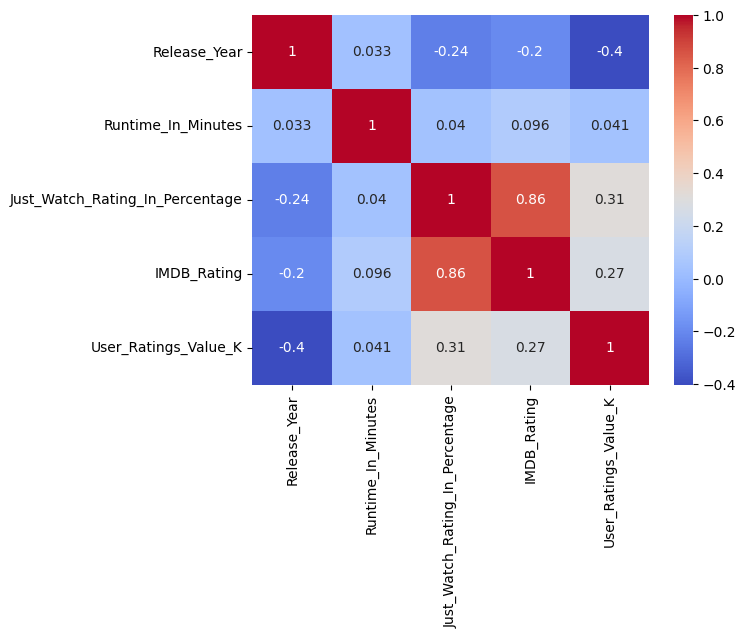

In [ ]:

sns.heatmap(reality_tv_tvshows.corr(),cmap='coolwarm',annot=True)


In [ ]:

reality_tv_tvshows_correlation_matrix = reality_tv_tvshows.corr()
reality_tv_tvshows_correlation_table = reality_tv_tvshows_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
reality_tv_tvshows_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
reality_tv_tvshows_correlation_table['Correlation Type'] = reality_tv_tvshows_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
reality_tv_tvshows_correlation_table['Correlation Strength'] = reality_tv_tvshows_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


reality_tv_tvshows_correlation_table


<ipython-input-1637-42a2953f5e81>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  reality_tv_tvshows_correlation_matrix = reality_tv_tvshows.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.860989,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.860989,Positive,Strong
7,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.313219,Positive,Weak
8,Just_Watch_Rating_In_Percentage,User_Ratings_Value_K,0.313219,Positive,Weak
9,IMDB_Rating,User_Ratings_Value_K,0.266276,Positive,Weak


# Kids and Family TV Shows Analysis

In [ ]:
kids_family_tvshows.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
15,3Below: Tales of Arcadia,TV-Show,Tatiana Maslany,2018,2016-2020,Kids & Family,22,20-25,82.0,80-90,7.7,7.6-8.0,6.0,1-50
45,A Series of Unfortunate Events,TV-Show,Neil Patrick Harris,2017,2016-2020,Kids & Family,47,45-50,84.0,80-90,7.8,7.6-8.0,63.0,51-100
56,Adventures of Sonic the Hedgehog,TV-Show,Jaleel White,1993,1991-1995,Kids & Family,22,20-25,71.0,70-80,6.3,6.1-6.5,4.0,1-50
147,Anne with an E,TV-Show,Amybeth McNulty,2017,2016-2020,Kids & Family,46,45-50,95.0,90-100,8.7,8.6-9.0,59.0,51-100
170,Are You Afraid of the Dark?,TV-Show,Conor Sherry,2019,2016-2020,Kids & Family,44,40-45,81.0,80-90,7.1,7.1-7.5,2.0,1-50


#95 Kids and Family TV Shows

In [ ]:
kids_family_tvshows.shape


(95, 14)

In [ ]:
kids_family_tvshows.Release_Year_Range.value_counts()


2021-2025    34
2016-2020    28
2011-2015    12
2001-2005     8
2006-2010     6
1991-1995     4
1996-2000     2
1981-1985     1
Name: Release_Year_Range, dtype: int64

In [ ]:
kids_family_tvshows.JustWatch_Range.value_counts()


80-90     47
70-80     28
90-100    11
60-70      8
50-60      1
Name: JustWatch_Range, dtype: int64

In [ ]:
kids_family_tvshows.IMDB_Range.value_counts()


7.1-7.5    23
6.1-6.5    14
7.6-8.0    13
6.6-7.0    12
8.1-8.5    11
5.6-6.0     9
8.6-9.0     7
9.1-9.5     2
5.1-5.5     2
3.6-4.0     1
4.6-5.0     1
Name: IMDB_Range, dtype: int64

In [ ]:
kids_family_tvshows.UserRatings_Range.value_counts()


1-50       67
nan        22
51-100      2
301-350     2
101-150     2
Name: UserRatings_Range, dtype: int64

In [ ]:
kids_family_tvshows.Runtime_Range.value_counts()


20-25      40
25-30      22
45-50       9
15-20       6
10-15       5
5-10        4
40-45       3
30-35       2
35-40       2
50-55       1
130-135     1
185-190     0
180-185     0
175-180     0
0-5         0
170-175     0
165-170     0
195-200     0
190-195     0
220-225     0
200-205     0
205-210     0
210-215     0
215-220     0
155-160     0
225-230     0
230-235     0
235-240     0
240-245     0
160-165     0
125-130     0
150-155     0
90-95       0
55-60       0
60-65       0
65-70       0
70-75       0
75-80       0
80-85       0
85-90       0
95-100      0
145-150     0
100-105     0
105-110     0
110-115     0
115-120     0
120-125     0
135-140     0
140-145     0
245-250     0
Name: Runtime_Range, dtype: int64

#**Kids and Family TV Shows Summary Statistics**

Release Year:

Count: There are 95 kids and family TV shows in the dataset.
Mean: The average release year for kids and family TV shows is approximately 2014.4, indicating a mix of relatively older and more recent shows.
Standard Deviation: The release years of kids and family TV shows have a standard deviation of approximately 8.7, suggesting some variability in the years of release.
Minimum: The earliest release year for a kids and family TV show in the dataset is 1984.
Maximum: The latest release year for a kids and family TV show in the dataset is 2023, indicating recent releases.
25th Percentile: 25% of the kids and family TV shows were released in or before the year 2010.0.
50th Percentile (Median): 50% of the kids and family TV shows were released in or before the year 2018, providing the median release year.
75th Percentile: 75% of the kids and family TV shows were released in or before the year 2021, indicating a concentration of recent releases.

****
Runtime in Minutes:

Mean: The average runtime of kids and family TV shows is approximately 26.7 minutes, indicating relatively shorter durations.
Standard Deviation: The runtime of kids and family TV shows varies by approximately 14.7 minutes, suggesting some variability in show lengths.
Minimum: The shortest runtime for a kids and family TV show in the dataset is 5 minutes.
Maximum: The longest runtime for a kids and family TV show in the dataset is 131 minutes.
25th Percentile: 25% of the kids and family TV shows have a runtime of 22 minutes or less.
50th Percentile (Median): 50% of the kids and family TV shows have a runtime of 24 minutes, providing the median runtime.
75th Percentile: 75% of the kids and family TV shows have a runtime of 26 minutes or less.

****
Just Watch Rating in Percentage:

Mean: The average Just Watch rating for kids and family TV shows is approximately 80.4%, indicating a generally positive reception by viewers.
Standard Deviation: The Just Watch ratings for kids and family TV shows vary by approximately 8.0%, suggesting some variability in audience ratings.
Minimum: The lowest Just Watch rating for a kids and family TV show in the dataset is 54%.
Maximum: The highest Just Watch rating for a kids and family TV show in the dataset is 98%, indicating highly acclaimed shows.
25th Percentile: 25% of the kids and family TV shows have a Just Watch rating of 74.5% or lower.
50th Percentile (Median): 50% of the kids and family TV shows have a Just Watch rating of 82%, providing the median rating.
75th Percentile: 75% of the kids and family TV shows have a Just Watch rating of 85% or lower.

****
IMDb Rating:

Mean: The average IMDb rating for kids and family TV shows is approximately 7.1 out of 10, indicating a generally positive reception by viewers.
Standard Deviation: The IMDb ratings for kids and family TV shows have a standard deviation of approximately 1.0, indicating relatively low variability in the ratings.
Minimum: The lowest IMDb rating for a kids and family TV show in the dataset is 3.9 out of 10.
Maximum: The highest IMDb rating for a kids and family TV show in the dataset is 9.3 out of 10, indicating highly acclaimed shows.
25th Percentile: 25% of the kids and family TV shows have an IMDb rating of 6.3 or lower.
50th Percentile (Median): 50% of the kids and family TV shows have an IMDb rating of 7.2, providing the median rating.
75th Percentile: 75% of the kids and family TV shows have an IMDb rating of 7.8 or lower.

****
User Ratings Value (K):

Mean: The average user ratings value for kids and family TV shows is approximately 18.3 thousand, indicating a moderate level of user engagement.
Standard Deviation: The user ratings values for kids and family TV shows have a standard deviation of approximately 49.7 thousand, suggesting a wide range of user engagement levels.
Minimum: The lowest user ratings value for a kids and family TV show in the dataset is 0 thousand.
Maximum: The highest user ratings value for a kids and family TV show in the dataset is 332 thousand, indicating potentially highly popular shows.
25th Percentile: 25% of the kids and family TV shows have a user ratings value of 1 thousand or lower.
50th Percentile (Median): 50% of the kids and family TV shows have a user ratings value of 5 thousand, providing the median value.
75th Percentile: 75% of the kids and family TV shows have a user ratings value of 15 thousand or lower.

In [ ]:
kids_family_tvshows.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,95.000000,95.000000,95.000000,95.000000,95.000000
mean,2014.442105,26.694737,80.400000,7.062105,18.336842
std,8.680764,14.696268,7.959204,1.021490,49.657896
min,1984.000000,5.000000,54.000000,3.900000,0.000000
25%,2010.000000,22.000000,74.500000,6.300000,1.000000
50%,2018.000000,24.000000,82.000000,7.200000,5.000000
75%,2021.000000,26.000000,85.000000,7.800000,15.000000
max,2023.000000,131.000000,98.000000,9.300000,332.000000


#**Kids and Family TV Shows Correlation**

Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately 0.158. This indicates a weak positive correlation, suggesting that kids and family TV shows released in later years may have slightly longer runtimes.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.196. This indicates a weak negative correlation, suggesting that kids and family TV shows released in later years may have slightly lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.160. This indicates a weak negative correlation, suggesting that kids and family TV shows released in later years may have slightly lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.122. This indicates a weak negative correlation, suggesting that kids and family TV shows released in later years may have slightly lower user ratings values.

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.132. This suggests a very weak positive correlation, indicating that the runtime of kids and family TV shows has little to no influence on their Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.153. This suggests a very weak positive correlation, indicating that the runtime of kids and family TV shows has little to no influence on their IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.142. This suggests a very weak positive correlation, indicating that the runtime of kids and family TV shows has little to no influence on their user ratings values.

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.703. This indicates a moderate positive correlation, suggesting that kids and family TV shows with higher Just Watch rating percentages tend to have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.386. This indicates a moderate positive correlation, suggesting that kids and family TV shows with higher Just Watch rating percentages tend to have higher user ratings values.

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.335. This indicates a moderate positive correlation, suggesting that kids and family TV shows with higher IMDB ratings tend to have higher user ratings values.

In [ ]:
kids_family_tvshows.corr()


<ipython-input-1646-7a5e5420efde>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  kids_family_tvshows.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,0.158173,-0.196439,-0.160413,-0.122090
Runtime_In_Minutes,0.158173,1.000000,0.132385,0.152644,0.142169
Just_Watch_Rating_In_Percentage,-0.196439,0.132385,1.000000,0.703493,0.385957
IMDB_Rating,-0.160413,0.152644,0.703493,1.000000,0.334639
User_Ratings_Value_K,-0.122090,0.142169,0.385957,0.334639,1.000000


<ipython-input-1647-a184e60586b6>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(kids_family_tvshows.corr(),cmap='coolwarm',annot=True)


<Axes: >

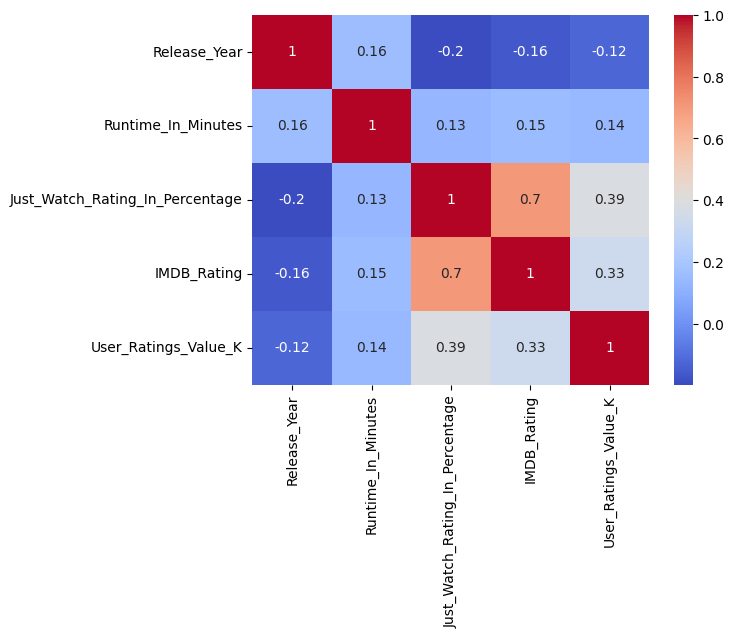

In [ ]:

sns.heatmap(kids_family_tvshows.corr(),cmap='coolwarm',annot=True)

In [ ]:

kids_family_tvshows_correlation_matrix = kids_family_tvshows.corr()
kids_family_tvshows_correlation_table = kids_family_tvshows_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
kids_family_tvshows_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
kids_family_tvshows_correlation_table['Correlation Type'] = kids_family_tvshows_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
kids_family_tvshows_correlation_table['Correlation Strength'] = kids_family_tvshows_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


kids_family_tvshows_correlation_table


<ipython-input-1648-ddde9d352f8b>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  kids_family_tvshows_correlation_matrix = kids_family_tvshows.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.703493,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.703493,Positive,Strong
7,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.385957,Positive,Weak
8,Just_Watch_Rating_In_Percentage,User_Ratings_Value_K,0.385957,Positive,Weak
9,IMDB_Rating,User_Ratings_Value_K,0.334639,Positive,Weak


# Horror TV Shows Analysis

In [ ]:
horror_tvshows.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
6,1899,TV-Show,Emily Beecham,2022,2021-2025,Horror,53,50-55,83.0,80-90,7.3,7.1-7.5,97.0,51-100
10,28 Days Haunted,TV-Show,No Value,2022,2021-2025,Horror,34,30-35,63.0,60-70,3.5,3.6-4.0,2.0,1-50
37,A Korean Odyssey,TV-Show,Park Hong-kyun,2017,2016-2020,Horror,75,75-80,88.0,80-90,8.0,8.1-8.5,5.0,1-50
111,All of Us Are Dead,TV-Show,JQ Lee,2022,2021-2025,Horror,61,60-65,89.0,80-90,7.5,7.6-8.0,56.0,51-100
167,Archive 81,TV-Show,Mamoudou Athie,2022,2021-2025,Horror,54,50-55,80.0,80-90,7.3,7.1-7.5,53.0,51-100


#79 Horror TV shows

In [ ]:
horror_tvshows.shape


(79, 14)

In [ ]:
horror_tvshows.Release_Year_Range.value_counts()


2021-2025    40
2016-2020    30
2011-2015     7
2006-2010     2
Name: Release_Year_Range, dtype: int64

In [ ]:
horror_tvshows.JustWatch_Range.value_counts()


80-90     27
70-80     25
90-100    17
60-70      8
50-60      2
Name: JustWatch_Range, dtype: int64

In [ ]:
horror_tvshows.IMDB_Range.value_counts()


7.1-7.5    16
8.1-8.5    16
6.6-7.0    12
7.6-8.0     8
6.1-6.5     8
5.6-6.0     7
8.6-9.0     5
3.6-4.0     2
5.1-5.5     2
4.6-5.0     2
4.1-4.5     1
Name: IMDB_Range, dtype: int64

In [ ]:
horror_tvshows.UserRatings_Range.value_counts()


1-50       51
51-100      8
nan         8
101-150     6
501-550     2
451-500     1
251-300     1
151-200     1
301-350     1
Name: UserRatings_Range, dtype: int64

In [ ]:
horror_tvshows.Runtime_Range.value_counts()


45-50      17
40-45      13
25-30      12
50-55      11
20-25       7
55-60       6
30-35       4
60-65       4
10-15       2
85-90       1
75-80       1
35-40       1
205-210     0
170-175     0
175-180     0
180-185     0
185-190     0
165-170     0
190-195     0
195-200     0
200-205     0
0-5         0
210-215     0
215-220     0
220-225     0
225-230     0
155-160     0
230-235     0
235-240     0
240-245     0
160-165     0
125-130     0
150-155     0
145-150     0
15-20       0
65-70       0
70-75       0
80-85       0
90-95       0
95-100      0
100-105     0
105-110     0
110-115     0
115-120     0
120-125     0
5-10        0
130-135     0
135-140     0
140-145     0
245-250     0
Name: Runtime_Range, dtype: int64

#**Horror TV Shows Summary Statistics**

Release Year:

Count: There are 79 horror TV shows in the dataset.
Mean: The average release year for horror TV shows is approximately 2018.7, indicating a mix of relatively recent and older shows.
Standard Deviation: The release years of horror TV shows have a standard deviation of approximately 3.8, suggesting some variability in the years of release.
Minimum: The earliest release year for a horror TV show in the dataset is 2005.
Maximum: The latest release year for a horror TV show in the dataset is 2023, indicating recent releases.
25th Percentile: 25% of the horror TV shows were released in or before the year 2017.5.
50th Percentile (Median): 50% of the horror TV shows were released in or before the year 2020, providing the median release year.
75th Percentile: 75% of the horror TV shows were released in or before the year 2022, indicating a concentration of recent releases.

****
Runtime in Minutes:

Mean: The average runtime of horror TV shows is approximately 42.5 minutes.
Standard Deviation: The runtime of horror TV shows varies by approximately 14.0 minutes, suggesting some variability in show lengths.
Minimum: The shortest runtime for a horror TV show in the dataset is 12 minutes.
Maximum: The longest runtime for a horror TV show in the dataset is 88 minutes.
25th Percentile: 25% of the horror TV shows have a runtime of 29 minutes or less.
50th Percentile (Median): 50% of the horror TV shows have a runtime of 45 minutes, providing the median runtime.
75th Percentile: 75% of the horror TV shows have a runtime of 51 minutes or less.
****
Just Watch Rating in Percentage:

Mean: The average Just Watch rating for horror TV shows is approximately 80.8%.
Standard Deviation: The Just Watch ratings for horror TV shows vary by approximately 9.4%, suggesting some variability in audience ratings.
Minimum: The lowest Just Watch rating for a horror TV show in the dataset is 54%.
Maximum: The highest Just Watch rating for a horror TV show in the dataset is 97%.
25th Percentile: 25% of the horror TV shows have a Just Watch rating of 75.5% or lower.
50th Percentile (Median): 50% of the horror TV shows have a Just Watch rating of 82%, providing the median rating.
75th Percentile: 75% of the horror TV shows have a Just Watch rating of 88.5% or lower.
****
IMDb Rating:

Mean: The average IMDb rating for horror TV shows is approximately 7.0 out of 10.
Standard Deviation: The IMDb ratings for horror TV shows have a standard deviation of approximately 1.2, indicating some variability in the ratings.
Minimum: The lowest IMDb rating for a horror TV show in the dataset is 3.5 out of 10.
Maximum: The highest IMDb rating for a horror TV show in the dataset is 8.7 out of 10.
25th Percentile: 25% of the horror TV shows have an IMDb rating of 6.4 or lower.
50th Percentile (Median): 50% of the horror TV shows have an IMDb rating of 7.1, providing the median rating.
75th Percentile: 75% of the horror TV shows have an IMDb rating of 8.1 or lower.
****
User Ratings Value (K):

Mean: The average user ratings value for horror TV shows is approximately 105.1 thousand, indicating a high level of user engagement.
Standard Deviation: The user ratings values for horror TV shows have a standard deviation of approximately 232.7 thousand, suggesting a wide range of user engagement levels.
Minimum: The lowest user ratings value for a horror TV show in the dataset is 0 thousand.
Maximum: The highest user ratings value for a horror TV show in the dataset is 1000 thousand, indicating potentially highly popular shows.
25th Percentile: 25% of the horror TV shows have a user ratings value of 4 thousand or lower.
50th Percentile (Median): 50% of the horror TV shows have a user ratings value of 21 thousand, providing the median value.
75th Percentile: 75% of the horror TV shows have a user ratings value of 70.5 thousand or lower.

In [ ]:
horror_tvshows.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,79.000000,79.000000,79.000000,79.000000,79.000000
mean,2018.696203,42.468354,80.848101,6.989873,105.139241
std,3.810762,13.959498,9.435460,1.189225,232.664981
min,2005.000000,12.000000,54.000000,3.500000,0.000000
25%,2017.500000,29.000000,75.500000,6.350000,4.000000
50%,2020.000000,45.000000,82.000000,7.100000,21.000000
75%,2022.000000,51.000000,88.500000,8.050000,70.500000
max,2023.000000,88.000000,97.000000,8.700000,1000.000000


#**Horror TV Shows Correlation**

Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately 0.192. This indicates a weak positive correlation, suggesting that horror TV shows released in later years may have slightly longer runtimes.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.451. This indicates a moderate negative correlation, suggesting that horror TV shows released in later years may have slightly lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.465. This indicates a moderate negative correlation, suggesting that horror TV shows released in later years may have slightly lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.390. This indicates a moderate negative correlation, suggesting that horror TV shows released in later years may have slightly lower user ratings values.

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.063. This suggests a very weak positive correlation, indicating that the runtime of horror TV shows has little to no influence on their Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.109. This suggests a very weak positive correlation, indicating that the runtime of horror TV shows has little to no influence on their IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.286. This indicates a moderate positive correlation, suggesting that horror TV shows with longer runtimes may have slightly higher user ratings values.

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.959. This indicates a strong positive correlation, suggesting that horror TV shows with higher Just Watch rating percentages tend to have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.472. This indicates a moderate positive correlation, suggesting that horror TV shows with higher Just Watch rating percentages tend to have higher user ratings values.

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.431. This indicates a moderate positive correlation, suggesting that horror TV shows with higher IMDB ratings tend to have higher user ratings values.

In [ ]:
horror_tvshows.corr()


<ipython-input-1657-06c206135a77>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  horror_tvshows.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,0.192138,-0.450563,-0.464923,-0.390251
Runtime_In_Minutes,0.192138,1.000000,0.063134,0.108871,0.285897
Just_Watch_Rating_In_Percentage,-0.450563,0.063134,1.000000,0.958925,0.471757
IMDB_Rating,-0.464923,0.108871,0.958925,1.000000,0.430732
User_Ratings_Value_K,-0.390251,0.285897,0.471757,0.430732,1.000000


<ipython-input-1658-6358b0441699>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(horror_tvshows.corr(),cmap='coolwarm',annot=True)


<Axes: >

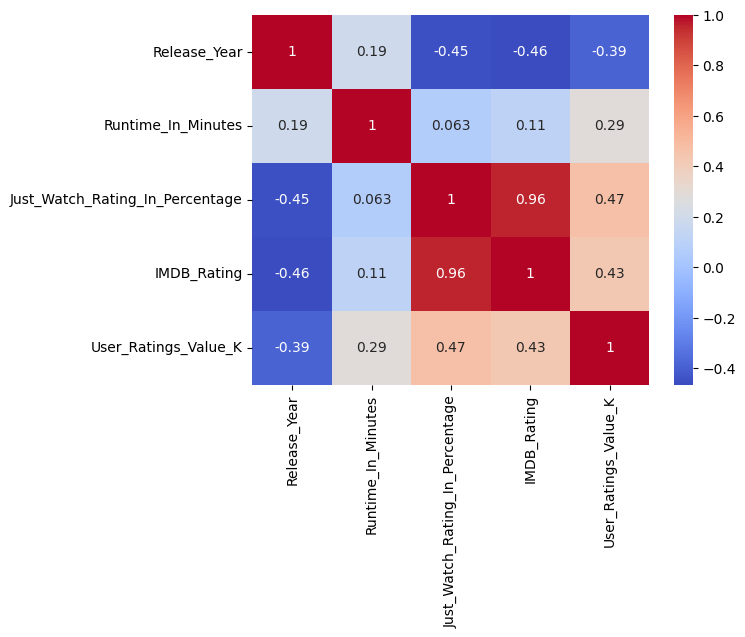

In [ ]:

sns.heatmap(horror_tvshows.corr(),cmap='coolwarm',annot=True)


In [ ]:

horror_tvshows_correlation_matrix = horror_tvshows.corr()
horror_tvshows_correlation_table = horror_tvshows_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
horror_tvshows_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
horror_tvshows_correlation_table['Correlation Type'] = horror_tvshows_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
horror_tvshows_correlation_table['Correlation Strength'] = horror_tvshows_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


horror_tvshows_correlation_table


<ipython-input-1659-099970f03190>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  horror_tvshows_correlation_matrix = horror_tvshows.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.958925,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.958925,Positive,Strong
7,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.471757,Positive,Weak
8,Just_Watch_Rating_In_Percentage,User_Ratings_Value_K,0.471757,Positive,Weak
9,IMDB_Rating,User_Ratings_Value_K,0.430732,Positive,Weak


# History TV Shows Analysis

In [ ]:
history_tvshows.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
8,1899,TV-Show,Emily Beecham,2022,2021-2025,History,53,50-55,83.0,80-90,7.3,7.1-7.5,97.0,51-100
59,African Queens: Njinga,TV-Show,Jada Pinkett Smith,2023,2021-2025,History,49,45-50,55.0,50-60,2.8,2.6-3.0,1.0,1-50
71,Age of Samurai: Battle for Japan,TV-Show,Stephen Scott,2021,2021-2025,History,43,40-45,80.0,80-90,7.4,7.1-7.5,4.0,1-50
139,Ancient Aliens,TV-Show,Giorgio A. Tsoukalos,2010,2011-2015,History,46,45-50,78.0,70-80,7.1,7.1-7.5,11.0,1-50
141,Ancient Apocalypse,TV-Show,Graham Hancock,2022,2021-2025,History,31,30-35,73.0,70-80,7.3,7.1-7.5,8.0,1-50


# 73 History TV Shows

In [ ]:
history_tvshows.shape


(73, 14)

In [ ]:
history_tvshows.Release_Year_Range.value_counts()


2021-2025    50
2016-2020    19
2011-2015     4
Name: Release_Year_Range, dtype: int64

In [ ]:
history_tvshows.JustWatch_Range.value_counts()


80-90     30
70-80     30
90-100     8
60-70      2
50-60      1
40-50      1
30-40      1
Name: JustWatch_Range, dtype: int64

In [ ]:
history_tvshows.IMDB_Range.value_counts()


7.1-7.5    29
7.6-8.0    14
6.6-7.0     9
8.6-9.0     7
8.1-8.5     4
6.1-6.5     4
5.6-6.0     3
2.6-3.0     1
5.1-5.5     1
9.1-9.5     1
Name: IMDB_Range, dtype: int64

In [ ]:
history_tvshows.UserRatings_Range.value_counts()


1-50       60
51-100      5
101-150     4
nan         2
201-250     1
151-200     1
Name: UserRatings_Range, dtype: int64

In [ ]:
history_tvshows.Runtime_Range.value_counts()


45-50      20
50-55      17
40-45      13
55-60       9
25-30       4
60-65       3
30-35       2
35-40       2
70-75       1
95-100      1
20-25       1
200-205     0
170-175     0
175-180     0
165-170     0
180-185     0
185-190     0
190-195     0
195-200     0
0-5         0
225-230     0
205-210     0
210-215     0
215-220     0
220-225     0
155-160     0
230-235     0
235-240     0
240-245     0
160-165     0
125-130     0
150-155     0
100-105     0
10-15       0
15-20       0
65-70       0
75-80       0
80-85       0
85-90       0
90-95       0
105-110     0
145-150     0
110-115     0
115-120     0
120-125     0
5-10        0
130-135     0
135-140     0
140-145     0
245-250     0
Name: Runtime_Range, dtype: int64

# **History TV Shows Summary Statistics**

Release Year:

Count: There are 73 history movies in the dataset.
Mean: The average release year for history movies is approximately 2019.8, suggesting a mix of recent and relatively older movies.
Standard Deviation: The release years of history movies have a standard deviation of approximately 2.8, indicating some variability in the years of release.
Minimum: The earliest release year for a history movie in the dataset is 2010.
Maximum: The latest release year for a history movie in the dataset is 2023, indicating recent releases.
25th Percentile: 25% of the history movies were released in or before the year 2019.
50th Percentile (Median): 50% of the history movies were released in or before the year 2021, providing the median release year.
75th Percentile: 75% of the history movies were released in or before the year 2022, indicating a concentration of recent releases.

****
Runtime in Minutes:

Mean: The average runtime of history movies is approximately 48 minutes.
Standard Deviation: The runtime of history movies varies by approximately 10.6 minutes, suggesting some variability in movie lengths.
Minimum: The shortest runtime for a history movie in the dataset is 22 minutes.
Maximum: The longest runtime for a history movie in the dataset is 95 minutes.
25th Percentile: 25% of the history movies have a runtime of 44 minutes or less.
50th Percentile (Median): 50% of the history movies have a runtime of 48 minutes, providing the median runtime.
75th Percentile: 75% of the history movies have a runtime of 54 minutes or less.

****
Just Watch Rating in Percentage:

Mean: The average Just Watch rating for history movies is approximately 78.7%.
Standard Deviation: The Just Watch ratings for history movies vary by approximately 10.2%, suggesting some variability in audience ratings.
Minimum: The lowest Just Watch rating for a history movie in the dataset is 34%.
Maximum: The highest Just Watch rating for a history movie in the dataset is 95%.
25th Percentile: 25% of the history movies have a Just Watch rating of 74% or lower.
50th Percentile (Median): 50% of the history movies have a Just Watch rating of 80%.
75th Percentile: 75% of the history movies have a Just Watch rating of 84% or lower.

****
IMDb Rating:

Mean: The average IMDb rating for history movies is approximately 7.3 out of 10.
Standard Deviation: The IMDb ratings for history movies have a standard deviation of approximately 0.9, indicating some variability in the ratings.
Minimum: The lowest IMDb rating for a history movie in the dataset is 2.8 out of 10.
Maximum: The highest IMDb rating for a history movie in the dataset is 9.1 out of 10.
25th Percentile: 25% of the history movies have an IMDb rating of 7.0 or lower.
50th Percentile (Median): 50% of the history movies have an IMDb rating of 7.3.
75th Percentile: 75% of the history movies have an IMDb rating of 7.8 or lower.

****
User Ratings Value (K):

Mean: The average user ratings value for history movies is approximately 25.8 thousand, indicating a moderate level of user engagement.
Standard Deviation: The user ratings values for history movies have a standard deviation of approximately 44.7 thousand, suggesting some variability in user engagement levels.
Minimum: The lowest user ratings value for a history movie in the dataset is 0 thousand.
Maximum: The highest user ratings value for a history movie in the dataset is 230 thousand.
25th Percentile: 25% of the history movies have a user ratings value of 3 thousand or lower.
50th Percentile (Median): 50% of the history movies have a user ratings value of 8 thousand.
75th Percentile: 75% of the history movies have a user ratings value of 26 thousand or lower.
These summary statistics provide insights into the release year, runtime, Just Watch rating, IMDb rating, and user ratings value of history movies in the dataset. They help understand the distribution and central tendencies of these variables, providing a basis for analyzing and comparing the characteristics of the history movies.

In [ ]:
history_tvshows.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,73.000000,73.000000,73.000000,73.000000,73.000000
mean,2019.808219,47.972603,78.657534,7.280822,25.767123
std,2.831654,10.554057,10.166966,0.932091,44.653767
min,2010.000000,22.000000,34.000000,2.800000,0.000000
25%,2019.000000,44.000000,74.000000,7.000000,3.000000
50%,2021.000000,48.000000,80.000000,7.300000,8.000000
75%,2022.000000,54.000000,84.000000,7.800000,26.000000
max,2023.000000,95.000000,95.000000,9.100000,230.000000


#**History TV Shows Correlation**

Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately -0.239. This indicates a weak negative correlation, suggesting that history TV shows released in later years may have slightly shorter runtimes.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.373. This indicates a moderate negative correlation, suggesting that history TV shows released in later years may have slightly lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.397. This indicates a moderate negative correlation, suggesting that history TV shows released in later years may have slightly lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.272. This indicates a weak negative correlation, suggesting that history TV shows released in later years may have slightly lower user ratings values.

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.141. This suggests a weak positive correlation, indicating that history TV shows with longer runtimes may have slightly higher Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.189. This suggests a weak positive correlation, indicating that history TV shows with longer runtimes may have slightly higher IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.343. This suggests a moderate positive correlation, indicating that history TV shows with longer runtimes may have slightly higher user ratings values.

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.729. This indicates a strong positive correlation, suggesting that history TV shows with higher Just Watch rating percentages tend to have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.487. This indicates a moderate positive correlation, suggesting that history TV shows with higher Just Watch rating percentages tend to have higher user ratings values.

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.424. This suggests a moderate positive correlation, indicating that history TV shows with higher IMDB ratings tend to have higher user ratings values.

In [ ]:
history_tvshows.corr()


<ipython-input-1668-dd74e09fe9ab>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  history_tvshows.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,-0.239053,-0.372821,-0.397132,-0.271558
Runtime_In_Minutes,-0.239053,1.000000,0.140738,0.189134,0.343143
Just_Watch_Rating_In_Percentage,-0.372821,0.140738,1.000000,0.729023,0.486858
IMDB_Rating,-0.397132,0.189134,0.729023,1.000000,0.423852
User_Ratings_Value_K,-0.271558,0.343143,0.486858,0.423852,1.000000


<ipython-input-1669-1ea57e79dcaf>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(history_tvshows.corr(),cmap='coolwarm',annot=True)


<Axes: >

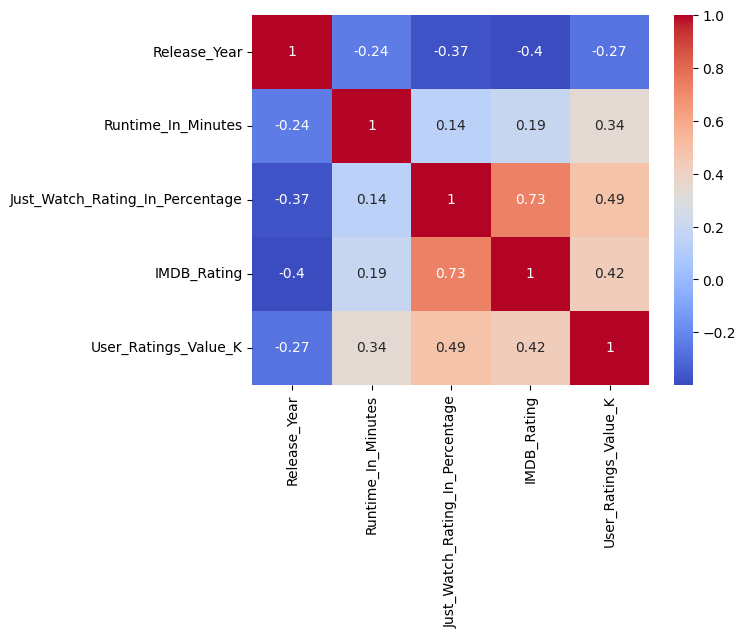

In [ ]:

sns.heatmap(history_tvshows.corr(),cmap='coolwarm',annot=True)


In [ ]:

history_tvshows_correlation_matrix = history_tvshows.corr()
history_tvshows_correlation_table = history_tvshows_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
history_tvshows_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
history_tvshows_correlation_table['Correlation Type'] = history_tvshows_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
history_tvshows_correlation_table['Correlation Strength'] = history_tvshows_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


history_tvshows_correlation_table


<ipython-input-1670-f656e68eded0>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  history_tvshows_correlation_matrix = history_tvshows.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.729023,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.729023,Positive,Strong
7,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.486858,Positive,Weak
8,Just_Watch_Rating_In_Percentage,User_Ratings_Value_K,0.486858,Positive,Weak
9,IMDB_Rating,User_Ratings_Value_K,0.423852,Positive,Weak


# War and Military TV Shows Analysis

In [ ]:
war_military_tvshows.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
67,Age of Samurai: Battle for Japan,TV-Show,Stephen Scott,2021,2021-2025,War & Military,43,40-45,80.0,80-90,7.4,7.1-7.5,4.0,1-50
321,Bodyguard,TV-Show,No Value,2018,2016-2020,War & Military,60,60-65,87.0,80-90,8.1,8.1-8.5,134.0,101-150
337,Borgen - Power & Glory,TV-Show,Sidse Babett Knudsen,2022,2021-2025,War & Military,57,55-60,86.0,80-90,8.2,8.1-8.5,0.0,nan
492,Crash Landing on You,TV-Show,Lee Jung-hyo,2019,2016-2020,War & Military,86,85-90,94.0,90-100,8.7,8.6-9.0,33.0,1-50
600,Designated Survivor,TV-Show,Kiefer Sutherland,2016,2016-2020,War & Military,44,40-45,82.0,80-90,7.5,7.6-8.0,97.0,51-100


# **37 War and Military TV Shows**

In [ ]:
war_military_tvshows.shape


(37, 14)

In [ ]:
war_military_tvshows.Release_Year_Range.value_counts()


2016-2020    18
2021-2025    16
2011-2015     2
1981-1985     1
Name: Release_Year_Range, dtype: int64

In [ ]:
war_military_tvshows.JustWatch_Range.value_counts()


80-90     21
70-80      9
90-100     4
60-70      2
40-50      1
Name: JustWatch_Range, dtype: int64

In [ ]:
war_military_tvshows.IMDB_Range.value_counts()


7.6-8.0    12
7.1-7.5     8
8.1-8.5     5
8.6-9.0     4
6.6-7.0     4
5.6-6.0     1
6.1-6.5     1
5.1-5.5     1
nan         1
Name: IMDB_Range, dtype: int64

In [ ]:
war_military_tvshows.UserRatings_Range.value_counts()


1-50       28
nan         4
51-100      3
101-150     1
151-200     1
Name: UserRatings_Range, dtype: int64

In [ ]:
war_military_tvshows.Runtime_Range.value_counts()


40-45      9
50-55      8
45-50      7
55-60      4
25-30      2
60-65      2
85-90      1
80-85      1
70-75      1
95-100     1
10-15      1
200-205    0
180-185    0
175-180    0
185-190    0
170-175    0
190-195    0
165-170    0
195-200    0
0-5        0
215-220    0
205-210    0
210-215    0
155-160    0
220-225    0
225-230    0
230-235    0
235-240    0
240-245    0
160-165    0
125-130    0
150-155    0
100-105    0
15-20      0
20-25      0
30-35      0
35-40      0
65-70      0
75-80      0
90-95      0
105-110    0
145-150    0
110-115    0
115-120    0
120-125    0
5-10       0
130-135    0
135-140    0
140-145    0
245-250    0
Name: Runtime_Range, dtype: int64

#**War and Military TV Shows Summary Statistics**

Release Year:

Count: There are 37 war and military TV shows in the dataset.
Mean: The average release year for war and military TV shows is approximately 2017.8, indicating a mix of relatively recent and older TV shows.
Standard Deviation: The release years of war and military TV shows have a standard deviation of approximately 6.4, suggesting some variability in the years of release.
Minimum: The earliest release year for a war and military TV show in the dataset is 1984.
Maximum: The latest release year for a war and military TV show in the dataset is 2023, indicating recent releases.
25th Percentile: 25% of the war and military TV shows were released in or before the year 2016.
50th Percentile (Median): 50% of the war and military TV shows were released in or before the year 2019, providing the median release year.
75th Percentile: 75% of the war and military TV shows were released in or before the year 2021, indicating a concentration of recent releases.

****
Runtime in Minutes:

Mean: The average runtime of war and military TV shows is approximately 50.5 minutes.
Standard Deviation: The runtime of war and military TV shows varies by approximately 15.6 minutes, suggesting some variability in TV show lengths.
Minimum: The shortest runtime for a war and military TV show in the dataset is 10 minutes.
Maximum: The longest runtime for a war and military TV show in the dataset is 95 minutes.
25th Percentile: 25% of the war and military TV shows have a runtime of 43 minutes or less.
50th Percentile (Median): 50% of the war and military TV shows have a runtime of 49 minutes, providing the median runtime.
75th Percentile: 75% of the war and military TV shows have a runtime of 55 minutes or less.
****
Just Watch Rating in Percentage:

Mean: The average Just Watch rating for war and military TV shows is approximately 80.6%.
Standard Deviation: The Just Watch ratings for war and military TV shows vary by approximately 9.3%, suggesting some variability in audience ratings.
Minimum: The lowest Just Watch rating for a war and military TV show in the dataset is 43%.
Maximum: The highest Just Watch rating for a war and military TV show in the dataset is 95%.
25th Percentile: 25% of the war and military TV shows have a Just Watch rating of 78% or lower.
50th Percentile (Median): 50% of the war and military TV shows have a Just Watch rating of 81%.
75th Percentile: 75% of the war and military TV shows have a Just Watch rating of 86% or lower.
****
IMDb Rating:

Mean: The average IMDb rating for war and military TV shows is approximately 7.3 out of 10.
Standard Deviation: The IMDb ratings for war and military TV shows have a standard deviation of approximately 1.5, indicating some variability in the ratings.
Minimum: The lowest IMDb rating for a war and military TV show in the dataset is 0 out of 10.
Maximum: The highest IMDb rating for a war and military TV show in the dataset is 8.8 out of 10.
25th Percentile: 25% of the war and military TV shows have an IMDb rating of 7.1 or lower.
50th Percentile (Median): 50% of the war and military TV shows have an IMDb rating of 7.5.
75th Percentile: 75% of the war and military TV shows have an IMDb rating of 7.9 or lower.
****
User Ratings Value (K):

Mean: The average user ratings value for war and military TV shows is approximately 21.9 thousand, indicating a moderate level of user engagement.
Standard Deviation: The user ratings values for war and military TV shows have a standard deviation of approximately 35.7 thousand, suggesting some variability in user engagement levels.
Minimum: The lowest user ratings value for a war and military TV show in the dataset is 0 thousand.
Maximum: The highest user ratings value for a war and military TV show in the dataset is 154 thousand.
25th Percentile: 25% of the war and military TV shows have a user ratings value of 2 thousand or lower.
50th Percentile (Median): 50% of the war and military TV shows have a user ratings value of 9 thousand.
75th Percentile: 75% of the war and military TV shows have a user ratings value of 28 thousand or lower.

In [ ]:
war_military_tvshows.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,37.000000,37.000000,37.000000,37.000000,37.000000
mean,2017.837838,50.540541,80.567568,7.291892,21.891892
std,6.401013,15.603765,9.299165,1.471843,35.674286
min,1984.000000,10.000000,43.000000,0.000000,0.000000
25%,2016.000000,43.000000,78.000000,7.100000,2.000000
50%,2019.000000,49.000000,81.000000,7.500000,9.000000
75%,2021.000000,55.000000,86.000000,7.900000,28.000000
max,2023.000000,95.000000,95.000000,8.800000,154.000000


#**War and Military TV Shows**


Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately 0.335. This indicates a moderate positive correlation, suggesting that war and military TV shows released in later years tend to have slightly longer runtimes.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.010. This suggests a very weak negative correlation, indicating that there is no significant relationship between the release year and the Just Watch rating percentage of war and military TV shows.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.059. This suggests a very weak negative correlation, indicating that there is no significant relationship between the release year and the IMDB rating of war and military TV shows.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.092. This suggests a very weak negative correlation, indicating that there is no significant relationship between the release year and the user ratings value of war and military TV shows.

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.177. This suggests a weak positive correlation, indicating that war and military TV shows with longer runtimes may have slightly higher Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.142. This suggests a weak positive correlation, indicating that war and military TV shows with longer runtimes may have slightly higher IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.060. This suggests a very weak positive correlation, indicating that there is no significant relationship between the runtime and the user ratings value of war and military TV shows.

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.950. This indicates a strong positive correlation, suggesting that war and military TV shows with higher Just Watch rating percentages tend to have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.394. This indicates a moderate positive correlation, suggesting that war and military TV shows with higher Just Watch rating percentages tend to have higher user ratings values.

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.286. This suggests a weak positive correlation, indicating that war and military TV shows with higher IMDB ratings may have slightly higher user ratings values.

In [ ]:
war_military_tvshows.corr()


<ipython-input-1679-c02f71b8c40f>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  war_military_tvshows.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,0.335192,-0.009611,-0.058522,-0.091921
Runtime_In_Minutes,0.335192,1.000000,0.176628,0.142071,0.060289
Just_Watch_Rating_In_Percentage,-0.009611,0.176628,1.000000,0.949549,0.393988
IMDB_Rating,-0.058522,0.142071,0.949549,1.000000,0.285501
User_Ratings_Value_K,-0.091921,0.060289,0.393988,0.285501,1.000000


<ipython-input-1680-7acc530a7c3c>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(war_military_tvshows.corr(),cmap='coolwarm',annot=True)


<Axes: >

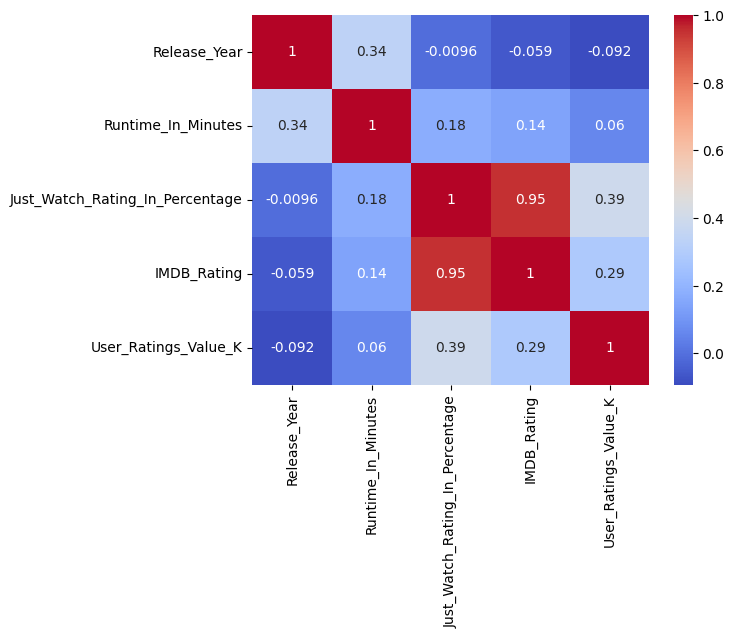

In [ ]:

sns.heatmap(war_military_tvshows.corr(),cmap='coolwarm',annot=True)


In [ ]:

war_military_tvshows_correlation_matrix = war_military_tvshows.corr()
war_military_tvshows_correlation_table = war_military_tvshows_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
war_military_tvshows_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
war_military_tvshows_correlation_table['Correlation Type'] = war_military_tvshows_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
war_military_tvshows_correlation_table['Correlation Strength'] = war_military_tvshows_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


war_military_tvshows_correlation_table


<ipython-input-1681-59c8123b2315>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  war_military_tvshows_correlation_matrix = war_military_tvshows.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.949549,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.949549,Positive,Strong
7,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.393988,Positive,Weak
8,Just_Watch_Rating_In_Percentage,User_Ratings_Value_K,0.393988,Positive,Weak
9,Release_Year,Runtime_In_Minutes,0.335192,Positive,Weak


# Sport TV Shows Analysis

In [ ]:
sport_tvshows.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
27,A Clean Sweep,TV-Show,장시원,2022,2021-2025,Sport,112,110-115,64.0,60-70,9.4,9.1-9.5,0.0,nan
66,Against the Ropes,TV-Show,Carmen Ramos,2023,2021-2025,Sport,40,40-45,85.0,80-90,6.6,6.6-7.0,0.0,nan
104,All American,TV-Show,Daniel Ezra,2018,2016-2020,Sport,43,40-45,87.0,80-90,7.6,7.6-8.0,9.0,1-50
105,All American: Homecoming,TV-Show,Rhoyle Ivy King,2022,2021-2025,Sport,42,40-45,80.0,80-90,6.4,6.1-6.5,1.0,1-50
223,Bad Sport,TV-Show,Lizzie Kempton,2021,2021-2025,Sport,68,65-70,76.0,70-80,7.3,7.1-7.5,2.0,1-50


#35 Sports TV Shows

In [ ]:
sport_tvshows.shape


(35, 14)

In [ ]:
sport_tvshows.Release_Year_Range.value_counts()


2021-2025    24
2016-2020     7
2001-2005     2
2006-2010     1
2011-2015     1
Name: Release_Year_Range, dtype: int64

In [ ]:
sport_tvshows.JustWatch_Range.value_counts()


80-90     18
70-80      9
90-100     5
60-70      2
0-10       1
Name: JustWatch_Range, dtype: int64

In [ ]:
sport_tvshows.IMDB_Range.value_counts()


7.1-7.5    9
8.1-8.5    6
8.6-9.0    6
7.6-8.0    5
6.1-6.5    4
9.1-9.5    2
6.6-7.0    2
nan        1
Name: IMDB_Range, dtype: int64

In [ ]:
sport_tvshows.UserRatings_Range.value_counts()


1-50       22
nan         8
101-150     2
151-200     1
51-100      1
451-500     1
Name: UserRatings_Range, dtype: int64

In [ ]:
sport_tvshows.Runtime_Range.value_counts()


55-60      6
30-35      6
45-50      5
40-45      5
50-55      4
60-65      2
35-40      2
110-115    1
65-70      1
100-105    1
25-30      1
20-25      1
200-205    0
170-175    0
175-180    0
180-185    0
185-190    0
190-195    0
195-200    0
165-170    0
0-5        0
225-230    0
205-210    0
210-215    0
215-220    0
220-225    0
155-160    0
230-235    0
235-240    0
240-245    0
160-165    0
125-130    0
150-155    0
145-150    0
10-15      0
15-20      0
70-75      0
75-80      0
80-85      0
85-90      0
90-95      0
95-100     0
105-110    0
115-120    0
120-125    0
5-10       0
130-135    0
135-140    0
140-145    0
245-250    0
Name: Runtime_Range, dtype: int64

#**Sports TV Shows Summary Statistics**

Release Year:

Count: There are 35 sports TV shows in the dataset.
Mean: The average release year for sports TV shows is approximately 2019.
Standard Deviation: The release years of sports TV shows have a standard deviation of approximately 5.7.
Minimum: The earliest release year for a sports TV show in the dataset is 2001.
Maximum: The latest release year for a sports TV show in the dataset is 2023.
25th Percentile: 25% of the sports TV shows were released in or before the year 2018.5.
50th Percentile (Median): 50% of the sports TV shows were released in or before the year 2021.
75th Percentile: 75% of the sports TV shows were released in or before the year 2022.5.
****
Runtime in Minutes:

Mean: The average runtime of sports TV shows is approximately 49 minutes.
Standard Deviation: The runtime of sports TV shows varies by approximately 17.9 minutes.
Minimum: The shortest runtime for a sports TV show in the dataset is 24 minutes.
Maximum: The longest runtime for a sports TV show in the dataset is 112 minutes.
25th Percentile: 25% of the sports TV shows have a runtime of 37 minutes or less.
50th Percentile (Median): 50% of the sports TV shows have a runtime of 48 minutes.
75th Percentile: 75% of the sports TV shows have a runtime of 56 minutes or less.

****
Just Watch Rating in Percentage:

Mean: The average Just Watch rating for sports TV shows is approximately 79.7%.
Standard Deviation: The Just Watch ratings for sports TV shows vary by approximately 14.8%.
Minimum: The lowest Just Watch rating for a sports TV show in the dataset is 6%.
Maximum: The highest Just Watch rating for a sports TV show in the dataset is 94%.
25th Percentile: 25% of the sports TV shows have a Just Watch rating of 77.5% or lower.
50th Percentile (Median): 50% of the sports TV shows have a Just Watch rating of 82%.
75th Percentile: 75% of the sports TV shows have a Just Watch rating of 86.5% or lower.

****
IMDb Rating:

Mean: The average IMDb rating for sports TV shows is approximately 7.5 out of 10.
Standard Deviation: The IMDb ratings for sports TV shows have a standard deviation of approximately 1.5.
Minimum: The lowest IMDb rating for a sports TV show in the dataset is 0 out of 10.
Maximum: The highest IMDb rating for a sports TV show in the dataset is 9.4 out of 10.
25th Percentile: 25% of the sports TV shows have an IMDb rating of 7.15 or lower.
50th Percentile (Median): 50% of the sports TV shows have an IMDb rating of 7.6.
75th Percentile: 75% of the sports TV shows have an IMDb rating of 8.35 or lower.
****
User Ratings Value (K):

Mean: The average user ratings value for sports TV shows is approximately 34.7 thousand.
Standard Deviation: The user ratings values for sports TV shows have a standard deviation of approximately 90.4 thousand.
Minimum: The lowest user ratings value for a sports TV show in the dataset is 0 thousand.
Maximum: The highest user ratings value for a sports TV show in the dataset is 489 thousand.
25th Percentile: 25% of the sports TV shows have a user ratings value of 1 thousand or lower.
50th Percentile (Median): 50% of the sports TV shows have a user ratings value of 3 thousand.
75th Percentile: 75% of the sports TV shows have a user ratings value of 15 thousand or lower.

In [ ]:
sport_tvshows.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,35.000000,35.000000,35.000000,35.000000,35.000000
mean,2019.000000,49.000000,79.714286,7.468571,34.742857
std,5.662051,17.950913,14.777908,1.540774,90.351712
min,2001.000000,24.000000,6.000000,0.000000,0.000000
25%,2018.500000,37.000000,77.500000,7.150000,1.000000
50%,2021.000000,48.000000,82.000000,7.600000,3.000000
75%,2022.500000,56.000000,86.500000,8.350000,15.000000
max,2023.000000,112.000000,94.000000,9.400000,489.000000


# **Sport TV Shows Correlation**


Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately 0.155. This indicates a weak positive correlation, suggesting that sport TV shows released in later years may have slightly longer runtimes.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.246. This suggests a weak negative correlation, indicating that sport TV shows released in later years may have slightly lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.233. This indicates a weak negative correlation, suggesting that sport TV shows released in later years may have slightly lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.176. This indicates a weak negative correlation, suggesting that sport TV shows released in later years may have slightly lower user ratings values.

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately -0.180. This indicates a weak negative correlation, suggesting that the runtime of sport TV shows may have a slight influence on their Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.146. This indicates a weak positive correlation, suggesting that the runtime of sport TV shows may have a slight positive influence on their IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately -0.010. This indicates a very weak negative correlation, suggesting that the runtime of sport TV shows has minimal influence on their user ratings values.

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.868. This indicates a strong positive correlation, suggesting that sport TV shows with higher Just Watch rating percentages tend to have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.317. This indicates a weak positive correlation, suggesting that sport TV shows with higher Just Watch rating percentages may have slightly higher user ratings values.

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.270. This indicates a weak positive correlation, suggesting that sport TV shows with higher IMDB ratings may have slightly higher user ratings values.

In [ ]:
sport_tvshows.corr()


<ipython-input-1690-5e26dd5e434e>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sport_tvshows.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,0.155394,-0.246055,-0.232626,-0.175582
Runtime_In_Minutes,0.155394,1.000000,-0.180167,0.146430,-0.009557
Just_Watch_Rating_In_Percentage,-0.246055,-0.180167,1.000000,0.868278,0.317408
IMDB_Rating,-0.232626,0.146430,0.868278,1.000000,0.270096
User_Ratings_Value_K,-0.175582,-0.009557,0.317408,0.270096,1.000000


<ipython-input-1691-35ad1ab31580>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(sport_tvshows.corr(),cmap='coolwarm',annot=True)


<Axes: >

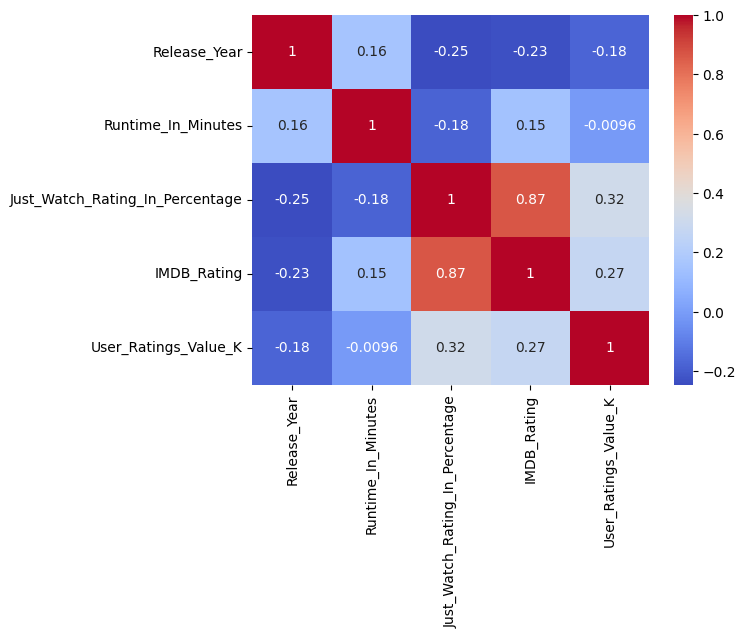

In [ ]:

sns.heatmap(sport_tvshows.corr(),cmap='coolwarm',annot=True)


In [ ]:
sport_tvshows
sport_tvshows_correlation_matrix = sport_tvshows.corr()
sport_tvshows_correlation_table = sport_tvshows_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
sport_tvshows_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
sport_tvshows_correlation_table['Correlation Type'] = sport_tvshows_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
sport_tvshows_correlation_table['Correlation Strength'] = sport_tvshows_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


sport_tvshows_correlation_table


<ipython-input-1692-5f31f020c83b>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sport_tvshows_correlation_matrix = sport_tvshows.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.868278,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.868278,Positive,Strong
7,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.317408,Positive,Weak
8,Just_Watch_Rating_In_Percentage,User_Ratings_Value_K,0.317408,Positive,Weak
9,IMDB_Rating,User_Ratings_Value_K,0.270096,Positive,Weak


# Made in Europe TV Shows Analysis

In [ ]:
europe_tvshows.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
210,Babylon Berlin,TV-Show,Volker Bruch,2017,2016-2020,Made in Europe,47,45-50,89.0,80-90,8.4,8.1-8.5,26.0,1-50
285,Black Mirror,TV-Show,No Value,2011,2011-2015,Made in Europe,60,60-65,94.0,90-100,8.8,8.6-9.0,575.0,551-600
324,Bodyguard,TV-Show,No Value,2018,2016-2020,Made in Europe,60,60-65,87.0,80-90,8.1,8.1-8.5,134.0,101-150
335,Borgen,TV-Show,Sidse Babett Knudsen,2010,2011-2015,Made in Europe,58,55-60,90.0,90-100,8.5,8.6-9.0,28.0,1-50
370,Call My Agent!,TV-Show,Camille Cottin,2015,2016-2020,Made in Europe,55,55-60,88.0,80-90,8.3,8.1-8.5,15.0,1-50


# 29 Made in Europe TV Shows

In [ ]:
europe_tvshows.shape


(29, 14)

In [ ]:
europe_tvshows.Release_Year_Range.value_counts()


2016-2020    16
2011-2015    10
2001-2005     2
nan           1
Name: Release_Year_Range, dtype: int64

In [ ]:
europe_tvshows.JustWatch_Range.value_counts()


80-90     16
90-100     6
70-80      5
60-70      1
40-50      1
Name: JustWatch_Range, dtype: int64

In [ ]:
europe_tvshows.IMDB_Range.value_counts()


8.6-9.0    8
8.1-8.5    7
7.1-7.5    7
7.6-8.0    5
6.1-6.5    2
Name: IMDB_Range, dtype: int64

In [ ]:
europe_tvshows.UserRatings_Range.value_counts()


1-50       20
551-600     2
101-150     2
nan         1
451-500     1
51-100      1
201-250     1
151-200     1
Name: UserRatings_Range, dtype: int64

In [ ]:
europe_tvshows.Runtime_Range.value_counts()


55-60      9
45-50      5
50-55      3
20-25      2
25-30      2
30-35      2
60-65      2
5-10       1
15-20      1
40-45      1
65-70      1
190-195    0
185-190    0
180-185    0
0-5        0
175-180    0
200-205    0
170-175    0
165-170    0
195-200    0
225-230    0
205-210    0
210-215    0
215-220    0
220-225    0
155-160    0
230-235    0
235-240    0
240-245    0
160-165    0
125-130    0
150-155    0
95-100     0
10-15      0
35-40      0
70-75      0
75-80      0
80-85      0
85-90      0
90-95      0
100-105    0
145-150    0
105-110    0
110-115    0
115-120    0
120-125    0
130-135    0
135-140    0
140-145    0
245-250    0
Name: Runtime_Range, dtype: int64

# **Made in Europe TV Shows Summary Statistics**

Release Year:

Count: There are 29 movies in the dataset that fall under the "Made in Europe" genre.
Mean: The average release year for these movies is approximately 2012.2.
Standard Deviation: The release years have a standard deviation of approximately 9.1, indicating some variability.
Minimum: The earliest release year in the dataset for a movie in this genre is 1969.
Maximum: The latest release year in the dataset for a movie in this genre is 2018.
25th Percentile: 25% of the movies in this genre were released in or before the year 2011.
50th Percentile (Median): 50% of the movies in this genre were released in or before the year 2015.
75th Percentile: 75% of the movies in this genre were released in or before the year 2016.


Runtime in Minutes:

Mean: The average runtime of movies in the "Made in Europe" genre is approximately 45.3 minutes.
Standard Deviation: The runtime varies by approximately 15.5 minutes, suggesting some variability in movie lengths.
Minimum: The shortest runtime for a movie in this genre in the dataset is 7 minutes.
Maximum: The longest runtime for a movie in this genre in the dataset is 66 minutes.
25th Percentile: 25% of the movies in this genre have a runtime of 30 minutes or less.
50th Percentile (Median): 50% of the movies in this genre have a runtime of 51 minutes.
75th Percentile: 75% of the movies in this genre have a runtime of 57 minutes or less.


Just Watch Rating in Percentage:

Mean: The average Just Watch rating for movies in the "Made in Europe" genre is approximately 83.4%.
Standard Deviation: The ratings vary by approximately 9.9%.
Minimum: The lowest Just Watch rating for a movie in this genre in the dataset is 45%.
Maximum: The highest Just Watch rating for a movie in this genre in the dataset is 97%.
25th Percentile: 25% of the movies in this genre have a Just Watch rating of 80% or lower.
50th Percentile (Median): 50% of the movies in this genre have a Just Watch rating of 85%.
75th Percentile: 75% of the movies in this genre have a Just Watch rating of 89% or lower.


IMDb Rating:

Mean: The average IMDb rating for movies in the "Made in Europe" genre is approximately 7.9 out of 10.
Standard Deviation: The ratings have a standard deviation of approximately 0.7.
Minimum: The lowest IMDb rating for a movie in this genre in the dataset is 6.2 out of 10.
Maximum: The highest IMDb rating for a movie in this genre in the dataset is 8.8 out of 10.
25th Percentile: 25% of the movies in this genre have an IMDb rating of 7.4 or lower.
50th Percentile (Median): 50% of the movies in this genre have an IMDb rating of 8.1.
75th Percentile: 75% of the movies in this genre have an IMDb rating of 8.5 or lower.


User Ratings Value (K):

Mean: The average user ratings value for movies in the "Made in Europe" genre is approximately 93.0 thousand.
Standard Deviation: The user ratings values have a standard deviation of approximately 167.8 thousand.
Minimum: The lowest user ratings value for a movie in this genre in the dataset is 0 thousand.
Maximum: The highest user ratings value for a movie in this genre in the dataset is 581 thousand.
25th Percentile: 25% of the movies in this genre have a user ratings value of 6 thousand or lower.
50th Percentile (Median): 50% of the movies in this genre have a user ratings value of 23 thousand.
75th Percentile: 75% of the movies in this genre have a user ratings value of 76 thousand or lower.

In [ ]:
europe_tvshows.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,29.000000,29.000000,29.000000,29.000000,29.000000
mean,2012.172414,45.344828,83.413793,7.893103,93.034483
std,9.142010,15.464882,9.919379,0.730915,167.750342
min,1969.000000,7.000000,45.000000,6.200000,0.000000
25%,2011.000000,30.000000,80.000000,7.400000,6.000000
50%,2015.000000,51.000000,85.000000,8.100000,23.000000
75%,2016.000000,57.000000,89.000000,8.500000,76.000000
max,2018.000000,66.000000,97.000000,8.800000,581.000000


# **Made in Europe TV Shows Correlation**


Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately 0.177. This suggests a weak positive correlation, indicating that "Made in Europe" TV shows released in later years tend to have slightly longer runtimes.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately -0.278. This indicates a weak negative correlation, suggesting that "Made in Europe" TV shows released in later years may have slightly lower Just Watch rating percentages.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.257. This suggests a weak negative correlation, indicating that "Made in Europe" TV shows released in later years may have slightly lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately 0.012. This indicates a very weak positive correlation, suggesting that the release year of "Made in Europe" TV shows has minimal influence on their user ratings values.

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.081. This indicates a very weak positive correlation, suggesting that the runtime of "Made in Europe" TV shows has minimal influence on their Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.407. This indicates a moderate positive correlation, suggesting that "Made in Europe" TV shows with longer runtimes may have slightly higher IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.321. This indicates a moderate positive correlation, suggesting that "Made in Europe" TV shows with longer runtimes may have slightly higher user ratings values.

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.503. This indicates a moderate positive correlation, suggesting that "Made in Europe" TV shows with higher Just Watch rating percentages tend to have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.009. This indicates a very weak positive correlation, suggesting that the Just Watch rating percentage of "Made in Europe" TV shows has minimal influence on their user ratings values.

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.476. This indicates a moderate positive correlation, suggesting that "Made in Europe" TV shows with higher IMDB ratings may have slightly higher user ratings values.

In [ ]:
europe_tvshows.corr()


<ipython-input-1701-0392e4bd370c>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  europe_tvshows.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,0.176898,-0.278469,-0.256902,0.011966
Runtime_In_Minutes,0.176898,1.000000,0.081220,0.407487,0.321491
Just_Watch_Rating_In_Percentage,-0.278469,0.081220,1.000000,0.503348,0.008920
IMDB_Rating,-0.256902,0.407487,0.503348,1.000000,0.476275
User_Ratings_Value_K,0.011966,0.321491,0.008920,0.476275,1.000000


<ipython-input-1702-63c66237ad14>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(europe_tvshows.corr(),cmap='coolwarm',annot=True)


<Axes: >

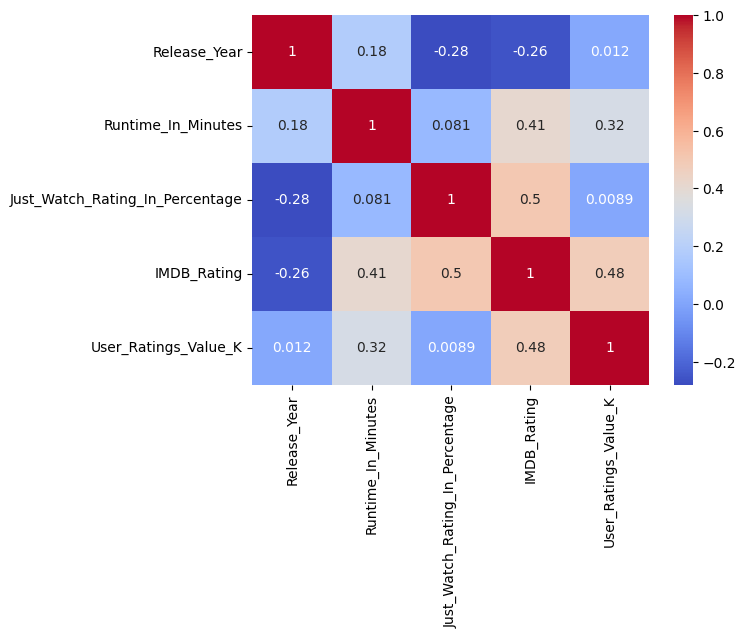

In [ ]:

sns.heatmap(europe_tvshows.corr(),cmap='coolwarm',annot=True)


In [ ]:

europe_tvshows_correlation_matrix = europe_tvshows.corr()
europe_tvshows_correlation_table = europe_tvshows_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
europe_tvshows_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
europe_tvshows_correlation_table['Correlation Type'] = europe_tvshows_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
europe_tvshows_correlation_table['Correlation Strength'] = europe_tvshows_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


europe_tvshows_correlation_table


<ipython-input-1703-4bacf20e0424>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  europe_tvshows_correlation_matrix = europe_tvshows.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.503348,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.503348,Positive,Strong
7,IMDB_Rating,User_Ratings_Value_K,0.476275,Positive,Weak
8,User_Ratings_Value_K,IMDB_Rating,0.476275,Positive,Weak
9,Runtime_In_Minutes,IMDB_Rating,0.407487,Positive,Weak


# Musical TV Shows Analysis

In [ ]:
musical_tvshows.head()


,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
21,45 RPM,TV-Show,Guiomar Puerta,2019,2016-2020,Music & Musical,57,55-60,76.0,70-80,7.2,7.1-7.5,0.0,nan
79,Aggretsuko,TV-Show,Kaolip,2018,2016-2020,Music & Musical,17,15-20,83.0,80-90,8.0,8.1-8.5,6.0,1-50
102,All About the Washingtons,TV-Show,Joseph Simmons,2018,2016-2020,Music & Musical,23,20-25,55.0,50-60,4.8,4.6-5.0,0.0,nan
145,Anitta: Made in Honório,TV-Show,Anitta,2020,2021-2025,Music & Musical,30,30-35,66.0,60-70,7.0,7.1-7.5,0.0,nan
381,Carole & Tuesday,TV-Show,Miyuri Shimabukuro,2019,2016-2020,Music & Musical,24,20-25,82.0,80-90,7.8,7.6-8.0,2.0,1-50


# 27 Muscial TV Shows

In [ ]:
musical_tvshows.shape


(27, 14)

In [ ]:
musical_tvshows.Release_Year_Range.value_counts()



2021-2025    12
2016-2020     9
2001-2005     2
2011-2015     2
2006-2010     1
1981-1985     1
Name: Release_Year_Range, dtype: int64

In [ ]:
musical_tvshows.JustWatch_Range.value_counts()


80-90     12
70-80     10
60-70      2
50-60      1
90-100     1
40-50      1
Name: JustWatch_Range, dtype: int64

In [ ]:
musical_tvshows.IMDB_Range.value_counts()


7.1-7.5    7
7.6-8.0    6
6.6-7.0    4
8.1-8.5    3
8.6-9.0    2
6.1-6.5    2
4.6-5.0    1
5.1-5.5    1
3.6-4.0    1
Name: IMDB_Range, dtype: int64

In [ ]:
musical_tvshows.UserRatings_Range.value_counts()


1-50       17
nan         8
51-100      1
101-150     1
Name: UserRatings_Range, dtype: int64

In [ ]:
musical_tvshows.Runtime_Range.value_counts()


20-25      6
45-50      5
40-45      3
15-20      2
25-30      2
30-35      2
35-40      2
55-60      2
50-55      1
10-15      1
90-95      1
180-185    0
190-195    0
185-190    0
0-5        0
175-180    0
170-175    0
165-170    0
200-205    0
195-200    0
225-230    0
205-210    0
210-215    0
215-220    0
220-225    0
155-160    0
230-235    0
235-240    0
240-245    0
160-165    0
125-130    0
150-155    0
100-105    0
60-65      0
65-70      0
70-75      0
75-80      0
80-85      0
85-90      0
95-100     0
105-110    0
145-150    0
110-115    0
115-120    0
120-125    0
5-10       0
130-135    0
135-140    0
140-145    0
245-250    0
Name: Runtime_Range, dtype: int64

# **Musical TV Shows Summary Statistics**

Release Year:

Count: There are 27 movies in the dataset that fall under the "Musical" genre.
Mean: The average release year for these movies is approximately 2016.3.
Standard Deviation: The release years have a standard deviation of approximately 8.8, indicating some variability.
Minimum: The earliest release year in the dataset for a movie in this genre is 1984.
Maximum: The latest release year in the dataset for a movie in this genre is 2023.
25th Percentile: 25% of the movies in this genre were released in or before the year 2018.
50th Percentile (Median): 50% of the movies in this genre were released in or before the year 2019.
75th Percentile: 75% of the movies in this genre were released in or before the year 2022.
****
Runtime in Minutes:

Mean: The average runtime of movies in the "Musical" genre is approximately 36.7 minutes.
Standard Deviation: The runtime varies by approximately 17.4 minutes, suggesting some variability in movie lengths.
Minimum: The shortest runtime for a movie in this genre in the dataset is 10 minutes.
Maximum: The longest runtime for a movie in this genre in the dataset is 93 minutes.
25th Percentile: 25% of the movies in this genre have a runtime of 23.5 minutes or less.
50th Percentile (Median): 50% of the movies in this genre have a runtime of 38 minutes.
75th Percentile: 75% of the movies in this genre have a runtime of 46 minutes or less.
****
Just Watch Rating in Percentage:

Mean: The average Just Watch rating for movies in the "Musical" genre is approximately 77.3%.
Standard Deviation: The ratings vary by approximately 9.6%.
Minimum: The lowest Just Watch rating for a movie in this genre in the dataset is 49%.
Maximum: The highest Just Watch rating for a movie in this genre in the dataset is 91%.
25th Percentile: 25% of the movies in this genre have a Just Watch rating of 75.5% or lower.
50th Percentile (Median): 50% of the movies in this genre have a Just Watch rating of 79%.
75th Percentile: 75% of the movies in this genre have a Just Watch rating of 83% or lower.
****
IMDb Rating:

Mean: The average IMDb rating for movies in the "Musical" genre is approximately 7.1 out of 10.
Standard Deviation: The ratings have a standard deviation of approximately 1.1.
Minimum: The lowest IMDb rating for a movie in this genre in the dataset is 3.7 out of 10.
Maximum: The highest IMDb rating for a movie in this genre in the dataset is 8.8 out of 10.
25th Percentile: 25% of the movies in this genre have an IMDb rating of 6.7 or lower.
50th Percentile (Median): 50% of the movies in this genre have an IMDb rating of 7.2.
75th Percentile: 75% of the movies in this genre have an IMDb rating of 7.8 or lower.
****
User Ratings Value (K):

Mean: The average user ratings value for movies in the "Musical" genre is approximately 12.4 thousand.
Standard Deviation: The user ratings values have a standard deviation of approximately 25.9 thousand.
Minimum: The lowest user ratings value for a movie in this genre in the dataset is 0 thousand.
Maximum: The highest user ratings value for a movie in this genre in the dataset is 122 thousand.
25th Percentile: 25% of the movies in this genre have a user ratings value of 0 thousand.
50th Percentile (Median): 50% of the movies in this genre have a user ratings value of 4 thousand.
75th Percentile: 75% of the movies in this genre have a user ratings value of 10.5 thousand or lower.

In [ ]:
musical_tvshows.describe()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,27.000000,27.000000,27.000000,27.000000,27.000000
mean,2016.296296,36.666667,77.296296,7.062963,12.444444
std,8.774153,17.415731,9.642912,1.116364,25.911585
min,1984.000000,10.000000,49.000000,3.700000,0.000000
25%,2018.000000,23.500000,75.500000,6.700000,0.000000
50%,2019.000000,38.000000,79.000000,7.200000,4.000000
75%,2022.000000,46.000000,83.000000,7.800000,10.500000
max,2023.000000,93.000000,91.000000,8.800000,122.000000


# **Musical TV Shows Correlation**


Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately 0.391. This indicates a moderate positive correlation, suggesting that musical TV shows released in later years tend to have slightly longer runtimes.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately 0.014. This suggests a very weak positive correlation, indicating that there is minimal association between the release year and Just Watch rating percentage of musical TV shows.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately 0.018. This suggests a very weak positive correlation, indicating that there is minimal association between the release year and IMDB ratings of musical TV shows.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately -0.486. This indicates a moderate negative correlation, suggesting that musical TV shows released in later years may have slightly lower user ratings values (in thousands).

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.103. This indicates a weak positive correlation, suggesting that musical TV shows with longer runtimes may have slightly higher Just Watch rating percentages.

Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.205. This indicates a weak positive correlation, suggesting that musical TV shows with longer runtimes may have slightly higher IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.135. This indicates a weak positive correlation, suggesting that musical TV shows with longer runtimes may have slightly higher user ratings values (in thousands).

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.900. This indicates a strong positive correlation, suggesting that musical TV shows with higher Just Watch rating percentages tend to have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.390. This indicates a moderate positive correlation, suggesting that musical TV shows with higher Just Watch rating percentages tend to have higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.420. This indicates a moderate positive correlation, suggesting that musical TV shows with higher IMDB ratings may have slightly higher user ratings values (in thousands).

In [ ]:
musical_tvshows.corr()


<ipython-input-1712-ddd325c0641b>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  musical_tvshows.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,0.391306,0.013924,0.018440,-0.485955
Runtime_In_Minutes,0.391306,1.000000,0.103212,0.205275,0.134748
Just_Watch_Rating_In_Percentage,0.013924,0.103212,1.000000,0.900341,0.390128
IMDB_Rating,0.018440,0.205275,0.900341,1.000000,0.420351
User_Ratings_Value_K,-0.485955,0.134748,0.390128,0.420351,1.000000


<ipython-input-1713-e1d628f0b8da>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(musical_tvshows.corr(),cmap='coolwarm',annot=True)


<Axes: >

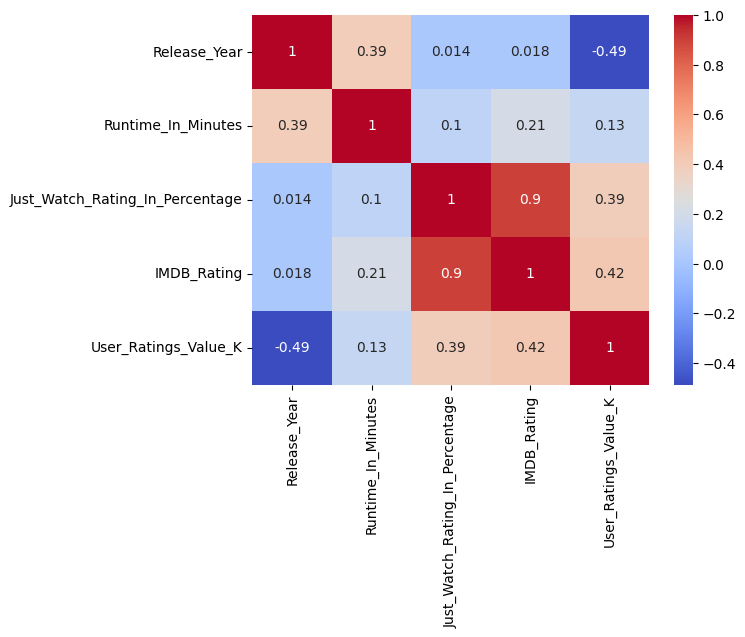

In [ ]:

sns.heatmap(musical_tvshows.corr(),cmap='coolwarm',annot=True)


In [ ]:

musical_tvshows_correlation_matrix = musical_tvshows.corr()
musical_tvshows_correlation_table = musical_tvshows_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
musical_tvshows_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
musical_tvshows_correlation_table['Correlation Type'] = musical_tvshows_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
musical_tvshows_correlation_table['Correlation Strength'] = musical_tvshows_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


musical_tvshows_correlation_table


<ipython-input-1714-fc3894dd50a8>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  musical_tvshows_correlation_matrix = musical_tvshows.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.900341,Positive,Strong
6,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.900341,Positive,Strong
7,User_Ratings_Value_K,IMDB_Rating,0.420351,Positive,Weak
8,IMDB_Rating,User_Ratings_Value_K,0.420351,Positive,Weak
9,Release_Year,Runtime_In_Minutes,0.391306,Positive,Weak


# Western TV Shows Analysis

In [ ]:
western_tvshows.head()

,Title,Category,Director,Release_Year,Release_Year_Range,Genre,Runtime_In_Minutes,Runtime_Range,Just_Watch_Rating_In_Percentage,JustWatch_Range,IMDB_Rating,IMDB_Range,User_Ratings_Value_K,UserRatings_Range
57,Adventures of Sonic the Hedgehog,TV-Show,Jaleel White,1993,1991-1995,Western,22,20-25,71.0,70-80,6.3,6.1-6.5,4.0,1-50
823,Frontier,TV-Show,Jason Momoa,2016,2016-2020,Western,47,45-50,77.0,70-80,7.1,7.1-7.5,22.0,1-50
883,Godless,TV-Show,Jack O'Connell,2017,2016-2020,Western,65,65-70,87.0,80-90,8.2,8.1-8.5,72.0,51-100
946,Hatfields & McCoys,TV-Show,Kevin Reynolds,2012,2011-2015,Western,95,95-100,84.0,80-90,7.9,7.6-8.0,28.0,1-50
1365,Longmire,TV-Show,Robert Taylor,2012,2011-2015,Western,53,50-55,88.0,80-90,8.3,8.1-8.5,37.0,1-50


# 10 Western TV Shows

In [ ]:
western_tvshows.shape

(10, 14)

In [ ]:
western_tvshows.Release_Year_Range.value_counts()

2016-2020    6
2011-2015    2
1991-1995    1
2021-2025    1
Name: Release_Year_Range, dtype: int64

In [ ]:
western_tvshows.JustWatch_Range.value_counts()

80-90    5
70-80    4
50-60    1
Name: JustWatch_Range, dtype: int64

In [ ]:
western_tvshows.IMDB_Range.value_counts()

7.1-7.5    2
8.1-8.5    2
7.6-8.0    2
6.1-6.5    1
6.6-7.0    1
nan        1
5.6-6.0    1
Name: IMDB_Range, dtype: int64

In [ ]:
western_tvshows.UserRatings_Range.value_counts()

1-50      7
nan       2
51-100    1
Name: UserRatings_Range, dtype: int64

In [ ]:
western_tvshows.Runtime_Range.value_counts()

50-55      2
20-25      2
45-50      1
35-40      1
65-70      1
40-45      1
95-100     1
30-35      1
165-170    0
195-200    0
160-165    0
170-175    0
175-180    0
155-160    0
180-185    0
185-190    0
190-195    0
0-5        0
215-220    0
200-205    0
205-210    0
210-215    0
145-150    0
220-225    0
225-230    0
230-235    0
235-240    0
240-245    0
150-155    0
125-130    0
140-145    0
135-140    0
10-15      0
15-20      0
25-30      0
55-60      0
60-65      0
70-75      0
75-80      0
80-85      0
85-90      0
90-95      0
100-105    0
105-110    0
110-115    0
115-120    0
120-125    0
5-10       0
130-135    0
245-250    0
Name: Runtime_Range, dtype: int64

#**Western Genre TV Shows Summary Statistics**

Release Year:

Count: There are 10 movies in the dataset that fall under the "Western" genre.
Mean: The average release year for these movies is approximately 2013.8.
Standard Deviation: The release years have a standard deviation of approximately 7.9, indicating some variability.
Minimum: The earliest release year in the dataset for a movie in this genre is 1993.
Maximum: The latest release year in the dataset for a movie in this genre is 2022.
25th Percentile: 25% of the movies in this genre were released in or before the year 2012.8.
50th Percentile (Median): 50% of the movies in this genre were released in or before the year 2016.
75th Percentile: 75% of the movies in this genre were released in or before the year 2016.8.
****
Runtime in Minutes:

Mean: The average runtime of movies in the "Western" genre is approximately 46.7 minutes.
Standard Deviation: The runtime varies by approximately 21.9 minutes, suggesting some variability in movie lengths.
Minimum: The shortest runtime for a movie in this genre in the dataset is 22 minutes.
Maximum: The longest runtime for a movie in this genre in the dataset is 95 minutes.
25th Percentile: 25% of the movies in this genre have a runtime of 32 minutes or less.
50th Percentile (Median): 50% of the movies in this genre have a runtime of 45 minutes.
75th Percentile: 75% of the movies in this genre have a runtime of 53 minutes or less.
****
Just Watch Rating in Percentage:

Mean: The average Just Watch rating for movies in the "Western" genre is approximately 77.9%.
Standard Deviation: The ratings vary by approximately 9.9%.
Minimum: The lowest Just Watch rating for a movie in this genre in the dataset is 55%.
Maximum: The highest Just Watch rating for a movie in this genre in the dataset is 88%.
25th Percentile: 25% of the movies in this genre have a Just Watch rating of 74.3% or lower.
50th Percentile (Median): 50% of the movies in this genre have a Just Watch rating of 80%.
75th Percentile: 75% of the movies in this genre have a Just Watch rating of 84.8% or lower.
****
IMDb Rating:

Mean: The average IMDb rating for movies in the "Western" genre is approximately 6.5 out of 10.
Standard Deviation: The ratings have a standard deviation of approximately 2.4.
Minimum: The lowest IMDb rating for a movie in this genre in the dataset is 0 out of 10.
Maximum: The highest IMDb rating for a movie in this genre in the dataset is 8.3 out of 10.
25th Percentile: 25% of the movies in this genre have an IMDb rating of 6.4 or lower.
50th Percentile (Median): 50% of the movies in this genre have an IMDb rating of 7.3.
75th Percentile: 75% of the movies in this genre have an IMDb rating of 7.8 or lower.
****
User Ratings Value (K):

Mean: The average user ratings value for movies in the "Western" genre is approximately 22.8 thousand.
Standard Deviation: The user ratings values have a standard deviation of approximately 23.0 thousand.
Minimum: The lowest user ratings value for a movie in this genre in the dataset is 0 thousand.
Maximum: The highest user ratings value for a movie in this genre in the dataset is 72 thousand.
25th Percentile: 25% of the movies in this genre have a user ratings value of 2.5 thousand or lower.
50th Percentile (Median): 50% of the movies in this genre have a user ratings value of 22.5 thousand.
75th Percentile: 75% of the movies in this genre have a user ratings value of 34.8 thousand or lower.

In [ ]:
western_tvshows.describe()

,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
count,10.000000,10.000000,10.000000,10.000000,10.00000
mean,2013.800000,46.700000,77.900000,6.490000,22.80000
std,7.885289,21.899011,9.971626,2.431026,23.02559
min,1993.000000,22.000000,55.000000,0.000000,0.00000
25%,2012.750000,32.000000,74.250000,6.350000,2.50000
50%,2016.000000,45.000000,80.000000,7.250000,22.50000
75%,2016.750000,53.000000,84.750000,7.800000,34.75000
max,2022.000000,95.000000,88.000000,8.300000,72.00000


#**Western TV Shows**


Release_Year and Runtime_In_Minutes: The correlation coefficient between Release_Year and Runtime_In_Minutes is approximately 0.219. This indicates a weak positive correlation, suggesting that western TV shows released in later years tend to have slightly longer runtimes.

Release_Year and Just_Watch_Rating_In_Percentage: The correlation coefficient between Release_Year and Just_Watch_Rating_In_Percentage is approximately 0.020. This suggests a very weak positive correlation, indicating that there is minimal association between the release year and Just Watch rating percentage of western TV shows.

Release_Year and IMDB_Rating: The correlation coefficient between Release_Year and IMDB_Rating is approximately -0.180. This indicates a weak negative correlation, suggesting that western TV shows released in later years may have slightly lower IMDB ratings.

Release_Year and User_Ratings_Value_K: The correlation coefficient between Release_Year and User_Ratings_Value_K is approximately 0.134. This indicates a very weak positive correlation, suggesting that there is minimal association between the release year and user ratings values (in thousands) of western TV shows.

Runtime_In_Minutes and Just_Watch_Rating_In_Percentage: The correlation coefficient between Runtime_In_Minutes and Just_Watch_Rating_In_Percentage is approximately 0.284. This indicates a moderate positive correlation, suggesting that western TV shows with longer runtimes may have slightly higher Just Watch rating percentages.


Runtime_In_Minutes and IMDB_Rating: The correlation coefficient between Runtime_In_Minutes and IMDB_Rating is approximately 0.135. This indicates a weak positive correlation, suggesting that the runtime of western TV shows has minimal influence on their IMDB ratings.

Runtime_In_Minutes and User_Ratings_Value_K: The correlation coefficient between Runtime_In_Minutes and User_Ratings_Value_K is approximately 0.452. This indicates a moderate positive correlation, suggesting that western TV shows with longer runtimes may have slightly higher user ratings values (in thousands).

Just_Watch_Rating_In_Percentage and IMDB_Rating: The correlation coefficient between Just_Watch_Rating_In_Percentage and IMDB_Rating is approximately 0.946. This indicates a strong positive correlation, suggesting that western TV shows with higher Just Watch rating percentages tend to have higher IMDB ratings.

Just_Watch_Rating_In_Percentage and User_Ratings_Value_K: The correlation coefficient between Just_Watch_Rating_In_Percentage and User_Ratings_Value_K is approximately 0.733. This indicates a strong positive correlation, suggesting that western TV shows with higher Just Watch rating percentages tend to have higher user ratings values (in thousands).

IMDB_Rating and User_Ratings_Value_K: The correlation coefficient between IMDB_Rating and User_Ratings_Value_K is approximately 0.603. This indicates a moderate positive correlation, suggesting that western TV shows with higher IMDB ratings may have slightly higher user ratings values (in thousands).

In [ ]:
western_tvshows.corr()

<ipython-input-1723-db8c703926c5>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  western_tvshows.corr()


,Release_Year,Runtime_In_Minutes,Just_Watch_Rating_In_Percentage,IMDB_Rating,User_Ratings_Value_K
Release_Year,1.000000,0.219031,0.019501,-0.179801,0.134388
Runtime_In_Minutes,0.219031,1.000000,0.284280,0.134764,0.451815
Just_Watch_Rating_In_Percentage,0.019501,0.284280,1.000000,0.946457,0.732570
IMDB_Rating,-0.179801,0.134764,0.946457,1.000000,0.602602
User_Ratings_Value_K,0.134388,0.451815,0.732570,0.602602,1.000000


<ipython-input-1724-0df967e05fe5>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(western_tvshows.corr(),cmap='coolwarm',annot=True)


<Axes: >

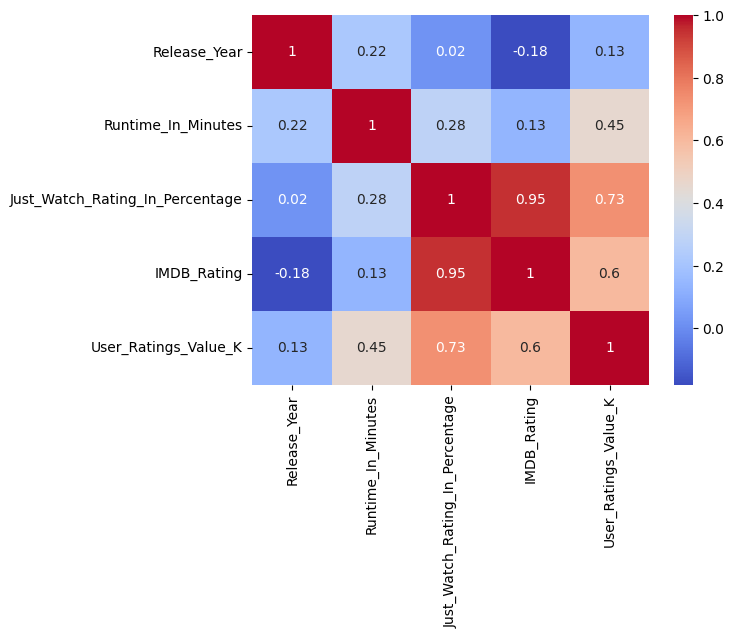

In [ ]:

sns.heatmap(western_tvshows.corr(),cmap='coolwarm',annot=True)


In [ ]:

western_tvshows_correlation_matrix = western_tvshows.corr()
western_tvshows_correlation_table = western_tvshows_correlation_matrix.unstack().sort_values(ascending=False).reset_index()
western_tvshows_correlation_table.columns = ['Variable 1', 'Variable 2', 'Correlation']






# Define the correlation threshold
threshold = 0.5


# Add a conditional column based on the correlation threshold
western_tvshows_correlation_table['Correlation Type'] = western_tvshows_correlation_table['Correlation'].apply(lambda x: 'Positive' if x > 0 else 'Negative')


# Add a conditional column based on the correlation strength
western_tvshows_correlation_table['Correlation Strength'] = western_tvshows_correlation_table['Correlation'].apply(lambda x: 'Strong' if abs(x) > threshold else 'Weak')


western_tvshows_correlation_table


<ipython-input-1725-42c1f8175511>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  western_tvshows_correlation_matrix = western_tvshows.corr()


,Variable 1,Variable 2,Correlation,Correlation Type,Correlation Strength
0,Release_Year,Release_Year,1.000000,Positive,Strong
1,Runtime_In_Minutes,Runtime_In_Minutes,1.000000,Positive,Strong
2,IMDB_Rating,IMDB_Rating,1.000000,Positive,Strong
3,Just_Watch_Rating_In_Percentage,Just_Watch_Rating_In_Percentage,1.000000,Positive,Strong
4,User_Ratings_Value_K,User_Ratings_Value_K,1.000000,Positive,Strong
5,Just_Watch_Rating_In_Percentage,IMDB_Rating,0.946457,Positive,Strong
6,IMDB_Rating,Just_Watch_Rating_In_Percentage,0.946457,Positive,Strong
7,User_Ratings_Value_K,Just_Watch_Rating_In_Percentage,0.732570,Positive,Strong
8,Just_Watch_Rating_In_Percentage,User_Ratings_Value_K,0.732570,Positive,Strong
9,IMDB_Rating,User_Ratings_Value_K,0.602602,Positive,Strong
